https://ncborcherding.github.io/vignettes/vignette.html#6_Interacting_with_Single-Cell_Objects
https://github.com/ncborcherding/scRepertoire/blob/master/vignettes/vignette.Rmd#L390

In [1]:
library(scRepertoire)

Loading required package: ggplot2

The legacy packages maptools, rgdal, and rgeos, underpinning this package
will retire shortly. Please refer to R-spatial evolution reports on
https://r-spatial.org/r/2023/05/15/evolution4.html for details.
This package is now running under evolution status 0 



In [2]:
FT1 <- read.csv("/node200data/FTC/data/cellranger_multi_outs/FT1/outs/per_sample_outs/FT1/vdj_t/filtered_contig_annotations.csv")
FT2 <- read.csv("/node200data/FTC/data/cellranger_multi_outs/FT2/outs/per_sample_outs/FT2/vdj_t/filtered_contig_annotations.csv")
FT3 <- read.csv("/node200data/FTC/data/cellranger_multi_outs/FT3/outs/per_sample_outs/FT3/vdj_t/filtered_contig_annotations.csv")
FT4 <- read.csv("/node200data/FTC/data/cellranger_multi_outs/FT4/outs/per_sample_outs/FT4/vdj_t/filtered_contig_annotations.csv")
FT5 <- read.csv("/node200data/FTC/data/cellranger_multi_outs/FT5/outs/per_sample_outs/FT5/vdj_t/filtered_contig_annotations.csv")

contig_list <- list(FT1,FT2,FT3,FT4,FT5)

In [3]:
head(contig_list[[1]])
#data("contig_list") -> 넣지 않기

,barcode,is_cell,contig_id,high_confidence,length,chain,v_gene,d_gene,j_gene,c_gene,⋯,fwr3_nt,cdr3,cdr3_nt,fwr4,fwr4_nt,reads,umis,raw_clonotype_id,raw_consensus_id,exact_subclonotype_id
,<chr>,<chr>,<chr>,<chr>,<int>,<chr>,<chr>,<chr>,<chr>,<chr>,⋯,<chr>,<chr>,<chr>,<chr>,<chr>,<int>,<int>,<chr>,<chr>,<int>
1,AAACCTGCACCGGAAA-1,true,AAACCTGCACCGGAAA-1_contig_1,true,485,TRB,TRBV24-1,,TRBJ1-5,TRBC1,⋯,ATAAACAAAGGAGAGATCTCTGATGGATACAGTGTCTCTCGACAGGCACAGGCTAAATTCTCCCTGTCCCTAGAGTCTGCCATCCCCAACCAGACAGCTCTTTACTTC,CATSDKYLNQPQHF,TGTGCCACCAGTGATAAATACCTCAATCAGCCCCAGCATTTT,GDGTRLSIL,GGTGATGGGACTCGACTCTCCATCCTAG,1673,3,clonotype34,clonotype34_consensus_1,1
2,AAACCTGCACCGGAAA-1,true,AAACCTGCACCGGAAA-1_contig_2,true,517,TRA,TRAV29/DV5,,TRAJ44,TRAC,⋯,AATGAAGATGGAAGATTCACTGTCTTCTTAAACAAAAGTGCCAAGCACCTCTCTCTGCACATTGTGCCCTCCCAGCCTGGAGACTCTGCAGTGTACTTC,CAAIRYTGTASKLTF,TGTGCAGCAATCCGCTATACCGGCACTGCCAGTAAACTCACCTTT,GTGTRLQVTL,GGGACTGGAACAAGACTTCAGGTCACGCTCG,1851,2,clonotype34,clonotype34_consensus_2,1
3,AAACCTGGTACTCAAC-1,true,AAACCTGGTACTCAAC-1_contig_1,true,667,TRA,TRAV8-2,,TRAJ22,TRAC,⋯,AAAGGCATCAACGGTTTTGAGGCTGAATTTAAGAAGAGTGAAACCTCCTTCCACCTGACGAAACCCTCAGCCCATATGAGCGACGCGGCTGAGTACTTC,CVVSEGGSARQLTF,TGTGTTGTGAGTGAGGGTGGTTCTGCAAGGCAACTGACCTTT,GSGTQLTVLP,GGATCTGGGACACAATTGACTGTTTTACCTG,935,3,clonotype35,clonotype35_consensus_3,4
4,AAACCTGGTCTCTTAT-1,true,AAACCTGGTCTCTTAT-1_contig_1,true,484,TRB,TRBV4-2,,TRBJ2-7,TRBC2,⋯,ACTGAAAACAACAGTGTGCCAAGTCGCTTCTCACCTGAATGCCCCAACAGCTCTCACTTATTCCTTCACCTACACACCCTGCAGCCAGAAGACTCGGCCCTGTATCTC,CASSQEIKRELIEQYF,TGTGCCAGCAGCCAAGAAATAAAACGGGAGTTGATCGAGCAGTACTTC,GPGTRLTVT,GGGCCGGGCACCAGGCTCACGGTCACAG,2990,4,clonotype1089,clonotype1089_consensus_2,1
5,AAACCTGGTCTCTTAT-1,true,AAACCTGGTCTCTTAT-1_contig_2,true,506,TRA,TRAV17,,TRAJ40,TRAC,⋯,AAACACAGTGGAAGATTAAGAGTCACGCTTGACACTTCCAAGAAAAGCAGTTCCTTGTTGATCACGGCTTCCCGGGCAGCAGACACTGCTTCTTACTTC,CATDAPSGTYKYIF,TGTGCTACGGACGCTCCCTCAGGAACCTACAAATACATCTTT,GTGTRLKVLA,GGAACAGGCACCAGGCTGAAGGTTTTAGCAA,2888,6,clonotype1089,clonotype1089_consensus_3,1
6,AAACCTGGTCTCTTAT-1,true,AAACCTGGTCTCTTAT-1_contig_3,true,514,TRB,TRBV11-2,TRBD1,TRBJ2-1,TRBC2,⋯,GTGGATGATTCACAGTTGCCTAAGGATCGATTTTCTGCAGAGAGGCTCAAAGGAGTAGACTCCACTCTCAAGATCCAGCCTGCAAAGCTTGAGGACTCGGCCGTGTATCTC,CASRDRQGANEQFF,TGTGCCAGCAGGGACCGACAGGGGGCTAATGAGCAGTTCTTC,GPGTRLTVL,GGGCCAGGGACACGGCTCACCGTGCTAG,5193,10,clonotype1089,clonotype1089_consensus_1,1


In [4]:
data(contig_list)

In [3]:
combined <- combineTCR(contig_list,
                      samples = c("FT1","FT2","FT3","FT4","FT5"),
                      cells = "T-AB",
                      ID = c("a","a","a","c","c"),
                      removeNA = T,
                      removeMulti = T)

In [36]:
combined

barcode,sample,ID,TCR1,cdr3_aa1,cdr3_nt1,TCR2,cdr3_aa2,cdr3_nt2,CTgene,CTnt,CTaa,CTstrict,cellType
<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>
FT1_a_AAACCTGAGCATCATC,FT1,a,TRAV12-1.TRAJ37.TRAC,CVVNDEGSSNTGKLIF,TGTGTGGTGAACGATGAAGGCTCTAGCAACACAGGCAAACTAATCTTT,TRBV5-1.TRBD2.TRBJ2-2.TRBC2,CASSWSGAGDGELFF,TGCGCCAGCAGCTGGTCAGGAGCGGGAGACGGGGAGCTGTTTTTT,TRAV12-1.TRAJ37.TRAC_TRBV5-1.TRBD2.TRBJ2-2.TRBC2,TGTGTGGTGAACGATGAAGGCTCTAGCAACACAGGCAAACTAATCTTT_TGCGCCAGCAGCTGGTCAGGAGCGGGAGACGGGGAGCTGTTTTTT,CVVNDEGSSNTGKLIF_CASSWSGAGDGELFF,TRAV12-1.TRAJ37.TRAC_TGTGTGGTGAACGATGAAGGCTCTAGCAACACAGGCAAACTAATCTTT_TRBV5-1.TRBD2.TRBJ2-2.TRBC2_TGCGCCAGCAGCTGGTCAGGAGCGGGAGACGGGGAGCTGTTTTTT,T-AB
FT1_a_AAACCTGCAAACGCGA,FT1,a,TRAV29DV5.TRAJ22.TRAC,CAASGYGSARQLTF,TGTGCAGCAAGCGGTTACGGTTCTGCAAGGCAACTGACCTTT,TRBV2.TRBD1.TRBJ1-6.TRBC1,CASRVQGNRGSPLHF,TGTGCCAGCAGGGTACAGGGTAATAGGGGTTCACCCCTCCACTTT,TRAV29DV5.TRAJ22.TRAC_TRBV2.TRBD1.TRBJ1-6.TRBC1,TGTGCAGCAAGCGGTTACGGTTCTGCAAGGCAACTGACCTTT_TGTGCCAGCAGGGTACAGGGTAATAGGGGTTCACCCCTCCACTTT,CAASGYGSARQLTF_CASRVQGNRGSPLHF,TRAV29DV5.TRAJ22.TRAC_TGTGCAGCAAGCGGTTACGGTTCTGCAAGGCAACTGACCTTT_TRBV2.TRBD1.TRBJ1-6.TRBC1_TGTGCCAGCAGGGTACAGGGTAATAGGGGTTCACCCCTCCACTTT,T-AB
FT1_a_AAACCTGGTGAAAGAG,FT1,a,TRAV2.TRAJ42.TRAC,CAAGGGGSQGNLIF,TGTGCTGCGGGAGGGGGAGGAAGCCAAGGAAATCTCATCTTT,TRBV3-1.TRBD1.TRBJ2-5.TRBC2,CASSQNRVETQYF,TGTGCCAGCAGCCAAAACAGGGTAGAGACCCAGTACTTC,TRAV2.TRAJ42.TRAC_TRBV3-1.TRBD1.TRBJ2-5.TRBC2,TGTGCTGCGGGAGGGGGAGGAAGCCAAGGAAATCTCATCTTT_TGTGCCAGCAGCCAAAACAGGGTAGAGACCCAGTACTTC,CAAGGGGSQGNLIF_CASSQNRVETQYF,TRAV2.TRAJ42.TRAC_TGTGCTGCGGGAGGGGGAGGAAGCCAAGGAAATCTCATCTTT_TRBV3-1.TRBD1.TRBJ2-5.TRBC2_TGTGCCAGCAGCCAAAACAGGGTAGAGACCCAGTACTTC,T-AB
FT1_a_AAACGGGGTAAACGCG,FT1,a,TRAV13-1.TRAJ9.TRAC,CALQGPLGGFKTIF,TGTGCCCTACAGGGGCCACTAGGAGGCTTCAAAACTATCTTT,TRBV29-1.TRBD1.TRBJ2-1.TRBC2,CSVEALRGANEQFF,TGCAGCGTTGAAGCCCTTAGGGGGGCAAATGAGCAGTTCTTC,TRAV13-1.TRAJ9.TRAC_TRBV29-1.TRBD1.TRBJ2-1.TRBC2,TGTGCCCTACAGGGGCCACTAGGAGGCTTCAAAACTATCTTT_TGCAGCGTTGAAGCCCTTAGGGGGGCAAATGAGCAGTTCTTC,CALQGPLGGFKTIF_CSVEALRGANEQFF,TRAV13-1.TRAJ9.TRAC_TGTGCCCTACAGGGGCCACTAGGAGGCTTCAAAACTATCTTT_TRBV29-1.TRBD1.TRBJ2-1.TRBC2_TGCAGCGTTGAAGCCCTTAGGGGGGCAAATGAGCAGTTCTTC,T-AB
FT1_a_AAACGGGGTCAGTGGA,FT1,a,TRAV8-4.TRAJ40.TRAC,CAVSEGASGTYKYIF,TGTGCTGTGAGCGAGGGGGCCTCAGGAACCTACAAATACATCTTT,TRBV7-6.None.TRBJ1-1.TRBC1,CASSEITGLKSEAFF,TGTGCCAGCAGCGAGATTACGGGGTTAAAATCTGAAGCTTTCTTT,TRAV8-4.TRAJ40.TRAC_TRBV7-6.None.TRBJ1-1.TRBC1,TGTGCTGTGAGCGAGGGGGCCTCAGGAACCTACAAATACATCTTT_TGTGCCAGCAGCGAGATTACGGGGTTAAAATCTGAAGCTTTCTTT,CAVSEGASGTYKYIF_CASSEITGLKSEAFF,TRAV8-4.TRAJ40.TRAC_TGTGCTGTGAGCGAGGGGGCCTCAGGAACCTACAAATACATCTTT_TRBV7-6.None.TRBJ1-1.TRBC1_TGTGCCAGCAGCGAGATTACGGGGTTAAAATCTGAAGCTTTCTTT,T-AB
FT1_a_AAAGATGAGACTTGAA,FT1,a,TRAV19.TRAJ54.TRAC,CALSGVIQGAQKLVF,TGTGCTCTGAGTGGGGTAATTCAGGGAGCCCAGAAGCTGGTATTT,TRBV5-1.TRBD1.TRBJ2-3.TRBC2,CASSPSRTGGPDTQYF,TGCGCCAGCAGCCCCTCCCGTACAGGGGGACCAGATACGCAGTATTTT,TRAV19.TRAJ54.TRAC_TRBV5-1.TRBD1.TRBJ2-3.TRBC2,TGTGCTCTGAGTGGGGTAATTCAGGGAGCCCAGAAGCTGGTATTT_TGCGCCAGCAGCCCCTCCCGTACAGGGGGACCAGATACGCAGTATTTT,CALSGVIQGAQKLVF_CASSPSRTGGPDTQYF,TRAV19.TRAJ54.TRAC_TGTGCTCTGAGTGGGGTAATTCAGGGAGCCCAGAAGCTGGTATTT_TRBV5-1.TRBD1.TRBJ2-3.TRBC2_TGCGCCAGCAGCCCCTCCCGTACAGGGGGACCAGATACGCAGTATTTT,T-AB
FT1_a_AAAGATGCACTAAGTC,FT1,a,TRAV24.TRAJ9.TRAC,CAFYTGGFKTIF,TGTGCCTTCTATACTGGAGGCTTCAAAACTATCTTT,TRBV24-1.None.TRBJ2-2.TRBC2,CATSDFPSYTGELFF,TGTGCCACCAGTGATTTTCCCAGTTACACCGGGGAGCTGTTTTTT,TRAV24.TRAJ9.TRAC_TRBV24-1.None.TRBJ2-2.TRBC2,TGTGCCTTCTATACTGGAGGCTTCAAAACTATCTTT_TGTGCCACCAGTGATTTTCCCAGTTACACCGGGGAGCTGTTTTTT,CAFYTGGFKTIF_CATSDFPSYTGELFF,TRAV24.TRAJ9.TRAC_TGTGCCTTCTATACTGGAGGCTTCAAAACTATCTTT_TRBV24-1.None.TRBJ2-2.TRBC2_TGTGCCACCAGTGATTTTCCCAGTTACACCGGGGAGCTGTTTTTT,T-AB
FT1_a_AAAGATGGTTTACTCT,FT1,a,TRAV26-1.TRAJ37.TRAC,CIVRPHGSSNTGKLIF,TGCATCGTCAGACCGCATGGCTCTAGCAACACAGGCAAACTAATCTTT,TRBV9.TRBD2.TRBJ2-2.TRBC2,CASGHRPSETGELFF,TGTGCCAGCGGCCATCGGCCTAGCGAAACCGGGGAGCTGTTTTTT,TRAV26-1.TRAJ37.TRAC_TRBV9.TRBD2.TRBJ2-2.TRBC2,TGCATCGTCAGACCGCATGGCTCTAGCAA

In [5]:
nrow(combined$FT1_a)
nrow(combined$FT2_a)
nrow(combined$FT3_a)
nrow(combined$FT4_c)
nrow(combined$FT5_c)


[1] 1687

[1] 650

[1] 617

[1] 189

[1] 1683

In [91]:
#no data
combined$FT5_c

barcode,sample,ID,TCR1,cdr3_aa1,cdr3_nt1,TCR2,cdr3_aa2,cdr3_nt2,CTgene,CTnt,CTaa,CTstrict,cellType
<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>
FT5_c_AAACCTGAGAGCAATT-1,FT5,c,TRAV41.TRAJ34.TRAC,CAVRTTYNTDKLIF,TGTGCTGTCAGGACGACTTATAACACCGACAAGCTCATCTTT,TRBV12-3.NA.TRBJ2-5.TRBC2,CASSLSGGVETQYF,TGTGCCAGCAGTTTAAGCGGAGGGGTAGAGACCCAGTACTTC,TRAV41.TRAJ34.TRAC_TRBV12-3.NA.TRBJ2-5.TRBC2,TGTGCTGTCAGGACGACTTATAACACCGACAAGCTCATCTTT_TGTGCCAGCAGTTTAAGCGGAGGGGTAGAGACCCAGTACTTC,CAVRTTYNTDKLIF_CASSLSGGVETQYF,TRAV41.TRAJ34.TRAC_TGTGCTGTCAGGACGACTTATAACACCGACAAGCTCATCTTT_TRBV12-3.NA.TRBJ2-5.TRBC2_TGTGCCAGCAGTTTAAGCGGAGGGGTAGAGACCCAGTACTTC,T-AB
FT5_c_AAACCTGCACACAGAG-1,FT5,c,TRAV14/DV4.TRAJ42.TRAC,CAMREGFGGSQGNLIF,TGTGCAATGAGAGAGGGTTTCGGAGGAAGCCAAGGAAATCTCATCTTT,TRBV9.TRBD2.TRBJ2-1.TRBC2,CASSVPGLAGGSSYNEQFF,TGTGCCAGCAGCGTCCCGGGACTAGCGGGGGGGAGCTCCTACAATGAGCAGTTCTTC,TRAV14/DV4.TRAJ42.TRAC_TRBV9.TRBD2.TRBJ2-1.TRBC2,TGTGCAATGAGAGAGGGTTTCGGAGGAAGCCAAGGAAATCTCATCTTT_TGTGCCAGCAGCGTCCCGGGACTAGCGGGGGGGAGCTCCTACAATGAGCAGTTCTTC,CAMREGFGGSQGNLIF_CASSVPGLAGGSSYNEQFF,TRAV14/DV4.TRAJ42.TRAC_TGTGCAATGAGAGAGGGTTTCGGAGGAAGCCAAGGAAATCTCATCTTT_TRBV9.TRBD2.TRBJ2-1.TRBC2_TGTGCCAGCAGCGTCCCGGGACTAGCGGGGGGGAGCTCCTACAATGAGCAGTTCTTC,T-AB
FT5_c_AAACCTGCATAACCTG-1,FT5,c,TRAV14/DV4.TRAJ11.TRAC,CAMRDSGYSTLTF,TGTGCAATGAGAGATTCAGGATACAGCACCCTCACCTTT,TRBV30.NA.TRBJ2-3.TRBC2,CAWSGTSGHTDTQYF,TGTGCCTGGAGTGGGACTAGCGGGCACACAGATACGCAGTATTTT,TRAV14/DV4.TRAJ11.TRAC_TRBV30.NA.TRBJ2-3.TRBC2,TGTGCAATGAGAGATTCAGGATACAGCACCCTCACCTTT_TGTGCCTGGAGTGGGACTAGCGGGCACACAGATACGCAGTATTTT,CAMRDSGYSTLTF_CAWSGTSGHTDTQYF,TRAV14/DV4.TRAJ11.TRAC_TGTGCAATGAGAGATTCAGGATACAGCACCCTCACCTTT_TRBV30.NA.TRBJ2-3.TRBC2_TGTGCCTGGAGTGGGACTAGCGGGCACACAGATACGCAGTATTTT,T-AB
FT5_c_AAACCTGCATATACGC-1,FT5,c,TRAV8-2.TRAJ6.TRAC,CVVSEPPGGSYIPTF,TGTGTTGTGAGTGAACCACCCGGAGGAAGCTACATACCTACATTT,TRBV12-4.NA.TRBJ2-7.TRBC2,CASSLALDRRGEQYF,TGTGCCAGCAGTTTAGCCTTGGACAGGCGGGGCGAGCAGTACTTC,TRAV8-2.TRAJ6.TRAC_TRBV12-4.NA.TRBJ2-7.TRBC2,TGTGTTGTGAGTGAACCACCCGGAGGAAGCTACATACCTACATTT_TGTGCCAGCAGTTTAGCCTTGGACAGGCGGGGCGAGCAGTACTTC,CVVSEPPGGSYIPTF_CASSLALDRRGEQYF,TRAV8-2.TRAJ6.TRAC_TGTGTTGTGAGTGAACCACCCGGAGGAAGCTACATACCTACATTT_TRBV12-4.NA.TRBJ2-7.TRBC2_TGTGCCAGCAGTTTAGCCTTGGACAGGCGGGGCGAGCAGTACTTC,T-AB
FT5_c_AAACCTGCATCGACGC-1,FT5,c,TRAV38-1.TRAJ40.TRAC,CALASGTYKYIF,TGTGCTTTGGCCTCAGGAACCTACAAATACATCTTT,TRBV7-7.TRBD1.TRBJ2-3.TRBC2,CASSGDRGDTQYF,TGTGCTAGCAGCGGGGACAGGGGGGATACGCAGTATTTT,TRAV38-1.TRAJ40.TRAC_TRBV7-7.TRBD1.TRBJ2-3.TRBC2,TGTGCTTTGGCCTCAGGAACCTACAAATACATCTTT_TGTGCTAGCAGCGGGGACAGGGGGGATACGCAGTATTTT,CALASGTYKYIF_CASSGDRGDTQYF,TRAV38-1.TRAJ40.TRAC_TGTGCTTTGGCCTCAGGAACCTACAAATACATCTTT_TRBV7-7.TRBD1.TRBJ2-3.TRBC2_TGTGCTAGCAGCGGGGACAGGGGGGATACGCAGTATTTT,T-AB
FT5_c_AAACCTGGTTATCGGT-1,FT5,c,TRAV1-2.TRAJ10.TRAC,CAVYTGGGNKLTF,TGTGCTGTATACACGGGAGGAGGAAACAAACTCACCTTT,TRBV27.TRBD1.TRBJ1-2.TRBC1,CASSFGQGGDGYTF,TGTGCCAGCAGCTTCGGACAGGGAGGGGATGGCTACACCTTC,TRAV1-2.TRAJ10.TRAC_TRBV27.TRBD1.TRBJ1-2.TRBC1,TGTGCTGTATACACGGGAGGAGGAAACAAACTCACCTTT_TGTGCCAGCAGCTTCGGACAGGGAGGGGATGGCTACACCTTC,CAVYTGGGNKLTF_CASSFGQGGDGYTF,TRAV1-2.TRAJ10.TRAC_TGTGCTGTATACACGGGAGGAGGAAACAAACTCACCTTT_TRBV27.TRBD1.TRBJ1-2.TRBC1_TGTGCCAGCAGCTTCGGACAGGGAGGGGATGGCTACACCTTC,T-AB
FT5_c_AAACCTGTCGATAGAA-1,FT5,c,TRAV13-2.TRAJ20.TRAC,CAEKTKTDYKLSF,TGTGCAGAGAAAACGAAAACGGACTACAAGCTCAGCTTT,TRBV7-9.TRBD1.TRBJ1-1.TRBC1,CASSSRTGGDTEAFF,TGTGCCAGCAGTTCTAGGACAGGGGGAGACACTGAAGCTTTCTTT,TRAV13-2.TRAJ20.TRAC_TRBV7-9.TRBD1.TRBJ1-1.TRBC1,TGTGCAGAGAAAACGAAAACGGACTACAAGCTCAGCTTT_TGTGCCAGCAGTTCTAGGACAGGGGGAGACACTGAAGCTTTCTTT,CAEKTKTDYKLSF_CASSSRTGGDTEAFF,TRAV13-2.TRAJ20.TRAC_TGTGCAGAGAAAACGAAAACGGACTACAAGCTCAGCTTT_TRBV7-9.TRBD1.TRBJ1-1.TRBC1_TGTGCCAGCAGTTCTAGGACAGGGGGAGACACTGAAGCTTTCTTT,T-AB
FT5_c_AAACCTGTCTAGAGTC-1,FT5,c,TRAV26-1.TRAJ52.TRAC,CMGYNAGGTSYGKLTF,TGCATGGGATATAATGCTGGTGGTACTAGCTATGGAAAGCTGACATTT,TRBV5-1.NA.TRBJ1-1.TRBC1,CASSDNRGMNTEAFF,TGCGCCAGCAGCGACAACAGGGGGATGAACACTGAAGCTTTCTTT,TRAV26-1.TRAJ52.TRAC_TRBV5-1.NA.TRBJ1-1.TRBC1,TGCATGGGATATAATGCTGGTGGTACTAGCTATGGAAAGC

In [88]:
#with data
combined$FT5_c

barcode,sample,ID,TCR1,cdr3_aa1,cdr3_nt1,TCR2,cdr3_aa2,cdr3_nt2,CTgene,CTnt,CTaa,CTstrict,cellType
<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>
FT5_c_AAACCTGAGTGCAAGC,FT5,c,TRAV1-2.TRAJ6.TRAC,CAVRGSGGSYIPTF,TGTGCTGTGAGAGGGTCAGGAGGAAGCTACATACCTACATTT,TRBV10-1.TRBD2.TRBJ2-1.TRBC2,CASSEGTSGRMDEQFF,TGCGCCAGCAGTGAAGGGACTAGCGGGAGAATGGATGAGCAGTTCTTC,TRAV1-2.TRAJ6.TRAC_TRBV10-1.TRBD2.TRBJ2-1.TRBC2,TGTGCTGTGAGAGGGTCAGGAGGAAGCTACATACCTACATTT_TGCGCCAGCAGTGAAGGGACTAGCGGGAGAATGGATGAGCAGTTCTTC,CAVRGSGGSYIPTF_CASSEGTSGRMDEQFF,TRAV1-2.TRAJ6.TRAC_TGTGCTGTGAGAGGGTCAGGAGGAAGCTACATACCTACATTT_TRBV10-1.TRBD2.TRBJ2-1.TRBC2_TGCGCCAGCAGTGAAGGGACTAGCGGGAGAATGGATGAGCAGTTCTTC,T-AB
FT5_c_AAACGGGGTCATTAGC,FT5,c,TRAV16.TRAJ23.TRAC,CALIYNQGGKLIF,TGTGCTCTAATATATAACCAGGGAGGAAAGCTTATCTTC,TRBV27.TRBD1.TRBJ2-3.TRBC2,CASSFISTGRDTQYF,TGTGCCAGCAGTTTCATCTCGACAGGGCGGGATACGCAGTATTTT,TRAV16.TRAJ23.TRAC_TRBV27.TRBD1.TRBJ2-3.TRBC2,TGTGCTCTAATATATAACCAGGGAGGAAAGCTTATCTTC_TGTGCCAGCAGTTTCATCTCGACAGGGCGGGATACGCAGTATTTT,CALIYNQGGKLIF_CASSFISTGRDTQYF,TRAV16.TRAJ23.TRAC_TGTGCTCTAATATATAACCAGGGAGGAAAGCTTATCTTC_TRBV27.TRBD1.TRBJ2-3.TRBC2_TGTGCCAGCAGTTTCATCTCGACAGGGCGGGATACGCAGTATTTT,T-AB
FT5_c_AAAGATGAGTCCGTAT,FT5,c,TRAV27.TRAJ16.TRAC,CAGERGQKLLF,TGTGCAGGAGAACGTGGCCAGAAGCTGCTCTTT,TRBV29-1.TRBD1.TRBJ1-4.TRBC1,CSARVRPGRGEKLFF,TGCAGCGCTAGGGTCCGTCCTGGCAGGGGTGAAAAACTGTTTTTT,TRAV27.TRAJ16.TRAC_TRBV29-1.TRBD1.TRBJ1-4.TRBC1,TGTGCAGGAGAACGTGGCCAGAAGCTGCTCTTT_TGCAGCGCTAGGGTCCGTCCTGGCAGGGGTGAAAAACTGTTTTTT,CAGERGQKLLF_CSARVRPGRGEKLFF,TRAV27.TRAJ16.TRAC_TGTGCAGGAGAACGTGGCCAGAAGCTGCTCTTT_TRBV29-1.TRBD1.TRBJ1-4.TRBC1_TGCAGCGCTAGGGTCCGTCCTGGCAGGGGTGAAAAACTGTTTTTT,T-AB
FT5_c_AAAGATGCAATTGCTG,FT5,c,TRAV8-4.TRAJ53.TRAC,CAVTLEGNSGGSNYKLTF,TGTGCTGTGACCCTCGAGGGGAATAGTGGAGGTAGCAACTATAAACTGACATTT,TRBV11-2.None.TRBJ2-2.TRBC2,CASSFWHGELFF,TGTGCCAGCAGCTTTTGGCACGGGGAGCTGTTTTTT,TRAV8-4.TRAJ53.TRAC_TRBV11-2.None.TRBJ2-2.TRBC2,TGTGCTGTGACCCTCGAGGGGAATAGTGGAGGTAGCAACTATAAACTGACATTT_TGTGCCAGCAGCTTTTGGCACGGGGAGCTGTTTTTT,CAVTLEGNSGGSNYKLTF_CASSFWHGELFF,TRAV8-4.TRAJ53.TRAC_TGTGCTGTGACCCTCGAGGGGAATAGTGGAGGTAGCAACTATAAACTGACATTT_TRBV11-2.None.TRBJ2-2.TRBC2_TGTGCCAGCAGCTTTTGGCACGGGGAGCTGTTTTTT,T-AB
FT5_c_AAAGATGCAGCTTCGG,FT5,c,TRAV12-2.TRAJ45.TRAC,CAVKWGGGADGLTF,TGTGCCGTGAAATGGGGAGGAGGTGCTGACGGACTCACCTTT,TRBV5-1.TRBD1.TRBJ2-1.TRBC2,CASSAMTASSYNEQFF,TGCGCCAGCAGCGCTATGACAGCAAGCTCCTACAATGAGCAGTTCTTC,TRAV12-2.TRAJ45.TRAC_TRBV5-1.TRBD1.TRBJ2-1.TRBC2,TGTGCCGTGAAATGGGGAGGAGGTGCTGACGGACTCACCTTT_TGCGCCAGCAGCGCTATGACAGCAAGCTCCTACAATGAGCAGTTCTTC,CAVKWGGGADGLTF_CASSAMTASSYNEQFF,TRAV12-2.TRAJ45.TRAC_TGTGCCGTGAAATGGGGAGGAGGTGCTGACGGACTCACCTTT_TRBV5-1.TRBD1.TRBJ2-1.TRBC2_TGCGCCAGCAGCGCTATGACAGCAAGCTCCTACAATGAGCAGTTCTTC,T-AB
FT5_c_AAAGATGTCATCATTC,FT5,c,TRAV3.TRAJ36.TRAC,CAVREMLTGANNLFF,TGTGCTGTGAGAGAGATGCTGACTGGGGCAAACAACCTCTTCTTT,TRBV3-1.TRBD2.TRBJ1-1.TRBC1,CASSQEGRLNTEAFF,TGTGCCAGCAGCCAAGAGGGGAGGTTGAACACTGAAGCTTTCTTT,TRAV3.TRAJ36.TRAC_TRBV3-1.TRBD2.TRBJ1-1.TRBC1,TGTGCTGTGAGAGAGATGCTGACTGGGGCAAACAACCTCTTCTTT_TGTGCCAGCAGCCAAGAGGGGAGGTTGAACACTGAAGCTTTCTTT,CAVREMLTGANNLFF_CASSQEGRLNTEAFF,TRAV3.TRAJ36.TRAC_TGTGCTGTGAGAGAGATGCTGACTGGGGCAAACAACCTCTTCTTT_TRBV3-1.TRBD2.TRBJ1-1.TRBC1_TGTGCCAGCAGCCAAGAGGGGAGGTTGAACACTGAAGCTTTCTTT,T-AB
FT5_c_AAAGCAAGTTACGACT,FT5,c,TRAV8-3.TRAJ30.TRAC,CAVGAPLNRDDKIIF,TGTGCTGTGGGTGCTCCCCTGAACAGAGATGACAAGATCATCTTT,TRBV27.None.TRBJ2-6.TRBC2,CASSLAAVLSGANVLTF,TGTGCCAGCAGTTTAGCCGCAGTCCTTTCGGGGGCCAACGTCCTGACTTTC,TRAV8-3.TRAJ30.TRAC_TRBV27.None.TRBJ2-6.TRBC2,TGTGCTGTGGGTGCTCCCCTGAACAGAGATGACAAGATCATCTTT_TGTGCCAGCAGTTTAGCCGCAGTCCTTTCGGGGGCCAACGTCCTGACTTTC,CAVGAPLNRDDKIIF_CASSLAAVLSGANVLTF,TRAV8-3.TRAJ30.TRAC_TGTGCTGTGGGTGCTCCCCTGAACAGAGATGACAAGATCATCTTT_TRBV27.None.TRBJ2-6.TRBC2_TGTGCCAGCAGTTTAGCCGCAGTCCTTTCGGGGGCCAACGTCCTGACTTTC,T-AB
FT5_c_AAAGTAGTCTGCAGTA,FT5,c,TRAV17.TRAJ56.TRAC,CATAPTGANSKLTF,TGTGCTACGGCCCCTACTGGAGCCAATAGTAAGCTGACATTT,TRBV6-4.TRBD2.TRBJ2-6.TRBC2,CASSDSVASDVLTF,TGTGCCAGCAGTGACTCGGTAGCGTCGGACGTCCTGACTTTC,TRAV17.TRAJ56.TRAC_TRBV6-4.TRBD2.TRBJ2-6.TRBC2,TGTGCTACGGC

In [7]:
for (i in 1:nrow(combined$FT1_a)) {
    barcode <- combined$FT1_a$barcode[i]
    barcode <- sub("\\-1$", ".1", barcode)
    barcode <- sub(paste0("^", "FT1_a_"), "FT1_", barcode)
    
    combined$FT1_a$barcode[i] <- barcode
}


for (i in 1:nrow(combined$FT2_a)) {
    barcode <- combined$FT2_a$barcode[i]
    barcode <- sub("\\-1$", ".1", barcode)
    barcode <- sub(paste0("^", "FT2_a_"), "FT2_", barcode)
    
    combined$FT2_a$barcode[i] <- barcode
}

for (i in 1:nrow(combined$FT3_a)) {
    barcode <- combined$FT3_a$barcode[i]
    barcode <- sub("\\-1$", ".1", barcode)
    barcode <- sub(paste0("^", "FT3_a_"), "FT3_", barcode)
    
    combined$FT3_a$barcode[i] <- barcode
}

for (i in 1:nrow(combined$FT4_c)) {
    barcode <- combined$FT4_c$barcode[i]
    barcode <- sub("\\-1$", ".1", barcode)
    barcode <- sub(paste0("^", "FT4_c_"), "FT4_", barcode)
    
    combined$FT4_c$barcode[i] <- barcode
}

for (i in 1:nrow(combined$FT5_c)) {
    barcode <- combined$FT5_c$barcode[i]
    barcode <- sub("\\-1$", ".1", barcode)
    barcode <- sub(paste0("^", "FT5_c_"), "FT5_", barcode)
    
    combined$FT5_c$barcode[i] <- barcode
}

In [54]:
combined$FT2_a$barcode

[1] "FT2_AAACCTGCAGCGTAAG.1" "FT2_AAACCTGTCGGACAAG.1" "FT2_AAACGGGGTCTGATCA.1"
  [4] "FT2_AAAGATGAGGGAGTAA.1" "FT2_AAAGATGTCGCCATAA.1" "FT2_AAAGCAACACGACTCG.1"
  [7] "FT2_AAAGCAATCCTTAATC.1" "FT2_AAAGCAATCTAAGCCA.1" "FT2_AAATGCCCATCTCCCA.1"
 [10] "FT2_AAATGCCTCCTCCTAG.1" "FT2_AACCATGAGGGTGTTG.1" "FT2_AACCATGCAGATGGCA.1"
 [13] "FT2_AACCATGGTCCTGCTT.1" "FT2_AACTCAGGTCCGAACC.1" "FT2_AACTCAGTCCACGTGG.1"
 [16] "FT2_AACTCTTAGTATCTCG.1" "FT2_AACTGGTCAATAGCGG.1" "FT2_AACTGGTGTTAGGGTG.1"
 [19] "FT2_AAGACCTAGCGTCAAG.1" "FT2_AAGACCTGTCAAAGAT.1" "FT2_AAGCCGCGTTCCACGG.1"
 [22] "FT2_AAGGAGCAGTGACATA.1" "FT2_AAGGAGCGTGCCTGCA.1" "FT2_AAGGCAGTCACGAAGG.1"
 [25] "FT2_AAGTCTGGTAGCAAAT.1" "FT2_AAGTCTGGTTCACGGC.1" "FT2_AATCCAGTCGGTTAAC.1"
 [28] "FT2_ACACCAATCCTTGCCA.1" "FT2_ACACCCTCAGTGGGAT.1" "FT2_ACACTGACAATGAAAC.1"
 [31] "FT2_ACACTGAGTTATCACG.1" "FT2_ACACTGATCCGCAGTG.1" "FT2_ACAGCTATCTTATCTG.1"
 [34] "FT2_ACATACGCACGGTAGA.1" "FT2_ACATCAGAGCATCATC.1" "FT2_ACATCAGTCATAACCG.1"
 [37] "FT2_ACCAGTAAGATGGCGT.1" "FT2_ACCAGTAGTGCGATAG.1" "FT2_ACCCACTGTTGAGTTC.1"
 [40] "FT2_ACCGTAATCAACCAAC.1" "FT2_ACGAGCCAGTGAACAT.1" "FT2_ACGAGGAGTTGATTGC.1"
 [43] "FT2_ACGAGGATCTGTGCAA.1" "FT2_ACGATACCATTGTGCA.1" "FT2_ACGATACTCAACGGCC.1"
 [46] "FT2_ACGATACTCACGCATA.1" "FT2_ACGATGTTCAAAGTAG.1" "FT2_ACGCAGCAGCGAGAAA.1"
 [49] "FT2_ACGCCAGCACTGAAGG.1" "FT2_ACGCCAGTCAAGATCC.1" "FT2_ACGCCGACATCTACGA.1"
 [52] "FT2_ACGCCGAGTCTCCCTA.1" "FT2_ACGCCGATCAGGATCT.1" "FT2_ACGGAGAAGAAGGCCT.1"
 [55] "FT2_ACGGAGAAGTACGACG.1" "FT2_ACGGCCACATAGAAAC.1" "FT2_ACGGCCATCTTGCATT.1"
 [58] "FT2_ACGGGTCAGCCGTCGT.1" "FT2_ACGGGTCTCTTATCTG.1" "FT2_ACGTCAAAGTGTTAGA.1"
 [61] "FT2_ACGTCAAGTCCTGCTT.1" "FT2_ACGTCAAGTCTAGGTT.1" "FT2_ACGTCAATCTGCAGTA.1"
 [64] "FT2_ACTATCTGTTTCGCTC.1" "FT2_ACTGAACAGGCTCATT.1" "FT2_ACTGAGTAGCGACGTA.1"
 [67] "FT2_ACTGAGTAGTAGTGCG.1" "FT2_ACTGAGTAGTGCCAGA.1" "FT2_ACTGAGTGTCAAGCGA.1"
 [70] "FT2_ACTGAGTTCCCATTAT.1" "FT2_ACTGATGGTTCGCTAA.1" "FT2_ACTGATGTCAAGCCTA.1"
 [73] "FT2_ACTGTCCGTAGCTAAA.1" "FT2_ACTTACTCAATAGCAA.1" "FT2_ACTTGTTGTGCTCTTC.1"
 [76] "FT2_ACTTGTTTCTGGGCCA.1" "FT2_AGAATAGAGTCAAGCG.1" "FT2_AGACGTTAGGGTTCCC.1"
 [79] "FT2_AGAGCTTCAATTCCTT.1" "FT2_AGAGTGGAGCTACCTA.1" "FT2_AGAGTGGGTCAGAATA.1"
 [82] "FT2_AGATCTGTCTGGTGTA.1" "FT2_AGATTGCAGCCCGAAA.1" "FT2_AGCAGCCAGCTATGCT.1"
 [85] "FT2_AGCAGCCCAATCCAAC.1" "FT2_AGCAGCCTCGTGACAT.1" "FT2_AGCATACAGGATGGAA.1"
 [88] "FT2_AGCATACCACACATGT.1" "FT2_AGCATACTCAGAGGTG.1" "FT2_AGCATACTCTTGAGGT.1"
 [91] "FT2_AGCCTAACAAGCCGTC.1" "FT2_AGCCTAACAGGAATGC.1" "FT2_AGCCTAACAGGTCTCG.1"
 [94] "FT2_AGCGGTCAGGGAGTAA.1" "FT2_AGCGGTCCAAGTTGTC.1" "FT2_AGCGGTCGTACACCGC.1"
 [97] "FT2_AGCGGTCTCACCTTAT.1" "FT2_AGCGTCGGTTAAAGAC.1" "FT2_AGCTCCTCATGCTGGC.1"
[100] "FT2_AGCTCCTTCGATGAGG.1" "FT2_AGCTCTCGTAGTAGTA.1" "FT2_AGGCCACGTGCGCTTG.1"
[103] "FT2_AGGCCGTCAAGCCCAC.1" "FT2_AGGCCGTGTTATGCGT.1" "FT2_AGGCCGTTCAATACCG.1"
[106] "FT2_AGGGAGTGTTACGGAG.1" "FT2_AGGGTGAAGCTAGTTC.1" "FT2_AGGTCCGCAAGACGTG.1"
[109] "FT2_AGTAGTCTCGCATGAT.1" "FT2_AGTCTTTAGTCAATAG.1" "FT2_AGTCTTTTCGCAAGCC.1"
[112] "FT2_AGTGGGAGTGCGATAG.1" "FT2_AGTTGGTAGTGTCCAT.1" "FT2_AGTTGGTCATAAAGGT.1"
[115] "FT2_AGTTGGTTCTACGAGT.1" "FT2_ATAACGCCACTATCTT.1" "FT2_ATAAGAGCAAGGTGTG.1"
[118] "FT2_ATAAGAGCAGATGGGT.1" "FT2_ATAGACCTCATACGGT.1" "FT2_ATCACGAAGGTTACCT.1"
[121] "FT2_ATCACGAGTGTTAAGA.1" "FT2_ATCATCTAGTGTGGCA.1" "FT2_ATCATCTTCAGGATCT.1"
[124] "FT2_ATCCACCAGATAGCAT.1" "FT2_ATCCACCCAGATGAGC.1" "FT2_ATCCGAAGTTTAAGCC.1"
[127] "FT2_ATCGAGTAGCATGGCA.1" "FT2_ATCTACTCAAACAACA.1" "FT2_ATCTACTTCAAGGCTT.1"
[130] "FT2_ATCTGCCAGTATTGGA.1" "FT2_ATCTGCCGTTAAGGGC.1" "FT2_ATGAGGGAGCCAACAG.1"
[133] "FT2_ATGAGGGAGGGAGTAA.1" "FT2_ATGAGGGCAGAGCCAA.1" "FT2_ATGAGGGGTCTCTCTG.1"
[136] "FT2_ATGAGGGTCTTCCTTC.1" "FT2_ATGTGTGCACGGTGTC.1" "FT2_ATTATCCTCGGAGCAA.1"
[139] "FT2_ATTATCCTCTTCGAGA.1" "FT2_ATTCTACTCATAGCAC.1" "FT2_ATTTCTGCACAGTCGC.1"
[142] "FT2_ATTTCTGGTGGTAACG.1" "FT2_CAACCAACAGCGAACA.1" "FT2_CAACCTCAGGTGCTTT.1"
[145] "FT2_CAACCTCCAGACGCCT.1" "FT2_CAACCTCGTCTAGCGC.1" "FT2_CAACCTCTCTATGTGG.1"
[148] "FT2_CAACTAGGTCGAGATG.1" "F

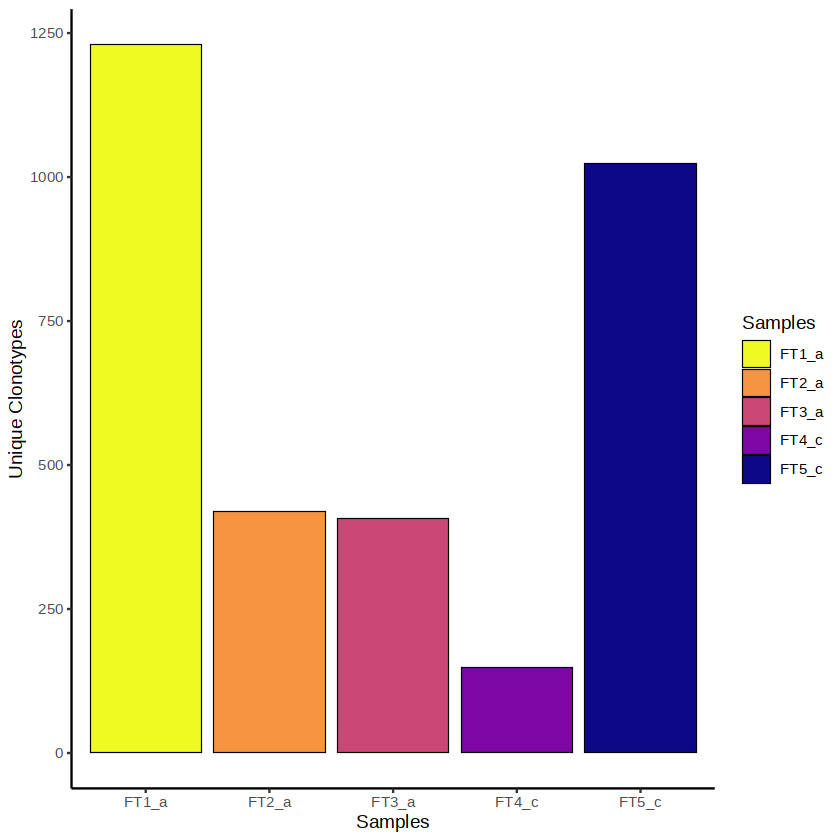

In [16]:
quantContig(combined,
           cloneCall = "strict",
           chain = c("both"),
           scale = F)
uniqueClonotype <- quantContig(combined,
           cloneCall = "strict",
           chain = c("both"),
           scale = F)

In [19]:
uniqueClonotype$data$total[1]+uniqueClonotype$data$total[2]+uniqueClonotype$data$total[3]
uniqueClonotype$data$total[4]+uniqueClonotype$data$total[5]

[1] 2954

[1] 1872

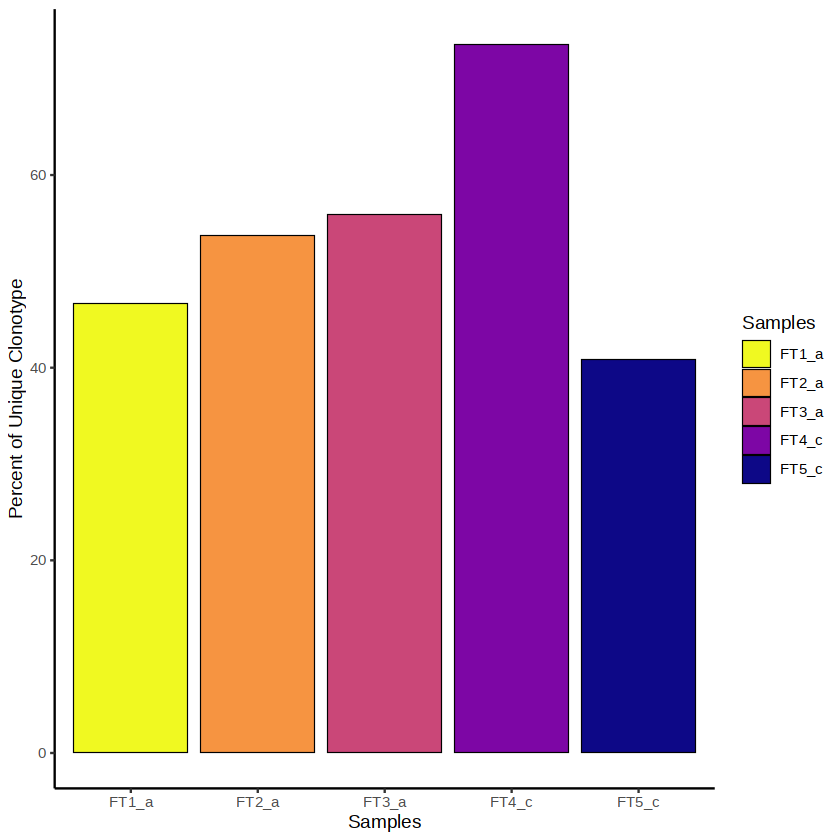

In [269]:
quantContig(combined,
           cloneCall = "strict",
           chain = c("TRA"),
           scale = T)

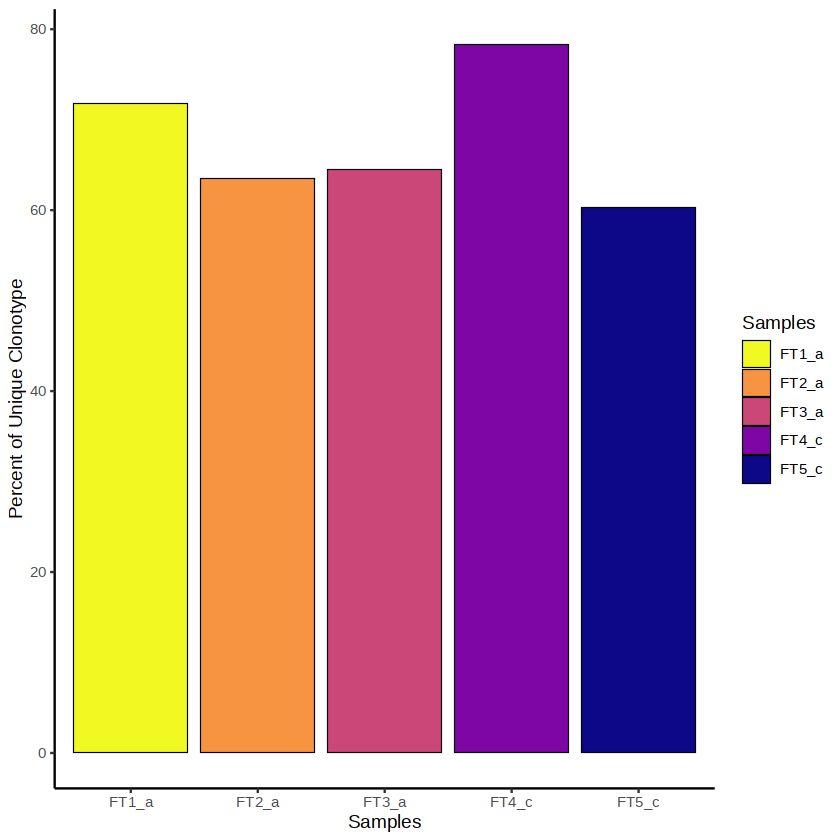

In [270]:
quantContig(combined,
           cloneCall = "strict",
           chain = c("TRB"),
           scale = T)

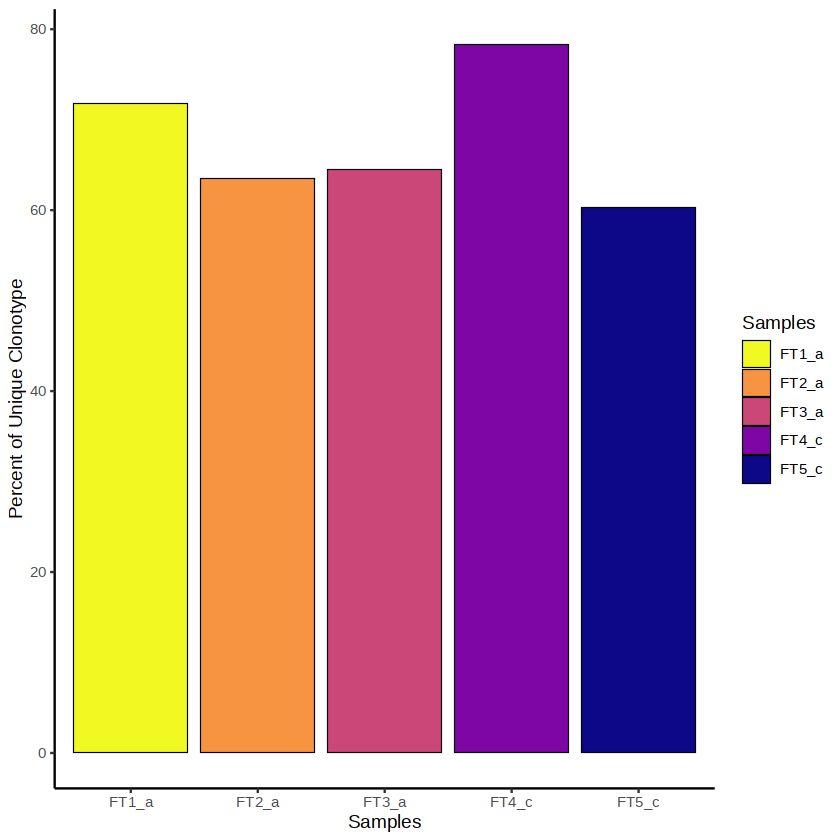

In [271]:
quantContig(combined,
           cloneCall = "strict",
           chain = c("TRD"),
           scale = T)

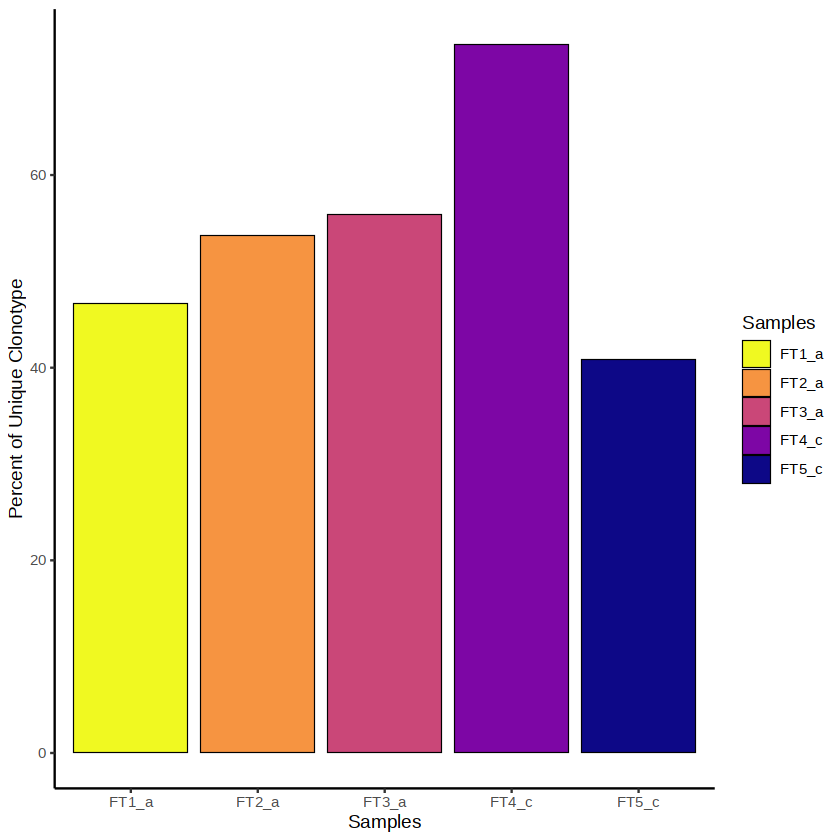

In [272]:
quantContig(combined,
           cloneCall = "strict",
           chain = c("TRG"),
           scale = T)

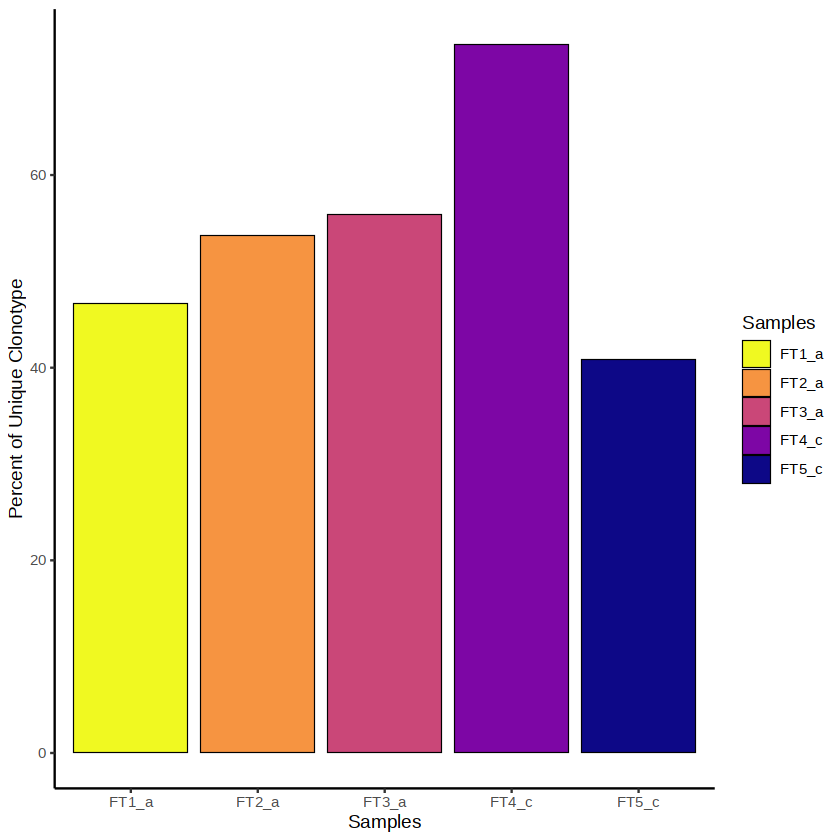

In [273]:
quantContig(combined,
           cloneCall = "strict",
           chain = c("IGH"),
           scale = T)

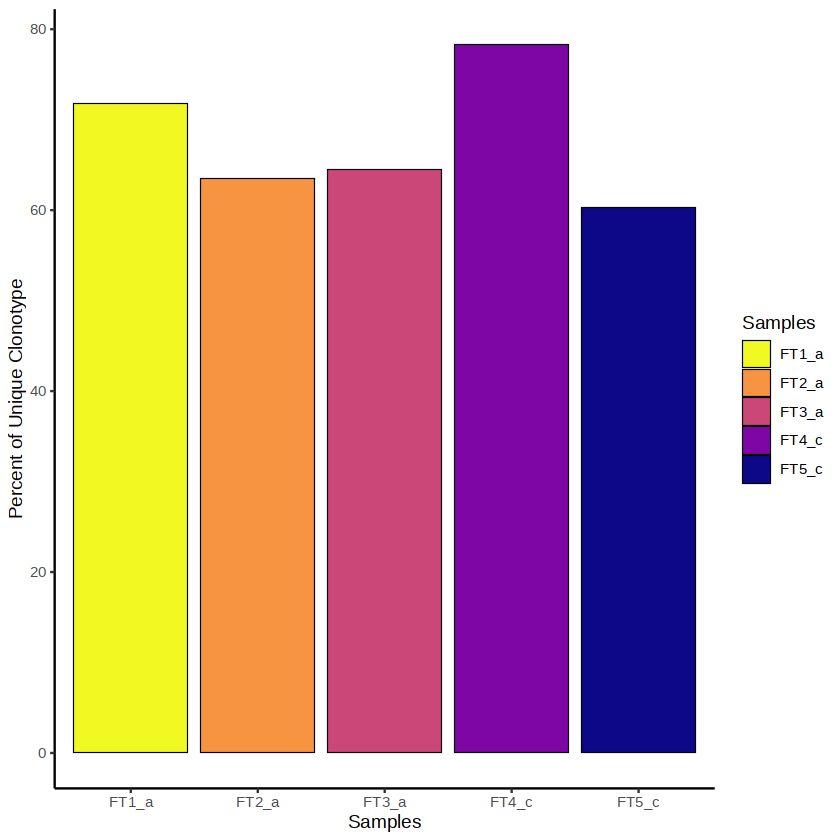

In [274]:
quantContig(combined,
           cloneCall = "strict",
           chain = c("IGL"),
           scale = T)

In [275]:
quantContig_output <- quantContig(combined, 
                                  cloneCall="strict", 
                                  scale = TRUE, 
                                  exportTable = TRUE)

quantContig_output

contigs,values,total,scaled
<int>,<chr>,<int>,<dbl>
1230,FT1_a,1687,72.91049
420,FT2_a,650,64.61538
407,FT3_a,617,65.96434
149,FT4_c,189,78.83598
1023,FT5_c,1683,60.78431


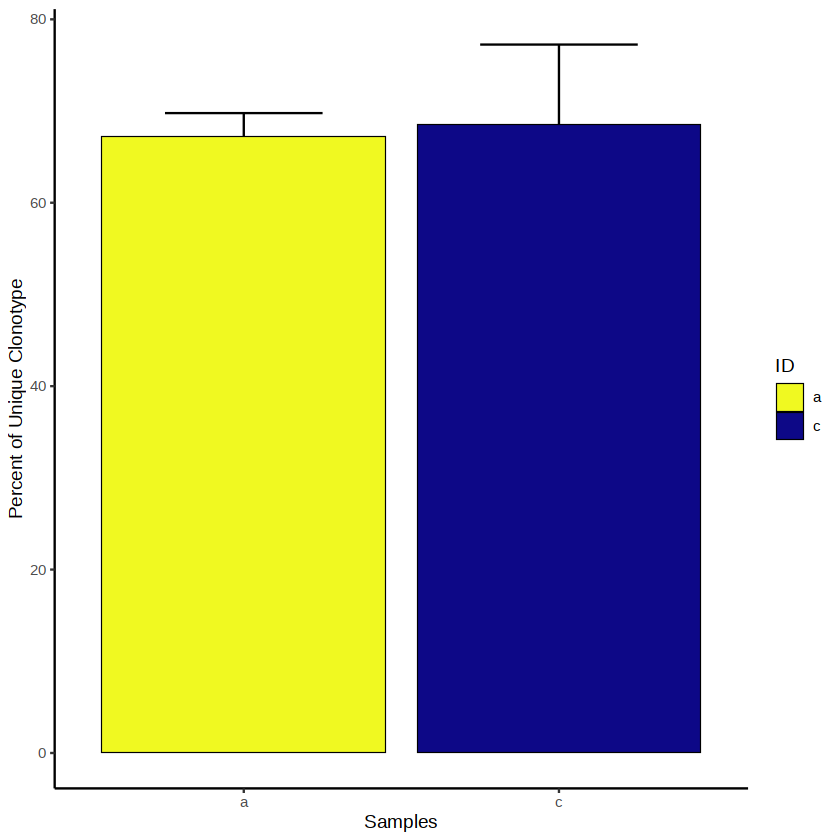

In [276]:
quantContig(combined, 
            cloneCall="gene", 
            group.by = "ID", 
            scale = TRUE)

Warning message:
“The dot-dot notation (`..scaled..`) was deprecated
in ggplot2 3.4.0.
ℹ Please use `after_stat(scaled)` instead.
ℹ The deprecated feature was likely used in the
  scRepertoire package.
  Please report the issue to the authors.”


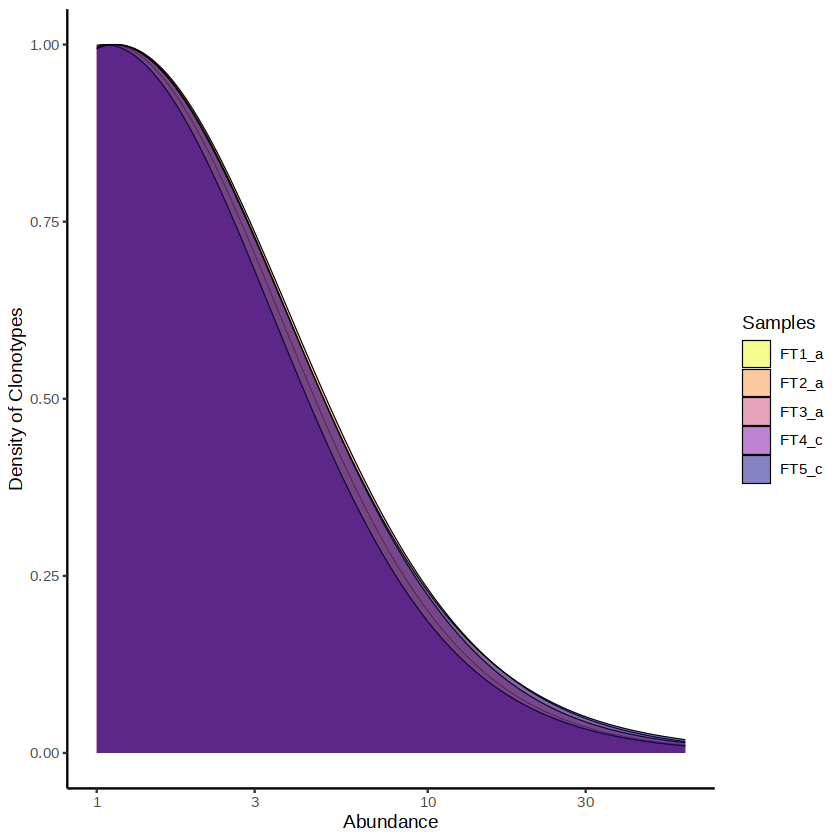

In [313]:
abundanceContig(combined, 
                cloneCall = "gene", 
                scale = TRUE)

In [47]:
abundance <- abundanceContig(combined, 
                cloneCall = "gene", 
                scale = FALSE,
                order = TRUE,
               exportTable = TRUE)

In [48]:
abundance <- abundanceContig(combined, 
                cloneCall = "gene", 
                scale = TRUE,
                order = TRUE,
               exportTable = TRUE)

In [49]:
FT1abundance <- subset(abundance, values == "FT1_a")
sort(FT1abundance$Abundance, decreasing=TRUE)
sum(FT1abundance$Abundance > 9)
FT1top10abundance <- subset(FT1abundance, Abundance > 9)
FT1top10abundance

[1] 40 21 20 16 15 15 13 11 10 10  9  9  8  8  7  7  7  6  6  6  6  6  6  5
  [25]  5  5  5  5  5  5  5  5  5  5  4  4  4  4  4  4  4  4  4  3  3  3  3  3
  [49]  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  2
  [73]  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2
  [97]  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2
 [121]  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2
 [145]  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2
 [169]  2  2  2  2  2  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
 [193]  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
 [217]  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
 [241]  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
 [265]  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
 [289]  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
 [313]  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
 [337]  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
 [361]  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
 [385]  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
 [409]  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
 [433]  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
 [457]  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
 [481]  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
 [505]  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
 [529]  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
 [553]  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
 [577]  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
 [601]  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
 [625]  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
 [649]  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
 [673]  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
 [697]  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
 [721]  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
 [745]  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
 [769]  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
 [793]  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
 [817]  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
 [841]  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
 [865]  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
 [889]  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
 [913]  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
 [937]  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
 [961]  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
 [985]  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
[1009]  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
[1033]  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
[1057]  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
[1081]  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
[1105]  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
[1129]  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
[1153]  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
[1177]  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
[1201]  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  

[1] 10

,CTgene,Abundance,values
,<chr>,<int>,<fct>
54,TRAV1-2.TRAJ48.TRAC_TRBV20-1.NA.TRBJ2-3.TRBC2,15,FT1_a
228,TRAV13-1.TRAJ23.TRAC_TRBV4-2.NA.TRBJ2-7.TRBC2,13,FT1_a
383,TRAV17.TRAJ28.TRAC_TRBV13.NA.TRBJ2-2.TRBC2,11,FT1_a
417,TRAV19.TRAJ13.TRAC_TRBV5-6.NA.TRBJ1-1.TRBC1,20,FT1_a
498,TRAV20.TRAJ23.TRAC_TRBV9.NA.TRBJ2-7.TRBC2,15,FT1_a
847,TRAV35.TRAJ40.TRAC_TRBV12-4.NA.TRBJ2-3.TRBC2,40,FT1_a
992,TRAV5.TRAJ11.TRAC_TRBV27.TRBD1.TRBJ1-4.TRBC1,10,FT1_a
994,TRAV5.TRAJ13.TRAC_TRBV7-9.NA.TRBJ2-3.TRBC2,21,FT1_a
1100,TRAV8-3.TRAJ43.TRAC_TRBV12-4.NA.TRBJ1-1.TRBC1,10,FT1_a


In [419]:
length(combined$FT1_a$CTgene)

[1] 1687

In [428]:
for(i in 1:length(combined$FT1_a$CTgene)){
    if(combined$FT1_a$CTgene[i] == FT1top10abundance$CTgene[1]) {
        CTaa <- combined$FT1_a$CTaa[i]
    }
}
CTaa

[1] "CAVGNFGNEKLTF_CSARAPWDITSTDTQYF"

In [51]:
FT2abundance <- subset(abundance, values == "FT2_a")
sort(FT2abundance$Abundance, decreasing=TRUE)
sum(FT2abundance$Abundance > 9)
FT2top10abundance <- subset(FT2abundance, Abundance > 5)
FT2top10abundance

[1] 28 23 13 10  9  9  8  8  7  6  6  6  5  5  5  5  4  4  4  4  4  4  4  3  3
 [26]  3  3  3  3  3  3  3  3  3  3  3  3  3  2  2  2  2  2  2  2  2  2  2  2  2
 [51]  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2
 [76]  2  2  2  2  2  2  2  2  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
[101]  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
[126]  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
[151]  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
[176]  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
[201]  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
[226]  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
[251]  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
[276]  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
[301]  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
[326]  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
[351]  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
[376]  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
[401]  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1

[1] 4

,CTgene,Abundance,values
,<chr>,<int>,<fct>
1221,TRAV1-1.TRAJ16.TRAC_TRBV4-1.NA.TRBJ2-7.TRBC2,28,FT2_a
1240,TRAV10.TRAJ20.TRAC_TRBV19.NA.TRBJ2-2.TRBC2,6,FT2_a
1257,TRAV12-1.TRAJ52.TRAC_TRBV27.NA.TRBJ1-1.TRBC1,8,FT2_a
1286,TRAV12-3.TRAJ50.TRAC_TRBV25-1.NA.TRBJ2-3.TRBC2,10,FT2_a
1355,TRAV17.TRAJ41.TRAC_TRBV5-8.NA.TRBJ1-5.TRBC1,13,FT2_a
1356,TRAV17.TRAJ42.TRAC_TRBV19.NA.TRBJ1-4.TRBC1,8,FT2_a
1383,TRAV2.TRAJ11.TRAC_TRBV9.NA.TRBJ2-1.TRBC2,9,FT2_a
1445,TRAV26-1.TRAJ37.TRAC_TRBV12-3.TRBD1.TRBJ1-2.TRBC1,7,FT2_a
1473,TRAV29/DV5.TRAJ43.TRAC_TRBV11-2.NA.TRBJ2-5.TRBC2,6,FT2_a


In [57]:
top10abundance_12 <- rbind(FT1top10abundance,FT2top10abundance)
top10abundance_12
top10abundance_34 <- rbind(FT3top10abundance,FT4top10abundance)
top10abundance_34

,CTgene,Abundance,values
,<chr>,<int>,<fct>
54,TRAV1-2.TRAJ48.TRAC_TRBV20-1.NA.TRBJ2-3.TRBC2,15,FT1_a
228,TRAV13-1.TRAJ23.TRAC_TRBV4-2.NA.TRBJ2-7.TRBC2,13,FT1_a
383,TRAV17.TRAJ28.TRAC_TRBV13.NA.TRBJ2-2.TRBC2,11,FT1_a
417,TRAV19.TRAJ13.TRAC_TRBV5-6.NA.TRBJ1-1.TRBC1,20,FT1_a
498,TRAV20.TRAJ23.TRAC_TRBV9.NA.TRBJ2-7.TRBC2,15,FT1_a
847,TRAV35.TRAJ40.TRAC_TRBV12-4.NA.TRBJ2-3.TRBC2,40,FT1_a
992,TRAV5.TRAJ11.TRAC_TRBV27.TRBD1.TRBJ1-4.TRBC1,10,FT1_a
994,TRAV5.TRAJ13.TRAC_TRBV7-9.NA.TRBJ2-3.TRBC2,21,FT1_a
1100,TRAV8-3.TRAJ43.TRAC_TRBV12-4.NA.TRBJ1-1.TRBC1,10,FT1_a


,CTgene,Abundance,values
,<chr>,<int>,<fct>
1642,TRAV1-2.TRAJ15.TRAC_TRBV7-9.NA.TRBJ2-1.TRBC2,6,FT3_a
1692,TRAV12-2.TRAJ52.TRAC_TRBV7-9.NA.TRBJ2-7.TRBC2,7,FT3_a
1703,TRAV12-3.TRAJ45.TRAC_TRBV20-1.NA.TRBJ2-1.TRBC2,6,FT3_a
1710,TRAV13-1.TRAJ10.TRAC_TRBV7-9.NA.TRBJ2-1.TRBC2,37,FT3_a
1795,TRAV19.TRAJ30.TRAC_TRBV5-1.NA.TRBJ1-1.TRBC1,30,FT3_a
1813,TRAV2.TRAJ34.TRAC_TRBV5-4.TRBD1.TRBJ1-2.TRBC1,7,FT3_a
1835,TRAV21.TRAJ40.TRAC_TRBV5-1.NA.TRBJ1-4.TRBC1,7,FT3_a
1837,TRAV21.TRAJ52.TRAC_TRBV7-9.NA.TRBJ2-3.TRBC2,7,FT3_a
1908,TRAV3.TRAJ20.TRAC_TRBV10-3.NA.TRBJ1-5.TRBC1,8,FT3_a


In [72]:
colnames(data_1_2)[2] <- c("CTgene")
colnames(data_3_4)[2] <- c("CTgene")

In [73]:
final_1_2 <- merge(top10abundance_12, data_1_2, by="CTgene")
final_3_4 <- merge(top10abundance_34, data_3_4, by="CTgene")
final_1_2;final_3_4

CTgene,Abundance,values,shared_clonotype1_2_aa
<chr>,<int>,<fct>,<chr>


CTgene,Abundance,values,shared_clonotype3_4_aa
<chr>,<int>,<fct>,<chr>


In [55]:
FT3abundance <- subset(abundance, values == "FT3_a")
sort(FT3abundance$Abundance, decreasing=TRUE)
sum(FT3abundance$Abundance > 9)
FT3top10abundance <- subset(FT3abundance, Abundance > 5)
FT3top10abundance

[1] 37 30  8  7  7  7  7  6  6  6  5  5  5  5  4  4  4  4  4  4  4  4  3  3  3
 [26]  3  3  3  3  3  3  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2
 [51]  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2
 [76]  2  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
[101]  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
[126]  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
[151]  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
[176]  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
[201]  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
[226]  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
[251]  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
[276]  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
[301]  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
[326]  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
[351]  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
[376]  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
[401]  1  1  1

[1] 2

,CTgene,Abundance,values
,<chr>,<int>,<fct>
1642,TRAV1-2.TRAJ15.TRAC_TRBV7-9.NA.TRBJ2-1.TRBC2,6,FT3_a
1692,TRAV12-2.TRAJ52.TRAC_TRBV7-9.NA.TRBJ2-7.TRBC2,7,FT3_a
1703,TRAV12-3.TRAJ45.TRAC_TRBV20-1.NA.TRBJ2-1.TRBC2,6,FT3_a
1710,TRAV13-1.TRAJ10.TRAC_TRBV7-9.NA.TRBJ2-1.TRBC2,37,FT3_a
1795,TRAV19.TRAJ30.TRAC_TRBV5-1.NA.TRBJ1-1.TRBC1,30,FT3_a
1813,TRAV2.TRAJ34.TRAC_TRBV5-4.TRBD1.TRBJ1-2.TRBC1,7,FT3_a
1835,TRAV21.TRAJ40.TRAC_TRBV5-1.NA.TRBJ1-4.TRBC1,7,FT3_a
1837,TRAV21.TRAJ52.TRAC_TRBV7-9.NA.TRBJ2-3.TRBC2,7,FT3_a
1908,TRAV3.TRAJ20.TRAC_TRBV10-3.NA.TRBJ1-5.TRBC1,8,FT3_a


In [56]:
FT4abundance <- subset(abundance, values == "FT4_c")
sort(FT4abundance$Abundance, decreasing=TRUE)
sum(FT4abundance$Abundance > 9)
FT4top10abundance <- subset(FT4abundance, Abundance > 1)
FT4top10abundance

[1] 10  8  8  7  6  2  2  2  2  2  2  2  2  2  1  1  1  1  1  1  1  1  1  1  1
 [26]  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
 [51]  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
 [76]  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
[101]  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
[126]  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1

[1] 1

,CTgene,Abundance,values
,<chr>,<int>,<fct>
2049,TRAV1-2.TRAJ34.TRAC_TRBV4-1.TRBD1.TRBJ1-5.TRBC1,10,FT4_c
2063,TRAV12-2.TRAJ3.TRAC_TRBV20-1.NA.TRBJ2-2.TRBC2,2,FT4_c
2088,TRAV14/DV4.TRAJ34.TRAC_TRBV2.TRBD1.TRBJ1-1.TRBC1,7,FT4_c
2089,TRAV14/DV4.TRAJ35.TRAC_TRBV20-1.TRBD2.TRBJ2-3.TRBC2,2,FT4_c
2090,TRAV14/DV4.TRAJ42.TRAC_TRBV15.NA.TRBJ1-5.TRBC1,2,FT4_c
2099,TRAV17.TRAJ49.TRAC_TRBV24-1.NA.TRBJ1-1.TRBC1,2,FT4_c
2123,TRAV25.TRAJ42.TRAC_TRBV19.NA.TRBJ1-1.TRBC1,2,FT4_c
2130,TRAV29/DV5.TRAJ32.TRAC_TRBV20-1.NA.TRBJ1-2.TRBC1,2,FT4_c
2141,TRAV35.TRAJ50.TRAC_TRBV12-4.NA.TRBJ1-2.TRBC1,6,FT4_c


In [349]:
FT5abundance <- subset(abundance, values == "FT5_c")
sort(FT5abundance$Abundance, decreasing=TRUE)
sum(FT5abundance$Abundance > 9)
FT5top10abundance <- subset(FT5abundance, Abundance > 12)
FT5top10abundance

[1] 60 55 39 20 19 17 16 16 16 13 12 12 11 11 11 11  9  9  9  9  8  8  8  8
  [25]  6  6  6  6  6  6  6  6  5  5  5  5  5  5  5  5  5  5  5  5  5  4  4  4
  [49]  4  4  4  4  4  4  4  4  4  4  4  4  4  3  3  3  3  3  3  3  3  3  3  3
  [73]  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  2  2  2  2
  [97]  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2
 [121]  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2
 [145]  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2
 [169]  2  2  2  2  2  2  2  2  2  2  2  2  2  2  1  1  1  1  1  1  1  1  1  1
 [193]  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
 [217]  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
 [241]  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
 [265]  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
 [289]  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
 [313]  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
 [337]  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
 [361]  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
 [385]  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
 [409]  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
 [433]  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
 [457]  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
 [481]  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
 [505]  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
 [529]  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
 [553]  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
 [577]  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
 [601]  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
 [625]  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
 [649]  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
 [673]  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
 [697]  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
 [721]  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
 [745]  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
 [769]  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
 [793]  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
 [817]  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
 [841]  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
 [865]  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
 [889]  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
 [913]  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
 [937]  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
 [961]  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
 [985]  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1

[1] 16

,CTgene,Abundance,values
,<chr>,<int>,<fct>
2195,TRAV1-1.TRAJ24.TRAC_TRBV6-4.NA.TRBJ1-1.TRBC1,17,FT5_c
2205,TRAV1-1.TRAJ9.TRAC_TRBV20-1.NA.TRBJ1-3.TRBC1,39,FT5_c
2239,TRAV1-2.TRAJ33.TRAC_TRBV4-3.TRBD1.TRBJ1-2.TRBC1,13,FT5_c
2270,TRAV10.TRAJ42.TRAC_TRBV5-1.NA.TRBJ2-1.TRBC2,55,FT5_c
2479,TRAV14/DV4.TRAJ44.TRAC_TRBV7-9.NA.TRBJ2-1.TRBC2,16,FT5_c
2485,TRAV14/DV4.TRAJ49.TRAC_TRBV10-2.NA.TRBJ2-1.TRBC2,16,FT5_c
2519,TRAV17.TRAJ20.TRAC_TRBV20-1.NA.TRBJ1-4.TRBC1,16,FT5_c
2721,TRAV25.TRAJ13.TRAC_TRBV7-9.TRBD1.TRBJ2-1.TRBC2,20,FT5_c
3052,TRAV8-2.TRAJ23.TRAC_TRBV6-2.NA.TRBJ2-5.TRBC2,19,FT5_c


In [354]:
length(FT1abundance$Abundance)
length(FT2abundance$Abundance)
length(FT3abundance$Abundance)
length(FT4abundance$Abundance)
length(FT5abundance$Abundance)

[1] 1219

[1] 417

[1] 403

[1] 146

[1] 1008

In [355]:
sum(FT1abundance$Abundance>9)
sum(FT2abundance$Abundance>9)
sum(FT3abundance$Abundance>9)
sum(FT4abundance$Abundance>9)
sum(FT5abundance$Abundance>9)

[1] 10

[1] 4

[1] 2

[1] 1

[1] 16

In [440]:
f1 <- rbind(FT1top10abundance,FT2top10abundance)
f2 <- rbind(f1,FT3top10abundance)
f3 <- rbind(f2,FT4top10abundance)
f4 <- rbind(f3,FT5top10abundance)
f4
nrow(f4)

,CTgene,Abundance,values
,<chr>,<int>,<fct>
54,TRAV1-2.TRAJ48.TRAC_TRBV20-1.NA.TRBJ2-3.TRBC2,15,FT1_a
228,TRAV13-1.TRAJ23.TRAC_TRBV4-2.NA.TRBJ2-7.TRBC2,13,FT1_a
383,TRAV17.TRAJ28.TRAC_TRBV13.NA.TRBJ2-2.TRBC2,11,FT1_a
417,TRAV19.TRAJ13.TRAC_TRBV5-6.NA.TRBJ1-1.TRBC1,20,FT1_a
498,TRAV20.TRAJ23.TRAC_TRBV9.NA.TRBJ2-7.TRBC2,15,FT1_a
847,TRAV35.TRAJ40.TRAC_TRBV12-4.NA.TRBJ2-3.TRBC2,40,FT1_a
992,TRAV5.TRAJ11.TRAC_TRBV27.TRBD1.TRBJ1-4.TRBC1,10,FT1_a
994,TRAV5.TRAJ13.TRAC_TRBV7-9.NA.TRBJ2-3.TRBC2,21,FT1_a
1100,TRAV8-3.TRAJ43.TRAC_TRBV12-4.NA.TRBJ1-1.TRBC1,10,FT1_a


[1] 56

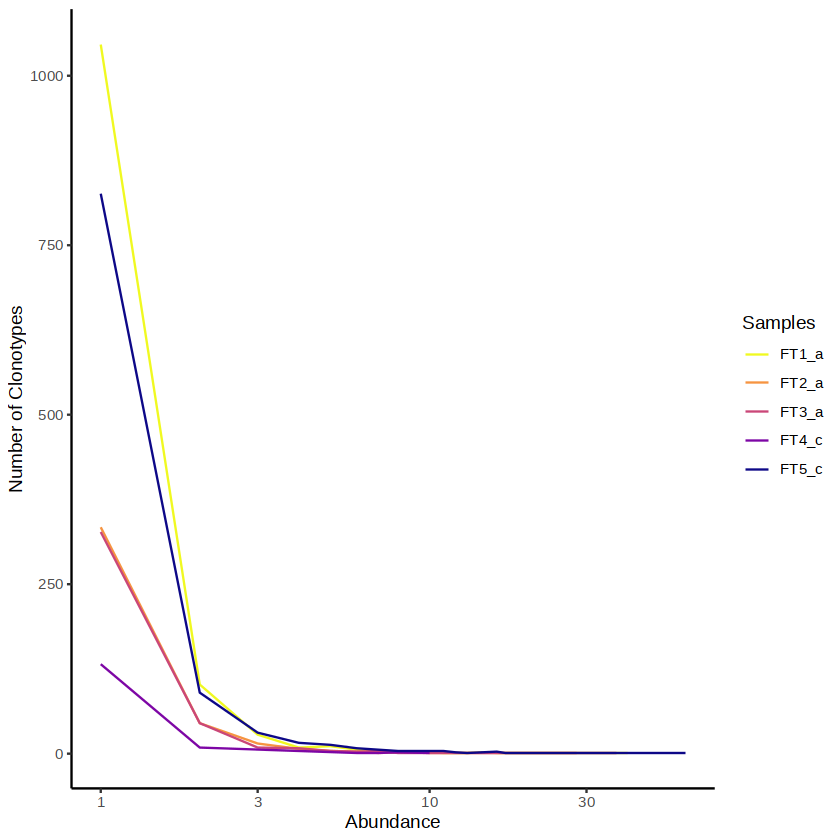

In [311]:
abundanceContig(combined, 
                cloneCall = "gene",
                scale = FALSE)

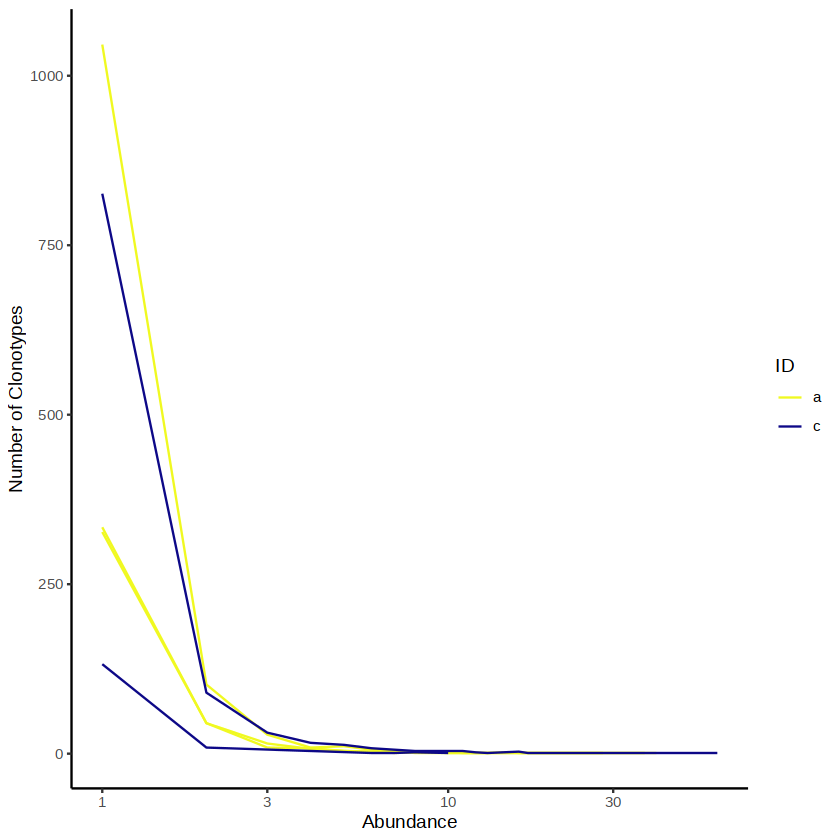

In [278]:
abundanceContig(combined, 
                cloneCall = "gene", 
                group.by = "ID", 
                scale = FALSE)

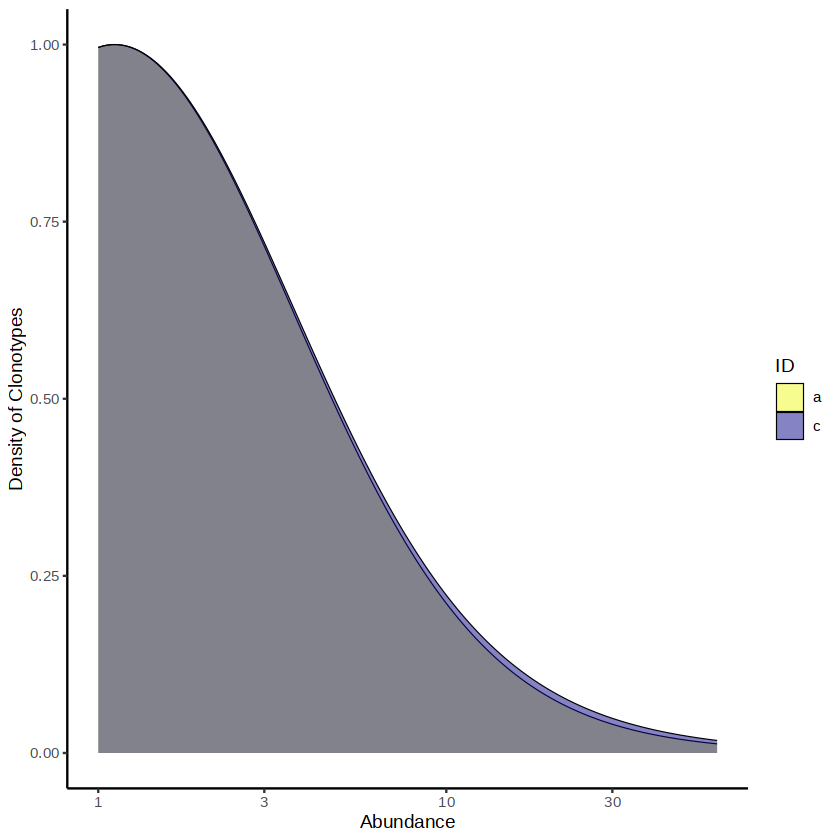

In [279]:
abundanceContig(combined,
                cloneCall="gene",
                group.by = "ID", 
                scale = TRUE)

In [377]:
length <- lengthContig(combined, cloneCall="aa", chain="both", group.by = "sample", exportTable = TRUE)

In [378]:
unique(length)

,length,CT,sample,values
,<int>,<chr>,<chr>,<chr>
1,29,CAAIRYTGTASKLTF_CATSDKYLNQPQHF,FT1,FT1_a
2,30,CGTEIYNQGGKLIF_CASSVGPQVGNYGYTF,FT1,FT1_a
3,29,CALRRSGGSNYKLTF_CSVEGGLSSGTQYF,FT1,FT1_a
4,28,CAVSMNRDDKIIF_CASSLAGSTNEKLFF,FT1,FT1_a
5,33,CVVRRDNYGQNFVF_CASSYLPSGLAPMNTEAFF,FT1,FT1_a
6,28,CAGQAGANSKLTF_CSARPGNRGKETQYF,FT1,FT1_a
7,28,CAVEPNDYKLSF_CASSLSGGAYTGELFF,FT1,FT1_a
8,30,CAVGANSGYALNF_CASSFDLVGLVNTEAFF,FT1,FT1_a
9,28,CAVGDSGGYNKLIF_CASSPRVGANVLTF,FT1,FT1_a


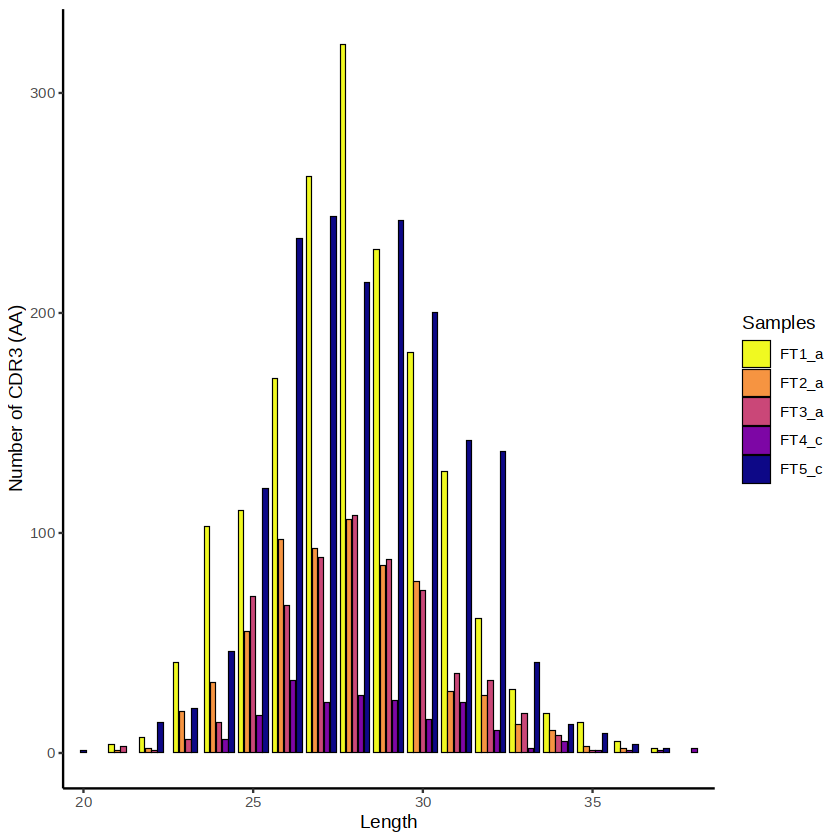

In [372]:
lengthContig(combined, 
             cloneCall = "aa", 
             chain = "both") 

Warning message:
“The dot-dot notation (`..scaled..`) was deprecated in ggplot2 3.4.0.
ℹ Please use `after_stat(scaled)` instead.
ℹ The deprecated feature was likely used in the scRepertoire package.
  Please report the issue to the authors.”


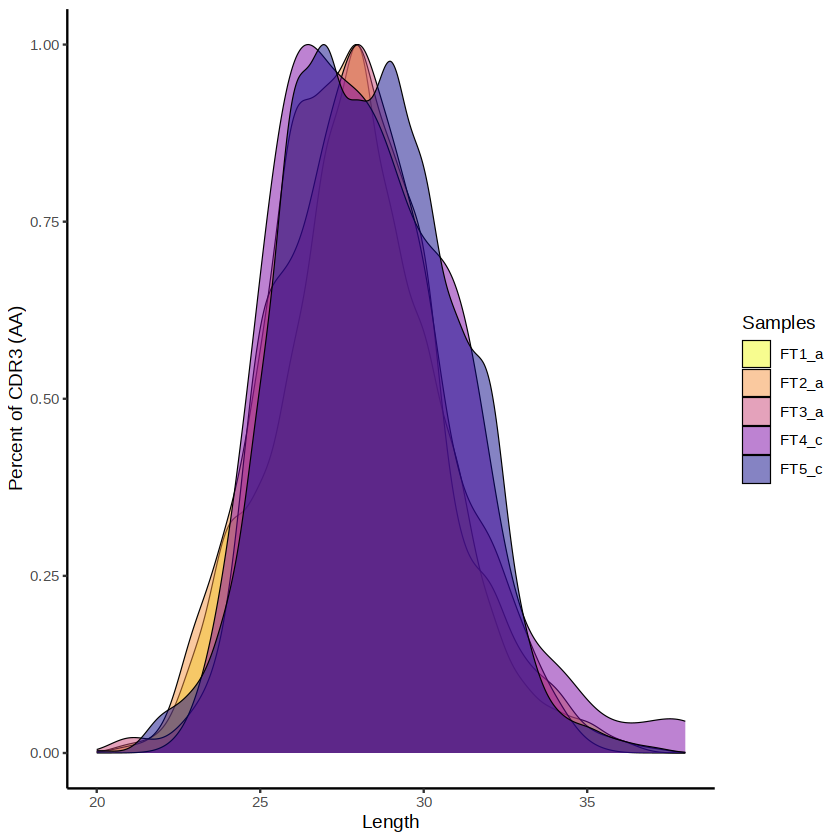

In [4]:
lengthContig(combined, 
             cloneCall = "aa", 
             chain = "both",
            scale=TRUE) 

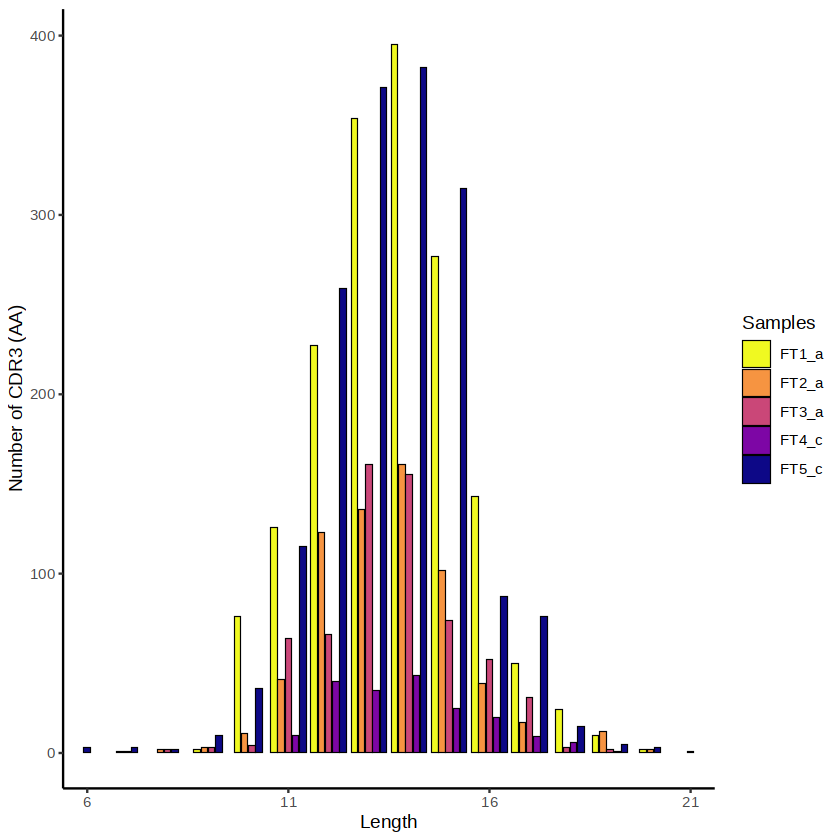

In [36]:
lengthContig(combined, 
             cloneCall = "aa", 
             chain = "TRA") 

Warning message:
“The dot-dot notation (`..scaled..`) was deprecated in ggplot2 3.4.0.
ℹ Please use `after_stat(scaled)` instead.
ℹ The deprecated feature was likely used in the scRepertoire package.
  Please report the issue to the authors.”


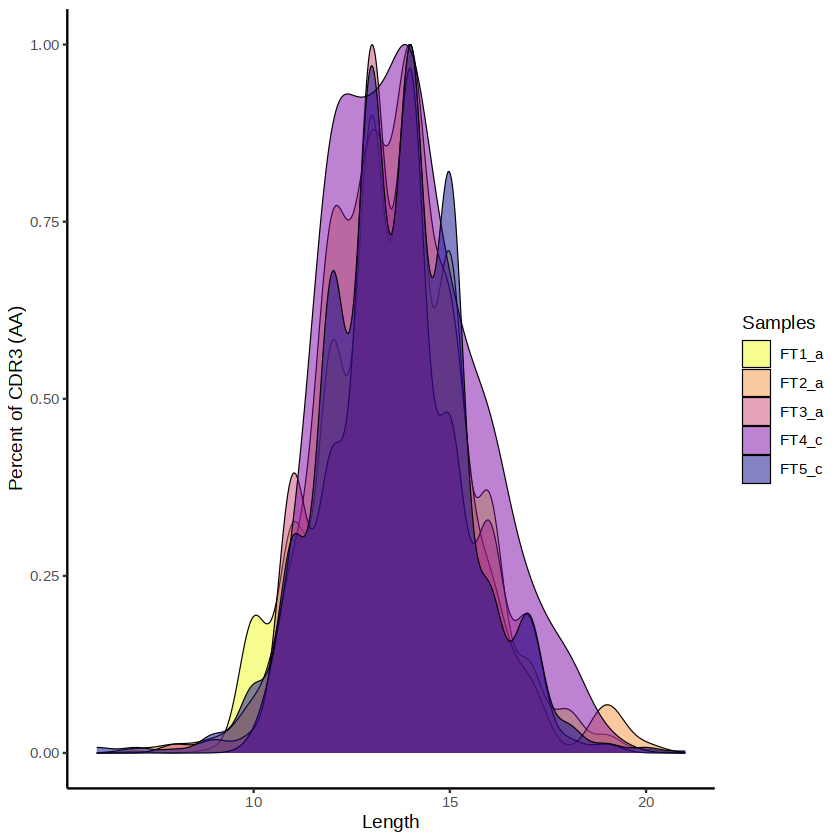

In [77]:
lengthContig(combined, 
             cloneCall = "aa", 
             chain = "TRA",
            scale=TRUE) 

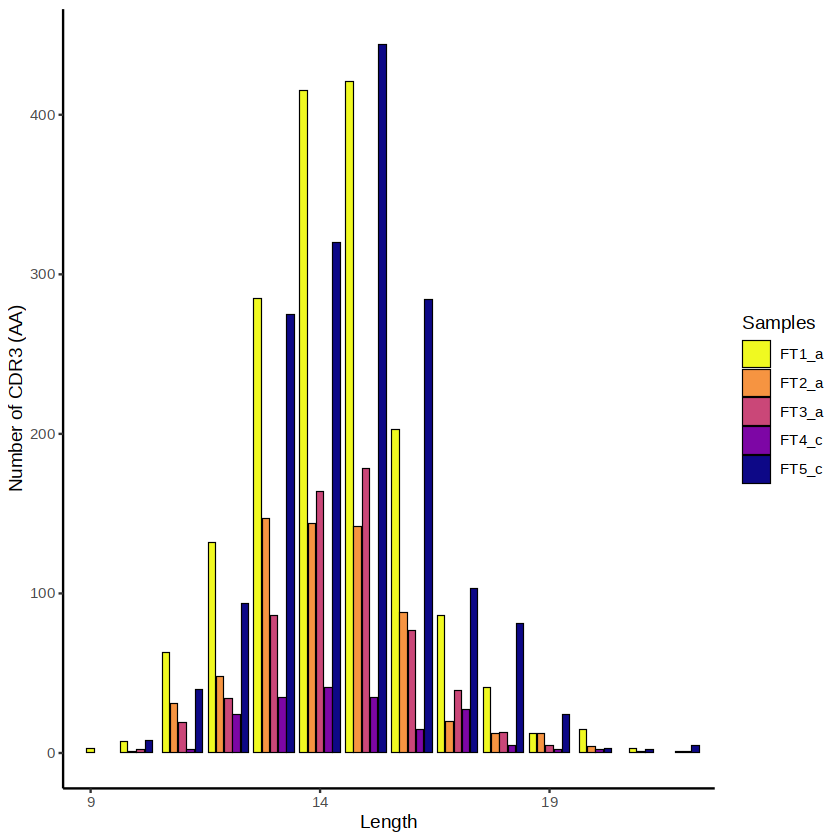

In [282]:
lengthContig(combined, 
             cloneCall = "aa", 
             chain = "TRB") 

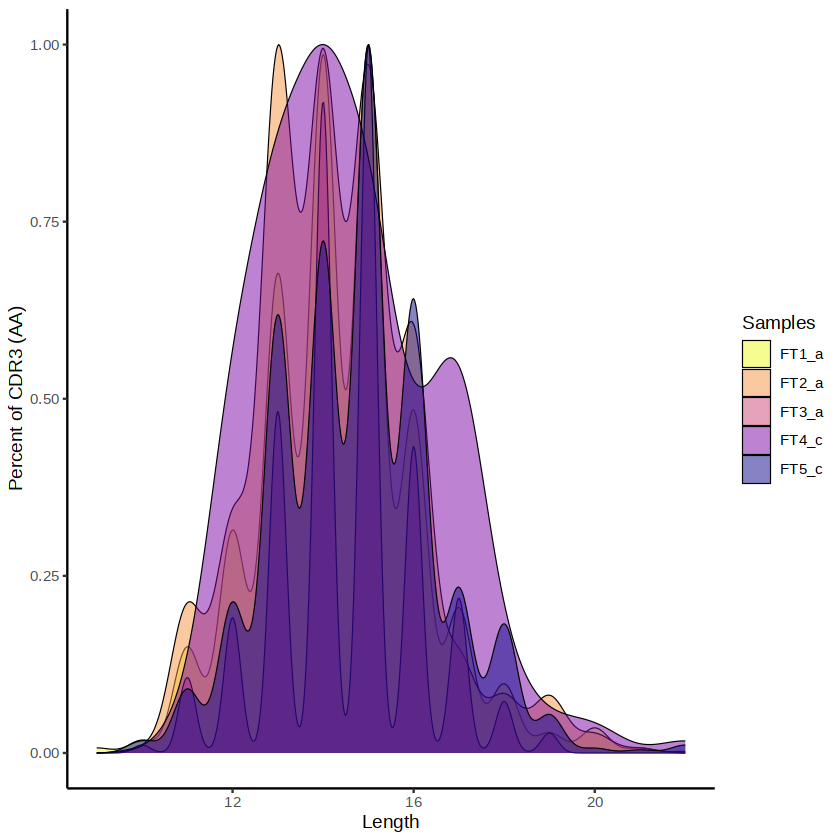

In [79]:
lengthContig(combined, 
             cloneCall = "aa", 
             chain = "TRB",
            scale=TRUE) 

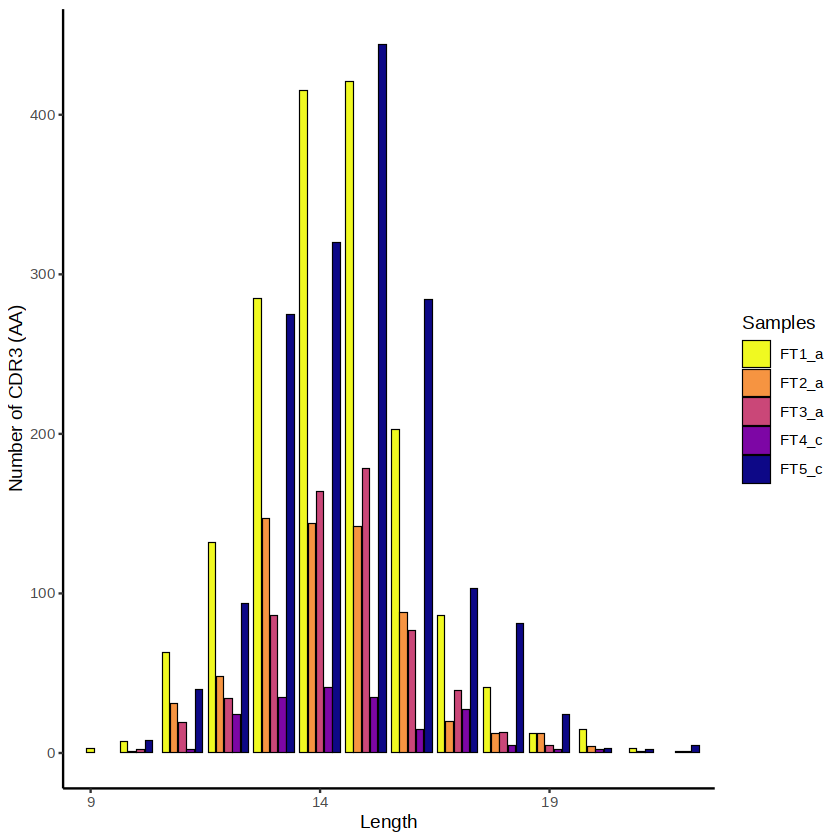

In [283]:
lengthContig(combined, 
             cloneCall = "aa", 
             chain = "TRD") 

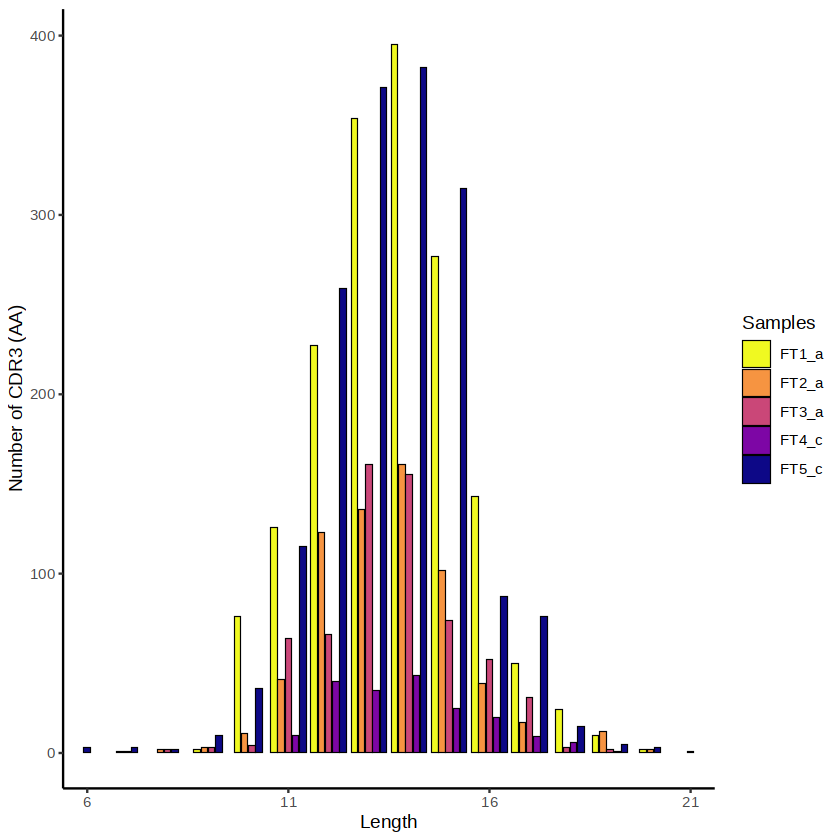

In [284]:
lengthContig(combined, 
             cloneCall = "aa", 
             chain = "TRG") 

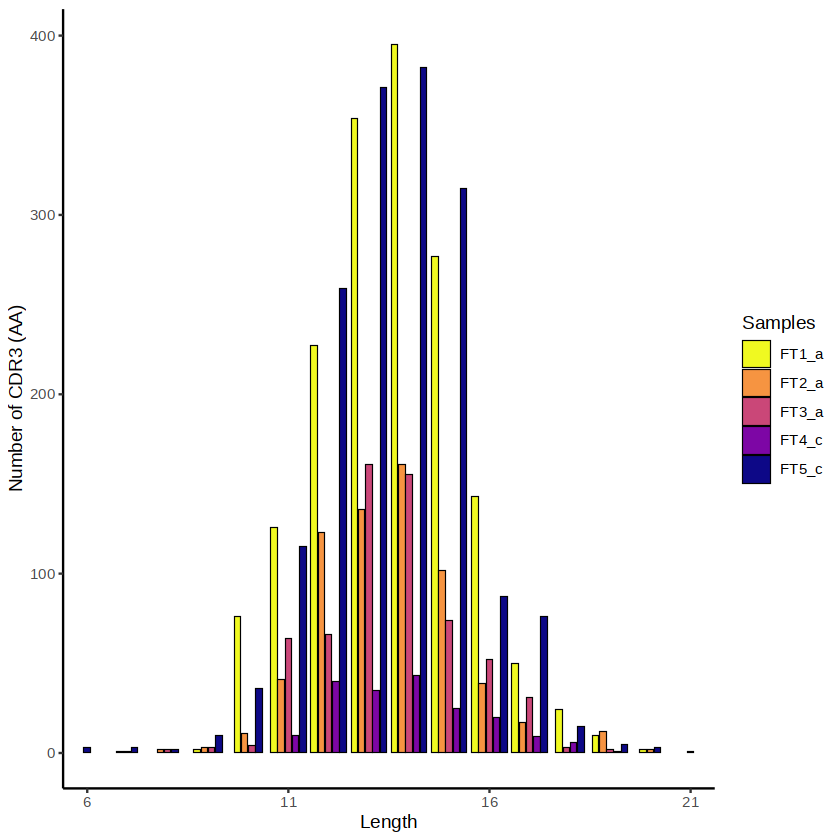

In [285]:
lengthContig(combined, 
             cloneCall = "aa", 
             chain = "IGH") 

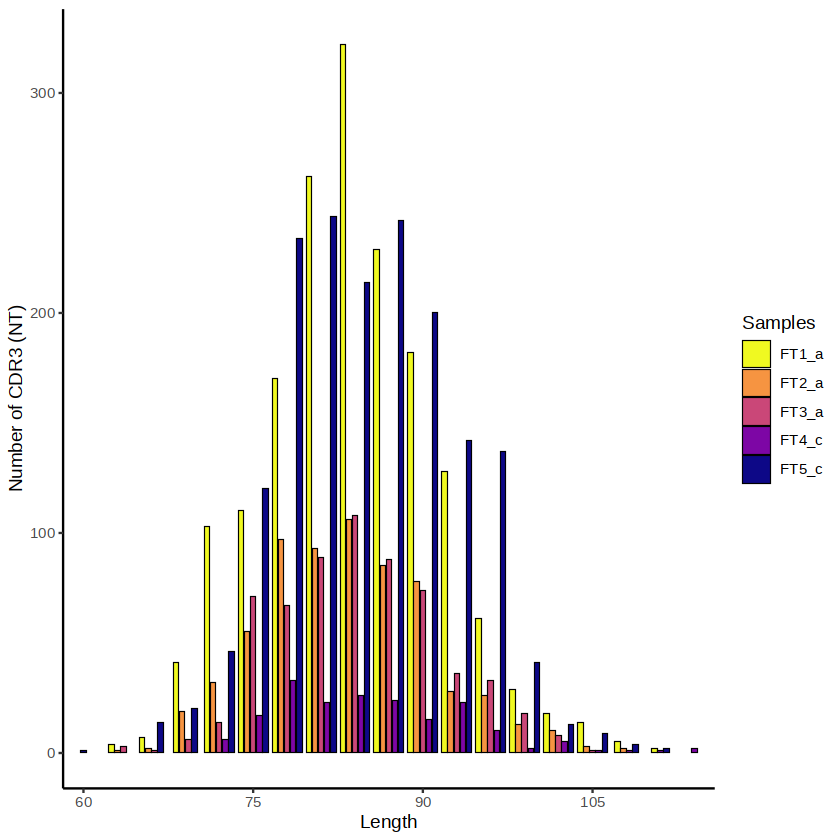

In [12]:
lengthContig(combined, 
             cloneCall = "nt", 
             chain = "both") 

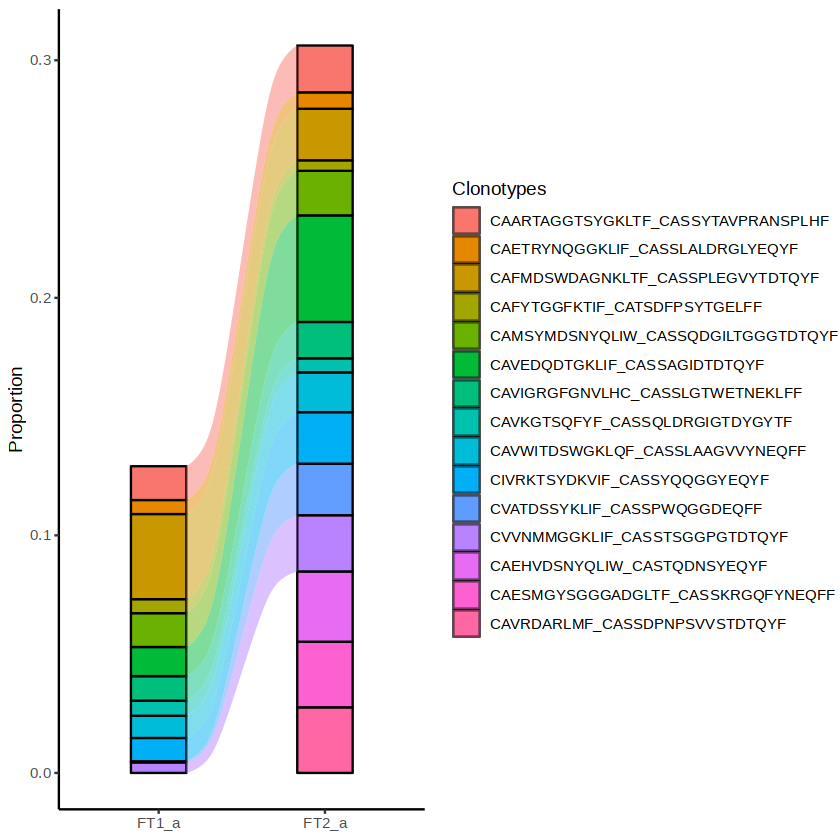

In [6]:
compareClonotypes(combined, 
                  numbers = 10, 
                  samples = c("FT1_a", "FT2_a"), 
                  cloneCall="aa", 
                  graph = "alluvial")
#data("contig_list") 필요

In [7]:
clonotype <- compareClonotypes(combined, 
                  numbers = 10, 
                  samples = c("FT1_a", "FT2_a"), 
                  cloneCall="aa", 
                  graph = "alluvial")
clonotype_FT1 <- subset(clonotype$data, subset=clonotype$data$Sample == "FT1_a")
clonotype_FT2 <- subset(clonotype$data, subset=clonotype$data$Sample == "FT2_a")
shared_clonotype1_2 <- merge(clonotype_FT1,clonotype_FT2, by="Clonotypes")
shared_clonotype1_2

shared_clonotype1_2_aa <- shared_clonotype1_2$Clonotypes
shared_clonotype1_2_aa

Clonotypes,Proportion.x,Sample.x,Proportion.y,Sample.y
<fct>,<dbl>,<chr>,<dbl>,<chr>
CAARTAGGTSYGKLTF_CASSYTAVPRANSPLHF,0.014236622,FT1_a,0.019723866,FT2_a
CAETRYNQGGKLIF_CASSLALDRGLYEQYF,0.005891016,FT1_a,0.006903353,FT2_a
CAFMDSWDAGNKLTF_CASSPLEGVYTDTQYF,0.035837015,FT1_a,0.021696252,FT2_a
CAFYTGGFKTIF_CATSDFPSYTGELFF,0.005891016,FT1_a,0.004437870,FT2_a
CAMSYMDSNYQLIW_CASSQDGILTGGGTDTQYF,0.014236622,FT1_a,0.018737673,FT2_a
CAVEDQDTGKLIF_CASSAGIDTDTQYF,0.012272950,FT1_a,0.044871795,FT2_a
CAVIGRGFGNVLHC_CASSLGTWETNEKLFF,0.010309278,FT1_a,0.015285996,FT2_a
CAVKGTSQFYF_CASSQLDRGIGTDYGYTF,0.006381934,FT1_a,0.005917160,FT2_a
CAVWITDSWGKLQF_CASSLAAGVVYNEQFF,0.009327442,FT1_a,0.016765286,FT2_a


[1] CAARTAGGTSYGKLTF_CASSYTAVPRANSPLHF CAETRYNQGGKLIF_CASSLALDRGLYEQYF   
 [3] CAFMDSWDAGNKLTF_CASSPLEGVYTDTQYF   CAFYTGGFKTIF_CATSDFPSYTGELFF      
 [5] CAMSYMDSNYQLIW_CASSQDGILTGGGTDTQYF CAVEDQDTGKLIF_CASSAGIDTDTQYF      
 [7] CAVIGRGFGNVLHC_CASSLGTWETNEKLFF    CAVKGTSQFYF_CASSQLDRGIGTDYGYTF    
 [9] CAVWITDSWGKLQF_CASSLAAGVVYNEQFF    CIVRKTSYDKVIF_CASSYQQGGYEQYF      
[11] CVATDSSYKLIF_CASSPWQGGDEQFF        CVVNMMGGKLIF_CASSTSGGPGTDTQYF     
4131 Levels: CAAAETSGSRLTF_CASSHGRAGYNEQFF ... CVVWGTMGTTDSLL_CASSVRLAGDGEQYF

In [24]:
colnames(shared_clonotype1_2) = c("CTaa","Proportion.x","Sample.x","Proportion.y","Sample.y")
total1_2 <- merge(shared_clonotype1_2, combined$FT1_a, by="CTaa")
total1_2
unique(total1_2$TCR2)

CTaa,Proportion.x,Sample.x,Proportion.y,Sample.y,barcode,sample,ID,TCR1,cdr3_aa1,cdr3_nt1,TCR2,cdr3_aa2,cdr3_nt2,CTgene,CTnt,CTstrict,cellType
<fct>,<dbl>,<chr>,<dbl>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>
CAARTAGGTSYGKLTF_CASSYTAVPRANSPLHF,0.014236622,FT1_a,0.019723866,FT2_a,FT1_a_TTCTACAGTCGTCTTC,FT1,a,TRAV29DV5.TRAJ52.TRAC,CAARTAGGTSYGKLTF,TGTGCAGCACGAACTGCTGGTGGTACTAGCTATGGAAAGCTGACATTT,TRBV6-5.None.TRBJ1-6.TRBC1,CASSYTAVPRANSPLHF,TGTGCCAGCAGTTACACGGCCGTCCCCAGAGCTAATTCACCCCTCCACTTT,TRAV29DV5.TRAJ52.TRAC_TRBV6-5.None.TRBJ1-6.TRBC1,TGTGCAGCACGAACTGCTGGTGGTACTAGCTATGGAAAGCTGACATTT_TGTGCCAGCAGTTACACGGCCGTCCCCAGAGCTAATTCACCCCTCCACTTT,TRAV29DV5.TRAJ52.TRAC_TGTGCAGCACGAACTGCTGGTGGTACTAGCTATGGAAAGCTGACATTT_TRBV6-5.None.TRBJ1-6.TRBC1_TGTGCCAGCAGTTACACGGCCGTCCCCAGAGCTAATTCACCCCTCCACTTT,T-AB
CAARTAGGTSYGKLTF_CASSYTAVPRANSPLHF,0.014236622,FT1_a,0.019723866,FT2_a,FT1_a_ACCGTAAAGGGATGGG,FT1,a,TRAV29DV5.TRAJ52.TRAC,CAARTAGGTSYGKLTF,TGTGCAGCACGAACTGCTGGTGGTACTAGCTATGGAAAGCTGACATTT,TRBV6-5.None.TRBJ1-6.TRBC1,CASSYTAVPRANSPLHF,TGTGCCAGCAGTTACACGGCCGTCCCCAGAGCTAATTCACCCCTCCACTTT,TRAV29DV5.TRAJ52.TRAC_TRBV6-5.None.TRBJ1-6.TRBC1,TGTGCAGCACGAACTGCTGGTGGTACTAGCTATGGAAAGCTGACATTT_TGTGCCAGCAGTTACACGGCCGTCCCCAGAGCTAATTCACCCCTCCACTTT,TRAV29DV5.TRAJ52.TRAC_TGTGCAGCACGAACTGCTGGTGGTACTAGCTATGGAAAGCTGACATTT_TRBV6-5.None.TRBJ1-6.TRBC1_TGTGCCAGCAGTTACACGGCCGTCCCCAGAGCTAATTCACCCCTCCACTTT,T-AB
CAARTAGGTSYGKLTF_CASSYTAVPRANSPLHF,0.014236622,FT1_a,0.019723866,FT2_a,FT1_a_TTAGGCATCACCCGAG,FT1,a,TRAV29DV5.TRAJ52.TRAC,CAARTAGGTSYGKLTF,TGTGCAGCACGAACTGCTGGTGGTACTAGCTATGGAAAGCTGACATTT,TRBV6-5.None.TRBJ1-6.TRBC1,CASSYTAVPRANSPLHF,TGTGCCAGCAGTTACACGGCCGTCCCCAGAGCTAATTCACCCCTCCACTTT,TRAV29DV5.TRAJ52.TRAC_TRBV6-5.None.TRBJ1-6.TRBC1,TGTGCAGCACGAACTGCTGGTGGTACTAGCTATGGAAAGCTGACATTT_TGTGCCAGCAGTTACACGGCCGTCCCCAGAGCTAATTCACCCCTCCACTTT,TRAV29DV5.TRAJ52.TRAC_TGTGCAGCACGAACTGCTGGTGGTACTAGCTATGGAAAGCTGACATTT_TRBV6-5.None.TRBJ1-6.TRBC1_TGTGCCAGCAGTTACACGGCCGTCCCCAGAGCTAATTCACCCCTCCACTTT,T-AB
CAARTAGGTSYGKLTF_CASSYTAVPRANSPLHF,0.014236622,FT1_a,0.019723866,FT2_a,FT1_a_GAATGAAAGTTAACGA,FT1,a,TRAV29DV5.TRAJ52.TRAC,CAARTAGGTSYGKLTF,TGTGCAGCACGAACTGCTGGTGGTACTAGCTATGGAAAGCTGACATTT,TRBV6-5.None.TRBJ1-6.TRBC1,CASSYTAVPRANSPLHF,TGTGCCAGCAGTTACACGGCCGTCCCCAGAGCTAATTCACCCCTCCACTTT,TRAV29DV5.TRAJ52.TRAC_TRBV6-5.None.TRBJ1-6.TRBC1,TGTGCAGCACGAACTGCTGGTGGTACTAGCTATGGAAAGCTGACATTT_TGTGCCAGCAGTTACACGGCCGTCCCCAGAGCTAATTCACCCCTCCACTTT,TRAV29DV5.TRAJ52.TRAC_TGTGCAGCACGAACTGCTGGTGGTACTAGCTATGGAAAGCTGACATTT_TRBV6-5.None.TRBJ1-6.TRBC1_TGTGCCAGCAGTTACACGGCCGTCCCCAGAGCTAATTCACCCCTCCACTTT,T-AB
CAARTAGGTSYGKLTF_CASSYTAVPRANSPLHF,0.014236622,FT1_a,0.019723866,FT2_a,FT1_a_ACGGGCTGTCAGAGGT,FT1,a,TRAV29DV5.TRAJ52.TRAC,CAARTAGGTSYGKLTF,TGTGCAGCACGAACTGCTGGTGGTACTAGCTATGGAAAGCTGACATTT,TRBV6-5.None.TRBJ1-6.TRBC1,CASSYTAVPRANSPLHF,TGTGCCAGCAGTTACACGGCCGTCCCCAGAGCTAATTCACCCCTCCACTTT,TRAV29DV5.TRAJ52.TRAC_TRBV6-5.None.TRBJ1-6.TRBC1,TGTGCAGCACGAACTGCTGGTGGTACTAGCTATGGAAAGCTGACATTT_TGTGCCAGCAGTTACACGGCCGTCCCCAGAGCTAATTCACCCCTCCACTTT,TRAV29DV5.TRAJ52.TRAC_TGTGCAGCACGAACTGCTGGTGGTACTAGCTATGGAAAGCTGACATTT_TRBV6-5.None.TRBJ1-6.TRBC1_TGTGCCAGCAGTTACACGGCCGTCCCCAGAGCTAATTCACCCCTCCACTTT,T-AB
CAARTAGGTSYGKLTF_CASSYTAVPRANSPLHF,0.014236622,FT1_a,0.019723866,FT2_a,FT1_a_GCATACAAGGTAGCTG,FT1,a,TRAV29DV5.TRAJ52.TRAC,CAARTAGGTSYGKLTF,TGTGCAGCACGAACTGCTGGTGGTACTAGCTATGGAAAGCTGACATTT,TRBV6-5.None.TRBJ1-6.TRBC1,CASSYTAVPRANSPLHF,TGTGCCAGCAGTTACACGGCCGTCCCCAGAGCTAATTCACCCCTCCACTTT,TRAV29DV5.TRAJ52.TRAC_TRBV6-5.None.TRBJ1-6.TRBC1,TGTGCAGCACGAACTGCTGGTGGTACTAGCTATGGAAAGCTGACATTT_TGTGCCAGCAGTTACACGGCCGTCCCCAGAGCTAATTCACCCCTCCACTTT,TRAV29DV5.TRAJ52.TRAC_TGTGCAGCACGAACTGCTGGTGGTACTAGCTATGGAAAGCTGACATTT_TRBV6-5.None.TRBJ1-6.TRBC1_TGTGCCAGCAGTTACACGGCCGTCCCCAGAGCTAATTCACCCCTCCACTTT,T-AB
CAARTAGGTSYGKLTF_CASSYTAVPRANSPLHF,0.014236622,FT1_a,0.019723866,FT2_a,FT1_a_GATCTAGTCACATGCA,FT1,a,TRAV29DV5.TRAJ52.TRAC,CAARTAGGTSYGKLTF,TGTGCAGCACGAACTGCTGGTGGTACTAGCTATGGAAAGCTGACATTT,TRBV6-5.None.TRBJ1-6.

[1] "TRBV6-5.None.TRBJ1-6.TRBC1"   "TRBV11-1.TRBD1.TRBJ2-7.TRBC2"
 [3] "TRBV11-1.TRBD1.TRBJ2-3.TRBC2" "TRBV24-1.None.TRBJ2-2.TRBC2" 
 [5] "TRBV4-3.TRBD1.TRBJ2-3.TRBC2"  "TRBV2.None.TRBJ2-3.TRBC2"    
 [7] "TRBV5-6.TRBD1.TRBJ1-4.TRBC1"  "TRBV4-1.TRBD1.TRBJ1-2.TRBC1" 
 [9] "TRBV7-8.TRBD1.TRBJ2-1.TRBC2"  "TRBV6-5.TRBD2.TRBJ2-7.TRBC2" 
[11] "TRBV12-4.TRBD1.TRBJ2-1.TRBC2" "TRBV5-1.TRBD2.TRBJ2-3.TRBC2"

In [48]:
total1_2$CTaa[total1_2$TCR2 == "TRBV4-1.TRBD1.TRBJ1-2.TRBC1"]
total3_4$CTaa[total3_4$TCR2 == "TRBV2.None.TRBJ2-3.TRBC2"]


[1] CAVKGTSQFYF_CASSQLDRGIGTDYGYTF CAVKGTSQFYF_CASSQLDRGIGTDYGYTF
 [3] CAVKGTSQFYF_CASSQLDRGIGTDYGYTF CAVKGTSQFYF_CASSQLDRGIGTDYGYTF
 [5] CAVKGTSQFYF_CASSQLDRGIGTDYGYTF CAVKGTSQFYF_CASSQLDRGIGTDYGYTF
 [7] CAVKGTSQFYF_CASSQLDRGIGTDYGYTF CAVKGTSQFYF_CASSQLDRGIGTDYGYTF
 [9] CAVKGTSQFYF_CASSQLDRGIGTDYGYTF CAVKGTSQFYF_CASSQLDRGIGTDYGYTF
[11] CAVKGTSQFYF_CASSQLDRGIGTDYGYTF CAVKGTSQFYF_CASSQLDRGIGTDYGYTF
[13] CAVKGTSQFYF_CASSQLDRGIGTDYGYTF
4131 Levels: CAAAETSGSRLTF_CASSHGRAGYNEQFF ... CVVWGTMGTTDSLL_CASSVRLAGDGEQYF

factor(0)
4131 Levels: CAAAETSGSRLTF_CASSHGRAGYNEQFF ... CVVWGTMGTTDSLL_CASSVRLAGDGEQYF

In [44]:
total1_2$CTaa[total1_2$TCR1 == "TRAV12-1.TRAJ30.TRAC"]
total3_4$CTaa[total3_4$TCR1 == "TRAV1-2.TRAJ18.TRAC"]


factor(0)
4131 Levels: CAAAETSGSRLTF_CASSHGRAGYNEQFF ... CVVWGTMGTTDSLL_CASSVRLAGDGEQYF

[1] CAGDDRGSTLGRLYF_CASSLVEEDEQFF
4131 Levels: CAAAETSGSRLTF_CASSHGRAGYNEQFF ... CVVWGTMGTTDSLL_CASSVRLAGDGEQYF

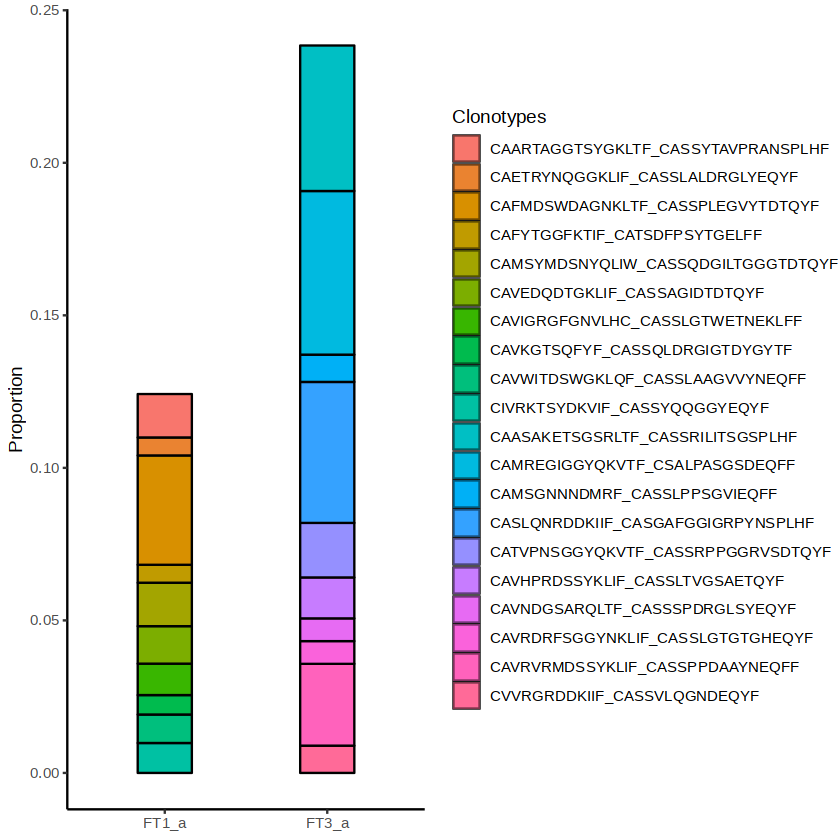

In [432]:
compareClonotypes(combined, 
                  numbers = 10, 
                  samples = c("FT1_a", "FT3_a"), 
                  cloneCall="aa", 
                  graph = "alluvial")

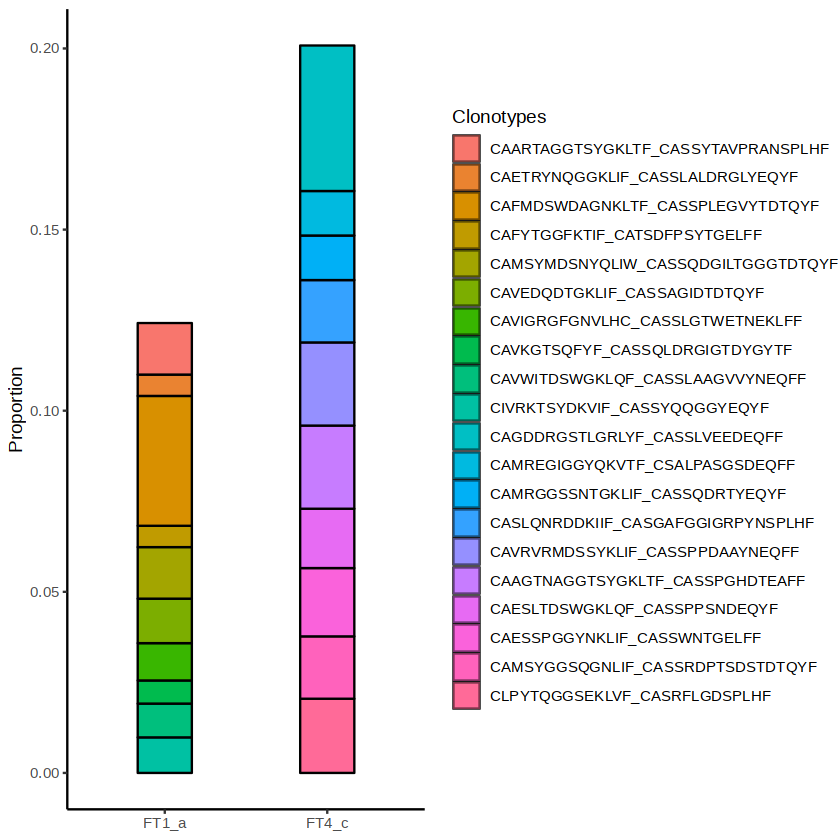

In [433]:
compareClonotypes(combined, 
                  numbers = 10, 
                  samples = c("FT1_a", "FT4_c"), 
                  cloneCall="aa", 
                  graph = "alluvial")
#data("contig_list") 필요

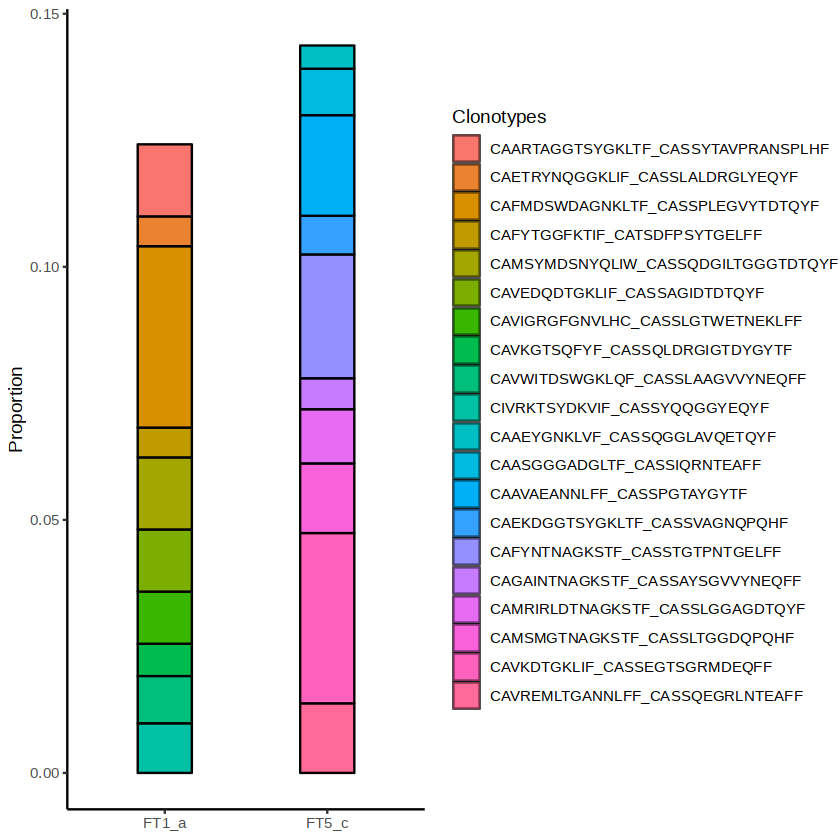

In [434]:
compareClonotypes(combined, 
                  numbers = 10, 
                  samples = c("FT1_a", "FT5_c"), 
                  cloneCall="aa", 
                  graph = "alluvial")
#data("contig_list") 필요

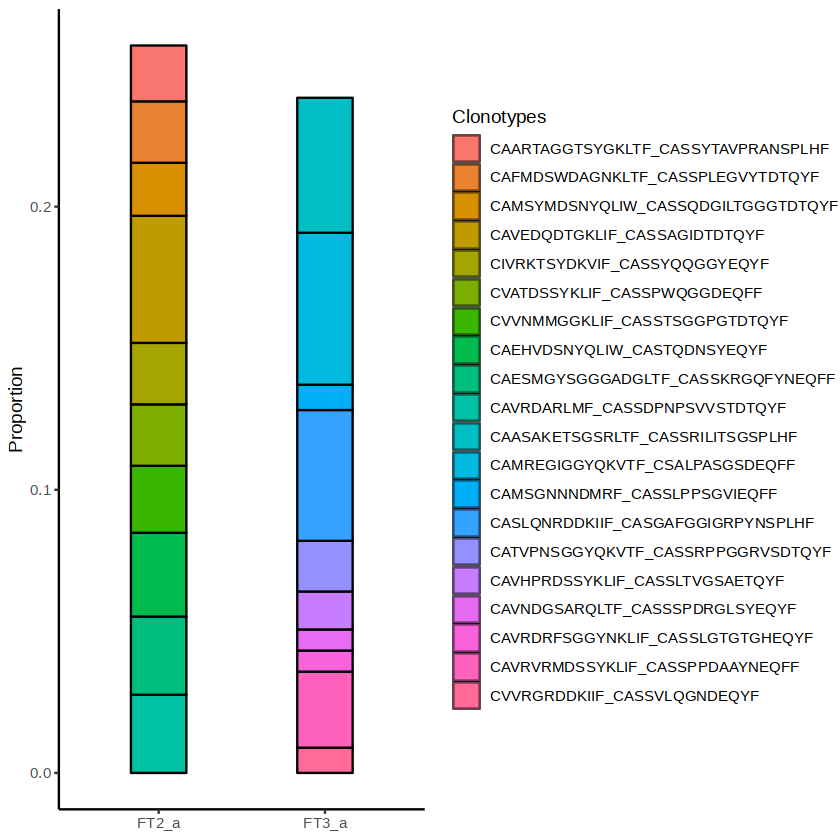

In [435]:
compareClonotypes(combined, 
                  numbers = 10, 
                  samples = c("FT2_a", "FT3_a"), 
                  cloneCall="aa", 
                  graph = "alluvial")
#data("contig_list") 필요

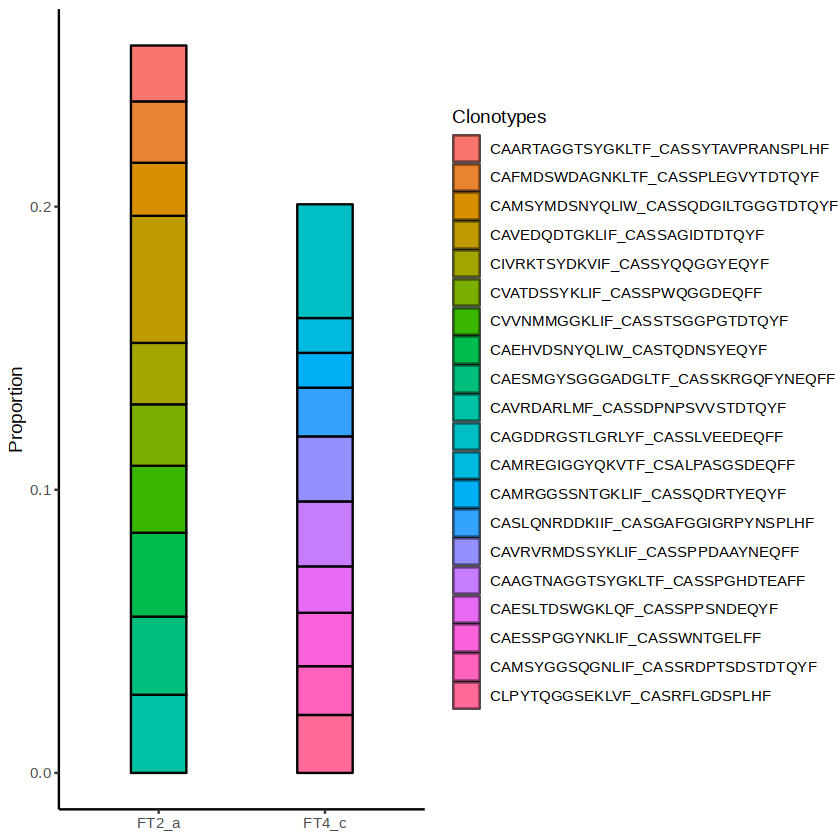

In [436]:
compareClonotypes(combined, 
                  numbers = 10, 
                  samples = c("FT2_a", "FT4_c"), 
                  cloneCall="aa", 
                  graph = "alluvial")
#data("contig_list") 필요

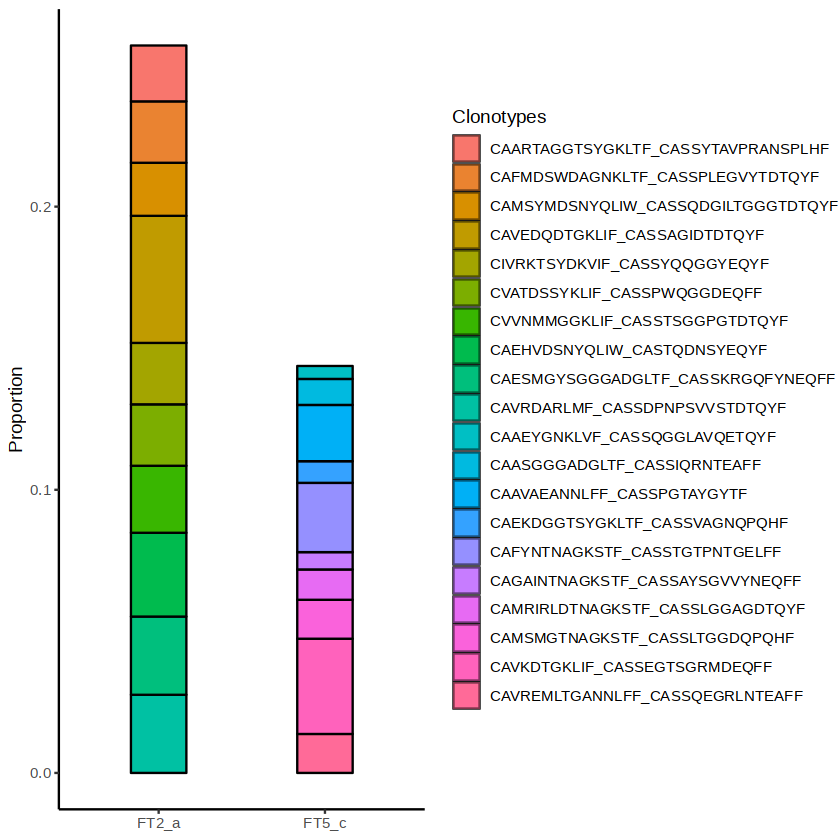

In [437]:
compareClonotypes(combined, 
                  numbers = 10, 
                  samples = c("FT2_a", "FT5_c"), 
                  cloneCall="aa", 
                  graph = "alluvial")
#data("contig_list") 필요

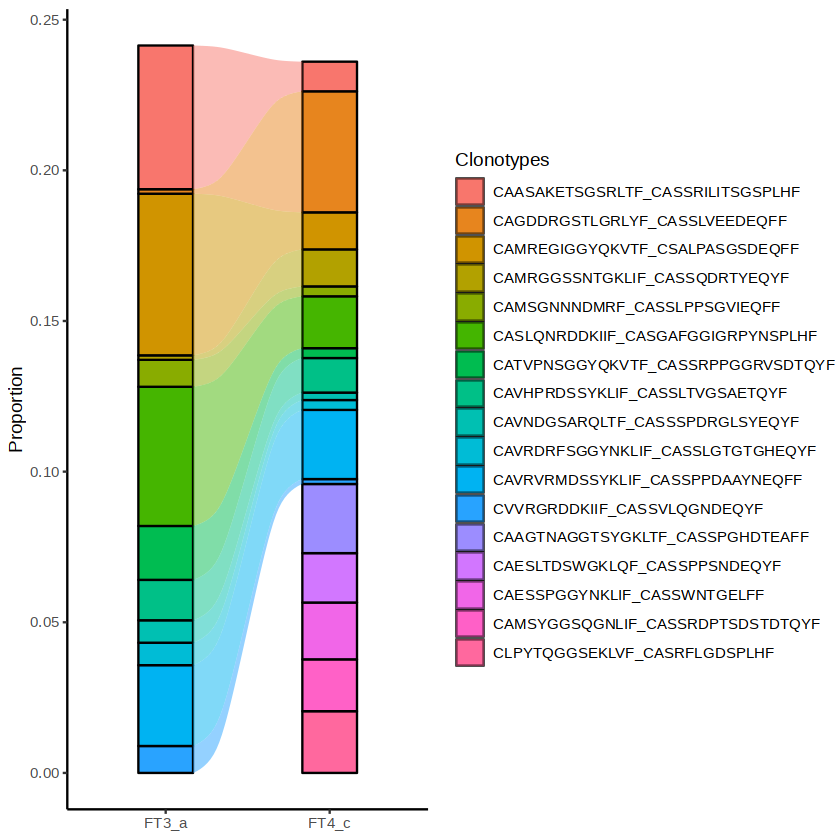

In [438]:
compareClonotypes(combined, 
                  numbers = 10, 
                  samples = c("FT3_a", "FT4_c"), 
                  cloneCall="aa", 
                  graph = "alluvial")
#data("contig_list") 필요

In [38]:
clonotype <- compareClonotypes(combined, 
                  numbers = 10, 
                  samples = c("FT3_a", "FT4_c"), 
                  cloneCall="aa", 
                  graph = "alluvial")

clonotype_FT3 <- subset(clonotype$data, subset=clonotype$data$Sample == "FT3_a")
clonotype_FT4 <- subset(clonotype$data, subset=clonotype$data$Sample == "FT4_c")
shared_clonotype3_4 <- merge(clonotype_FT3,clonotype_FT4, by="Clonotypes")

shared_clonotype3_4_aa <- shared_clonotype3_4$Clonotypes
shared_clonotype3_4_aa

[1] CAASAKETSGSRLTF_CASSRILITSGSPLHF  CAGDDRGSTLGRLYF_CASSLVEEDEQFF    
 [3] CAMREGIGGYQKVTF_CSALPASGSDEQFF    CAMRGGSSNTGKLIF_CASSQDRTYEQYF    
 [5] CAMSGNNNDMRF_CASSLPPSGVIEQFF      CASLQNRDDKIIF_CASGAFGGIGRPYNSPLHF
 [7] CATVPNSGGYQKVTF_CASSRPPGGRVSDTQYF CAVHPRDSSYKLIF_CASSLTVGSAETQYF   
 [9] CAVNDGSARQLTF_CASSSPDRGLSYEQYF    CAVRDRFSGGYNKLIF_CASSLGTGTGHEQYF 
[11] CAVRVRMDSSYKLIF_CASSPPDAAYNEQFF   CVVRGRDDKIIF_CASSVLQGNDEQYF      
4131 Levels: CAAAETSGSRLTF_CASSHGRAGYNEQFF ... CVVWGTMGTTDSLL_CASSVRLAGDGEQYF

In [ ]:
colnames(shared_clonotype3_4) = c("CTaa","Proportion.x","Sample.x","Proportion.y","Sample.y")
total3_4 <- merge(shared_clonotype3_4, combined$FT3_a, by="CTaa")
total3_4
unique(total3_4$TCR2)

CTaa,Proportion.x,Sample.x,Proportion.y,Sample.y,barcode,sample,ID,TCR1,cdr3_aa1,cdr3_nt1,TCR2,cdr3_aa2,cdr3_nt2,CTgene,CTnt,CTstrict,cellType
<fct>,<dbl>,<chr>,<dbl>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>
CAASAKETSGSRLTF_CASSRILITSGSPLHF,0.04769001,FT3_a,0.009836066,FT4_c,FT3_a_CTAGAGTAGTTGCAGG,FT3,a,TRAV29DV5.TRAJ58.TRAC,CAASAKETSGSRLTF,TGTGCAGCAAGCGCAAAGGAAACCAGTGGCTCTAGGTTGACCTTT,TRBV5-6.TRBD2.TRBJ1-6.TRBC1,CASSRILITSGSPLHF,TGTGCCAGCAGCCGAATCCTAATAACCAGCGGATCACCCCTCCACTTT,TRAV29DV5.TRAJ58.TRAC_TRBV5-6.TRBD2.TRBJ1-6.TRBC1,TGTGCAGCAAGCGCAAAGGAAACCAGTGGCTCTAGGTTGACCTTT_TGTGCCAGCAGCCGAATCCTAATAACCAGCGGATCACCCCTCCACTTT,TRAV29DV5.TRAJ58.TRAC_TGTGCAGCAAGCGCAAAGGAAACCAGTGGCTCTAGGTTGACCTTT_TRBV5-6.TRBD2.TRBJ1-6.TRBC1_TGTGCCAGCAGCCGAATCCTAATAACCAGCGGATCACCCCTCCACTTT,T-AB
CAASAKETSGSRLTF_CASSRILITSGSPLHF,0.04769001,FT3_a,0.009836066,FT4_c,FT3_a_GTTCTCGTCCTAAGTG,FT3,a,TRAV29DV5.TRAJ58.TRAC,CAASAKETSGSRLTF,TGTGCAGCAAGCGCAAAGGAAACCAGTGGCTCTAGGTTGACCTTT,TRBV5-6.TRBD2.TRBJ1-6.TRBC1,CASSRILITSGSPLHF,TGTGCCAGCAGCCGAATCCTAATAACCAGCGGATCACCCCTCCACTTT,TRAV29DV5.TRAJ58.TRAC_TRBV5-6.TRBD2.TRBJ1-6.TRBC1,TGTGCAGCAAGCGCAAAGGAAACCAGTGGCTCTAGGTTGACCTTT_TGTGCCAGCAGCCGAATCCTAATAACCAGCGGATCACCCCTCCACTTT,TRAV29DV5.TRAJ58.TRAC_TGTGCAGCAAGCGCAAAGGAAACCAGTGGCTCTAGGTTGACCTTT_TRBV5-6.TRBD2.TRBJ1-6.TRBC1_TGTGCCAGCAGCCGAATCCTAATAACCAGCGGATCACCCCTCCACTTT,T-AB
CAASAKETSGSRLTF_CASSRILITSGSPLHF,0.04769001,FT3_a,0.009836066,FT4_c,FT3_a_GTTCGGGTCCCTAATT,FT3,a,TRAV29DV5.TRAJ58.TRAC,CAASAKETSGSRLTF,TGTGCAGCAAGCGCAAAGGAAACCAGTGGCTCTAGGTTGACCTTT,TRBV5-6.TRBD2.TRBJ1-6.TRBC1,CASSRILITSGSPLHF,TGTGCCAGCAGCCGAATCCTAATAACCAGCGGATCACCCCTCCACTTT,TRAV29DV5.TRAJ58.TRAC_TRBV5-6.TRBD2.TRBJ1-6.TRBC1,TGTGCAGCAAGCGCAAAGGAAACCAGTGGCTCTAGGTTGACCTTT_TGTGCCAGCAGCCGAATCCTAATAACCAGCGGATCACCCCTCCACTTT,TRAV29DV5.TRAJ58.TRAC_TGTGCAGCAAGCGCAAAGGAAACCAGTGGCTCTAGGTTGACCTTT_TRBV5-6.TRBD2.TRBJ1-6.TRBC1_TGTGCCAGCAGCCGAATCCTAATAACCAGCGGATCACCCCTCCACTTT,T-AB
CAASAKETSGSRLTF_CASSRILITSGSPLHF,0.04769001,FT3_a,0.009836066,FT4_c,FT3_a_ATGAGGGAGCAGCGTA,FT3,a,TRAV29DV5.TRAJ58.TRAC,CAASAKETSGSRLTF,TGTGCAGCAAGCGCAAAGGAAACCAGTGGCTCTAGGTTGACCTTT,TRBV5-6.TRBD2.TRBJ1-6.TRBC1,CASSRILITSGSPLHF,TGTGCCAGCAGCCGAATCCTAATAACCAGCGGATCACCCCTCCACTTT,TRAV29DV5.TRAJ58.TRAC_TRBV5-6.TRBD2.TRBJ1-6.TRBC1,TGTGCAGCAAGCGCAAAGGAAACCAGTGGCTCTAGGTTGACCTTT_TGTGCCAGCAGCCGAATCCTAATAACCAGCGGATCACCCCTCCACTTT,TRAV29DV5.TRAJ58.TRAC_TGTGCAGCAAGCGCAAAGGAAACCAGTGGCTCTAGGTTGACCTTT_TRBV5-6.TRBD2.TRBJ1-6.TRBC1_TGTGCCAGCAGCCGAATCCTAATAACCAGCGGATCACCCCTCCACTTT,T-AB
CAASAKETSGSRLTF_CASSRILITSGSPLHF,0.04769001,FT3_a,0.009836066,FT4_c,FT3_a_ACGATGTAGCGTGAGT,FT3,a,TRAV29DV5.TRAJ58.TRAC,CAASAKETSGSRLTF,TGTGCAGCAAGCGCAAAGGAAACCAGTGGCTCTAGGTTGACCTTT,TRBV5-6.TRBD2.TRBJ1-6.TRBC1,CASSRILITSGSPLHF,TGTGCCAGCAGCCGAATCCTAATAACCAGCGGATCACCCCTCCACTTT,TRAV29DV5.TRAJ58.TRAC_TRBV5-6.TRBD2.TRBJ1-6.TRBC1,TGTGCAGCAAGCGCAAAGGAAACCAGTGGCTCTAGGTTGACCTTT_TGTGCCAGCAGCCGAATCCTAATAACCAGCGGATCACCCCTCCACTTT,TRAV29DV5.TRAJ58.TRAC_TGTGCAGCAAGCGCAAAGGAAACCAGTGGCTCTAGGTTGACCTTT_TRBV5-6.TRBD2.TRBJ1-6.TRBC1_TGTGCCAGCAGCCGAATCCTAATAACCAGCGGATCACCCCTCCACTTT,T-AB
CAASAKETSGSRLTF_CASSRILITSGSPLHF,0.04769001,FT3_a,0.009836066,FT4_c,FT3_a_TACTTACGTTGTTTGG,FT3,a,TRAV29DV5.TRAJ58.TRAC,CAASAKETSGSRLTF,TGTGCAGCAAGCGCAAAGGAAACCAGTGGCTCTAGGTTGACCTTT,TRBV5-6.TRBD2.TRBJ1-6.TRBC1,CASSRILITSGSPLHF,TGTGCCAGCAGCCGAATCCTAATAACCAGCGGATCACCCCTCCACTTT,TRAV29DV5.TRAJ58.TRAC_TRBV5-6.TRBD2.TRBJ1-6.TRBC1,TGTGCAGCAAGCGCAAAGGAAACCAGTGGCTCTAGGTTGACCTTT_TGTGCCAGCAGCCGAATCCTAATAACCAGCGGATCACCCCTCCACTTT,TRAV29DV5.TRAJ58.TRAC_TGTGCAGCAAGCGCAAAGGAAACCAGTGGCTCTAGGTTGACCTTT_TRBV5-6.TRBD2.TRBJ1-6.TRBC1_TGTGCCAGCAGCCGAATCCTAATAACCAGCGGATCACCCCTCCACTTT,T-AB
CAASAKETSGSRLTF_CASSRILITSGSPLHF,0.04769001,FT3_a,0.009836066,FT4_c,FT3_a_TATCAGGTCTTTAGTC,FT3,a,TRAV29DV5.TRAJ58.TRAC,CAASAKETSGSRLTF,TGTGCAGCAAGCGCAAAGGAAACCAGTGGCTCTAGGTTGACCTTT,TRBV5-6.TRBD2.TRBJ1-6.TRBC1,CASSRILITSGSPLHF,TGTGCCAGCAGCCGAATCCTAATAACCAGCGGATCACCCCTCCACTTT,TRAV29DV5.TRAJ58.TRAC_TRBV5-6.TRBD2.TRBJ1-6.TRBC1,TGTG

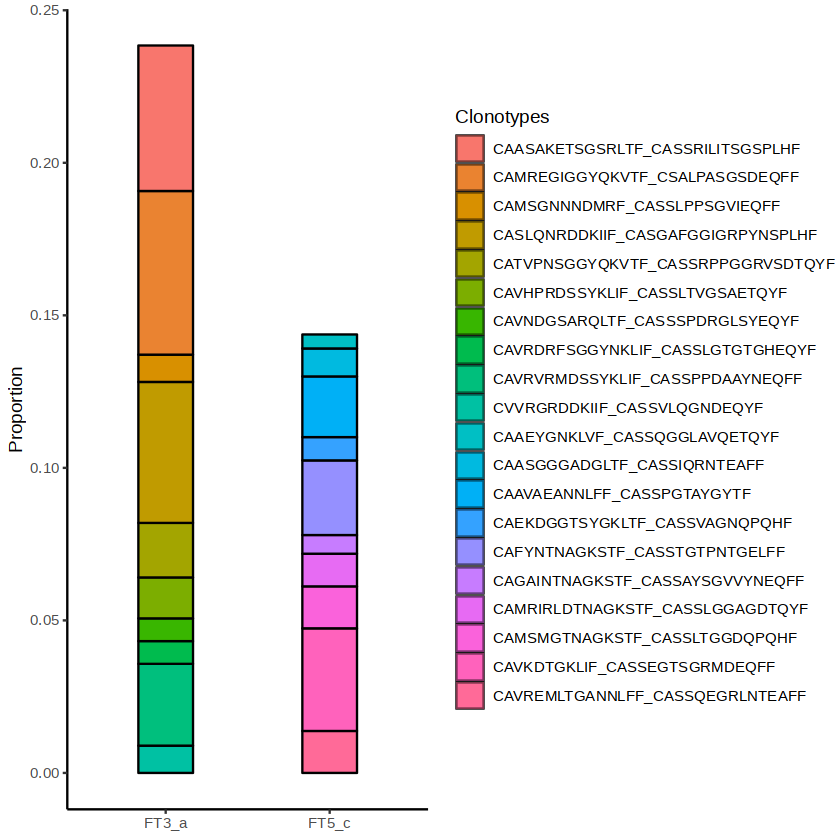

In [439]:
compareClonotypes(combined, 
                  numbers = 10, 
                  samples = c("FT3_a", "FT5_c"), 
                  cloneCall="aa", 
                  graph = "alluvial")
#data("contig_list") 필요

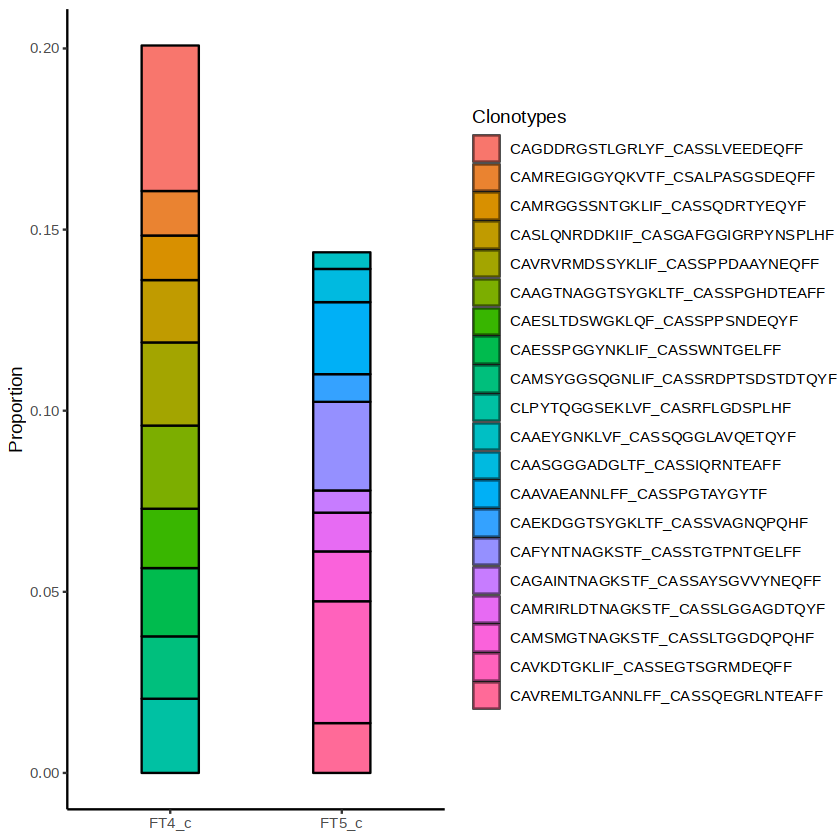

In [440]:
compareClonotypes(combined, 
                  numbers = 10, 
                  samples = c("FT4_c", "FT5_c"), 
                  cloneCall="aa", 
                  graph = "alluvial")
#data("contig_list") 필요

In [68]:
j=1
shared_clonotype1_2_data <- NULL
for(i in 1:length(shared_clonotype1_2_aa)) {
   shared_clonotype1_2_FT1 <- unique(subset(combined$FT1_a$CTgene, subset = combined$FT1_a$CTaa == shared_clonotype1_2_aa[i]))
    shared_clonotype1_2_data[j] <- shared_clonotype1_2_FT1
    j <- j+1
}
shared_clonotype1_2_aa
data_1_2 <- cbind(shared_clonotype1_2_aa,shared_clonotype1_2_data)

Warning message in shared_clonotype1_2_data[j] <- shared_clonotype1_2_FT1:
“number of items to replace is not a multiple of replacement length”


[1] CAARTAGGTSYGKLTF_CASSYTAVPRANSPLHF CAETRYNQGGKLIF_CASSLALDRGLYEQYF   
 [3] CAFMDSWDAGNKLTF_CASSPLEGVYTDTQYF   CAFYTGGFKTIF_CATSDFPSYTGELFF      
 [5] CAMSYMDSNYQLIW_CASSQDGILTGGGTDTQYF CAVEDQDTGKLIF_CASSAGIDTDTQYF      
 [7] CAVIGRGFGNVLHC_CASSLGTWETNEKLFF    CAVKGTSQFYF_CASSQLDRGIGTDYGYTF    
 [9] CAVWITDSWGKLQF_CASSLAAGVVYNEQFF    CIVRKTSYDKVIF_CASSYQQGGYEQYF      
[11] CVATDSSYKLIF_CASSPWQGGDEQFF        CVVNMMGGKLIF_CASSTSGGPGTDTQYF     
4131 Levels: CAAAETSGSRLTF_CASSHGRAGYNEQFF ... CVVWGTMGTTDSLL_CASSVRLAGDGEQYF

In [66]:
j=1
shared_clonotype3_4_data <- NULL
for(i in 1:length(shared_clonotype3_4_aa)) {
   shared_clonotype3_4_FT3 <- unique(subset(combined$FT3_a$CTgene, subset = combined$FT3_a$CTaa == shared_clonotype3_4_aa[i]))
    shared_clonotype3_4_data[j] <- shared_clonotype3_4_FT3
    j <- j+1
}
shared_clonotype3_4_aa
data_3_4 <- cbind(shared_clonotype3_4_aa,shared_clonotype3_4_data)

[1] CAASAKETSGSRLTF_CASSRILITSGSPLHF  CAGDDRGSTLGRLYF_CASSLVEEDEQFF    
 [3] CAMREGIGGYQKVTF_CSALPASGSDEQFF    CAMRGGSSNTGKLIF_CASSQDRTYEQYF    
 [5] CAMSGNNNDMRF_CASSLPPSGVIEQFF      CASLQNRDDKIIF_CASGAFGGIGRPYNSPLHF
 [7] CATVPNSGGYQKVTF_CASSRPPGGRVSDTQYF CAVHPRDSSYKLIF_CASSLTVGSAETQYF   
 [9] CAVNDGSARQLTF_CASSSPDRGLSYEQYF    CAVRDRFSGGYNKLIF_CASSLGTGTGHEQYF 
[11] CAVRVRMDSSYKLIF_CASSPPDAAYNEQFF   CVVRGRDDKIIF_CASSVLQGNDEQYF      
4131 Levels: CAAAETSGSRLTF_CASSHGRAGYNEQFF ... CVVWGTMGTTDSLL_CASSVRLAGDGEQYF

In [80]:
j = 0
for(i in 1: length(shared_clonotype3_4_aa)){
    shared_clonotype3_4_FT3 <- subset(combined$FT3_a$CTgene, subset = combined$FT3_a$CTaa == shared_clonotype3_4_aa[i])
    l <- length(shared_clonotype3_4_FT3)
    j <- j+l
}
j

[1] 162

In [81]:
j = 0
for(i in 1: length(shared_clonotype1_2_aa)){
    shared_clonotype1_2_FT1 <- subset(combined$FT1_a$CTgene, subset = combined$FT1_a$CTaa == shared_clonotype1_2_aa[i])
    l <- length(shared_clonotype1_2_FT1)
    j <- j+l
}
j

[1] 263

In [69]:
nrow(combined$FT1_a);nrow(combined$FT2_a);nrow(combined$FT3_a);nrow(combined$FT4_c);nrow(combined$FT5_c)

[1] 2037

[1] 2028

[1] 671

[1] 1220

[1] 654

In [11]:
combined$FT1_a[,"specificID"] <- c("a")
combined$FT2_a[,"specificID"] <- c("a")
combined$FT3_a[,"specificID"] <- c("a")
combined$FT4_c[,"specificID"] <- c("m_c")
combined$FT5_c[,"specificID"] <- c("w_c")
combined

barcode,sample,ID,TCR1,cdr3_aa1,cdr3_nt1,TCR2,cdr3_aa2,cdr3_nt2,CTgene,CTnt,CTaa,CTstrict,cellType,specificID
<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>
FT1_AAACCTGCACCGGAAA.1,FT1,a,TRAV29/DV5.TRAJ44.TRAC,CAAIRYTGTASKLTF,TGTGCAGCAATCCGCTATACCGGCACTGCCAGTAAACTCACCTTT,TRBV24-1.NA.TRBJ1-5.TRBC1,CATSDKYLNQPQHF,TGTGCCACCAGTGATAAATACCTCAATCAGCCCCAGCATTTT,TRAV29/DV5.TRAJ44.TRAC_TRBV24-1.NA.TRBJ1-5.TRBC1,TGTGCAGCAATCCGCTATACCGGCACTGCCAGTAAACTCACCTTT_TGTGCCACCAGTGATAAATACCTCAATCAGCCCCAGCATTTT,CAAIRYTGTASKLTF_CATSDKYLNQPQHF,TRAV29/DV5.TRAJ44.TRAC_TGTGCAGCAATCCGCTATACCGGCACTGCCAGTAAACTCACCTTT_TRBV24-1.NA.TRBJ1-5.TRBC1_TGTGCCACCAGTGATAAATACCTCAATCAGCCCCAGCATTTT,T-AB,a
FT1_AAACCTGGTCTTGTCC.1,FT1,a,TRAV30.TRAJ23.TRAC,CGTEIYNQGGKLIF,TGCGGCACAGAGATCTATAACCAGGGAGGAAAGCTTATCTTC,TRBV12-3.NA.TRBJ1-2.TRBC1,CASSVGPQVGNYGYTF,TGTGCCAGCAGCGTGGGACCCCAGGTCGGGAACTATGGCTACACCTTC,TRAV30.TRAJ23.TRAC_TRBV12-3.NA.TRBJ1-2.TRBC1,TGCGGCACAGAGATCTATAACCAGGGAGGAAAGCTTATCTTC_TGTGCCAGCAGCGTGGGACCCCAGGTCGGGAACTATGGCTACACCTTC,CGTEIYNQGGKLIF_CASSVGPQVGNYGYTF,TRAV30.TRAJ23.TRAC_TGCGGCACAGAGATCTATAACCAGGGAGGAAAGCTTATCTTC_TRBV12-3.NA.TRBJ1-2.TRBC1_TGTGCCAGCAGCGTGGGACCCCAGGTCGGGAACTATGGCTACACCTTC,T-AB,a
FT1_AAACCTGTCTACGAGT.1,FT1,a,TRAV19.TRAJ53.TRAC,CALRRSGGSNYKLTF,TGTGCTCTGAGAAGAAGTGGAGGTAGCAACTATAAACTGACATTT,TRBV29-1.NA.TRBJ2-5.TRBC2,CSVEGGLSSGTQYF,TGCAGCGTTGAAGGGGGCCTGAGTTCCGGGACCCAGTACTTC,TRAV19.TRAJ53.TRAC_TRBV29-1.NA.TRBJ2-5.TRBC2,TGTGCTCTGAGAAGAAGTGGAGGTAGCAACTATAAACTGACATTT_TGCAGCGTTGAAGGGGGCCTGAGTTCCGGGACCCAGTACTTC,CALRRSGGSNYKLTF_CSVEGGLSSGTQYF,TRAV19.TRAJ53.TRAC_TGTGCTCTGAGAAGAAGTGGAGGTAGCAACTATAAACTGACATTT_TRBV29-1.NA.TRBJ2-5.TRBC2_TGCAGCGTTGAAGGGGGCCTGAGTTCCGGGACCCAGTACTTC,T-AB,a
FT1_AAACGGGCAATAAGCA.1,FT1,a,TRAV13-2.TRAJ30.TRAC,CAVSMNRDDKIIF,TGTGCAGTGTCCATGAACAGAGATGACAAGATCATCTTT,TRBV5-1.NA.TRBJ1-4.TRBC1,CASSLAGSTNEKLFF,TGCGCCAGCAGCTTGGCGGGCTCAACTAATGAAAAACTGTTTTTT,TRAV13-2.TRAJ30.TRAC_TRBV5-1.NA.TRBJ1-4.TRBC1,TGTGCAGTGTCCATGAACAGAGATGACAAGATCATCTTT_TGCGCCAGCAGCTTGGCGGGCTCAACTAATGAAAAACTGTTTTTT,CAVSMNRDDKIIF_CASSLAGSTNEKLFF,TRAV13-2.TRAJ30.TRAC_TGTGCAGTGTCCATGAACAGAGATGACAAGATCATCTTT_TRBV5-1.NA.TRBJ1-4.TRBC1_TGCGCCAGCAGCTTGGCGGGCTCAACTAATGAAAAACTGTTTTTT,T-AB,a
FT1_AAACGGGTCGTTGCCT.1,FT1,a,TRAV10.TRAJ26.TRAC,CVVRRDNYGQNFVF,TGTGTGGTGAGGCGGGATAACTATGGTCAGAATTTTGTCTTT,TRBV6-5.NA.TRBJ1-1.TRBC1,CASSYLPSGLAPMNTEAFF,TGTGCCAGCAGTTACCTGCCCAGCGGGCTAGCCCCTATGAACACTGAAGCTTTCTTT,TRAV10.TRAJ26.TRAC_TRBV6-5.NA.TRBJ1-1.TRBC1,TGTGTGGTGAGGCGGGATAACTATGGTCAGAATTTTGTCTTT_TGTGCCAGCAGTTACCTGCCCAGCGGGCTAGCCCCTATGAACACTGAAGCTTTCTTT,CVVRRDNYGQNFVF_CASSYLPSGLAPMNTEAFF,TRAV10.TRAJ26.TRAC_TGTGTGGTGAGGCGGGATAACTATGGTCAGAATTTTGTCTTT_TRBV6-5.NA.TRBJ1-1.TRBC1_TGTGCCAGCAGTTACCTGCCCAGCGGGCTAGCCCCTATGAACACTGAAGCTTTCTTT,T-AB,a
FT1_AAAGATGAGTACACCT.1,FT1,a,TRAV35.TRAJ56.TRAC,CAGQAGANSKLTF,TGTGCTGGGCAGGCTGGAGCCAATAGTAAGCTGACATTT,TRBV20-1.NA.TRBJ2-5.TRBC2,CSARPGNRGKETQYF,TGCAGTGCTAGGCCCGGCAACAGGGGGAAAGAGACCCAGTACTTC,TRAV35.TRAJ56.TRAC_TRBV20-1.NA.TRBJ2-5.TRBC2,TGTGCTGGGCAGGCTGGAGCCAATAGTAAGCTGACATTT_TGCAGTGCTAGGCCCGGCAACAGGGGGAAAGAGACCCAGTACTTC,CAGQAGANSKLTF_CSARPGNRGKETQYF,TRAV35.TRAJ56.TRAC_TGTGCTGGGCAGGCTGGAGCCAATAGTAAGCTGACATTT_TRBV20-1.NA.TRBJ2-5.TRBC2_TGCAGTGCTAGGCCCGGCAACAGGGGGAAAGAGACCCAGTACTTC,T-AB,a
FT1_AAAGATGTCGCCAAAT.1,FT1,a,TRAV21.TRAJ20.TRAC,CAVEPNDYKLSF,TGTGCTGTGGAGCCTAACGACTACAAGCTCAGCTTT,TRBV19.NA.TRBJ2-2.TRBC2,CASSLSGGAYTGELFF,TGTGCCAGTAGTCTTTCAGGGGGCGCATACACCGGGGAGCTGTTTTTT,TRAV21.TRAJ20.TRAC_TRBV19.NA.TRBJ2-2.TRBC2,TGTGCTGTGGAGCCTAACGACTACAAGCTCAGCTTT_TGTGCCAGTAGTCTTTCAGGGGGCGCATACACCGGGGAGCTGTTTTTT,CAVEPNDYKLSF_CASSLSGGAYTGELFF,TRAV21.TRAJ20.TRAC_TGTGCTGTGGAGCCTAACGACTACAAGCTCAGCTTT_TRBV19.NA.TRBJ2-2.TRBC2_TGTGCCAGTAGTCTTTCAGGGGGCGCATACACCGGGGAGCTGTTTTTT,T-AB,a
FT1_AAAGATGTCTCCTATA.1,FT1,a,TRAV8-3.TRAJ41.TRAC,CAVGANSGYALNF,TGTGCTGTGGGTGCGAATTCCGGGTATGCACTCAACTTC,TRBV12-4.NA.TRBJ1-1.TRBC1,CASSFDLVGLVNTEAFF,TGTGCCAGCAGTTTTGATCTCGTGGGGTTGGTTAACACTGAAGCTTTCTTT,TRAV8-3.TRAJ41.TRAC_TRBV12-4.NA.TRBJ1-1.TRBC1,TGTGCTGTGGGTGCGAATTCCGGGTAT

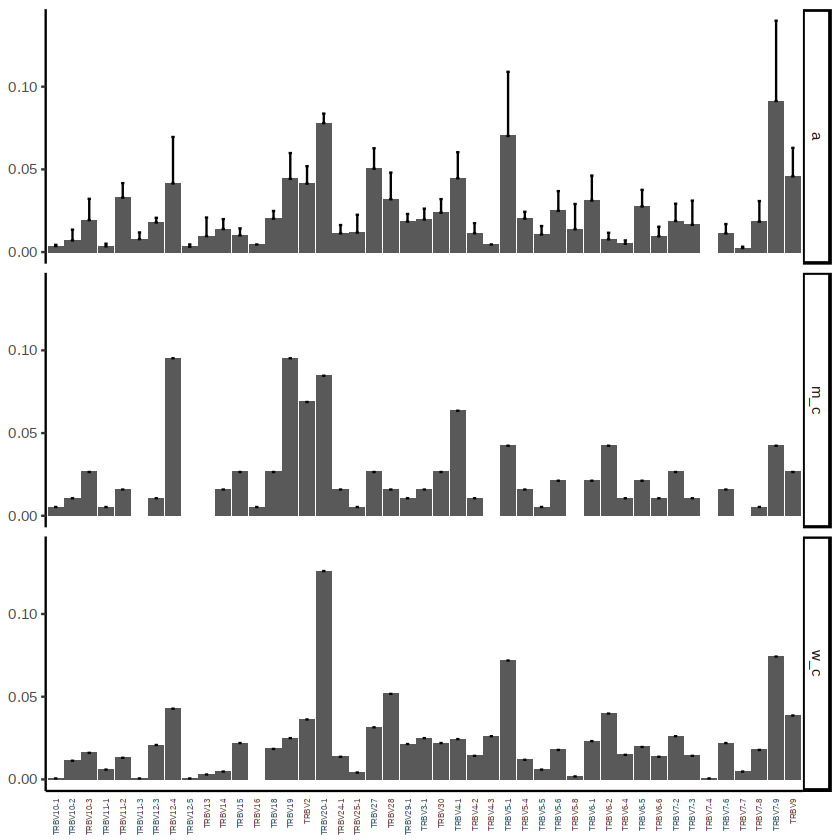

In [139]:
vizGenes(combined, 
         gene = "V", 
         chain = "TRB", 
         plot = "bar",
         y.axis = "specificID",
         order="gene",
         scale = TRUE)

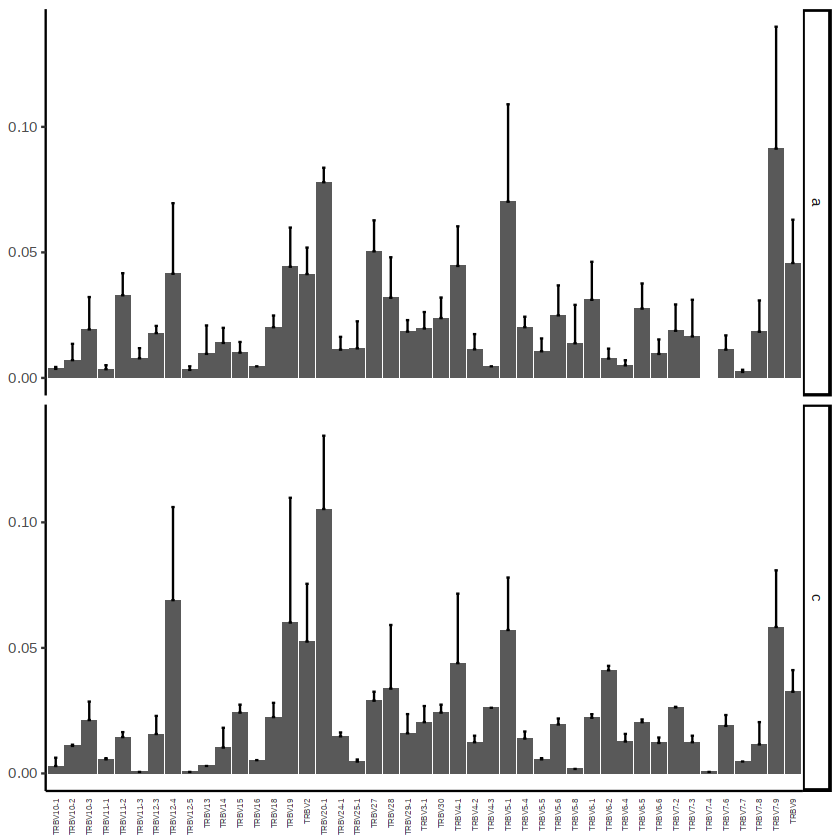

In [22]:
vizGenes(combined, 
         gene = "V", 
         chain = "TRB", 
         plot = "bar",
         y.axis = "ID",
         order="gene",
         scale = TRUE)

In [38]:
plot_data <- vizGenes(combined, 
         gene = "V", 
         chain = "TRB", 
         plot = "bar",
         y.axis = "ID",
         order="gene",
         scale = TRUE)
plot_data$data
BV_Var1 <- unique(plot_data$data$Var1)
BV_Var2_a <- subset(plot_data$data, subset = Var2 == "a")
BV_Var2_c <- subset(plot_data$data, subset = Var2 == "c")

Var1,Var2,sd,mean,.group
<chr>,<chr>,<dbl>,<dbl>,<int>
TRBV10-1,a,0.0007583399,0.0036131503,1
TRBV10-1,c,0.0033211591,0.0029425912,2
TRBV10-2,a,0.0065111239,0.0070734141,3
TRBV10-2,c,0.0005001746,0.0109356874,4
TRBV10-3,a,0.0128830407,0.0193196234,5
TRBV10-3,c,0.0073625695,0.0212489036,6
TRBV11-1,a,0.0016113662,0.0034618359,7
TRBV11-1,c,0.0004601606,0.0056163880,8
TRBV11-2,a,0.0087975199,0.0329214177,9


In [102]:
nrow(BV_Var2_a);nrow(BV_Var2_c)
unique(BV_Var2_a);unique(BV_Var2_c)
BV_Var2 <- merge(BV_Var2_a,BV_Var2_c, by="Var1")

[1] 44

[1] 45

Var1,Var2,sd,mean,.group
<chr>,<chr>,<dbl>,<dbl>,<int>
TRBV10-1,a,0.0007583399,0.003613150,1
TRBV10-2,a,0.0065111239,0.007073414,3
TRBV10-3,a,0.0128830407,0.019319623,5
TRBV11-1,a,0.0016113662,0.003461836,7
TRBV11-2,a,0.0087975199,0.032921418,9
TRBV11-3,a,0.0040267955,0.007831671,11
TRBV12-3,a,0.0028742635,0.017851764,13
TRBV12-4,a,0.0281099857,0.041493958,15
TRBV12-5,a,0.0014187741,0.003211727,17


Var1,Var2,sd,mean,.group
<chr>,<chr>,<dbl>,<dbl>,<int>
TRBV10-1,c,0.0033211591,0.0029425912,2
TRBV10-2,c,0.0005001746,0.0109356874,4
TRBV10-3,c,0.0073625695,0.0212489036,6
TRBV11-1,c,0.0004601606,0.0056163880,8
TRBV11-2,c,0.0019806913,0.0144724556,10
TRBV11-3,c,NA,0.0005941771,12
TRBV12-3,c,0.0072225207,0.0156891039,14
TRBV12-4,c,0.0370929455,0.0690094220,16
TRBV12-5,c,NA,0.0005941771,18


In [104]:
BV_Difference <- NULL
for(i in 1:44) {
    BV_Difference[i] <- BV_Var2$mean.x[i] - BV_Var2$mean.y[i]
    BV_Var2[i,"difference"] <- BV_Difference[i]
}

In [109]:
BV_Var2
for (i in 1:45) {
    if (abs(BV_Var2$difference[i]) >= 0.02){
        colors[i] = "red"
    } else if(abs(BV_Var2$difference[i]) >= 0.01){
        colors[i] = "yellow"
    } else {
        colors[i] = "blue"
    }
        BV_Var2[i,"colors"] <- colors[i]
}
BV_Var2

Var1,Var2.x,sd.x,mean.x,.group.x,Var2.y,sd.y,mean.y,.group.y,difference,colors
<chr>,<chr>,<dbl>,<dbl>,<int>,<chr>,<dbl>,<dbl>,<int>,<dbl>,<chr>
TRBV10-1,a,0.0007583399,0.003613150,1,c,0.0033211591,0.0029425912,2,0.0006705592,blue
TRBV10-2,a,0.0065111239,0.007073414,3,c,0.0005001746,0.0109356874,4,-0.0038622733,blue
TRBV10-3,a,0.0128830407,0.019319623,5,c,0.0073625695,0.0212489036,6,-0.0019292802,blue
TRBV11-1,a,0.0016113662,0.003461836,7,c,0.0004601606,0.0056163880,8,-0.0021545521,blue
TRBV11-2,a,0.0087975199,0.032921418,9,c,0.0019806913,0.0144724556,10,0.0184489620,yellow
TRBV11-3,a,0.0040267955,0.007831671,11,c,NA,0.0005941771,12,0.0072374941,blue
TRBV12-3,a,0.0028742635,0.017851764,13,c,0.0072225207,0.0156891039,14,0.0021626605,blue
TRBV12-4,a,0.0281099857,0.041493958,15,c,0.0370929455,0.0690094220,16,-0.0275154637,red
TRBV12-5,a,0.0014187741,0.003211727,17,c,NA,0.0005941771,18,0.0026175497,blue


ERROR: Error in if (abs(BV_Var2$difference[i]) >= 0.02) {: missing value where TRUE/FALSE needed


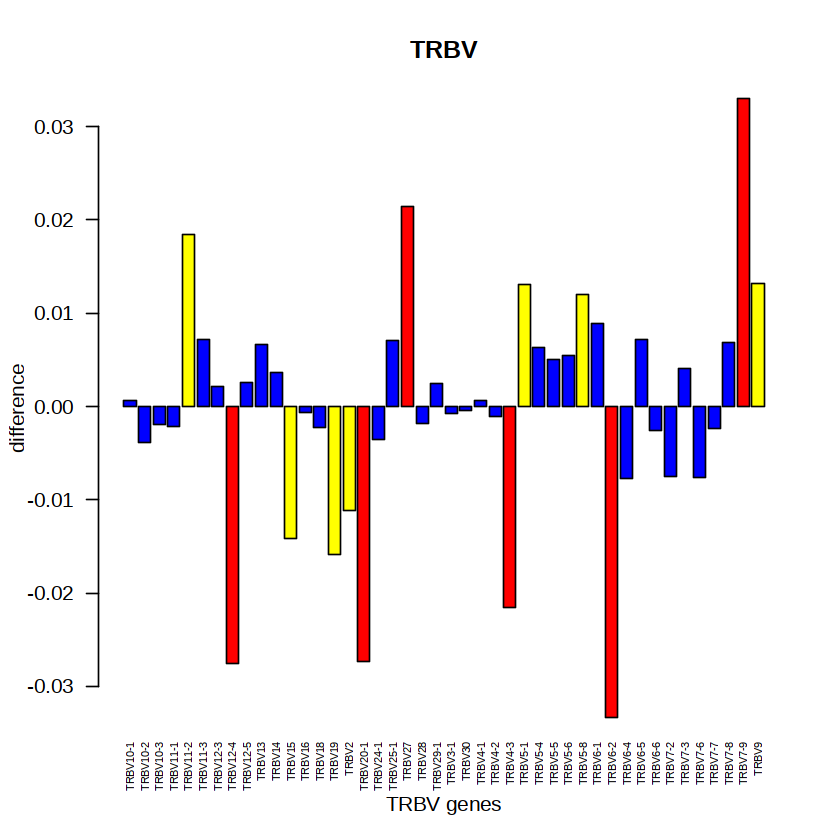

In [113]:
barplot(BV_Var2$difference, names.arg = BV_Var2$Var1,
       angle = 90, las=2, cex.names=0.5, col = BV_Var2$colors, main = "TRBV",
       xlab="TRBV genes", ylab="difference")

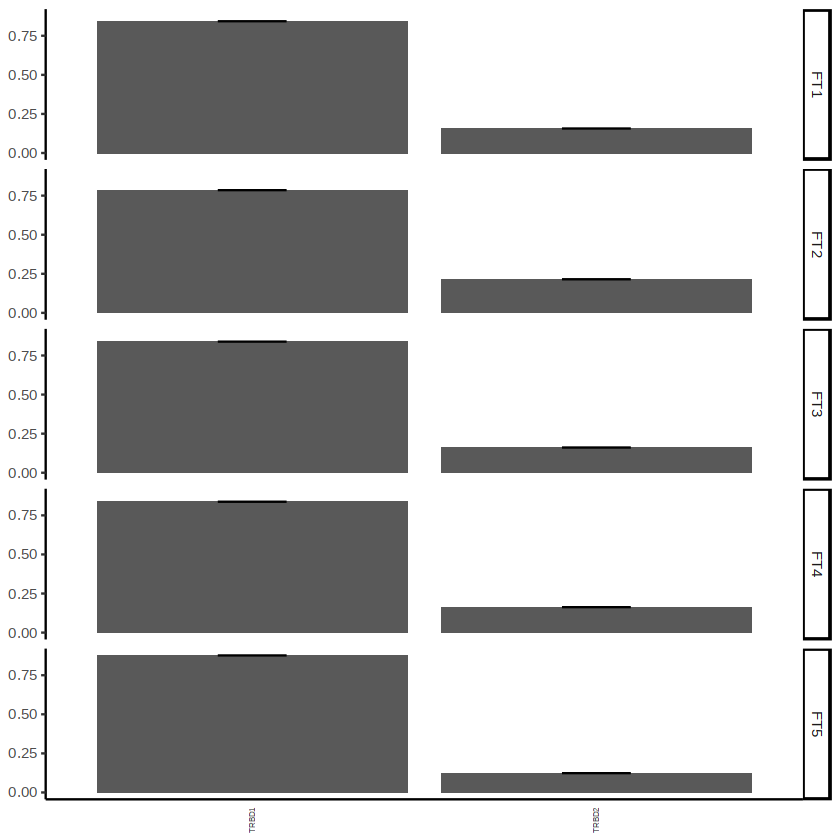

In [201]:
vizGenes(combined, 
         gene = "D", 
         chain = "TRB", 
         plot = "bar",
         order="gene",
         scale = TRUE)

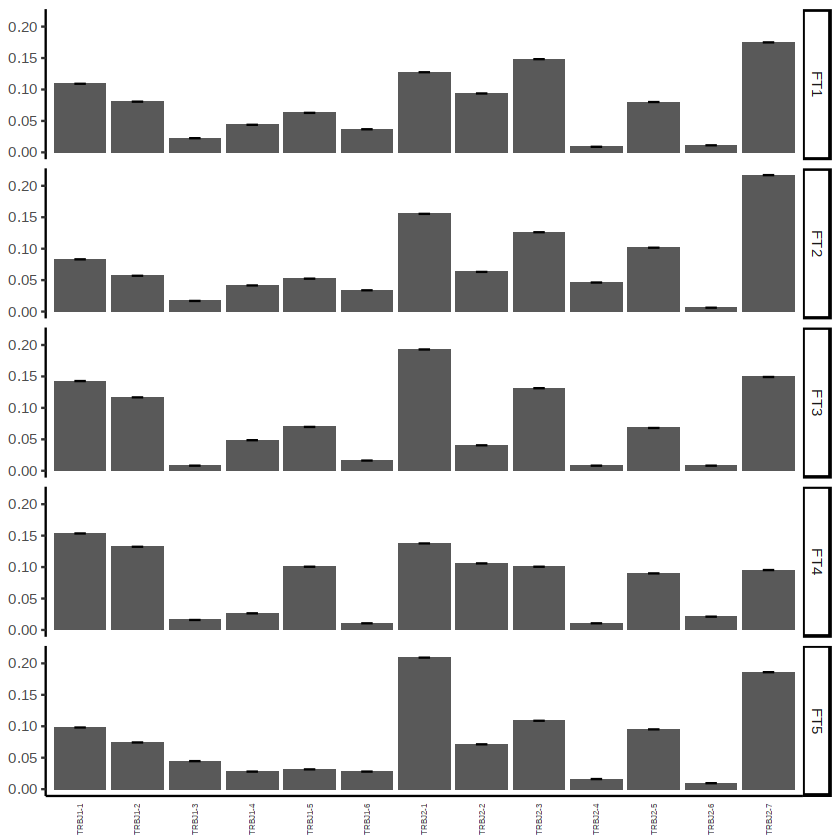

In [202]:
vizGenes(combined, 
         gene = "J", 
         chain = "TRB", 
         plot = "bar",
         order="gene",
         scale = TRUE)

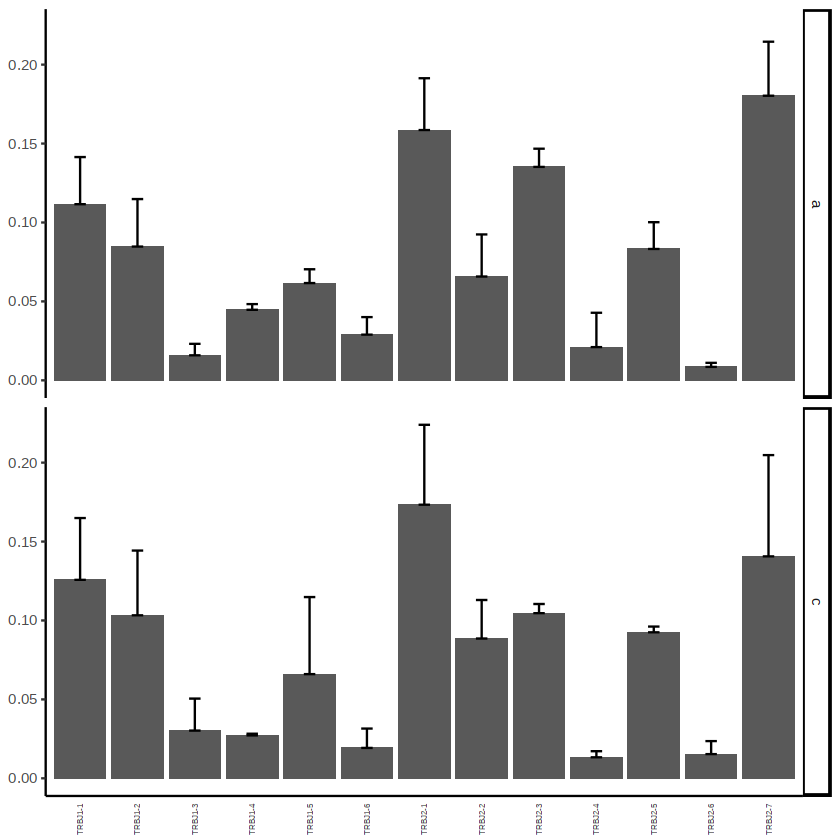

In [234]:
vizGenes(combined, 
         gene = "J", 
         chain = "TRB", 
         plot = "bar",
         y.axis = "ID",
         order="gene",
         scale = TRUE)

In [114]:
plot_data <- vizGenes(combined, 
         gene = "J", 
         chain = "TRB", 
         plot = "bar",
         y.axis = "ID",
         order="gene",
         scale = TRUE)
plot_data$data
BJ_Var1 <- unique(plot_data$data$Var1)
BJ_Var2_a <- subset(plot_data$data, subset = Var2 == "a")
BJ_Var2_c <- subset(plot_data$data, subset = Var2 == "c")

Var1,Var2,sd,mean,.group
<chr>,<chr>,<dbl>,<dbl>,<int>
TRBJ1-1,a,0.029854298,0.111590628,1
TRBJ1-1,c,0.039173672,0.125739185,2
TRBJ1-2,a,0.030098357,0.084744412,3
TRBJ1-2,c,0.041014314,0.103273633,4
TRBJ1-3,a,0.007270297,0.015850666,5
TRBJ1-3,c,0.020287080,0.030218148,6
TRBJ1-4,a,0.003610811,0.044675226,7
TRBJ1-4,c,0.001040363,0.027190674,8
TRBJ1-5,a,0.008756408,0.061611061,9


In [115]:
nrow(BJ_Var2_a);nrow(BJ_Var2_c)
unique(BJ_Var2_a);unique(BJ_Var2_c)
BJ_Var2 <- merge(BJ_Var2_a,BJ_Var2_c, by="Var1")

[1] 13

[1] 13

Var1,Var2,sd,mean,.group
<chr>,<chr>,<dbl>,<dbl>,<int>
TRBJ1-1,a,0.029854298,0.111590628,1
TRBJ1-2,a,0.030098357,0.084744412,3
TRBJ1-3,a,0.007270297,0.015850666,5
TRBJ1-4,a,0.003610811,0.044675226,7
TRBJ1-5,a,0.008756408,0.061611061,9
TRBJ1-6,a,0.011117768,0.028935080,11
TRBJ2-1,a,0.032827610,0.158566168,13
TRBJ2-2,a,0.026670103,0.065750981,15
TRBJ2-3,a,0.011532336,0.135208764,17


Var1,Var2,sd,mean,.group
<chr>,<chr>,<dbl>,<dbl>,<int>
TRBJ1-1,c,0.039173672,0.12573918,2
TRBJ1-2,c,0.041014314,0.10327363,4
TRBJ1-3,c,0.020287080,0.03021815,6
TRBJ1-4,c,0.001040363,0.02719067,8
TRBJ1-5,c,0.048817037,0.06601024,10
TRBJ1-6,c,0.012264280,0.01925417,12
TRBJ2-1,c,0.050617666,0.17335823,14
TRBJ2-2,c,0.024408519,0.08856068,16
TRBJ2-3,c,0.005802025,0.10463175,18


In [116]:
BJ_Difference <- NULL
for(i in 1:nrow(BJ_Var2)) {
    BJ_Difference[i] <- BJ_Var2$mean.x[i] - BJ_Var2$mean.y[i]
    BJ_Var2[i,"difference"] <- BJ_Difference[i]
}

In [117]:
BJ_Var2
for (i in 1:nrow(BJ_Var2)) {
    if (abs(BJ_Var2$difference[i]) >= 0.02){
        colors[i] = "red"
    } else if(abs(BJ_Var2$difference[i]) >= 0.01){
        colors[i] = "yellow"
    } else {
        colors[i] = "blue"
    }
        BJ_Var2[i,"colors"] <- colors[i]
}
BJ_Var2

Var1,Var2.x,sd.x,mean.x,.group.x,Var2.y,sd.y,mean.y,.group.y,difference
<chr>,<chr>,<dbl>,<dbl>,<int>,<chr>,<dbl>,<dbl>,<int>,<dbl>
TRBJ1-1,a,0.029854298,0.111590628,1,c,0.039173672,0.12573918,2,-0.014148556
TRBJ1-2,a,0.030098357,0.084744412,3,c,0.041014314,0.10327363,4,-0.018529221
TRBJ1-3,a,0.007270297,0.015850666,5,c,0.020287080,0.03021815,6,-0.014367482
TRBJ1-4,a,0.003610811,0.044675226,7,c,0.001040363,0.02719067,8,0.017484551
TRBJ1-5,a,0.008756408,0.061611061,9,c,0.048817037,0.06601024,10,-0.004399182
TRBJ1-6,a,0.011117768,0.028935080,11,c,0.012264280,0.01925417,12,0.009680913
TRBJ2-1,a,0.032827610,0.158566168,13,c,0.050617666,0.17335823,14,-0.014792064
TRBJ2-2,a,0.026670103,0.065750981,15,c,0.024408519,0.08856068,16,-0.022809696
TRBJ2-3,a,0.011532336,0.135208764,17,c,0.005802025,0.10463175,18,0.030577012


Var1,Var2.x,sd.x,mean.x,.group.x,Var2.y,sd.y,mean.y,.group.y,difference,colors
<chr>,<chr>,<dbl>,<dbl>,<int>,<chr>,<dbl>,<dbl>,<int>,<dbl>,<chr>
TRBJ1-1,a,0.029854298,0.111590628,1,c,0.039173672,0.12573918,2,-0.014148556,yellow
TRBJ1-2,a,0.030098357,0.084744412,3,c,0.041014314,0.10327363,4,-0.018529221,yellow
TRBJ1-3,a,0.007270297,0.015850666,5,c,0.020287080,0.03021815,6,-0.014367482,yellow
TRBJ1-4,a,0.003610811,0.044675226,7,c,0.001040363,0.02719067,8,0.017484551,yellow
TRBJ1-5,a,0.008756408,0.061611061,9,c,0.048817037,0.06601024,10,-0.004399182,blue
TRBJ1-6,a,0.011117768,0.028935080,11,c,0.012264280,0.01925417,12,0.009680913,blue
TRBJ2-1,a,0.032827610,0.158566168,13,c,0.050617666,0.17335823,14,-0.014792064,yellow
TRBJ2-2,a,0.026670103,0.065750981,15,c,0.024408519,0.08856068,16,-0.022809696,red
TRBJ2-3,a,0.011532336,0.135208764,17,c,0.005802025,0.10463175,18,0.030577012,red


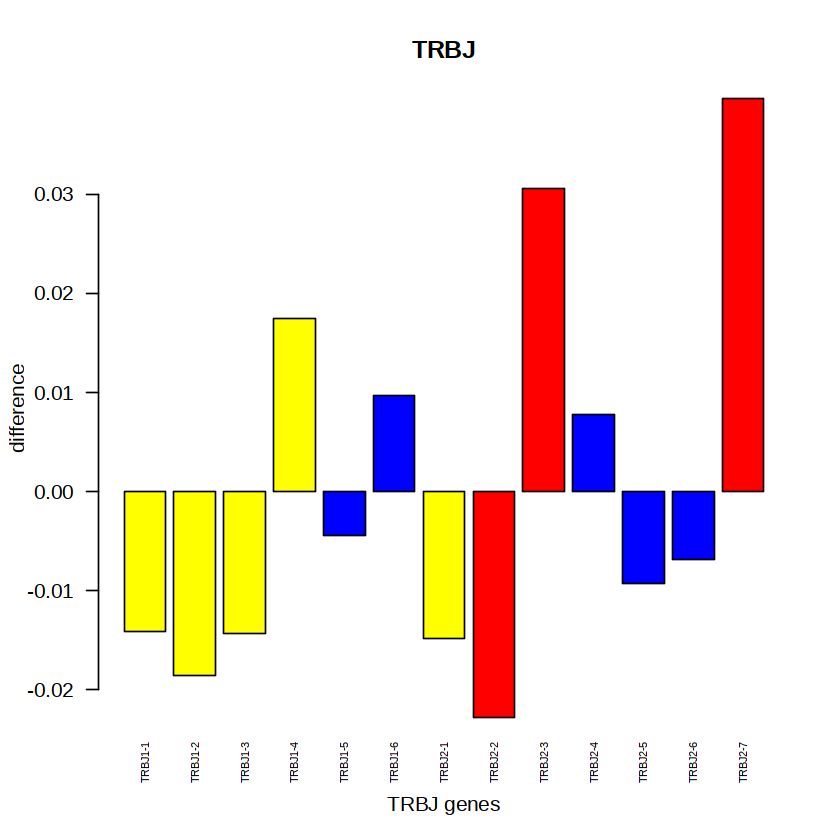

In [118]:
barplot(BJ_Var2$difference, names.arg = BJ_Var2$Var1,
       angle = 90, las=2, cex.names=0.5, col = BJ_Var2$colors, main = "TRBJ",
       xlab="TRBJ genes", ylab="difference")

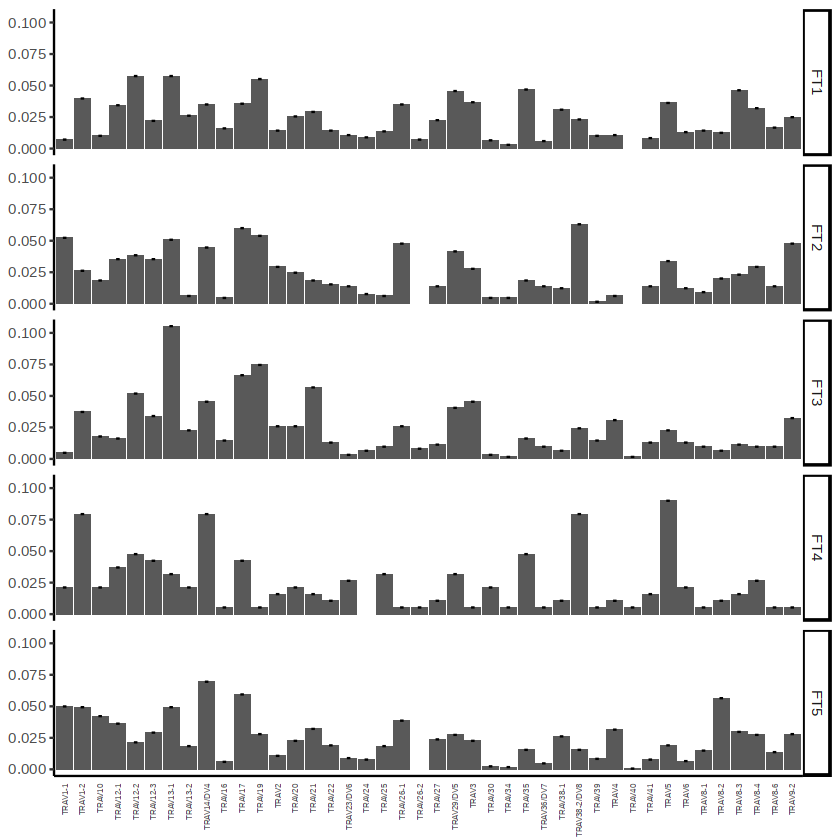

In [203]:
vizGenes(combined, 
         gene = "V", 
         chain = "TRA", 
         plot = "bar",
         order="gene",
         scale = TRUE)

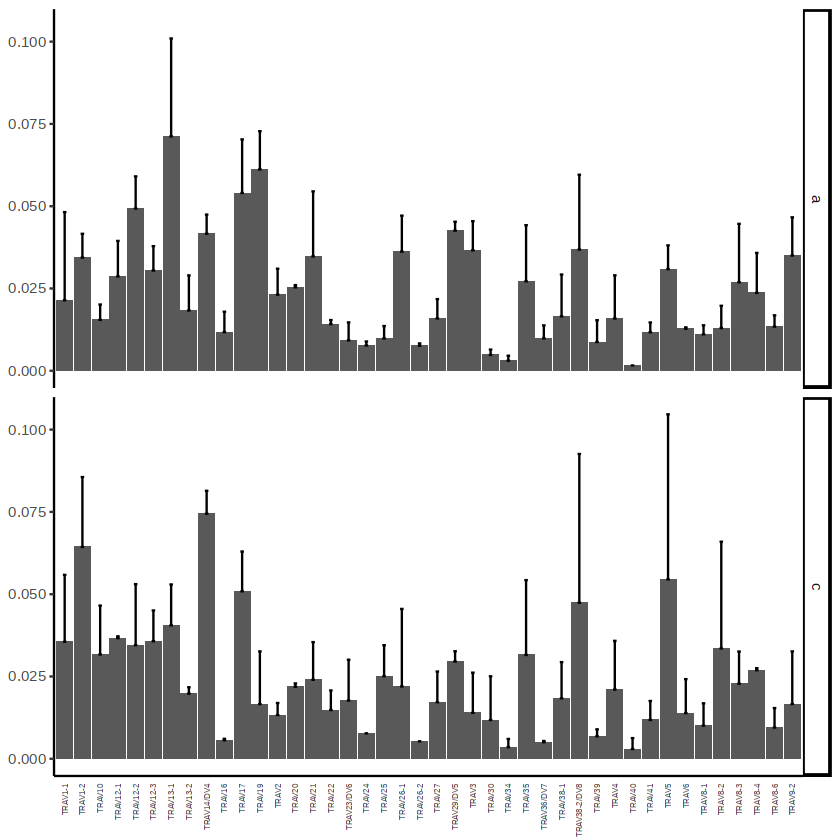

In [235]:
vizGenes(combined, 
         gene = "V", 
         chain = "TRA", 
         plot = "bar",
         y.axis = "ID",
         order="gene",
         scale = TRUE)

In [119]:
plot_data <- vizGenes(combined, 
         gene = "V", 
         chain = "TRA", 
         plot = "bar",
         y.axis = "ID",
         order="gene",
         scale = TRUE)
plot_data$data
AV_Var1 <- unique(plot_data$data$Var1)
AV_Var2_a <- subset(plot_data$data, subset = Var2 == "a")
AV_Var2_c <- subset(plot_data$data, subset = Var2 == "c")

Var1,Var2,sd,mean,.group
<chr>,<chr>,<dbl>,<dbl>,<int>
TRAV1-1,a,0.0267665171,0.021427716,1
TRAV1-1,c,0.0203270942,0.035537447,2
TRAV1-2,a,0.0072294644,0.034382155,3
TRAV1-2,c,0.0212474154,0.064340888,4
TRAV10,a,0.0046687041,0.015455600,5
TRAV10,c,0.0148651880,0.031675296,6
TRAV12-1,a,0.0107937731,0.028657543,7
TRAV12-1,c,0.0005601955,0.036640919,8
TRAV12-2,a,0.0097790435,0.049274638,9


In [120]:
nrow(AV_Var2_a);nrow(AV_Var2_c)
unique(AV_Var2_a);unique(AV_Var2_c)
AV_Var2 <- merge(AV_Var2_a,AV_Var2_c, by="Var1")

[1] 42

[1] 42

Var1,Var2,sd,mean,.group
<chr>,<chr>,<dbl>,<dbl>,<int>
TRAV1-1,a,0.0267665171,0.021427716,1
TRAV1-2,a,0.0072294644,0.034382155,3
TRAV10,a,0.0046687041,0.015455600,5
TRAV12-1,a,0.0107937731,0.028657543,7
TRAV12-2,a,0.0097790435,0.049274638,9
TRAV12-3,a,0.0074079839,0.030450899,11
TRAV13-1,a,0.0297595715,0.071205403,13
TRAV13-2,a,0.0106621108,0.018308695,15
TRAV14/DV4,a,0.0058004651,0.041656528,17


Var1,Var2,sd,mean,.group
<chr>,<chr>,<dbl>,<dbl>,<int>
TRAV1-1,c,0.0203270942,0.035537447,2
TRAV1-2,c,0.0212474154,0.064340888,4
TRAV10,c,0.0148651880,0.031675296,6
TRAV12-1,c,0.0005601955,0.036640919,8
TRAV12-2,c,0.0185464727,0.034504711,10
TRAV12-3,c,0.0093432608,0.035721359,12
TRAV13-1,c,0.0124243361,0.040531364,14
TRAV13-2,c,0.0019406773,0.019791755,16
TRAV14/DV4,c,0.0069624299,0.074441898,18


In [121]:
AV_Difference <- NULL
for(i in 1:nrow(AV_Var2)) {
    AV_Difference[i] <- AV_Var2$mean.x[i] - AV_Var2$mean.y[i]
    AV_Var2[i,"difference"] <- AV_Difference[i]
}

In [122]:
AV_Var2
for (i in 1:nrow(AV_Var2)) {
    if (abs(AV_Var2$difference[i]) >= 0.02){
        colors[i] = "red"
    } else if(abs(AV_Var2$difference[i]) >= 0.01){
        colors[i] = "yellow"
    } else {
        colors[i] = "blue"
    }
        AV_Var2[i,"colors"] <- colors[i]
}
AV_Var2

Var1,Var2.x,sd.x,mean.x,.group.x,Var2.y,sd.y,mean.y,.group.y,difference
<chr>,<chr>,<dbl>,<dbl>,<int>,<chr>,<dbl>,<dbl>,<int>,<dbl>
TRAV1-1,a,0.0267665171,0.021427716,1,c,0.0203270942,0.035537447,2,-1.410973e-02
TRAV1-2,a,0.0072294644,0.034382155,3,c,0.0212474154,0.064340888,4,-2.995873e-02
TRAV10,a,0.0046687041,0.015455600,5,c,0.0148651880,0.031675296,6,-1.621970e-02
TRAV12-1,a,0.0107937731,0.028657543,7,c,0.0005601955,0.036640919,8,-7.983376e-03
TRAV12-2,a,0.0097790435,0.049274638,9,c,0.0185464727,0.034504711,10,1.476993e-02
TRAV12-3,a,0.0074079839,0.030450899,11,c,0.0093432608,0.035721359,12,-5.270461e-03
TRAV13-1,a,0.0297595715,0.071205403,13,c,0.0124243361,0.040531364,14,3.067404e-02
TRAV13-2,a,0.0106621108,0.018308695,15,c,0.0019406773,0.019791755,16,-1.483060e-03
TRAV14/DV4,a,0.0058004651,0.041656528,17,c,0.0069624299,0.074441898,18,-3.278537e-02


Var1,Var2.x,sd.x,mean.x,.group.x,Var2.y,sd.y,mean.y,.group.y,difference,colors
<chr>,<chr>,<dbl>,<dbl>,<int>,<chr>,<dbl>,<dbl>,<int>,<dbl>,<chr>
TRAV1-1,a,0.0267665171,0.021427716,1,c,0.0203270942,0.035537447,2,-1.410973e-02,yellow
TRAV1-2,a,0.0072294644,0.034382155,3,c,0.0212474154,0.064340888,4,-2.995873e-02,red
TRAV10,a,0.0046687041,0.015455600,5,c,0.0148651880,0.031675296,6,-1.621970e-02,yellow
TRAV12-1,a,0.0107937731,0.028657543,7,c,0.0005601955,0.036640919,8,-7.983376e-03,blue
TRAV12-2,a,0.0097790435,0.049274638,9,c,0.0185464727,0.034504711,10,1.476993e-02,yellow
TRAV12-3,a,0.0074079839,0.030450899,11,c,0.0093432608,0.035721359,12,-5.270461e-03,blue
TRAV13-1,a,0.0297595715,0.071205403,13,c,0.0124243361,0.040531364,14,3.067404e-02,red
TRAV13-2,a,0.0106621108,0.018308695,15,c,0.0019406773,0.019791755,16,-1.483060e-03,blue
TRAV14/DV4,a,0.0058004651,0.041656528,17,c,0.0069624299,0.074441898,18,-3.278537e-02,red


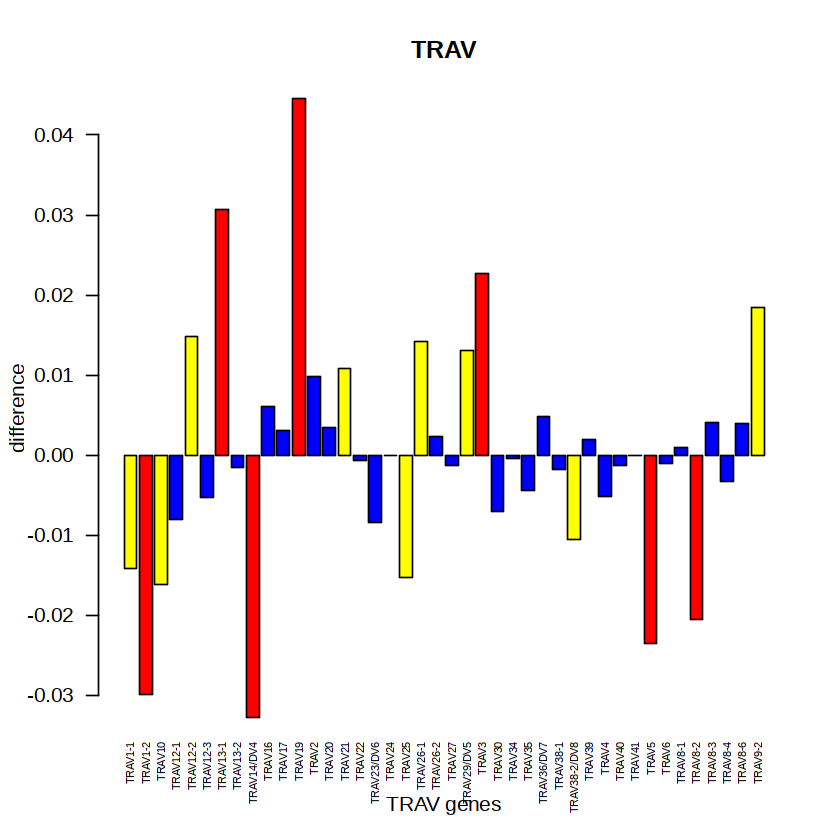

In [123]:
barplot(AV_Var2$difference, names.arg = AV_Var2$Var1,
       angle = 90, las=2, cex.names=0.5, col = AV_Var2$colors, main = "TRAV",
       xlab="TRAV genes", ylab="difference")

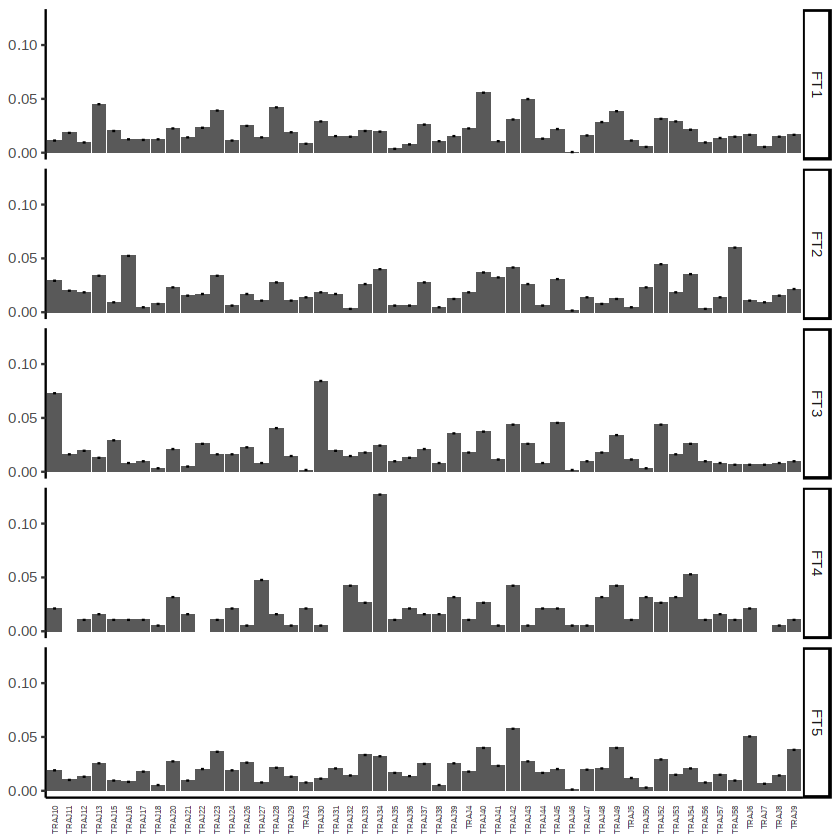

In [204]:
vizGenes(combined, 
         gene = "J", 
         chain = "TRA", 
         plot = "bar",
         order="gene",
         scale = TRUE)

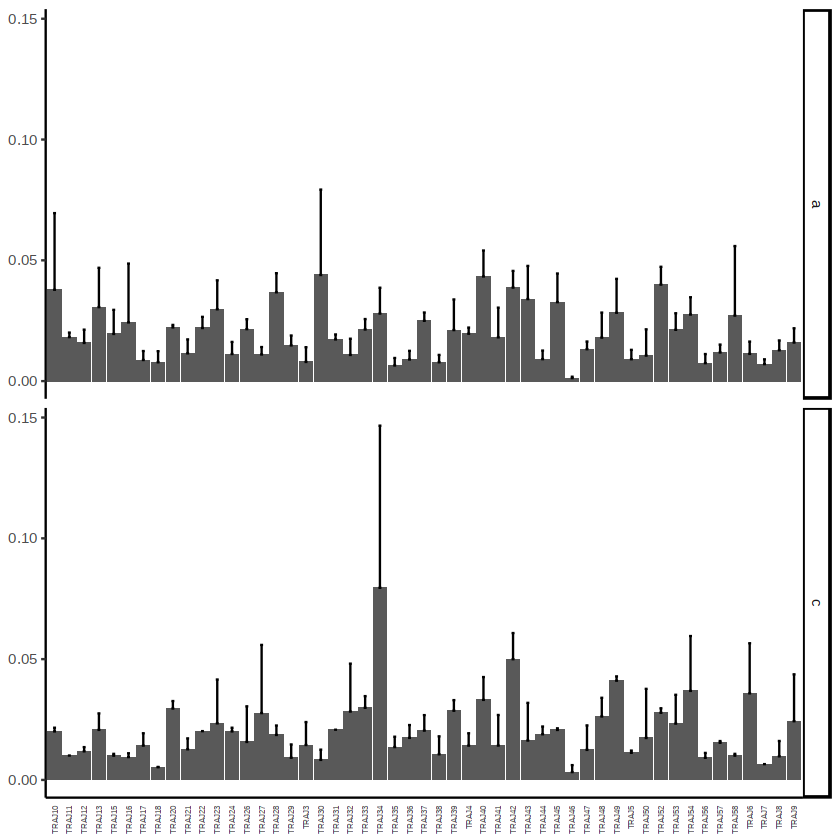

In [236]:
vizGenes(combined, 
         gene = "J", 
         chain = "TRA", 
         plot = "bar",
         y.axis = "ID",
         order="gene",
         scale = TRUE)

In [124]:
plot_data <- vizGenes(combined, 
         gene = "J", 
         chain = "TRA", 
         plot = "bar",
         y.axis = "ID",
         order="gene",
         scale = TRUE)
plot_data$data
AJ_Var1 <- unique(plot_data$data$Var1)
AJ_Var2_a <- subset(plot_data$data, subset = Var2 == "a")
AJ_Var2_c <- subset(plot_data$data, subset = Var2 == "c")

Var1,Var2,sd,mean,.group
<chr>,<chr>,<dbl>,<dbl>,<int>
TRAJ10,a,3.171775e-02,0.037808972,1
TRAJ10,c,1.520531e-03,0.020088844,2
TRAJ11,a,1.902768e-03,0.018194423,3
TRAJ11,c,NA,0.010101010,4
TRAJ12,a,5.490299e-03,0.015798259,5
TRAJ12,c,1.760614e-03,0.011826953,6
TRAJ13,a,1.628357e-02,0.030620834,7
TRAJ13,c,6.842388e-03,0.020711315,8
TRAJ15,a,9.986463e-03,0.019519436,9


In [125]:
nrow(AJ_Var2_a);nrow(AJ_Var2_c)
unique(AJ_Var2_a);unique(AJ_Var2_c)
AJ_Var2 <- merge(AJ_Var2_a,AJ_Var2_c, by="Var1")

[1] 51

[1] 51

Var1,Var2,sd,mean,.group
<chr>,<chr>,<dbl>,<dbl>,<int>
TRAJ10,a,0.0317177518,0.037808972,1
TRAJ11,a,0.0019027679,0.018194423,3
TRAJ12,a,0.0054902987,0.015798259,5
TRAJ13,a,0.0162835663,0.030620834,7
TRAJ15,a,0.0099864631,0.019519436,9
TRAJ16,a,0.0243640747,0.024286518,11
TRAJ17,a,0.0037206808,0.008731741,13
TRAJ18,a,0.0046041628,0.007793977,15
TRAJ20,a,0.0010369719,0.022223936,17


Var1,Var2,sd,mean,.group
<chr>,<chr>,<dbl>,<dbl>,<int>
TRAJ10,c,1.520531e-03,0.020088844,2
TRAJ11,c,NA,0.010101010,4
TRAJ12,c,1.760614e-03,0.011826953,6
TRAJ13,c,6.842388e-03,0.020711315,8
TRAJ15,c,7.602653e-04,0.010044422,10
TRAJ16,c,1.600559e-03,0.009450245,12
TRAJ17,c,5.121788e-03,0.014203661,14
TRAJ18,c,4.001396e-05,0.005319299,16
TRAJ20,c,3.121089e-03,0.029539088,18


In [126]:
AJ_Difference <- NULL
for(i in 1:nrow(AJ_Var2)) {
    AJ_Difference[i] <- AJ_Var2$mean.x[i] - AJ_Var2$mean.y[i]
    AJ_Var2[i,"difference"] <- AJ_Difference[i]
}

In [127]:
AJ_Var2
for (i in 1:nrow(AJ_Var2)) {
    if (abs(AJ_Var2$difference[i]) >= 0.02){
        colors[i] = "red"
    } else if(abs(AJ_Var2$difference[i]) >= 0.01){
        colors[i] = "yellow"
    } else {
        colors[i] = "blue"
    }
        AJ_Var2[i,"colors"] <- colors[i]
}
AJ_Var2

Var1,Var2.x,sd.x,mean.x,.group.x,Var2.y,sd.y,mean.y,.group.y,difference
<chr>,<chr>,<dbl>,<dbl>,<int>,<chr>,<dbl>,<dbl>,<int>,<dbl>
TRAJ10,a,0.0317177518,0.037808972,1,c,1.520531e-03,0.020088844,2,0.0177201280
TRAJ11,a,0.0019027679,0.018194423,3,c,NA,0.010101010,4,0.0080934134
TRAJ12,a,0.0054902987,0.015798259,5,c,1.760614e-03,0.011826953,6,0.0039713059
TRAJ13,a,0.0162835663,0.030620834,7,c,6.842388e-03,0.020711315,8,0.0099095197
TRAJ15,a,0.0099864631,0.019519436,9,c,7.602653e-04,0.010044422,10,0.0094750144
TRAJ16,a,0.0243640747,0.024286518,11,c,1.600559e-03,0.009450245,12,0.0148362729
TRAJ17,a,0.0037206808,0.008731741,13,c,5.121788e-03,0.014203661,14,-0.0054719205
TRAJ18,a,0.0046041628,0.007793977,15,c,4.001396e-05,0.005319299,16,0.0024746777
TRAJ20,a,0.0010369719,0.022223936,17,c,3.121089e-03,0.029539088,18,-0.0073151524


Var1,Var2.x,sd.x,mean.x,.group.x,Var2.y,sd.y,mean.y,.group.y,difference,colors
<chr>,<chr>,<dbl>,<dbl>,<int>,<chr>,<dbl>,<dbl>,<int>,<dbl>,<chr>
TRAJ10,a,0.0317177518,0.037808972,1,c,1.520531e-03,0.020088844,2,0.0177201280,yellow
TRAJ11,a,0.0019027679,0.018194423,3,c,NA,0.010101010,4,0.0080934134,blue
TRAJ12,a,0.0054902987,0.015798259,5,c,1.760614e-03,0.011826953,6,0.0039713059,blue
TRAJ13,a,0.0162835663,0.030620834,7,c,6.842388e-03,0.020711315,8,0.0099095197,blue
TRAJ15,a,0.0099864631,0.019519436,9,c,7.602653e-04,0.010044422,10,0.0094750144,blue
TRAJ16,a,0.0243640747,0.024286518,11,c,1.600559e-03,0.009450245,12,0.0148362729,yellow
TRAJ17,a,0.0037206808,0.008731741,13,c,5.121788e-03,0.014203661,14,-0.0054719205,blue
TRAJ18,a,0.0046041628,0.007793977,15,c,4.001396e-05,0.005319299,16,0.0024746777,blue
TRAJ20,a,0.0010369719,0.022223936,17,c,3.121089e-03,0.029539088,18,-0.0073151524,blue


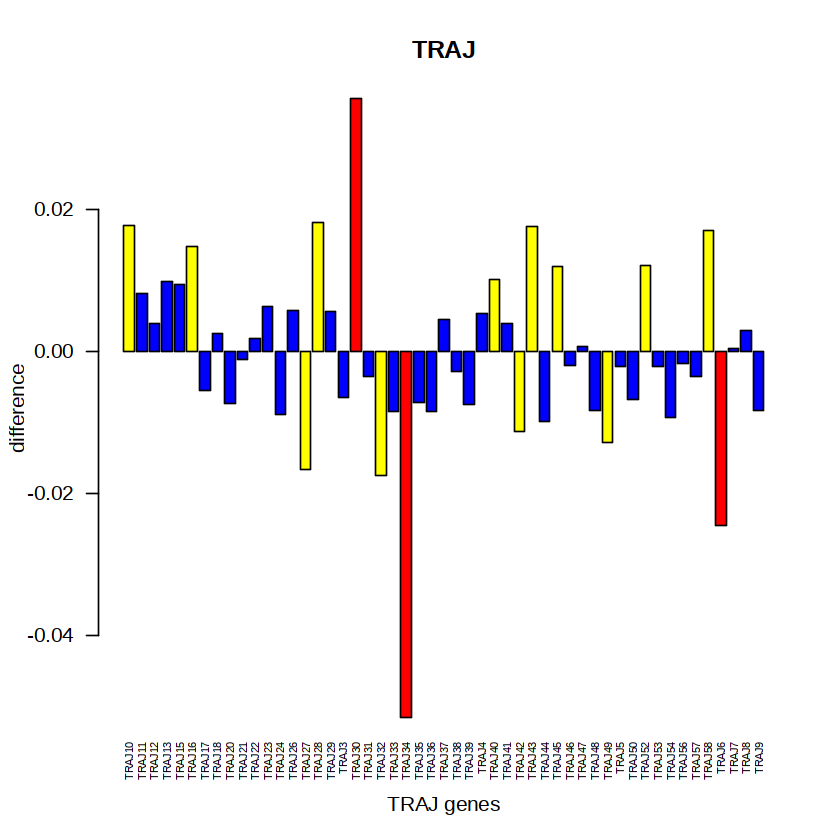

In [130]:
barplot(AJ_Var2$difference, names.arg = AJ_Var2$Var1,
       angle = 90, las=2, cex.names=0.5, col = AJ_Var2$colors, main = "TRAJ",
       xlab="TRAJ genes", ylab="difference")

In [142]:
BV_Var2_red <- subset(BV_Var2, subset = colors == "red")
BJ_Var2_red <- subset(BJ_Var2, subset = colors == "red")
AV_Var2_red <- subset(AV_Var2, subset = colors == "red")
AJ_Var2_red <- subset(AJ_Var2, subset = colors == "red")

BV_Var2_red;BJ_Var2_red;AV_Var2_red;AJ_Var2_red

,Var1,Var2.x,sd.x,mean.x,.group.x,Var2.y,sd.y,mean.y,.group.y,difference,colors
,<chr>,<chr>,<dbl>,<dbl>,<int>,<chr>,<dbl>,<dbl>,<int>,<dbl>,<chr>
8,TRBV12-4,a,0.028109986,0.041493958,15,c,0.037092945,0.06900942,16,-0.02751546,red
17,TRBV20-1,a,0.005770337,0.077952825,33,c,0.029210194,0.10531081,34,-0.02735799,red
20,TRBV27,a,0.012361772,0.050404129,39,c,0.003561243,0.02897321,40,0.02143092,red
27,TRBV4-3,a,NA,0.004615385,53,c,NA,0.02614379,54,-0.02152841,red
34,TRBV6-2,a,0.003939597,0.007714029,67,c,0.001780621,0.04106895,68,-0.03335492,red
43,TRBV7-9,a,0.048561688,0.091336029,86,c,0.022587883,0.05830009,87,0.03303594,red


,Var1,Var2.x,sd.x,mean.x,.group.x,Var2.y,sd.y,mean.y,.group.y,difference,colors
,<chr>,<chr>,<dbl>,<dbl>,<int>,<chr>,<dbl>,<dbl>,<int>,<dbl>,<chr>
8,TRBJ2-2,a,0.02667010,0.06575098,15,c,0.024408519,0.08856068,16,-0.02280970,red
9,TRBJ2-3,a,0.01153234,0.13520876,17,c,0.005802025,0.10463175,18,0.03057701,red
13,TRBJ2-7,a,0.03423211,0.18029943,25,c,0.064162393,0.14060776,26,0.03969167,red


,Var1,Var2.x,sd.x,mean.x,.group.x,Var2.y,sd.y,mean.y,.group.y,difference,colors
,<chr>,<chr>,<dbl>,<dbl>,<int>,<chr>,<dbl>,<dbl>,<int>,<dbl>,<chr>
2,TRAV1-2,a,0.007229464,0.03438215,3,c,0.02124742,0.06434089,4,-0.02995873,red
7,TRAV13-1,a,0.029759571,0.07120540,13,c,0.01242434,0.04053136,14,0.03067404,red
9,TRAV14/DV4,a,0.005800465,0.04165653,17,c,0.00696243,0.07444190,18,-0.03278537,red
12,TRAV19,a,0.011603673,0.06117596,23,c,0.01600559,0.01660866,24,0.04456730,red
24,TRAV3,a,0.008845155,0.03660827,47,c,0.01222427,0.01393487,48,0.02267340,red
35,TRAV5,a,0.007201818,0.03089848,69,c,0.05015751,0.05448038,70,-0.02358189,red
38,TRAV8-2,a,0.006774013,0.01297704,75,c,0.03243132,0.03351442,76,-0.02053738,red


,Var1,Var2.x,sd.x,mean.x,.group.x,Var2.y,sd.y,mean.y,.group.y,difference,colors
,<chr>,<chr>,<dbl>,<dbl>,<int>,<chr>,<dbl>,<dbl>,<int>,<dbl>,<chr>
19,TRAJ30,a,0.035342677,0.04392865,37,c,0.00424148,0.008290185,38,0.03563847,red
23,TRAJ34,a,0.010696091,0.02795751,45,c,0.06710342,0.079534844,46,-0.05157733,red
48,TRAJ6,a,0.005076817,0.01128324,95,c,0.02074724,0.035834536,96,-0.02455129,red


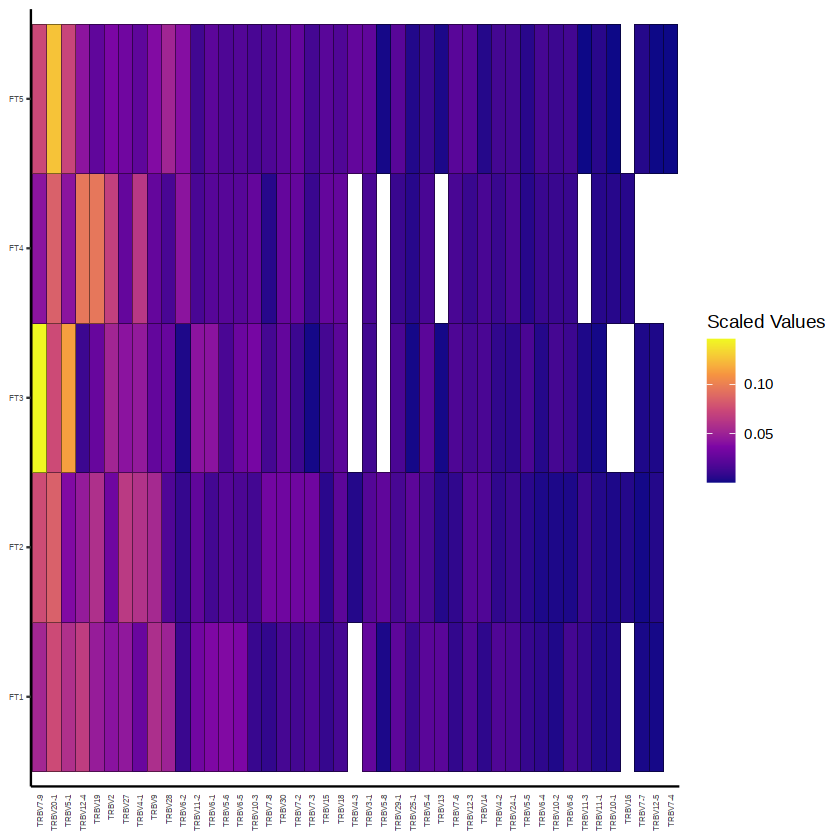

In [245]:
vizGenes(combined[c(1,2,3,4,5)], 
         gene = "V", 
         chain = "TRB", 
         plot = "heatmap",
         order="variance",
         scale = TRUE)

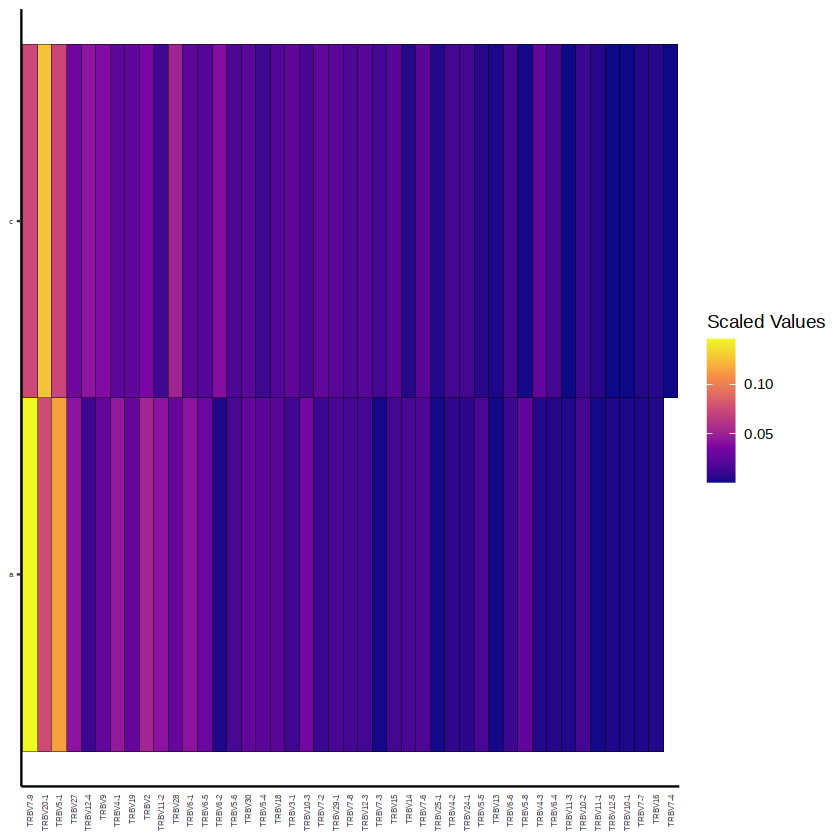

In [444]:
vizGenes(combined[c(1,2,3,4,5)], 
         gene = "V", 
         chain = "TRB", 
         plot = "heatmap",
         y.axis = "ID",
         order="variance",
         scale = TRUE)

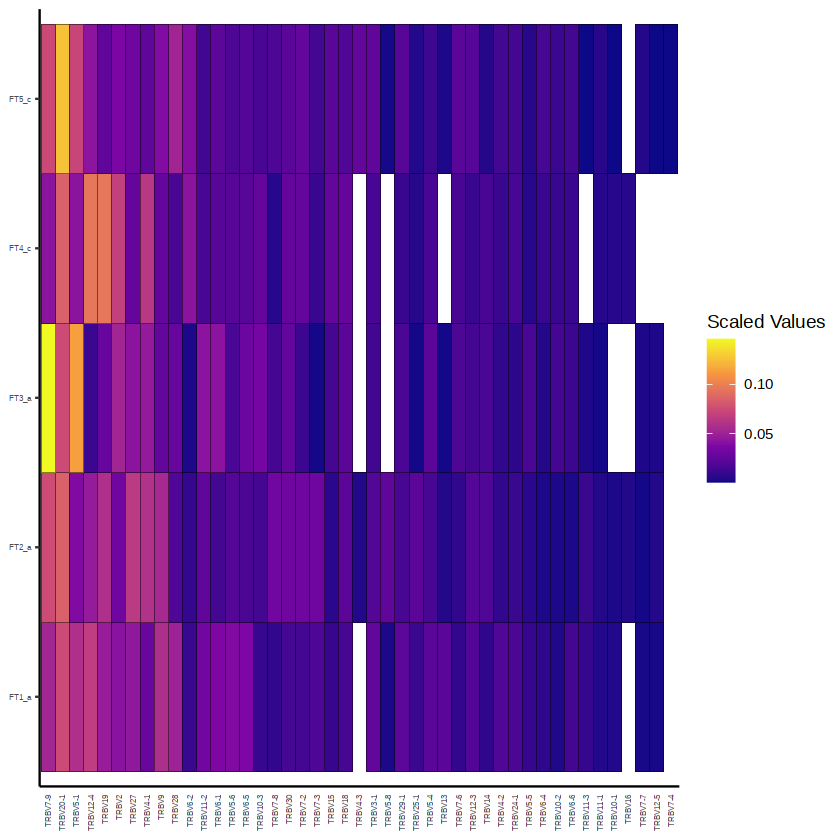

In [54]:
vizGenes(combined[c(1,2,3,4,5)], 
         gene = "V", 
         chain = "TRB", 
         plot = "heatmap",
         y.axis = "SampleID",
         order="variance",
         scale = TRUE)

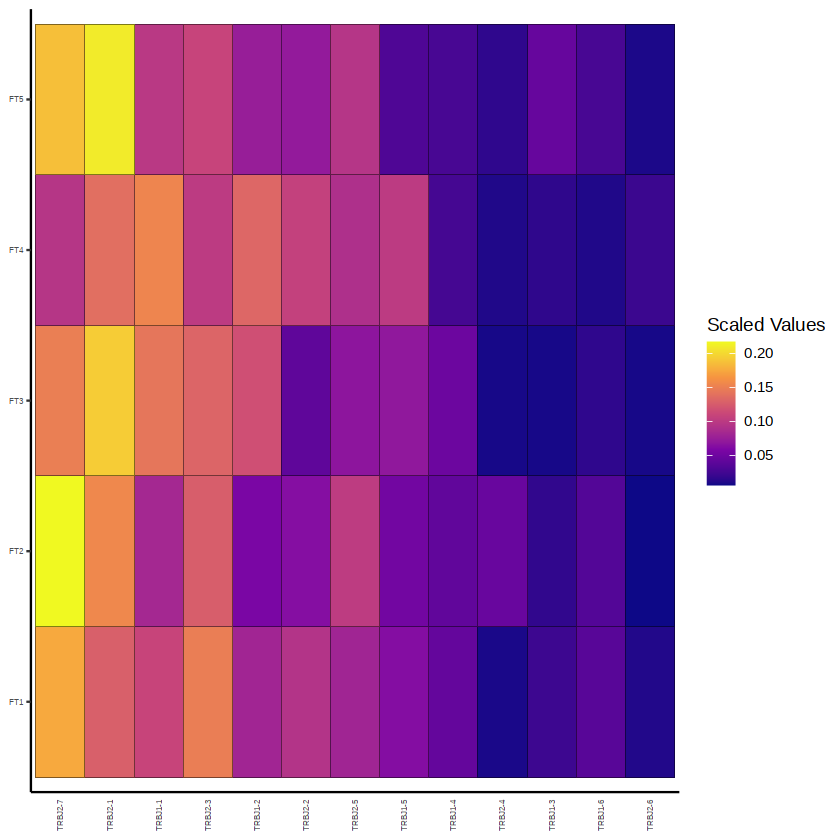

In [246]:
vizGenes(combined[c(1,2,3,4,5)], 
         gene = "J", 
         chain = "TRB", 
         plot = "heatmap",
         order="variance",
         scale = TRUE)

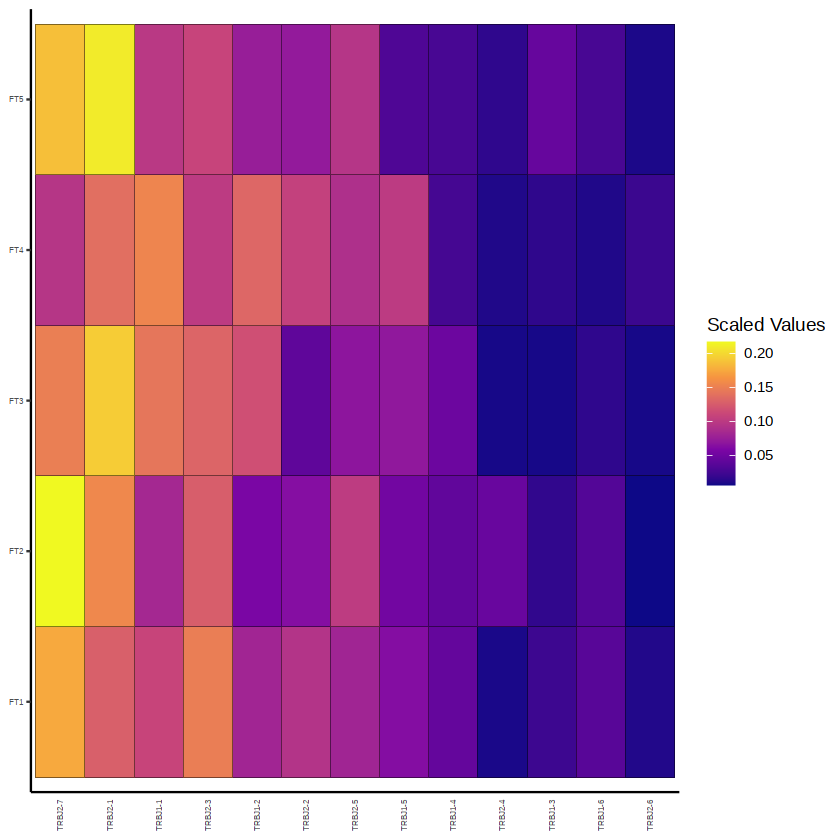

In [449]:
vizGenes(combined[c(1,2,3,4,5)], 
         gene = "J", 
         chain = "TRB", 
         plot = "heatmap",
         order="variance",
         scale = TRUE)

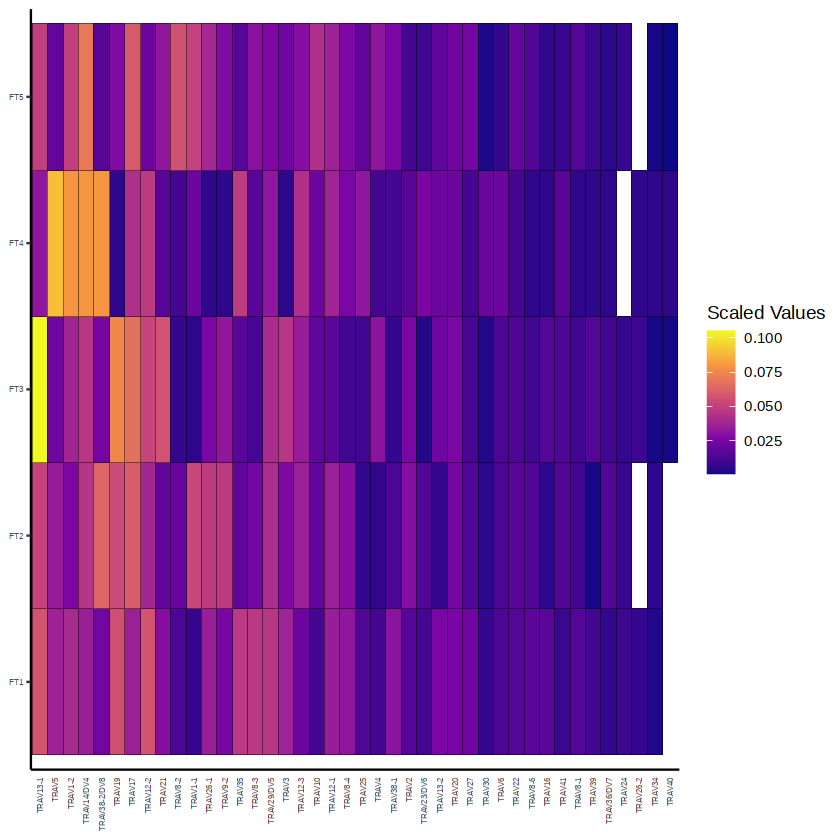

In [356]:
vizGenes(combined[c(1,2,3,4,5)], 
         gene = "V", 
         chain = "TRA", 
         plot = "heatmap",
         order="variance",
         scale = TRUE)

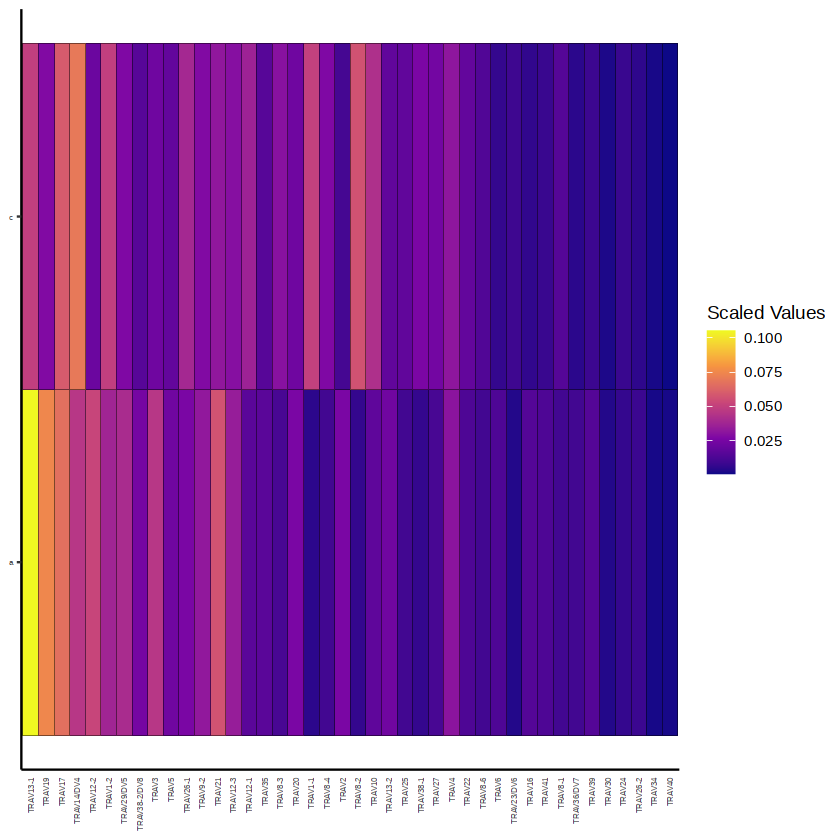

In [450]:
vizGenes(combined[c(1,2,3,4,5)], 
         gene = "V", 
         chain = "TRA", 
         plot = "heatmap",
         y.axis = "ID",
         order="variance",
         scale = TRUE)

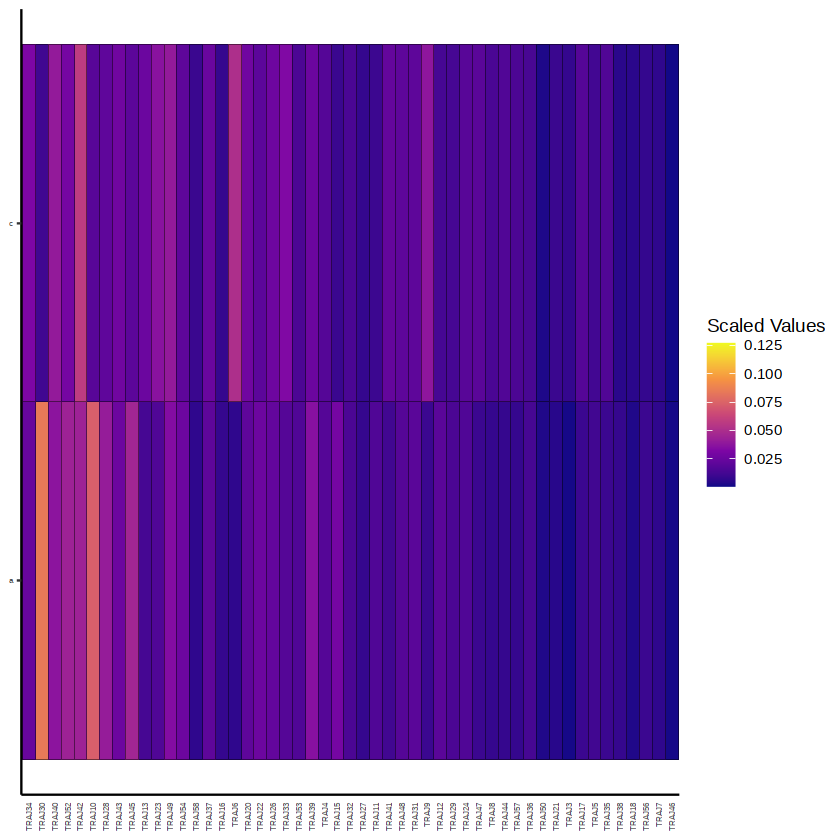

In [446]:
vizGenes(combined[c(1,2,3,4,5)], 
         gene = "J", 
         chain = "TRA", 
         plot = "heatmap",
         y.axis = "ID",
         order="variance",
         scale = TRUE)

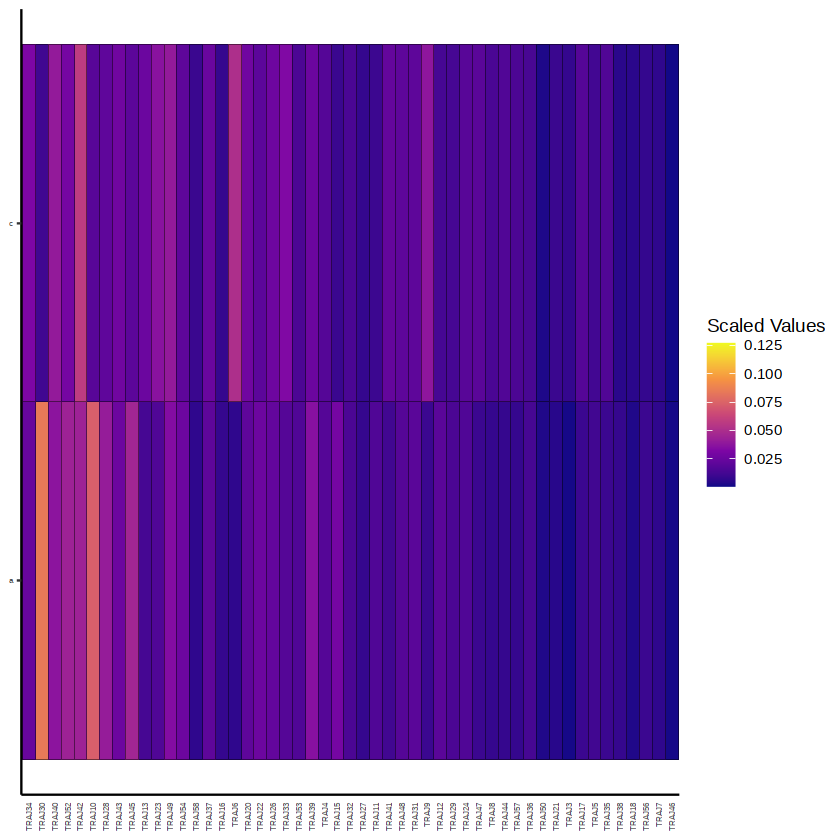

In [446]:
vizGenes(combined[c(1,2,3,4,5)], 
         gene = "J", 
         chain = "TRA", 
         plot = "heatmap",
         y.axis = "ID",
         order="variance",
         scale = TRUE)

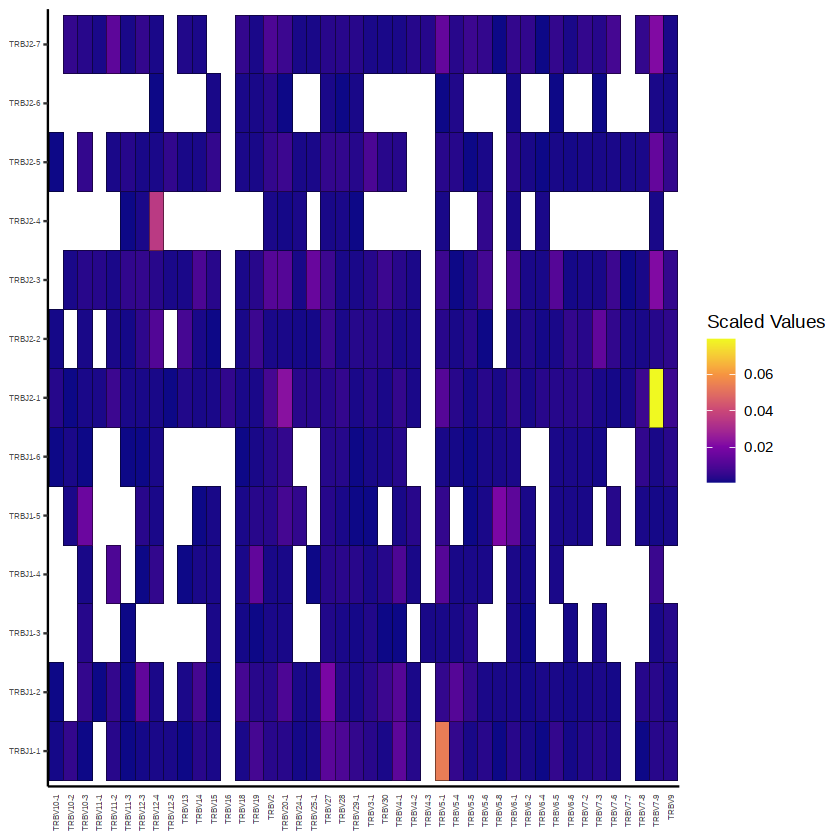

In [17]:
vizGenes(combined[c(1,2,3)],
        gene = "V",
        chain = "TRB",
        y.axis = "J",
        plot = "heatmap",
        scale = TRUE,
        order = "gene")

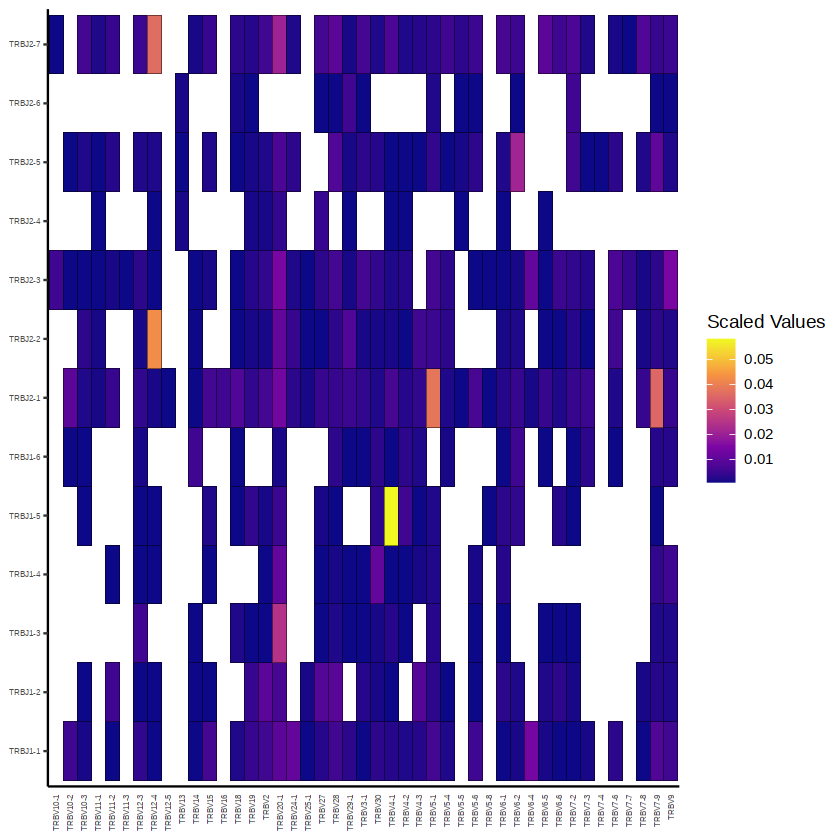

In [18]:
vizGenes(combined[c(4,5)],
        gene = "V",
        chain = "TRB",
        y.axis = "J",
        plot = "heatmap",
        scale = TRUE,
        order = "gene")

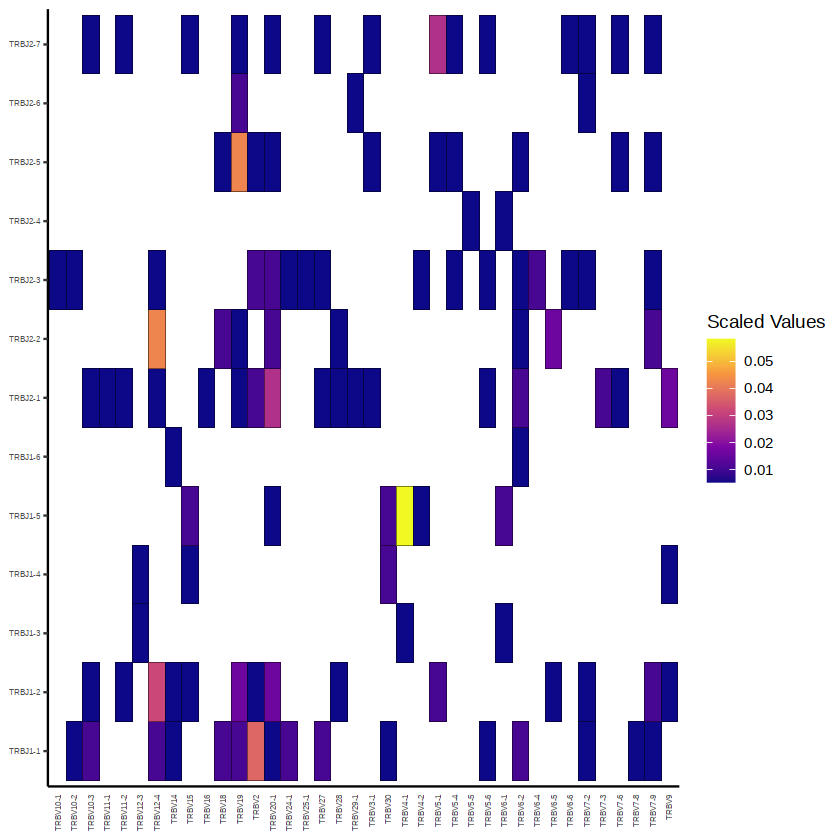

In [364]:
vizGenes(combined[c(4)],
        gene = "V",
        chain = "TRB",
        y.axis = "J",
        plot = "heatmap",
        scale = TRUE,
        order = "gene")

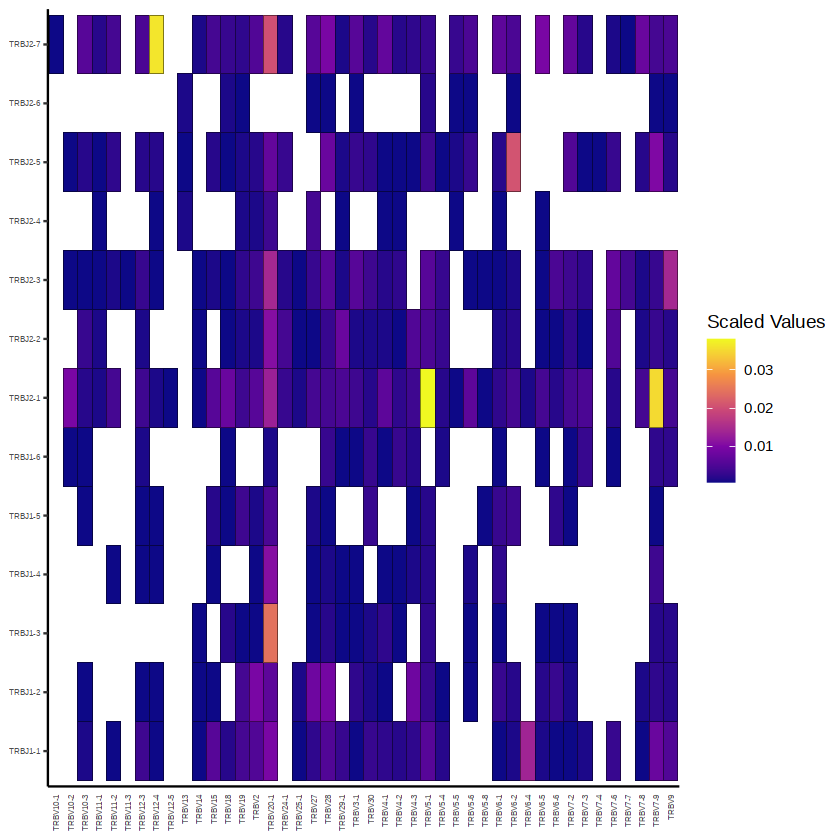

In [365]:
vizGenes(combined[c(5)],
        gene = "V",
        chain = "TRB",
        y.axis = "J",
        plot = "heatmap",
        scale = TRUE,
        order = "gene")

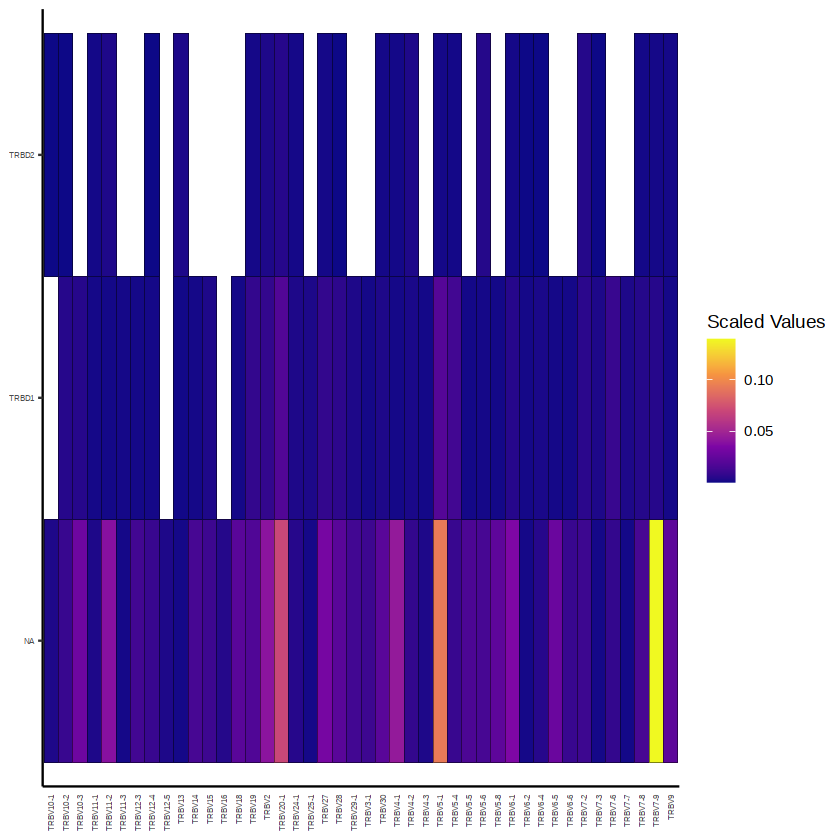

In [19]:
vizGenes(combined[c(1,2,3)],
        gene = "V",
        chain = "TRB",
        y.axis = "D",
        plot = "heatmap",
        scale = TRUE,
        order = "gene")

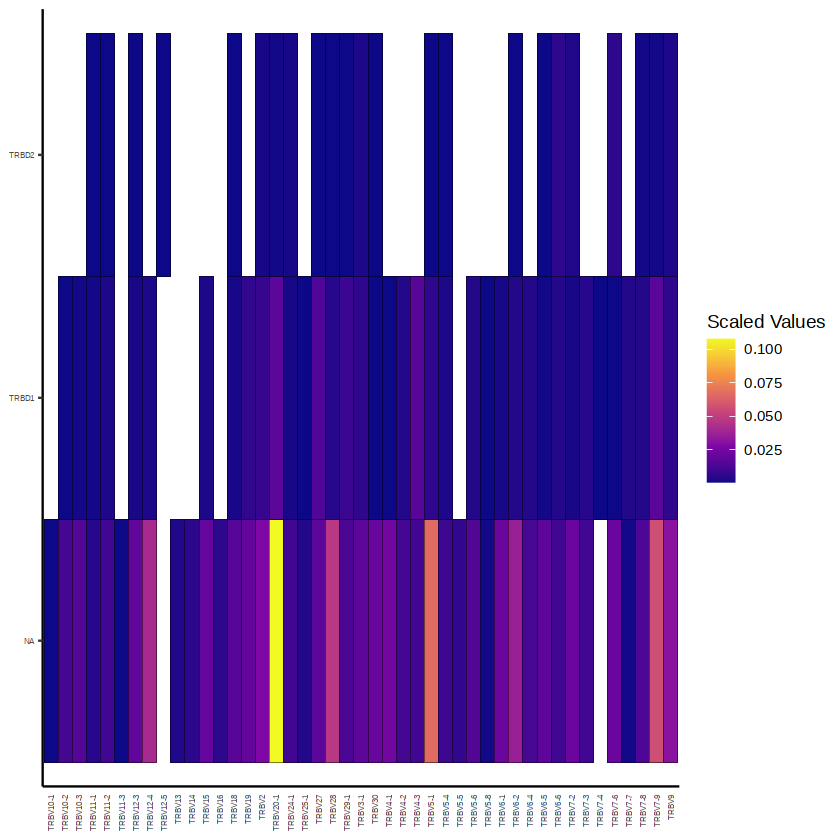

In [20]:
vizGenes(combined[c(4,5)],
        gene = "V",
        chain = "TRB",
        y.axis = "D",
        plot = "heatmap",
        scale = TRUE,
        order = "gene")

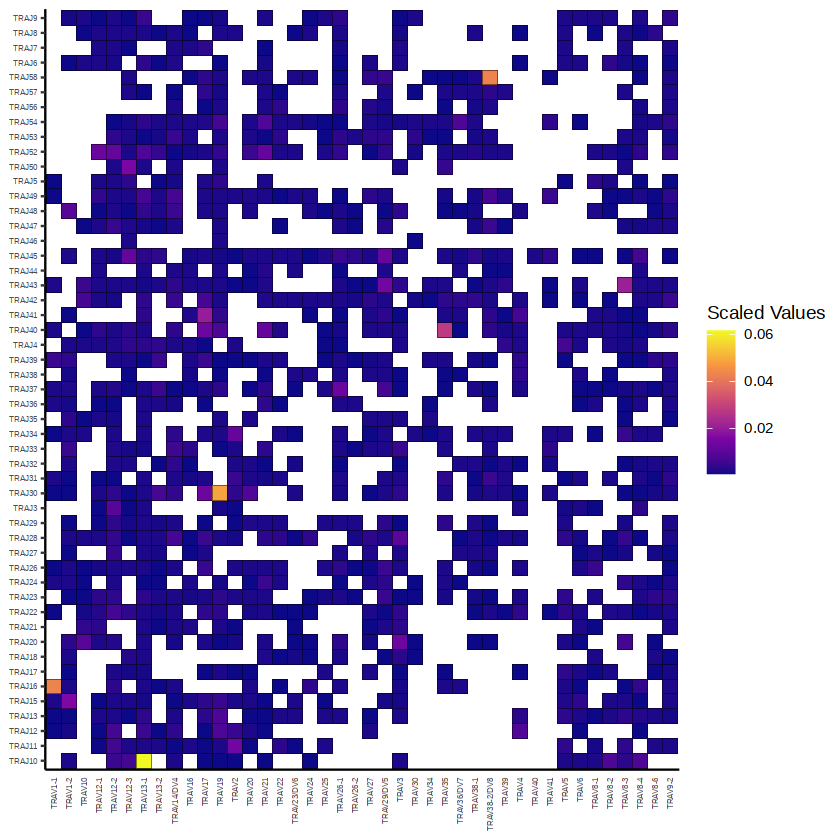

In [206]:
vizGenes(combined[c(1,2,3)],
        gene = "V",
        chain = "TRA",
        y.axis = "J",
        plot = "heatmap",
        scale = TRUE,
        order = "gene")

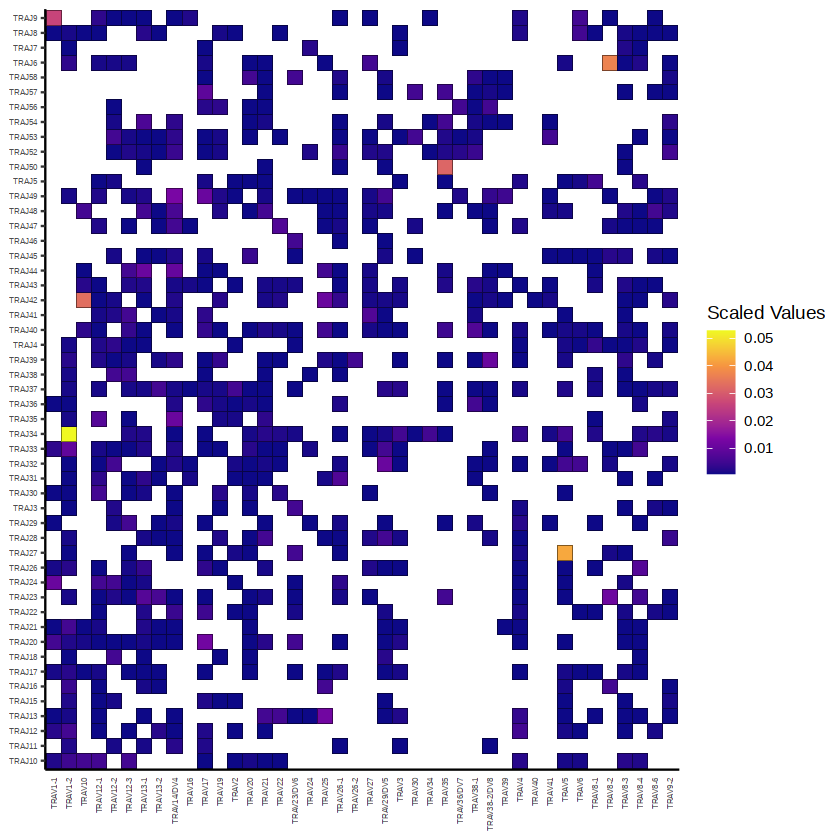

In [22]:
vizGenes(combined[c(4,5)],
        gene = "V",
        chain = "TRA",
        y.axis = "J",
        plot = "heatmap",
        scale = TRUE,
        order = "gene")

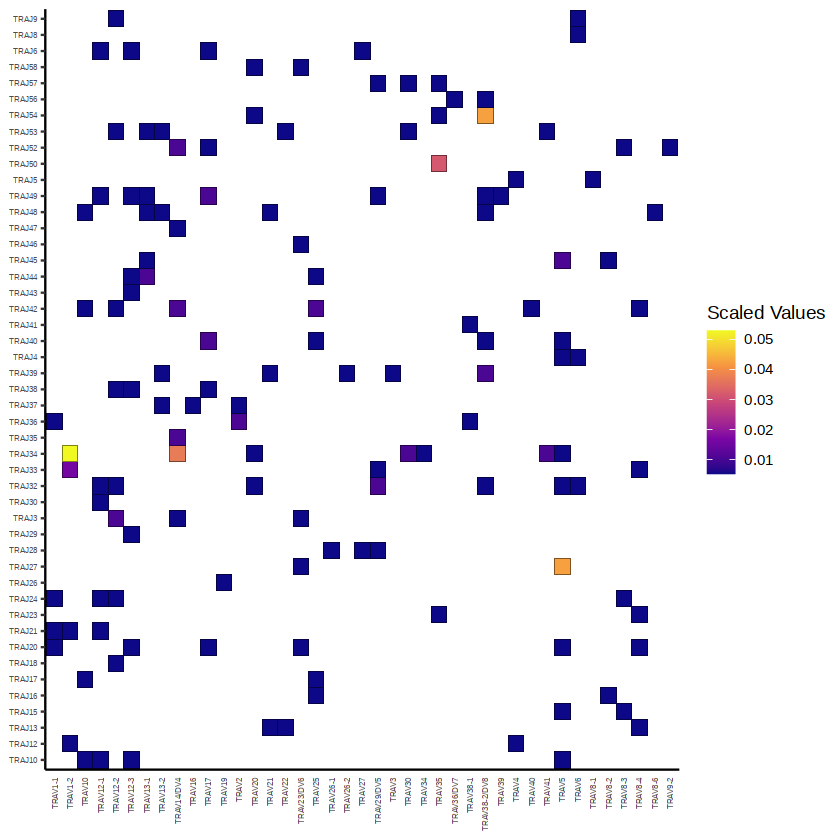

In [366]:
vizGenes(combined[c(4)],
        gene = "V",
        chain = "TRA",
        y.axis = "J",
        plot = "heatmap",
        scale = TRUE,
        order = "gene")

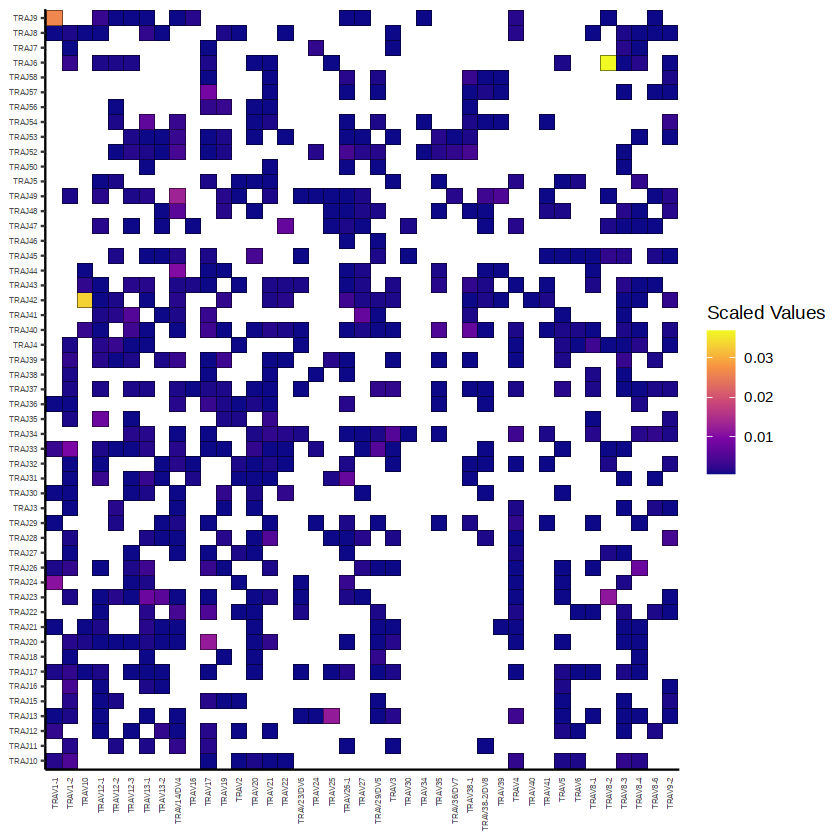

In [367]:
vizGenes(combined[c(5)],
        gene = "V",
        chain = "TRA",
        y.axis = "J",
        plot = "heatmap",
        scale = TRUE,
        order = "gene")

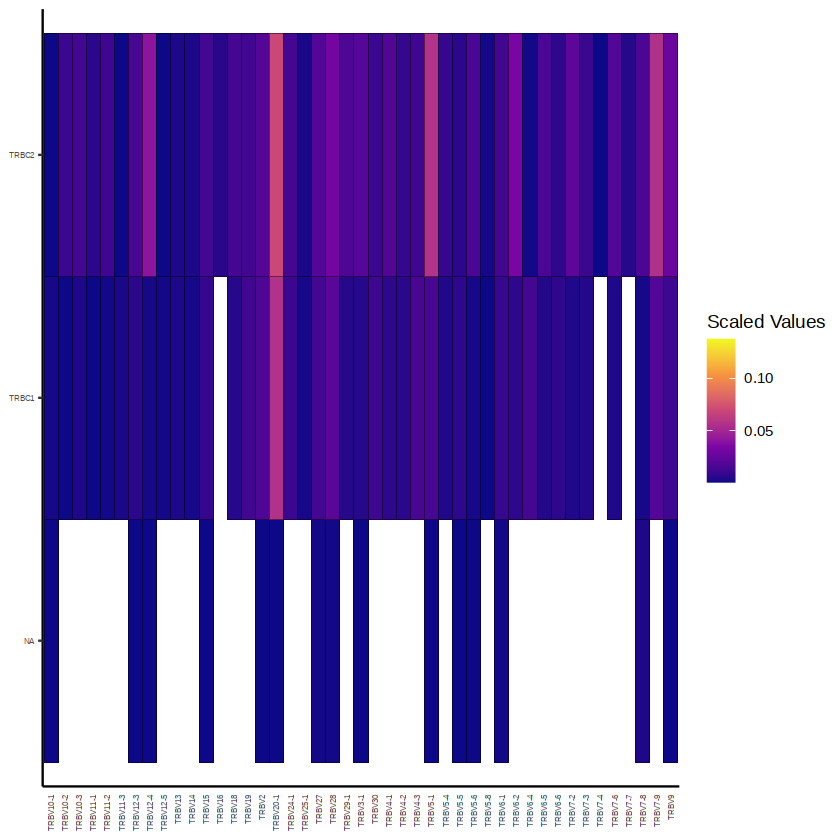

In [361]:
vizGenes(combined[c(1,2,3,4,5)],
        gene = "V",
        chain = "TRB",
        y.axis = "C",
        plot = "heatmap",
        scale = TRUE,
        order = "gene")

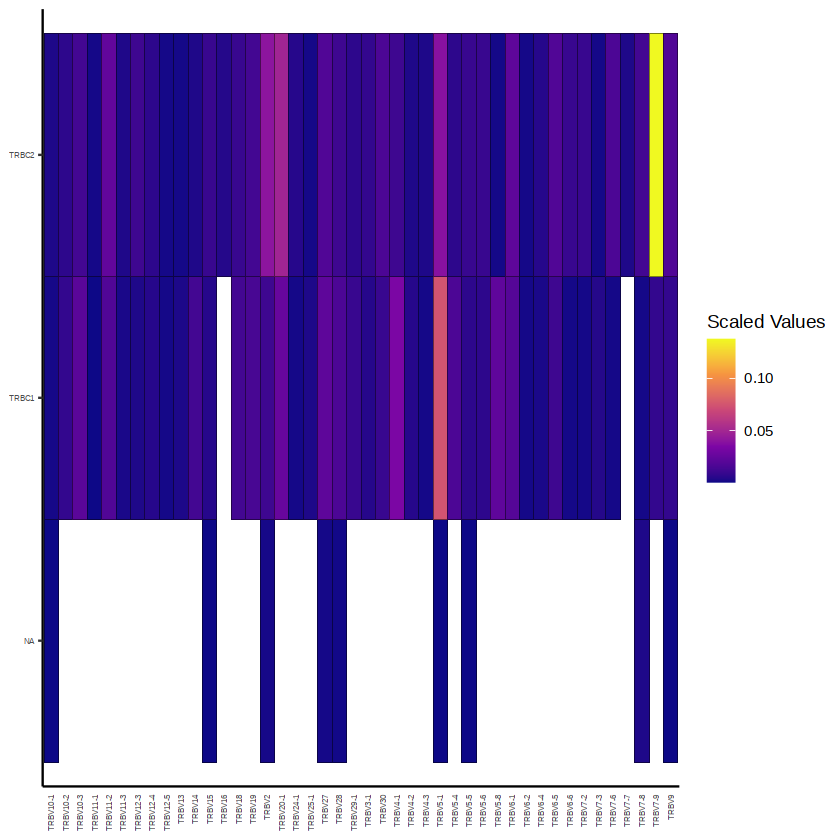

In [23]:
vizGenes(combined[c(1,2,3)],
        gene = "V",
        chain = "TRB",
        y.axis = "C",
        plot = "heatmap",
        scale = TRUE,
        order = "gene")

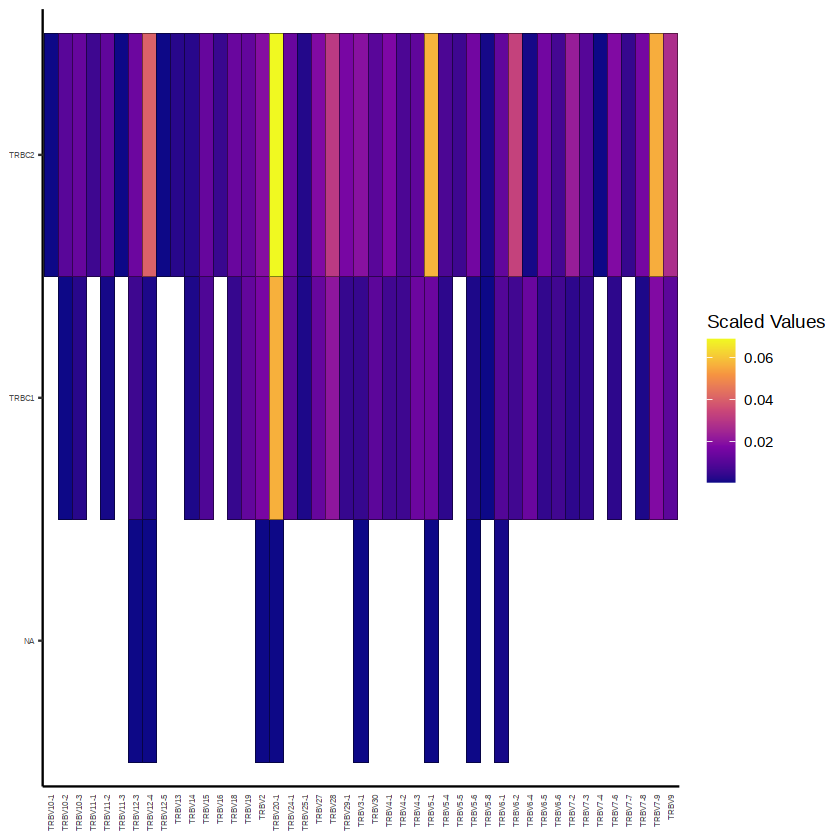

In [24]:
vizGenes(combined[c(4,5)],
        gene = "V",
        chain = "TRB",
        y.axis = "C",
        plot = "heatmap",
        scale = TRUE,
        order = "gene")

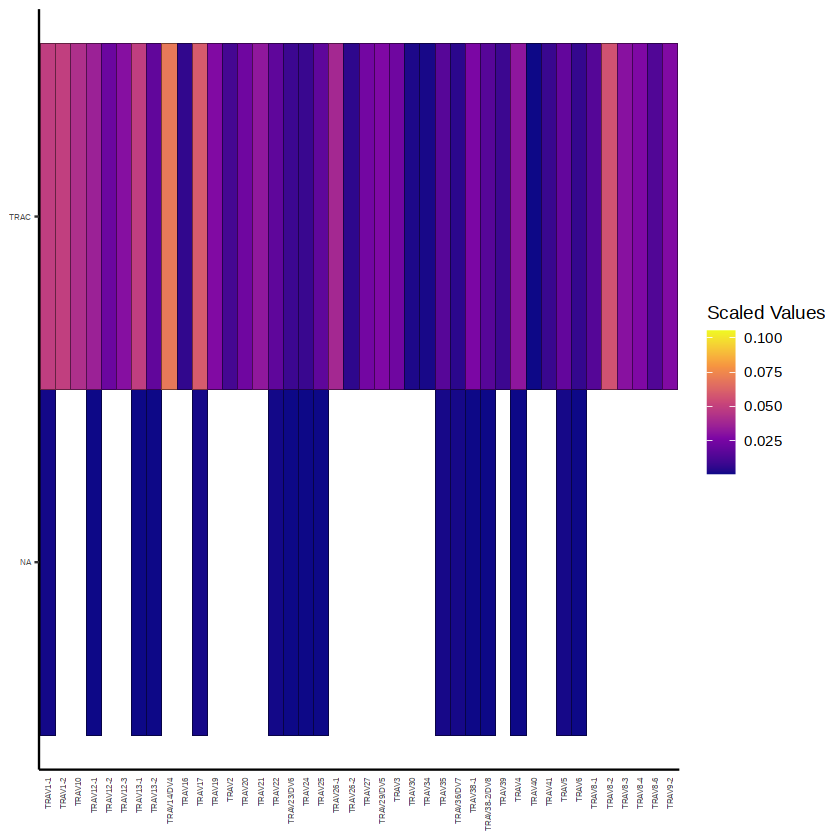

In [362]:
vizGenes(combined[c(1,2,3,4,5)],
        gene = "V",
        chain = "TRA",
        y.axis = "C",
        plot = "heatmap",
        scale = TRUE,
        order = "gene")

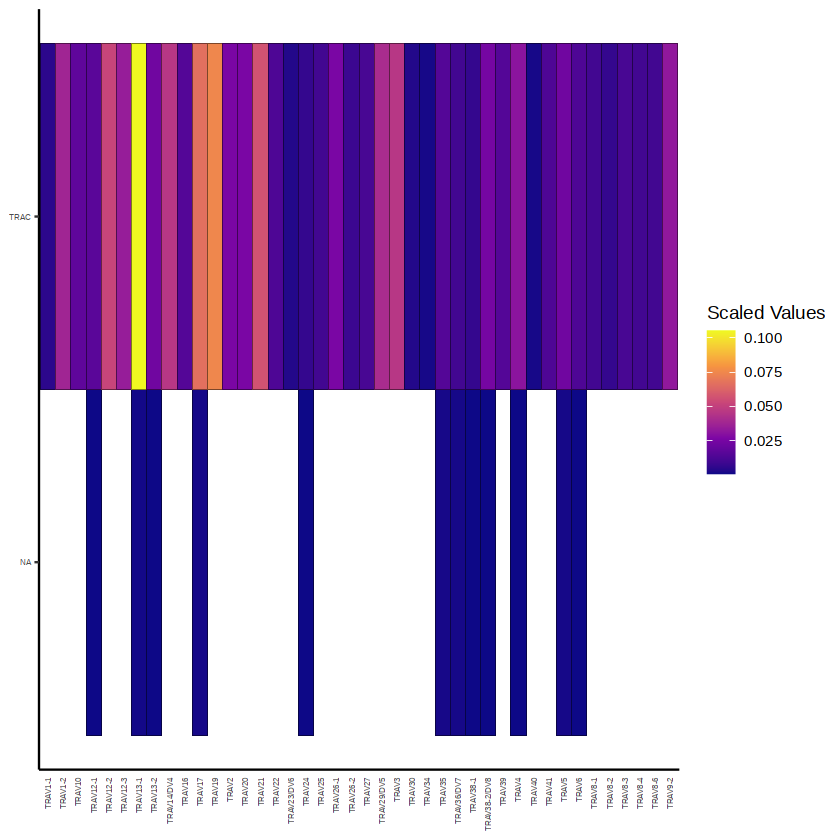

In [239]:
vizGenes(combined[c(1,2,3)],
        gene = "V",
        chain = "TRA",
        y.axis = "C",
        plot = "heatmap",
        scale = TRUE,
        order = "gene")

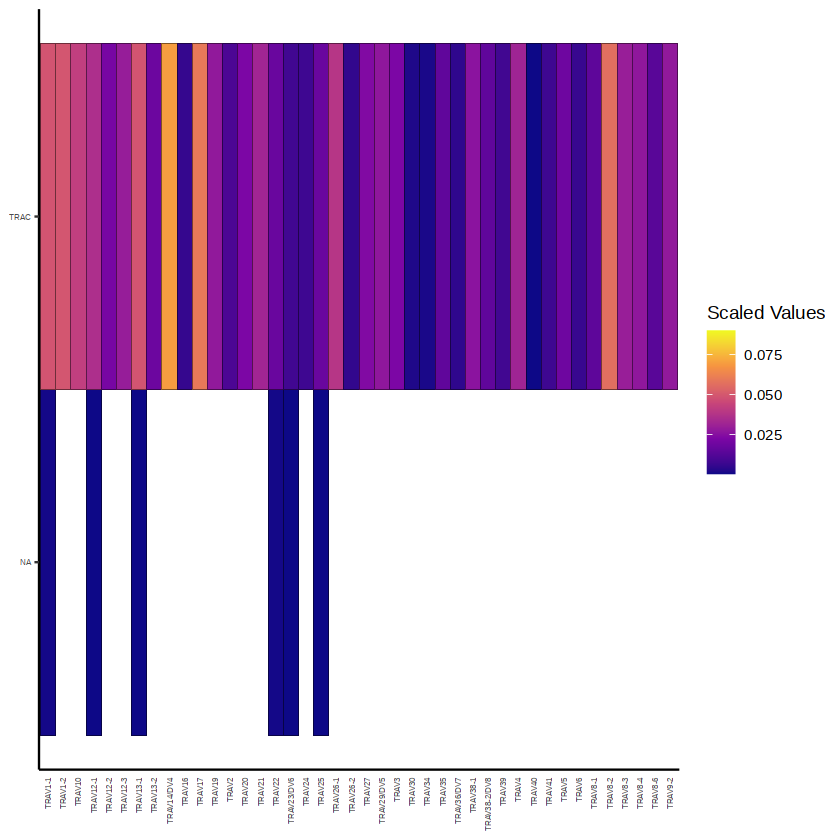

In [240]:
vizGenes(combined[c(4,5)],
        gene = "V",
        chain = "TRA",
        y.axis = "C",
        plot = "heatmap",
        scale = TRUE,
        order = "gene")

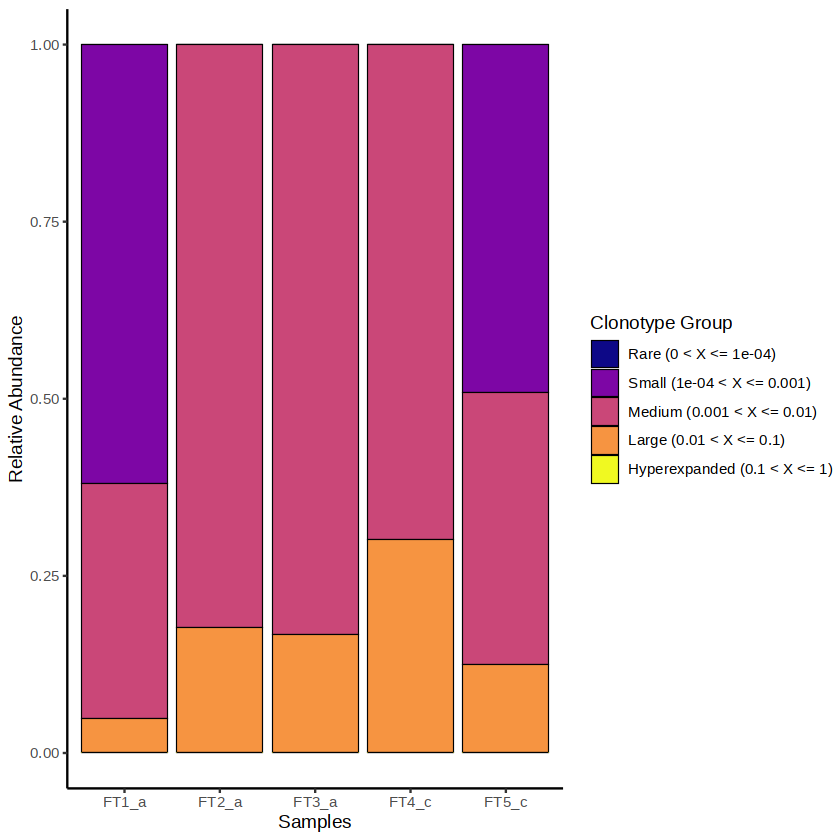

In [306]:
clonalHomeostasis(combined, cloneCall = "gene", 
                  cloneTypes = c(Rare = 1e-04, 
                                 Small = 0.001, 
                                 Medium = 0.01, 
                                 Large = 0.1, 
                                 Hyperexpanded = 1))

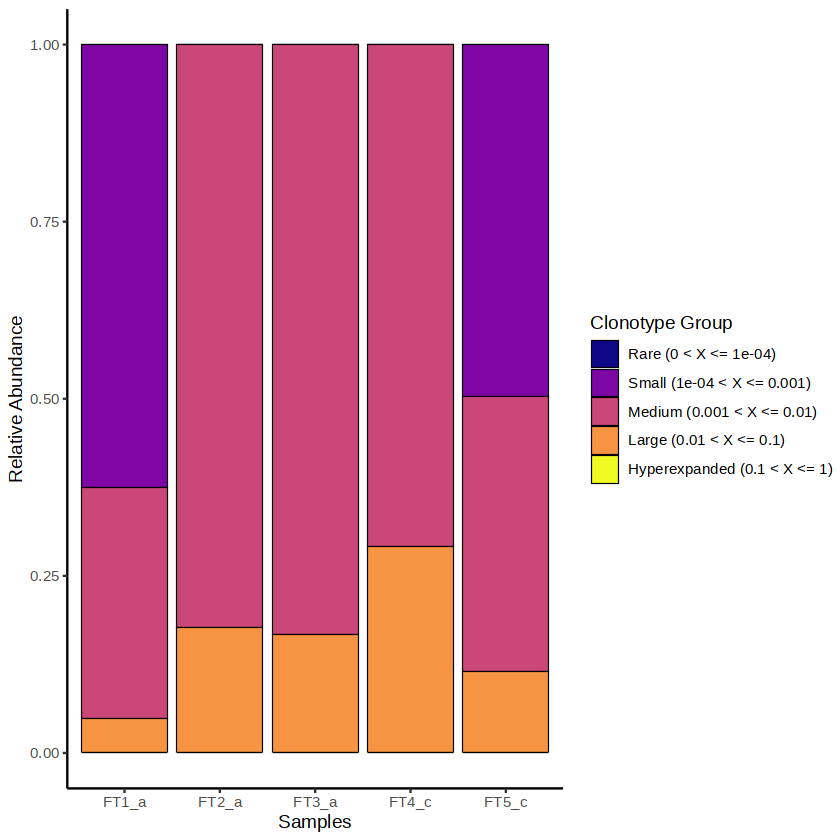

In [199]:
clonalHomeostasis(combined, cloneCall = "aa")

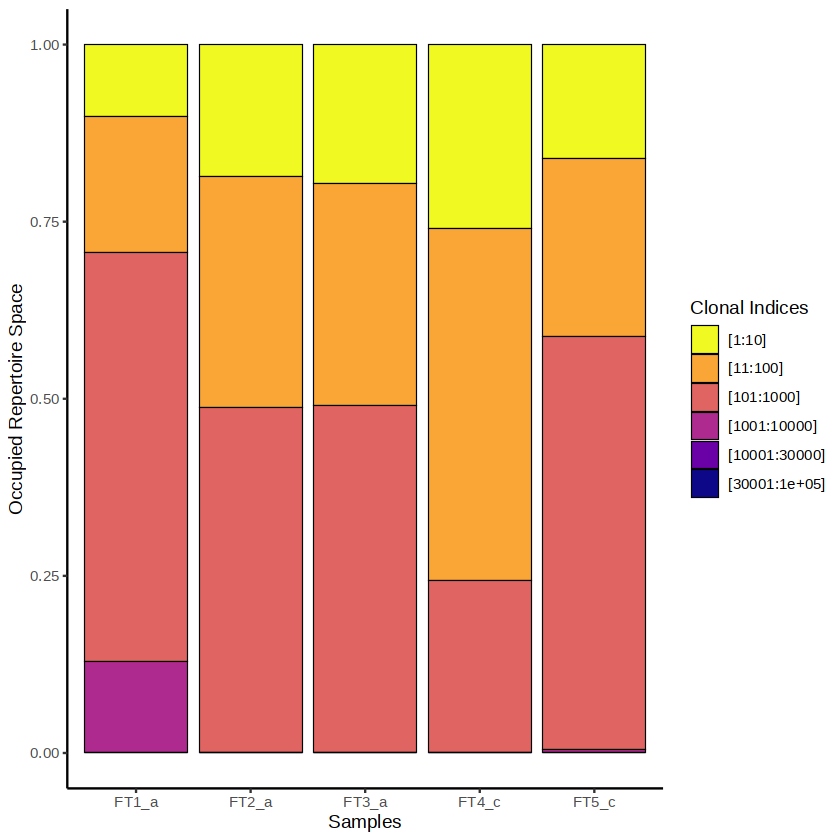

In [308]:
clonalProportion(combined, cloneCall = "gene")

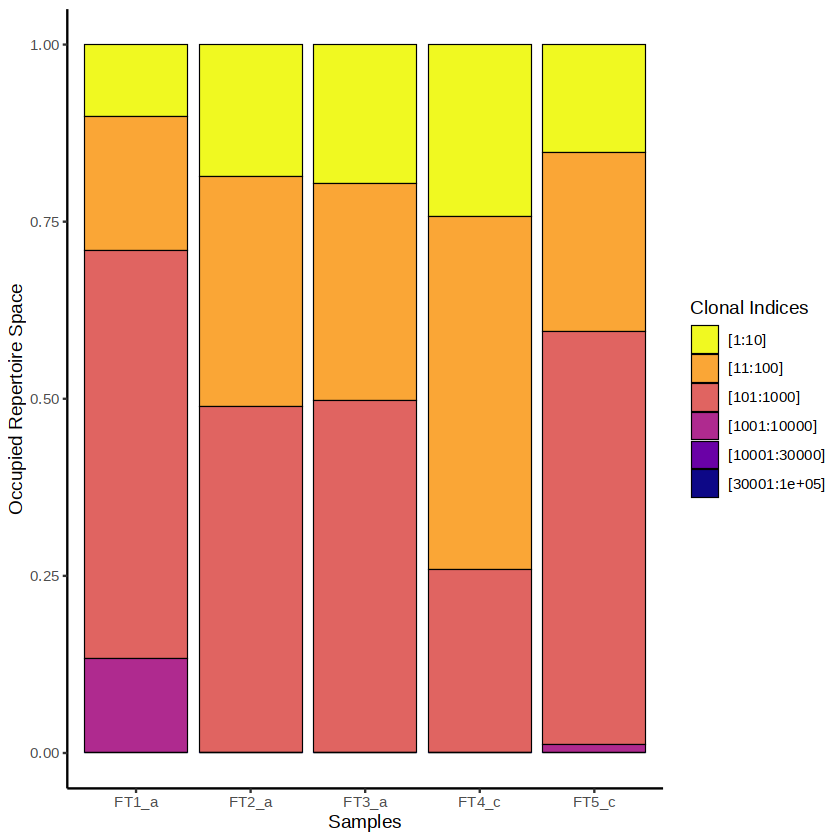

In [309]:
clonalProportion(combined, cloneCall = "nt")

In [151]:
clonalOverlap(combined,
             cloneCall = "strict",
             method = "morisita")
#data("contig_list") 필요

ERROR while rich displaying an object: Error in `geom_text()`:
! Problem while converting geom to grob.
ℹ Error occurred in the 2nd layer.
Caused by error:
! (converted from warning) Removed 10 rows containing missing values (`geom_text()`).

Traceback:
1. tryCatch(withCallingHandlers({
 .     if (!mime %in% names(repr::mime2repr)) 
 .         stop("No repr_* for mimetype ", mime, " in repr::mime2repr")
 .     rpr <- repr::mime2repr[[mime]](obj)
 .     if (is.null(rpr)) 
 .         return(NULL)
 .     prepare_content(is.raw(rpr), rpr)
 . }, error = error_handler), error = outer_handler)
2. tryCatchList(expr, classes, parentenv, handlers)
3. tryCatchOne(expr, names, parentenv, handlers[[1L]])
4. doTryCatch(return(expr), name, parentenv, handler)
5. withCallingHandlers({
 .     if (!mime %in% names(repr::mime2repr)) 
 .         stop("No repr_* for mimetype ", mime, " in repr::mime2repr")
 .     rpr <- repr::mime2repr[[mime]](obj)
 .     if (is.null(rpr)) 
 .         return(NULL)
 .     p

Warning message:
“Removed 10 rows containing missing values (`geom_text()`).”


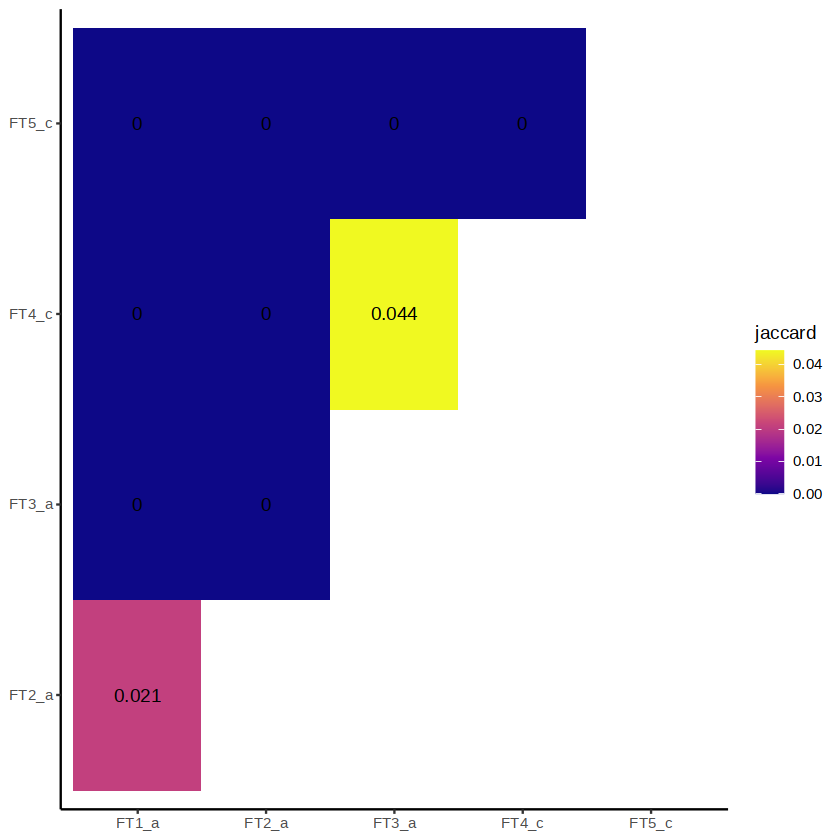

In [236]:
clonalOverlap(combined,
             cloneCall = "strict",
             method = "jaccard")
#data("contig_list") 필요

Warning message:
“Removed 10 rows containing missing values (`geom_text()`).”


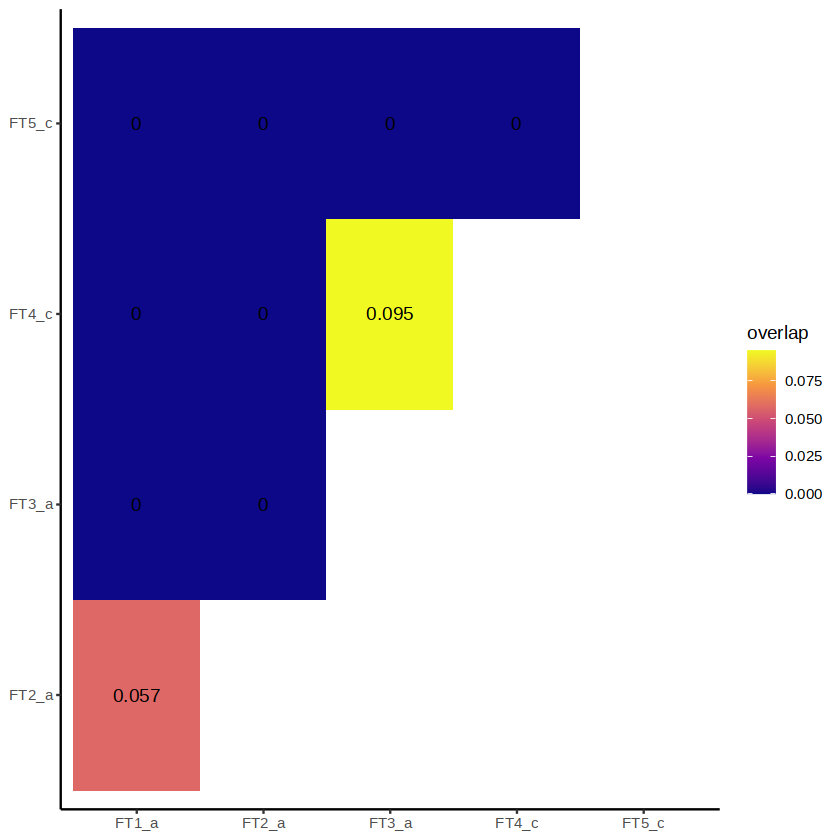

In [237]:
clonalOverlap(combined,
             cloneCall = "strict",
             method = "overlap")
#data("contig_list") 필요

NULL

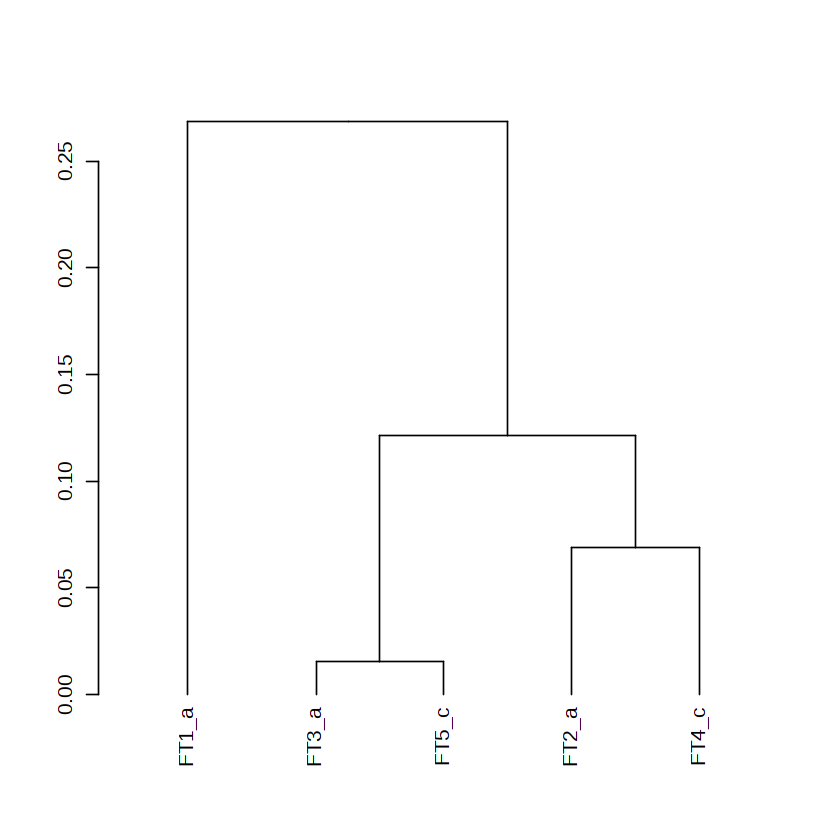

In [49]:
clonesizeDistribution(combined,
                     cloneCall = "gene+nt",
                      chain = "both",
                     method = "ward.D2")
#data("contig_list") 필요

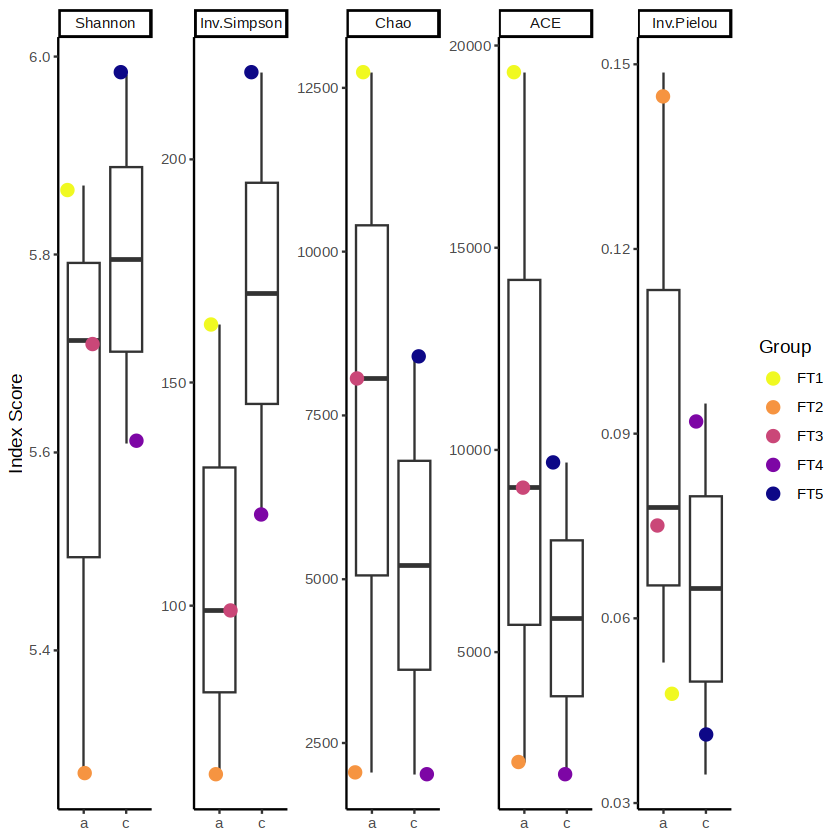

In [238]:
clonalDiversity(combined,
               cloneCall = "gene",
               group.by = "sample",
               x.axis = "ID",
               n.boots = 100)

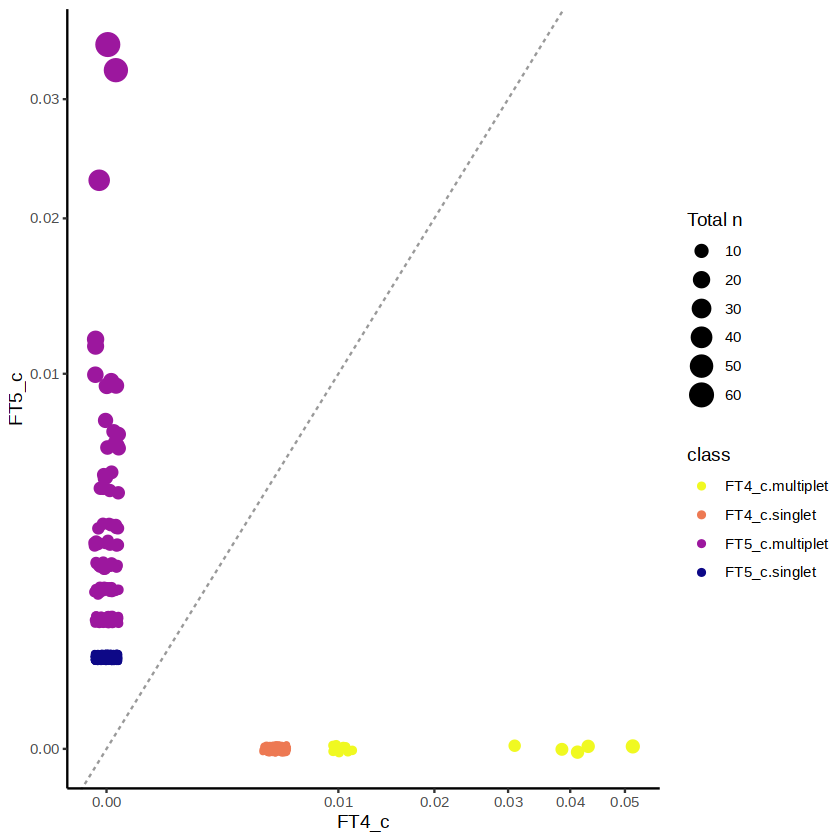

In [312]:
scatterClonotype(combined, cloneCall ="gene", 
                 x.axis = "FT4_c", 
                 y.axis = "FT5_c",
                 dot.size = "total",
                 graph = "proportion")

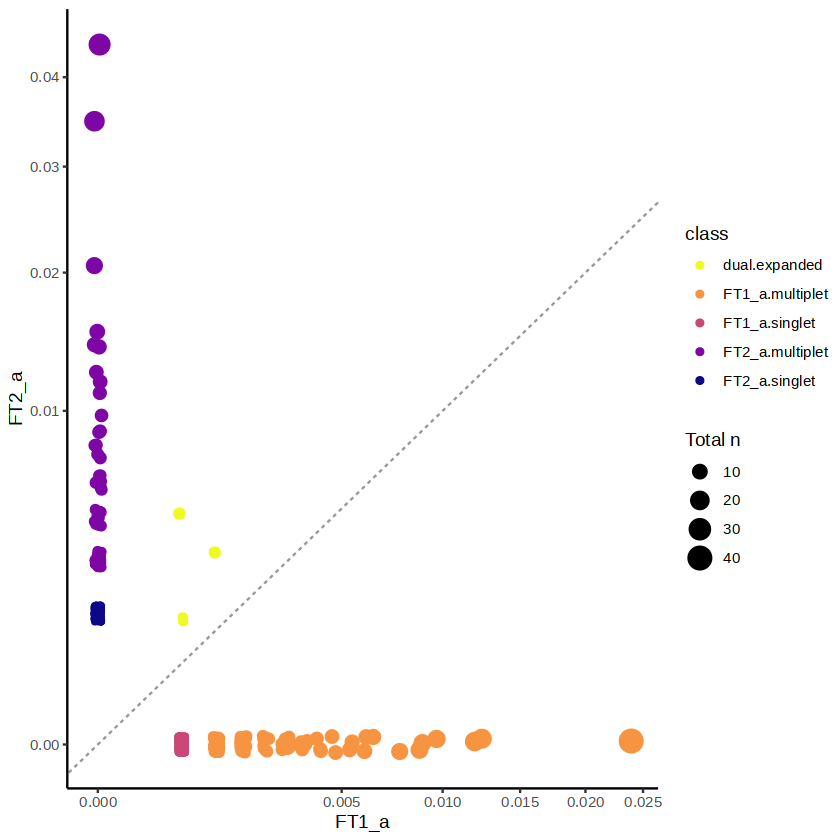

In [313]:
scatterClonotype(combined, cloneCall ="gene", 
                 x.axis = "FT1_a", 
                 y.axis = "FT2_a",
                 dot.size = "total",
                 graph = "proportion")

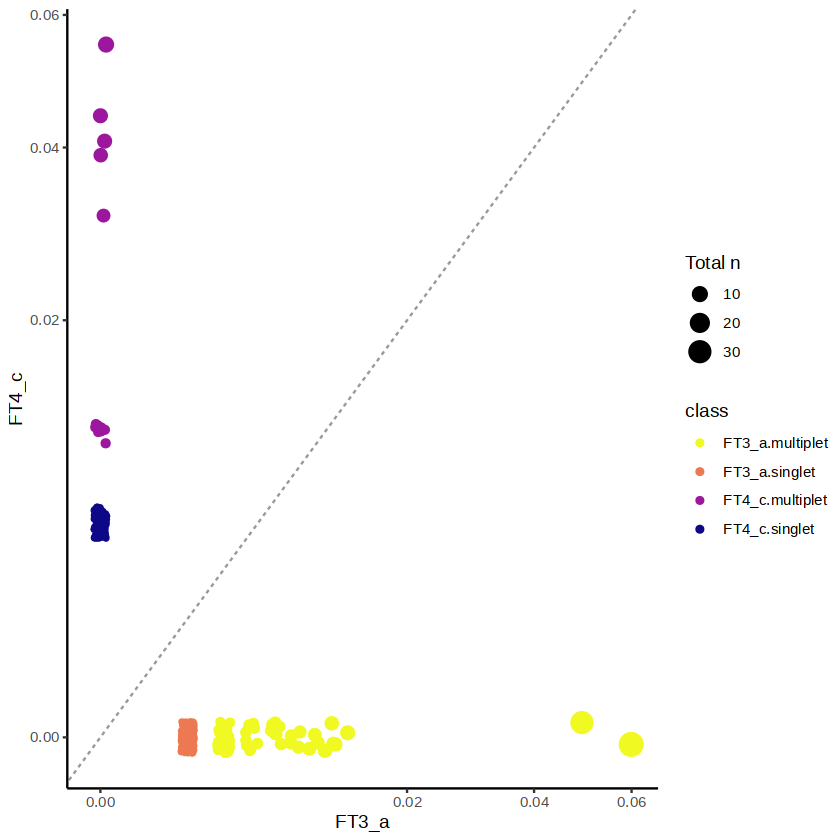

In [314]:
scatterClonotype(combined, cloneCall ="gene", 
                 x.axis = "FT3_a", 
                 y.axis = "FT4_c",
                 dot.size = "total",
                 graph = "proportion")

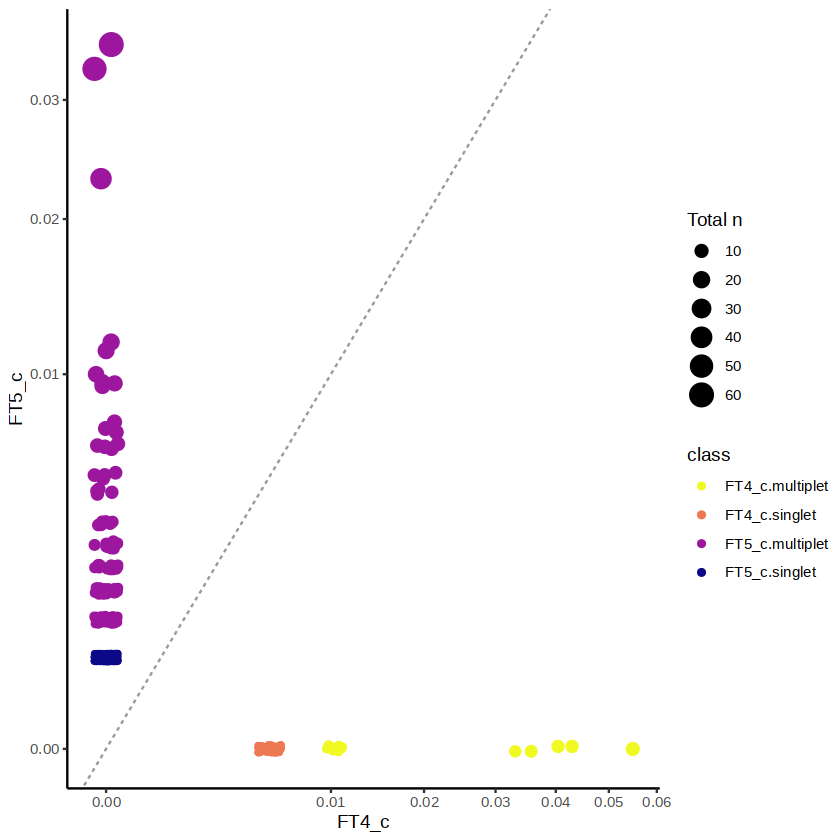

In [27]:
scatterClonotype(combined, cloneCall ="gene", 
                 x.axis = "FT4_c", 
                 y.axis = "FT5_c",
                 dot.size = "total",
                 graph = "proportion")

In [4]:
library(Seurat)
library(scater)

Attaching SeuratObject

Loading required package: SingleCellExperiment

Loading required package: SummarizedExperiment

Loading required package: MatrixGenerics

Loading required package: matrixStats


Attaching package: ‘MatrixGenerics’


The following objects are masked from ‘package:matrixStats’:

    colAlls, colAnyNAs, colAnys, colAvgsPerRowSet, colCollapse,
    colCounts, colCummaxs, colCummins, colCumprods, colCumsums,
    colDiffs, colIQRDiffs, colIQRs, colLogSumExps, colMadDiffs,
    colMads, colMaxs, colMeans2, colMedians, colMins, colOrderStats,
    colProds, colQuantiles, colRanges, colRanks, colSdDiffs, colSds,
    colSums2, colTabulates, colVarDiffs, colVars, colWeightedMads,
    colWeightedMeans, colWeightedMedians, colWeightedSds,
    colWeightedVars, rowAlls, rowAnyNAs, rowAnys, rowAvgsPerColSet,
    rowCollapse, rowCounts, rowCummaxs, rowCummins, rowCumprods,
    rowCumsums, rowDiffs, rowIQRDiffs, rowIQRs, rowLogSumExps,
    rowMadDiffs, rowMads, rowMaxs, rowMeans2, r

In [28]:
# FT_data <- readRDS("/home/jurny0402/TCR_explore/code/clustered_FT.rds")

In [5]:
FT_data <- readRDS("/home/jurny0402/TCR_explore/code/contigid_barcode_adjusted_clustered_FT.rds")

In [57]:
adenoma <- readRDS('/home/jurny0402/TCR_explore/code/230530_adenoma.rds')
carcinoma <- readRDS('/home/jurny0402/TCR_explore/code/230530_carcinoma.rds')

In [2]:
rownames(FT_data@meta.data)[15000]

[1] "FT2_CGATGTAGTTCCGGCA.1"

In [15]:
View(FT_data@meta.data)

,orig.ident,nCount_RNA,nFeature_RNA,percent.mt,SampleID,tissue_type,nCount_SCT,nFeature_SCT,SCT_snn_res.1,seurat_clusters,barcode,contig_id
,<chr>,<dbl>,<int>,<dbl>,<chr>,<chr>,<dbl>,<int>,<fct>,<fct>,<chr>,<chr>
FT1_GATCGATTCAACCAAC.1_1,FT1,9946,3358,1.4176553,FT1,tumor,4332,2089,22,22,GATCGATTCAACCAAC-1,GATCGATTCAACCAAC-1_contig_2
FT1_CCATGTCCAGTCCTTC.1_1,FT1,9993,3343,1.1908336,FT1,tumor,4368,2087,25,25,CCATGTCCAGTCCTTC-1,CCATGTCCAGTCCTTC-1_contig_2
FT1_GGCTGGTTCGGAAACG.1_1,FT1,9984,3487,3.0849359,FT1,tumor,4536,2311,15,15,GGCTGGTTCGGAAACG-1,GGCTGGTTCGGAAACG-1_contig_2
FT1_CCCAGTTAGTGGTCCC.1_1,FT1,9996,3881,0.8403361,FT1,tumor,4538,2548,1,1,CCCAGTTAGTGGTCCC-1,CCCAGTTAGTGGTCCC-1_contig_2
FT1_ACGCCGATCACTTATC.1_1,FT1,10000,4089,2.1600000,FT1,tumor,4517,2656,1,1,ACGCCGATCACTTATC-1,ACGCCGATCACTTATC-1_contig_2
FT1_GGGCACTGTGTTAAGA.1_1,FT1,9935,3444,1.4494212,FT1,tumor,4327,2206,5,5,GGGCACTGTGTTAAGA-1,GGGCACTGTGTTAAGA-1_contig_2
FT1_CACAAACGTGTGTGCC.1_1,FT1,9961,3892,1.6062644,FT1,tumor,4546,2601,1,1,CACAAACGTGTGTGCC-1,CACAAACGTGTGTGCC-1_contig_2
FT1_GTAGTCAGTCCAGTAT.1_1,FT1,9958,3207,1.2954409,FT1,tumor,4345,1990,3,3,GTAGTCAGTCCAGTAT-1,GTAGTCAGTCCAGTAT-1_contig_2
FT1_CTTAACTCACTGTTAG.1_1,FT1,9957,3839,2.7217033,FT1,tumor,4642,2495,14,14,CTTAACTCACTGTTAG-1,CTTAACTCACTGTTAG-1_contig_2


In [17]:
rownames(FT_data@meta.data)

[1] "FT1_GATCGATTCAACCAAC.1_1" "FT1_CCATGTCCAGTCCTTC.1_1"
    [3] "FT1_GGCTGGTTCGGAAACG.1_1" "FT1_CCCAGTTAGTGGTCCC.1_1"
    [5] "FT1_ACGCCGATCACTTATC.1_1" "FT1_GGGCACTGTGTTAAGA.1_1"
    [7] "FT1_CACAAACGTGTGTGCC.1_1" "FT1_GTAGTCAGTCCAGTAT.1_1"
    [9] "FT1_CTTAACTCACTGTTAG.1_1" "FT1_CATCGAAAGAGCAATT.1_1"
   [11] "FT1_CAGCATAGTGTAAGTA.1_1" "FT1_TGTGGTATCTACTATC.1_1"
   [13] "FT1_ACACCGGGTGAACCTT.1_1" "FT1_CAGCTAAGTAAGAGGA.1_1"
   [15] "FT1_CTAATGGAGCTGCCCA.1_1" "FT1_CACTCCATCTCATTCA.1_1"
   [17] "FT1_AGGTCCGGTGCGGTAA.1_1" "FT1_GATTCAGAGCTAACAA.1_1"
   [19] "FT1_AACTCAGGTCCGTTAA.1_1" "FT1_CAGGTGCGTGATGTCT.1_1"
   [21] "FT1_GGGACCTGTACCTACA.1_1" "FT1_CCATGTCGTAGAGGAA.1_1"
   [23] "FT1_ACACCAAGTTTGTGTG.1_1" "FT1_AGCTCTCAGGCAAAGA.1_1"
   [25] "FT1_CACTCCAAGTTACGGG.1_1" "FT1_TACCTATGTCGACTAT.1_1"
   [27] "FT1_GGCTCGATCTGGTTCC.1_1" "FT1_CCTATTAGTGCACTTA.1_1"
   [29] "FT1_ACGGGTCAGGAGCGTT.1_1" "FT1_GGGAATGCAGGGTACA.1_1"
   [31] "FT1_GATGCTATCCTTGCCA.1_1" "FT1_TTTGTCAAGCGCTTAT.1_1"
   [33] "FT1_AGGGAGTAGGGATACC.1_1" "FT1_CTCGGGACAATAGAGT.1_1"
   [35] "FT1_AGATCTGCAGATCGGA.1_1" "FT1_GAACGGATCAACACAC.1_1"
   [37] "FT1_TACACGAGTCCGAGTC.1_1" "FT1_GTCTTCGGTTAAAGTG.1_1"
   [39] "FT1_CTCGAAAAGCACACAG.1_1" "FT1_GATCTAGCATGGAATA.1_1"
   [41] "FT1_CGTCAGGAGCTTATCG.1_1" "FT1_AGAGTGGGTCTAAAGA.1_1"
   [43] "FT1_AGCCTAATCATTGCCC.1_1" "FT1_GGACGTCTCTCAAGTG.1_1"
   [45] "FT1_ACGGGTCTCTGAGGGA.1_1" "FT1_CATCGAAGTTCCAACA.1_1"
   [47] "FT1_GGGACCTCATTGGCGC.1_1" "FT1_GTGTGCGTCGAGGTAG.1_1"
   [49] "FT1_GCTGCAGCATCCGTGG.1_1" "FT1_CTAGTGATCCTAGAAC.1_1"
   [51] "FT1_CGGAGTCTCCTACAGA.1_1" "FT1_CATCGGGGTTTGCATG.1_1"
   [53] "FT1_AGCTCCTCAACTGGCC.1_1" "FT1_GTTACAGTCCTGCAGG.1_1"
   [55] "FT1_TTGCCGTGTCTCTCTG.1_1" "FT1_TCACAAGAGACAATAC.1_1"
   [57] "FT1_CGAGCACAGCTGTTCA.1_1" "FT1_GTGCTTCGTAAACCTC.1_1"
   [59] "FT1_GTGCAGCGTTCCCGAG.1_1" "FT1_TGGTTAGCAGACGCAA.1_1"
   [61] "FT1_TGCCCATGTCACCCAG.1_1" "FT1_CGGACTGGTGGTGTAG.1_1"
   [63] "FT1_ATGAGGGTCCTTTCGG.1_1" "FT1_AAGACCTCAGCCTTGG.1_1"
   [65] "FT1_GATCAGTTCTCGGACG.1_1" "FT1_CGGCTAGCACCGATAT.1_1"
   [67] "FT1_CGGAGCTAGTCCCACG.1_1" "FT1_GGCGACTAGATGTGTA.1_1"
   [69] "FT1_CCTCAGTTCTACGAGT.1_1" "FT1_CGAATGTGTGGCTCCA.1_1"
   [71] "FT1_TTCGAAGAGAGCTTCT.1_1" "FT1_TGCTACCTCTGGTATG.1_1"
   [73] "FT1_GAATGAAAGCCAGAAC.1_1" "FT1_AACTCAGAGTCCGGTC.1_1"
   [75] "FT1_ACACTGACACAACGTT.1_1" "FT1_ACACCAATCCTTTCGG.1_1"
   [77] "FT1_ATCCACCAGCCAGAAC.1_1" "FT1_CACAGTAGTCTAGCGC.1_1"
   [79] "FT1_GAAGCAGCAAGCGCTC.1_1" "FT1_CACAGGCGTCCATGAT.1_1"
   [81] "FT1_CAGATCACAGATCCAT.1_1" "FT1_GTGCAGCCAAGAGGCT.1_1"
   [83] "FT1_GAACCTACACCGATAT.1_1" "FT1_CACAGTAAGAGTGACC.1_1"
   [85] "FT1_CTCTGGTTCTAAGCCA.1_1" "FT1_GGGTCTGAGGAGTTGC.1_1"
   [87] "FT1_TGGGAAGTCACATGCA.1_1" "FT1_ACGAGCCCAGTATGCT.1_1"
   [89] "FT1_AAACCTGGTACCGTAT.1_1" "FT1_TGGACGCTCTTGCAAG.1_1"
   [91] "FT1_ATTATCCAGCAGATCG.1_1" "FT1_CTCACACGTAAGTAGT.1_1"
   [93] "FT1_TACTCGCCAGAGCCAA.1_1" "FT1_GGCTCGACATCGGTTA.1_1"
   [95] "FT1_CTCGGAGGTCAGCTAT.1_1" "FT1_AAAGATGCAATAAGCA.1_1"
   [97] "FT1_GTCTTCGAGCTGAAAT.1_1" "FT1_TGATTTCCACGGTGTC.1_1"
   [99] "FT1_CATGACAAGCGTAGTG.1_1" "FT1_CGTAGCGTCCTAAGTG.1_1"
  [101] "FT1_GACTACAAGTCGTACT.1_1" "FT1_CGTCACTCATTCACTT.1_1"
  [103] "FT1_CGAGAAGTCAGTGCAT.1_1" "FT1_TGAAAGATCAATAAGG.1_1"
  [105] "FT1_ATTACTCGTTCAACCA.1_1" "FT1_ACGGCCACAGTAACGG.1_1"
  [107] "FT1_CCACGGAAGCTAGTCT.1_1" "FT1_ACAGCCGTCACCTCGT.1_1"
  [109] "FT1_CAGATCATCATTCACT.1_1" "FT1_CGGACACTCACTCCTG.1_1"
  [111] "FT1_CGTAGCGTCGGAATCT.1_1" "FT1_CTGAAACCACCAACCG.1_1"
  [113] "FT1_AACCGCGAGTAACCCT.1_1" "FT1_GTATTCTTCACCACCT.1_1"
  [115] "FT1_TACTCGCTCACATGCA.1_1" "FT1_TGTGTTTGTATCAGTC.1_1"
  [117] "FT1_TCTATTGGTTGGGACA.1_1" "FT1_CGTCAGGGTTAAGGGC.1_1"
  [119] "FT1_GAACGGACACGTGAGA.1_1" "FT1_GACACGCAGCCCTAAT.1_1"
  [121] "FT1_CATTATCGTAGCTTGT.1_1" "FT1_CATGACATCTGTCTCG.1_1"
  [123] "FT1_CAGTAACCAAAGGAAG.1_1" "FT1_ACGGAGAGTATCGCAT.1_1"
  [125] "FT1_AGATCTGTCTGTACGA.1_1" "FT1_GGAGCAATCGTTTGCC.1_1"
  [127] "FT1_TTAGGCAAGCGTCAAG.1_1" "FT1_AGATCTGCAGGGTTAG.1_1"
  [129] "FT1_ACGAGGAAGACCCACC.1_1" "

In [18]:
combined$FT1_a$barcode[1]

[1] "FT1_AAACCTGCACCGGAAA.1"

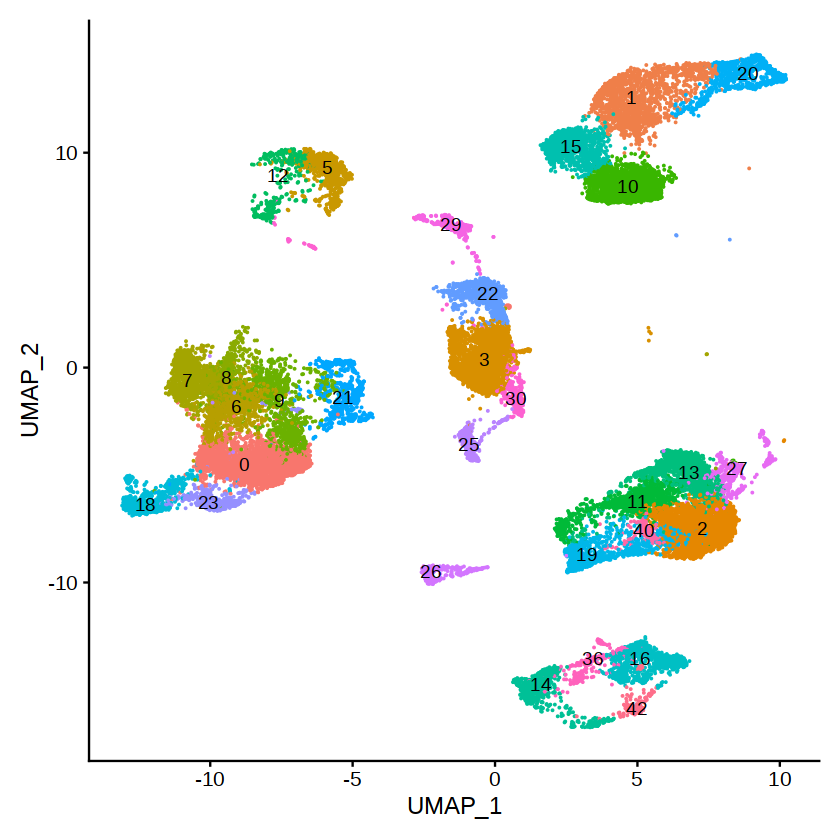

In [72]:
DimPlot(FT_data, label = T, label.size = 4) + NoLegend()

In [8]:
FT <- suppressMessages(UpdateSeuratObject(FT_data))
FT <- as.SingleCellExperiment(FT_data)
#rownames(FT_data) 수정하면 안됨

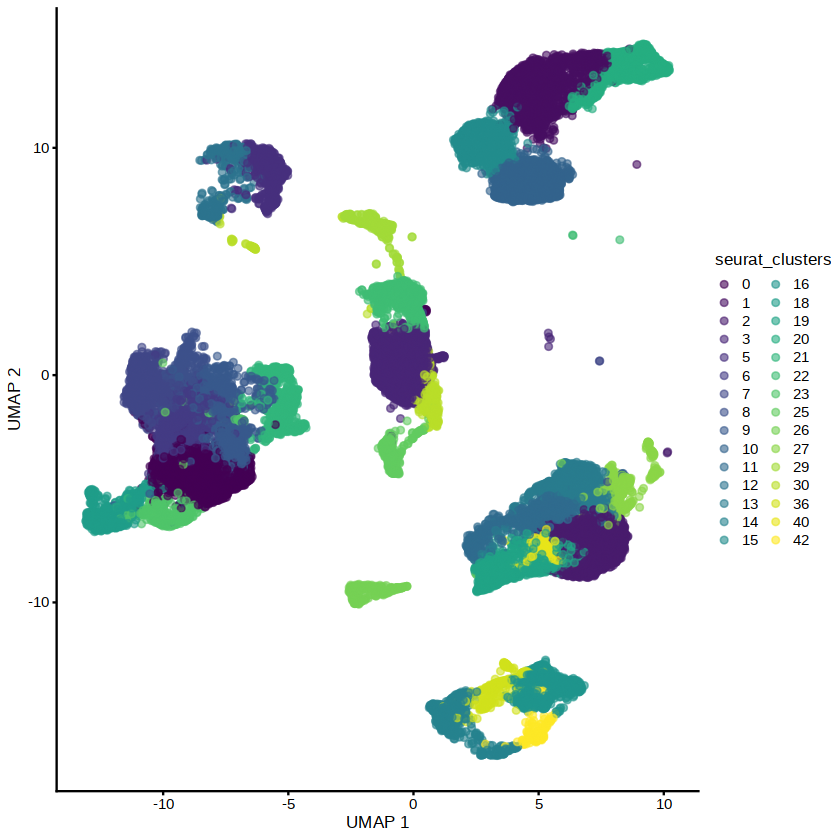

In [108]:
plotUMAP(FT, colour_by = 'seurat_clusters')

In [307]:
View(FT_data@meta.data)

,orig.ident,nCount_RNA,nFeature_RNA,percent.mt,SampleID,tissue_type,nCount_SCT,nFeature_SCT,SCT_snn_res.1,seurat_clusters,barcode,contig_id,CTgene,CTnt,CTaa,CTstrict,Frequency,cloneType
,<chr>,<dbl>,<int>,<dbl>,<chr>,<chr>,<dbl>,<int>,<fct>,<fct>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<int>,<fct>
FT1_GATCGATTCAACCAAC.1_1,FT1,9946,3358,1.4176553,FT1,tumor,4332,2089,22,22,NA,GATCGATTCAACCAAC-1_contig_2,NA,NA,NA,NA,NA,NA
FT1_CCATGTCCAGTCCTTC.1_1,FT1,9993,3343,1.1908336,FT1,tumor,4368,2087,25,25,NA,CCATGTCCAGTCCTTC-1_contig_2,NA,NA,NA,NA,NA,NA
FT1_GGCTGGTTCGGAAACG.1_1,FT1,9984,3487,3.0849359,FT1,tumor,4536,2311,15,15,NA,GGCTGGTTCGGAAACG-1_contig_2,NA,NA,NA,NA,NA,NA
FT1_CCCAGTTAGTGGTCCC.1_1,FT1,9996,3881,0.8403361,FT1,tumor,4538,2548,1,1,NA,CCCAGTTAGTGGTCCC-1_contig_2,NA,NA,NA,NA,NA,NA
FT1_ACGCCGATCACTTATC.1_1,FT1,10000,4089,2.1600000,FT1,tumor,4517,2656,1,1,NA,ACGCCGATCACTTATC-1_contig_2,NA,NA,NA,NA,NA,NA
FT1_GGGCACTGTGTTAAGA.1_1,FT1,9935,3444,1.4494212,FT1,tumor,4327,2206,5,5,NA,GGGCACTGTGTTAAGA-1_contig_2,NA,NA,NA,NA,NA,NA
FT1_CACAAACGTGTGTGCC.1_1,FT1,9961,3892,1.6062644,FT1,tumor,4546,2601,1,1,NA,CACAAACGTGTGTGCC-1_contig_2,NA,NA,NA,NA,NA,NA
FT1_GTAGTCAGTCCAGTAT.1_1,FT1,9958,3207,1.2954409,FT1,tumor,4345,1990,3,3,NA,GTAGTCAGTCCAGTAT-1_contig_2,NA,NA,NA,NA,NA,NA
FT1_CTTAACTCACTGTTAG.1_1,FT1,9957,3839,2.7217033,FT1,tumor,4642,2495,14,14,NA,CTTAACTCACTGTTAG-1_contig_2,NA,NA,NA,NA,NA,NA


In [19]:
combined

barcode,sample,ID,TCR1,cdr3_aa1,cdr3_nt1,TCR2,cdr3_aa2,cdr3_nt2,CTgene,CTnt,CTaa,CTstrict,cellType
<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>
FT1_AAACCTGCACCGGAAA.1,FT1,a,TRAV29/DV5.TRAJ44.TRAC,CAAIRYTGTASKLTF,TGTGCAGCAATCCGCTATACCGGCACTGCCAGTAAACTCACCTTT,TRBV24-1.NA.TRBJ1-5.TRBC1,CATSDKYLNQPQHF,TGTGCCACCAGTGATAAATACCTCAATCAGCCCCAGCATTTT,TRAV29/DV5.TRAJ44.TRAC_TRBV24-1.NA.TRBJ1-5.TRBC1,TGTGCAGCAATCCGCTATACCGGCACTGCCAGTAAACTCACCTTT_TGTGCCACCAGTGATAAATACCTCAATCAGCCCCAGCATTTT,CAAIRYTGTASKLTF_CATSDKYLNQPQHF,TRAV29/DV5.TRAJ44.TRAC_TGTGCAGCAATCCGCTATACCGGCACTGCCAGTAAACTCACCTTT_TRBV24-1.NA.TRBJ1-5.TRBC1_TGTGCCACCAGTGATAAATACCTCAATCAGCCCCAGCATTTT,T-AB
FT1_AAACCTGGTCTTGTCC.1,FT1,a,TRAV30.TRAJ23.TRAC,CGTEIYNQGGKLIF,TGCGGCACAGAGATCTATAACCAGGGAGGAAAGCTTATCTTC,TRBV12-3.NA.TRBJ1-2.TRBC1,CASSVGPQVGNYGYTF,TGTGCCAGCAGCGTGGGACCCCAGGTCGGGAACTATGGCTACACCTTC,TRAV30.TRAJ23.TRAC_TRBV12-3.NA.TRBJ1-2.TRBC1,TGCGGCACAGAGATCTATAACCAGGGAGGAAAGCTTATCTTC_TGTGCCAGCAGCGTGGGACCCCAGGTCGGGAACTATGGCTACACCTTC,CGTEIYNQGGKLIF_CASSVGPQVGNYGYTF,TRAV30.TRAJ23.TRAC_TGCGGCACAGAGATCTATAACCAGGGAGGAAAGCTTATCTTC_TRBV12-3.NA.TRBJ1-2.TRBC1_TGTGCCAGCAGCGTGGGACCCCAGGTCGGGAACTATGGCTACACCTTC,T-AB
FT1_AAACCTGTCTACGAGT.1,FT1,a,TRAV19.TRAJ53.TRAC,CALRRSGGSNYKLTF,TGTGCTCTGAGAAGAAGTGGAGGTAGCAACTATAAACTGACATTT,TRBV29-1.NA.TRBJ2-5.TRBC2,CSVEGGLSSGTQYF,TGCAGCGTTGAAGGGGGCCTGAGTTCCGGGACCCAGTACTTC,TRAV19.TRAJ53.TRAC_TRBV29-1.NA.TRBJ2-5.TRBC2,TGTGCTCTGAGAAGAAGTGGAGGTAGCAACTATAAACTGACATTT_TGCAGCGTTGAAGGGGGCCTGAGTTCCGGGACCCAGTACTTC,CALRRSGGSNYKLTF_CSVEGGLSSGTQYF,TRAV19.TRAJ53.TRAC_TGTGCTCTGAGAAGAAGTGGAGGTAGCAACTATAAACTGACATTT_TRBV29-1.NA.TRBJ2-5.TRBC2_TGCAGCGTTGAAGGGGGCCTGAGTTCCGGGACCCAGTACTTC,T-AB
FT1_AAACGGGCAATAAGCA.1,FT1,a,TRAV13-2.TRAJ30.TRAC,CAVSMNRDDKIIF,TGTGCAGTGTCCATGAACAGAGATGACAAGATCATCTTT,TRBV5-1.NA.TRBJ1-4.TRBC1,CASSLAGSTNEKLFF,TGCGCCAGCAGCTTGGCGGGCTCAACTAATGAAAAACTGTTTTTT,TRAV13-2.TRAJ30.TRAC_TRBV5-1.NA.TRBJ1-4.TRBC1,TGTGCAGTGTCCATGAACAGAGATGACAAGATCATCTTT_TGCGCCAGCAGCTTGGCGGGCTCAACTAATGAAAAACTGTTTTTT,CAVSMNRDDKIIF_CASSLAGSTNEKLFF,TRAV13-2.TRAJ30.TRAC_TGTGCAGTGTCCATGAACAGAGATGACAAGATCATCTTT_TRBV5-1.NA.TRBJ1-4.TRBC1_TGCGCCAGCAGCTTGGCGGGCTCAACTAATGAAAAACTGTTTTTT,T-AB
FT1_AAACGGGTCGTTGCCT.1,FT1,a,TRAV10.TRAJ26.TRAC,CVVRRDNYGQNFVF,TGTGTGGTGAGGCGGGATAACTATGGTCAGAATTTTGTCTTT,TRBV6-5.NA.TRBJ1-1.TRBC1,CASSYLPSGLAPMNTEAFF,TGTGCCAGCAGTTACCTGCCCAGCGGGCTAGCCCCTATGAACACTGAAGCTTTCTTT,TRAV10.TRAJ26.TRAC_TRBV6-5.NA.TRBJ1-1.TRBC1,TGTGTGGTGAGGCGGGATAACTATGGTCAGAATTTTGTCTTT_TGTGCCAGCAGTTACCTGCCCAGCGGGCTAGCCCCTATGAACACTGAAGCTTTCTTT,CVVRRDNYGQNFVF_CASSYLPSGLAPMNTEAFF,TRAV10.TRAJ26.TRAC_TGTGTGGTGAGGCGGGATAACTATGGTCAGAATTTTGTCTTT_TRBV6-5.NA.TRBJ1-1.TRBC1_TGTGCCAGCAGTTACCTGCCCAGCGGGCTAGCCCCTATGAACACTGAAGCTTTCTTT,T-AB
FT1_AAAGATGAGTACACCT.1,FT1,a,TRAV35.TRAJ56.TRAC,CAGQAGANSKLTF,TGTGCTGGGCAGGCTGGAGCCAATAGTAAGCTGACATTT,TRBV20-1.NA.TRBJ2-5.TRBC2,CSARPGNRGKETQYF,TGCAGTGCTAGGCCCGGCAACAGGGGGAAAGAGACCCAGTACTTC,TRAV35.TRAJ56.TRAC_TRBV20-1.NA.TRBJ2-5.TRBC2,TGTGCTGGGCAGGCTGGAGCCAATAGTAAGCTGACATTT_TGCAGTGCTAGGCCCGGCAACAGGGGGAAAGAGACCCAGTACTTC,CAGQAGANSKLTF_CSARPGNRGKETQYF,TRAV35.TRAJ56.TRAC_TGTGCTGGGCAGGCTGGAGCCAATAGTAAGCTGACATTT_TRBV20-1.NA.TRBJ2-5.TRBC2_TGCAGTGCTAGGCCCGGCAACAGGGGGAAAGAGACCCAGTACTTC,T-AB
FT1_AAAGATGTCGCCAAAT.1,FT1,a,TRAV21.TRAJ20.TRAC,CAVEPNDYKLSF,TGTGCTGTGGAGCCTAACGACTACAAGCTCAGCTTT,TRBV19.NA.TRBJ2-2.TRBC2,CASSLSGGAYTGELFF,TGTGCCAGTAGTCTTTCAGGGGGCGCATACACCGGGGAGCTGTTTTTT,TRAV21.TRAJ20.TRAC_TRBV19.NA.TRBJ2-2.TRBC2,TGTGCTGTGGAGCCTAACGACTACAAGCTCAGCTTT_TGTGCCAGTAGTCTTTCAGGGGGCGCATACACCGGGGAGCTGTTTTTT,CAVEPNDYKLSF_CASSLSGGAYTGELFF,TRAV21.TRAJ20.TRAC_TGTGCTGTGGAGCCTAACGACTACAAGCTCAGCTTT_TRBV19.NA.TRBJ2-2.TRBC2_TGTGCCAGTAGTCTTTCAGGGGGCGCATACACCGGGGAGCTGTTTTTT,T-AB
FT1_AAAGATGTCTCCTATA.1,FT1,a,TRAV8-3.TRAJ41.TRAC,CAVGANSGYALNF,TGTGCTGTGGGTGCGAATTCCGGGTATGCACTCAACTTC,TRBV12-4.NA.TRBJ1-1.TRBC1,CASSFDLVGLVNTEAFF,TGTGCCAGCAGTTTTGATCTCGTGGGGTTGGTTAACACTGAAGCTTTCTTT,TRAV8-3.TRAJ41.TRAC_TRBV12-4.NA.TRBJ1-1.TRBC1,TGTGCTGTGGGTGCGAATTCCGGGTATGCACTCAACTTC_TGTGCCAGCAGTTTTGAT

In [20]:
FT_data <- combineExpression(combined, 
                            FT_data,
                            cloneCall="gene",
                            proportion = FALSE, 
                            cloneTypes=c(Single=1, Small=5, Medium=20, Large=100, Hyperexpanded=500))

In [69]:
adenoma <- combineExpression(combined, 
                                  adenoma,
                                   cloneCall="gene",
                                   proportion = FALSE, 
                                   cloneTypes=c(Single=1, Small=5, Medium=20, Large=100, Hyperexpanded=500))

In [70]:
carcinoma <- combineExpression(combined, 
                                   carcinoma,
                                   cloneCall="gene",
                                   proportion = FALSE, 
                                   cloneTypes=c(Single=1, Small=5, Medium=20, Large=100, Hyperexpanded=500))

In [100]:
FT <- combineExpression(combined, 
                          FT, 
                          cloneCall="gene", 
                          proportion = F)

In [21]:
slot(FT_data, "meta.data")$cloneType <- factor(slot(FT_data, "meta.data")$cloneType, 
                levels = c("Hyperexpanded (100 < X <= 500)", 
                           "Large (20 < X <= 100)", 
                            "Medium (5 < X <= 20)", 
                            "Small (1 < X <= 5)", 
                            "Single (0 < X <= 1)", NA))

In [31]:
slot(adenoma, "meta.data")$cloneType <- factor(slot(adenoma, "meta.data")$cloneType, 
                levels = c("Hyperexpanded (100 < X <= 500)", 
                           "Large (20 < X <= 100)", 
                            "Medium (5 < X <= 20)", 
                            "Small (1 < X <= 5)", 
                            "Single (0 < X <= 1)", NA))

In [32]:
slot(carcinoma, "meta.data")$cloneType <- factor(slot(carcinoma, "meta.data")$cloneType, 
                levels = c("Hyperexpanded (100 < X <= 500)", 
                           "Large (20 < X <= 100)", 
                            "Medium (5 < X <= 20)", 
                            "Small (1 < X <= 5)", 
                            "Single (0 < X <= 1)", NA))

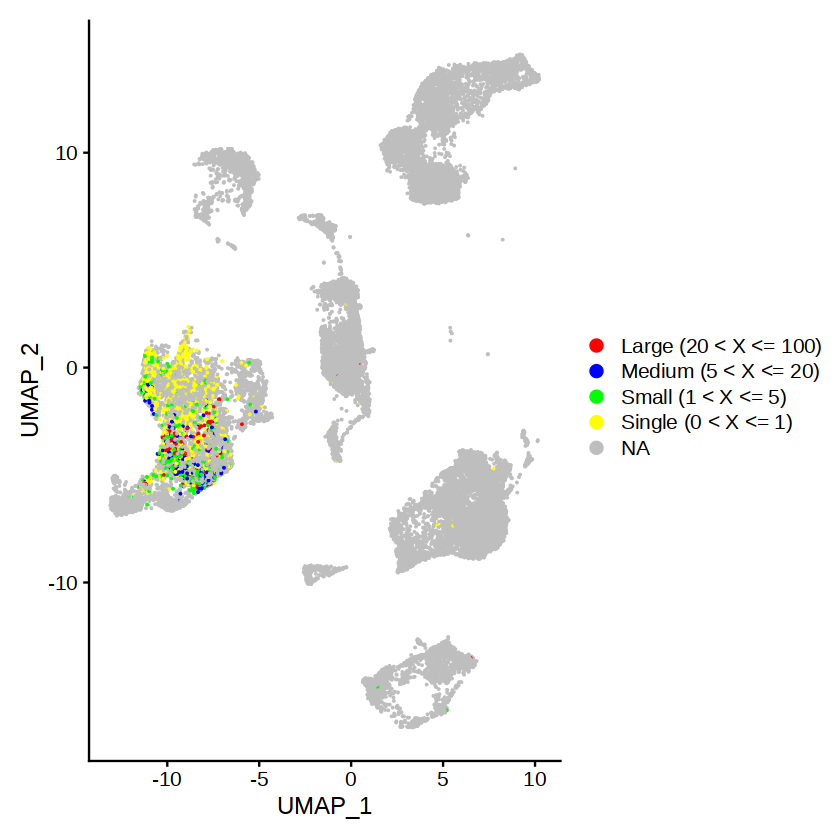

In [22]:
DimPlot(FT_data, group.by = "cloneType") +
    scale_color_manual(values = c("red","blue","green","yellow","orange"), na.value="grey") + 
  theme(plot.title = element_blank())

In [13]:
View(FT_data@meta.data)

,orig.ident,nCount_RNA,nFeature_RNA,percent.mt,SampleID,tissue_type,nCount_SCT,nFeature_SCT,SCT_snn_res.1,seurat_clusters,barcode,contig_id,CTgene,CTnt,CTaa,CTstrict,Frequency,cloneType
,<chr>,<dbl>,<int>,<dbl>,<chr>,<chr>,<dbl>,<int>,<fct>,<fct>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<int>,<fct>
FT1_GATCGATTCAACCAAC.1_1,FT1,9946,3358,1.4176553,FT1,tumor,4332,2089,22,22,NA,GATCGATTCAACCAAC-1_contig_2,NA,NA,NA,NA,NA,NA
FT1_CCATGTCCAGTCCTTC.1_1,FT1,9993,3343,1.1908336,FT1,tumor,4368,2087,25,25,NA,CCATGTCCAGTCCTTC-1_contig_2,NA,NA,NA,NA,NA,NA
FT1_GGCTGGTTCGGAAACG.1_1,FT1,9984,3487,3.0849359,FT1,tumor,4536,2311,15,15,NA,GGCTGGTTCGGAAACG-1_contig_2,NA,NA,NA,NA,NA,NA
FT1_CCCAGTTAGTGGTCCC.1_1,FT1,9996,3881,0.8403361,FT1,tumor,4538,2548,1,1,NA,CCCAGTTAGTGGTCCC-1_contig_2,NA,NA,NA,NA,NA,NA
FT1_ACGCCGATCACTTATC.1_1,FT1,10000,4089,2.1600000,FT1,tumor,4517,2656,1,1,NA,ACGCCGATCACTTATC-1_contig_2,NA,NA,NA,NA,NA,NA
FT1_GGGCACTGTGTTAAGA.1_1,FT1,9935,3444,1.4494212,FT1,tumor,4327,2206,5,5,NA,GGGCACTGTGTTAAGA-1_contig_2,NA,NA,NA,NA,NA,NA
FT1_CACAAACGTGTGTGCC.1_1,FT1,9961,3892,1.6062644,FT1,tumor,4546,2601,1,1,NA,CACAAACGTGTGTGCC-1_contig_2,NA,NA,NA,NA,NA,NA
FT1_GTAGTCAGTCCAGTAT.1_1,FT1,9958,3207,1.2954409,FT1,tumor,4345,1990,3,3,NA,GTAGTCAGTCCAGTAT-1_contig_2,NA,NA,NA,NA,NA,NA
FT1_CTTAACTCACTGTTAG.1_1,FT1,9957,3839,2.7217033,FT1,tumor,4642,2495,14,14,NA,CTTAACTCACTGTTAG-1_contig_2,NA,NA,NA,NA,NA,NA


In [23]:
matched_barcode <- subset(FT_data, subset = cloneType == "Large (20 < X <= 100)"|
                         cloneType == "Medium (5 < X <= 20)"|cloneType == "Small (1 < X <= 5)"|cloneType == "Single (0 < X <= 1)")

In [25]:
View(matched_barcode@meta.data)

,orig.ident,nCount_RNA,nFeature_RNA,percent.mt,SampleID,tissue_type,nCount_SCT,nFeature_SCT,SCT_snn_res.1,seurat_clusters,barcode,contig_id,CTgene,CTnt,CTaa,CTstrict,Frequency,cloneType
,<chr>,<dbl>,<int>,<dbl>,<chr>,<chr>,<dbl>,<int>,<fct>,<fct>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<int>,<fct>
FT2_CAACCTCCAGACGCCT.1,FT2,9641,3654,1.6699512,FT2,tumor,4611,2619,0,0,FT2_CAACCTCCAGACGCCT.1,CAACCTCCAGACGCCT-1_contig_1,TRAV19.TRAJ42.TRAC_TRBV20-1.TRBD1.TRBJ1-1.TRBC1,TGTGCTCTGAGTGAGGCGGGATATGGAGGAAGCCAAGGAAATCTCATCTTT_TGCAGTGCTAGAGGCCCCGGGACAGGGGCTGGTGAAGCTTTCTTT,CALSEAGYGGSQGNLIF_CSARGPGTGAGEAFF,TRAV19.TRAJ42.TRAC_TGTGCTCTGAGTGAGGCGGGATATGGAGGAAGCCAAGGAAATCTCATCTTT_TRBV20-1.TRBD1.TRBJ1-1.TRBC1_TGCAGTGCTAGAGGCCCCGGGACAGGGGCTGGTGAAGCTTTCTTT,1,Single (0 < X <= 1)
FT2_GTGCGGTCAACAACCT.1,FT2,9330,3347,1.2111468,FT2,tumor,4648,2543,0,0,FT2_GTGCGGTCAACAACCT.1,GTGCGGTCAACAACCT-1_contig_1,TRAV27.TRAJ28.TRAC_TRBV5-4.NA.TRBJ2-1.TRBC2,TGTGCAGGAGCAGGCGACTCTGGGGCTGGGAGTTACCAACTCACTTTC_TGTGCCAGCGGACAGGACCTCTCCTACAATGAGCAGTTCTTC,CAGAGDSGAGSYQLTF_CASGQDLSYNEQFF,TRAV27.TRAJ28.TRAC_TGTGCAGGAGCAGGCGACTCTGGGGCTGGGAGTTACCAACTCACTTTC_TRBV5-4.NA.TRBJ2-1.TRBC2_TGTGCCAGCGGACAGGACCTCTCCTACAATGAGCAGTTCTTC,2,Small (1 < X <= 5)
FT2_GAGGTGACAAACCCAT.1,FT2,9287,2766,1.9274254,FT2,tumor,4500,1970,3,3,FT2_GAGGTGACAAACCCAT.1,GAGGTGACAAACCCAT-1_contig_1,TRAV38-2/DV8.TRAJ58.TRAC_TRBV12-4.NA.TRBJ2-4.TRBC2,TGTGCTTATAAAGAAACCAGTGGCTCTAGGTTGACCTTT_TGTGCCAGCAGTCCCATCCCCGGAAACATTCAGTACTTC,CAYKETSGSRLTF_CASSPIPGNIQYF,TRAV38-2/DV8.TRAJ58.TRAC_TGTGCTTATAAAGAAACCAGTGGCTCTAGGTTGACCTTT_TRBV12-4.NA.TRBJ2-4.TRBC2_TGTGCCAGCAGTCCCATCCCCGGAAACATTCAGTACTTC,18,Medium (5 < X <= 20)
FT2_GCCAAATCACCAGGTC.1,FT2,9199,3828,0.9783672,FT2,tumor,4857,2990,2,2,FT2_GCCAAATCACCAGGTC.1,GCCAAATCACCAGGTC-1_contig_1,TRAV20.TRAJ52.TRAC_TRBV14.NA.TRBJ2-3.TRBC2,TGTGCTGCAACAAAAGGTACTAGCTATGGAAAGCTGACATTT_TGTGCCAGCAGCACTACAGATACGCAGTATTTT,CAATKGTSYGKLTF_CASSTTDTQYF,TRAV20.TRAJ52.TRAC_TGTGCTGCAACAAAAGGTACTAGCTATGGAAAGCTGACATTT_TRBV14.NA.TRBJ2-3.TRBC2_TGTGCCAGCAGCACTACAGATACGCAGTATTTT,4,Small (1 < X <= 5)
FT2_GTGCATACATAGACTC.1,FT2,9048,3147,0.9283820,FT2,tumor,4743,2507,0,0,FT2_GTGCATACATAGACTC.1,GTGCATACATAGACTC-1_contig_1,TRAV29/DV5.TRAJ43.TRAC_TRBV11-2.NA.TRBJ2-5.TRBC2,TGTGCAGCAAGCGCATATAACAATGACATGCGCTTT_TGTGCCAGCAGCCTAATAGAGGGGAGGGAGACCCAGTACTTC,CAASAYNNDMRF_CASSLIEGRETQYF,TRAV29/DV5.TRAJ43.TRAC_TGTGCAGCAAGCGCATATAACAATGACATGCGCTTT_TRBV11-2.NA.TRBJ2-5.TRBC2_TGTGCCAGCAGCCTAATAGAGGGGAGGGAGACCCAGTACTTC,4,Small (1 < X <= 5)
FT2_GACAGAGTCATTATCC.1,FT2,9028,3790,2.7248560,FT2,tumor,4835,3026,2,2,FT2_GACAGAGTCATTATCC.1,GACAGAGTCATTATCC-1_contig_1,TRAV20.TRAJ52.TRAC_TRBV14.NA.TRBJ2-3.TRBC2,TGTGCTGCAACAAAAGGTACTAGCTATGGAAAGCTGACATTT_TGTGCCAGCAGCACTACAGATACGCAGTATTTT,CAATKGTSYGKLTF_CASSTTDTQYF,TRAV20.TRAJ52.TRAC_TGTGCTGCAACAAAAGGTACTAGCTATGGAAAGCTGACATTT_TRBV14.NA.TRBJ2-3.TRBC2_TGTGCCAGCAGCACTACAGATACGCAGTATTTT,4,Small (1 < X <= 5)
FT2_CTAGTGAAGCGAGAAA.1,FT2,9026,3733,3.2129404,FT2,tumor,4873,2975,20,20,FT2_CTAGTGAAGCGAGAAA.1,CTAGTGAAGCGAGAAA-1_contig_1,TRAV12-3.TRAJ53.TRAC_TRBV7-3.NA.TRBJ1-1.TRBC1,TGTGCAATGAGTGGTAGTGGAGGTAGCAACTATAAACTGACATTT_TGTGCCAGCAGCCCAGGGCCGTCGTTAGAACTGGGAGCTTTCTTT,CAMSGSGGSNYKLTF_CASSPGPSLELGAFF,TRAV12-3.TRAJ53.TRAC_TGTGCAATGAGTGGTAGTGGAGGTAGCAACTATAAACTGACATTT_TRBV7-3.NA.TRBJ1-1.TRBC1_TGTGCCAGCAGCCCAGGGCCGTCGTTAGAACTGGGAGCTTTCTTT,1,Single (0 < X <= 1)
FT2_ATCCACCCAGATGAGC.1,FT2,8706,2742,0.8499885,FT2,tumor,4647,2176,18,18,FT2_ATCCACCCAGATGAGC.1,ATCCACCCAGATGAGC-1_contig_1,TRAV5.TRAJ8.TRAC_TRBV20-1.NA.TRBJ2-1.TRBC2,TGTGCAGACGAGGTGAACACAGGCTTTCAGAAACTTGTATTT_TGCAGTGCCACGCGCGGCGGGAGGGCCAATGAGCAGTTCTTC,CADEVNTGFQKLVF_CSATRGGRANEQFF,TRAV5.TRAJ8.TRAC_TGTGCAGACGAGGTGAACACAGGCTTTCAGAAACTTGTATTT_TRBV20-1.NA.TRBJ2-1.TRBC2_TGCAGTGCCACGCGCGGCGGGAGGGCCAATGAGCAGTTCTTC,1,Single (0 < X <= 1)
FT2_TTCGGTCGTGCTGTAT.1,FT2,8595,2561,1.8382781,FT2,tumor,4767,2071,3,3,FT2_TTCGGTCGTGCTGTAT.1,TTCGGTCGTGCTGTAT-1_contig_1,TRAV20.TRAJ52.TRAC_TRBV14.NA.TRBJ2-3.TRBC2,TGTGCTGCAACAAAAGGTACTAGCTATGGAAAGCTGACATTT_TGTGCCA

In [43]:
length(matched)

[1] 2731

In [49]:
factor(barcode)
for(i in 1:2731){
    barcode[i] <- matched[i]
}

[1] FT5_TTTGTCATCTTTCCTC.1 <NA>                   <NA>                  
   [4] <NA>                   <NA>                   <NA>                  
   [7] <NA>                   <NA>                   <NA>                  
  [10] <NA>                   <NA>                   <NA>                  
  [13] <NA>                   <NA>                   <NA>                  
  [16] <NA>                   <NA>                   <NA>                  
  [19] <NA>                   <NA>                   <NA>                  
  [22] <NA>                   <NA>                   <NA>                  
  [25] <NA>                   <NA>                   <NA>                  
  [28] <NA>                   <NA>                   <NA>                  
  [31] <NA>                   <NA>                   <NA>                  
  [34] <NA>                   <NA>                   <NA>                  
  [37] <NA>                   <NA>                   <NA>                  
  [40] <NA>                   <NA>                   <NA>                  
  [43] <NA>                   <NA>                   <NA>                  
  [46] <NA>                   <NA>                   <NA>                  
  [49] <NA>                   <NA>                   <NA>                  
  [52] <NA>                   <NA>                   <NA>                  
  [55] <NA>                   <NA>                   <NA>                  
  [58] <NA>                   <NA>                   <NA>                  
  [61] <NA>                   <NA>                   <NA>                  
  [64] <NA>                   <NA>                   <NA>                  
  [67] <NA>                   <NA>                   <NA>                  
  [70] <NA>                   <NA>                   <NA>                  
  [73] <NA>                   <NA>                   <NA>                  
  [76] <NA>                   <NA>                   <NA>                  
  [79] <NA>                   <NA>                   <NA>                  
  [82] <NA>                   <NA>                   <NA>                  
  [85] <NA>                   <NA>                   <NA>                  
  [88] <NA>                   <NA>                   <NA>                  
  [91] <NA>                   <NA>                   <NA>                  
  [94] <NA>                   <NA>                   <NA>                  
  [97] <NA>                   <NA>                   <NA>                  
 [100] <NA>                   <NA>                   <NA>                  
 [103] <NA>                   <NA>                   <NA>                  
 [106] <NA>                   <NA>                   <NA>                  
 [109] <NA>                   <NA>                   <NA>                  
 [112] <NA>                   <NA>                   <NA>                  
 [115] <NA>                   <NA>                   <NA>                  
 [118] <NA>                   <NA>                   <NA>                  
 [121] <NA>                   <NA>                   <NA>                  
 [124] <NA>                   <NA>                   <NA>                  
 [127] <NA>                   <NA>                   <NA>                  
 [130] <NA>                   <NA>                   <NA>                  
 [133] <NA>                   <NA>                   <NA>                  
 [136] <NA>                   <NA>                   <NA>                  
 [139] <NA>                   <NA>                   <NA>                  
 [142] <NA>                   <NA>                   <NA>                  
 [145] <NA>                   <NA>                   <NA>                  
 [148] <NA>                   <NA>                   <NA>                  
 [151] <NA>                   <NA>                   <NA>                  
 [154] <NA>                   <NA>                   <NA>                  
 [157] <NA>                   <NA>                 

In [50]:
df <- data.frame(barcode)
df

barcode
<chr>
FT2_CAACCTCCAGACGCCT.1
FT2_GTGCGGTCAACAACCT.1
FT2_GAGGTGACAAACCCAT.1
FT2_GCCAAATCACCAGGTC.1
FT2_GTGCATACATAGACTC.1
FT2_GACAGAGTCATTATCC.1
FT2_CTAGTGAAGCGAGAAA.1
FT2_ATCCACCCAGATGAGC.1
FT2_TTCGGTCGTGCTGTAT.1


In [53]:
write.csv(df, file = "/home/jurny0402/FTC/matched_cells.csv")

In [41]:
large <- subset(FT_data@meta.data, subset = cloneType == "Large (20 < X <= 100)")
nrow(large)
unique(large$orig.ident)
unique(large$seurat_clusters)
Medium <- subset(FT_data@meta.data, subset = cloneType == "Medium (5 < X <= 20)")
nrow(Medium)
unique(Medium$orig.ident)
unique(Medium$seurat_clusters)

[1] 212

[1] "FT2" "FT3" "FT5"

[1] 16 0  6  9  30 3  18 21
58 Levels: 0 1 2 3 4 5 6 7 8 9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 ... 57

[1] 365

[1] "FT2" "FT3" "FT4" "FT5"

[1] 3  7  6  13 27 0  9  18 21 2  23
58 Levels: 0 1 2 3 4 5 6 7 8 9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 ... 57

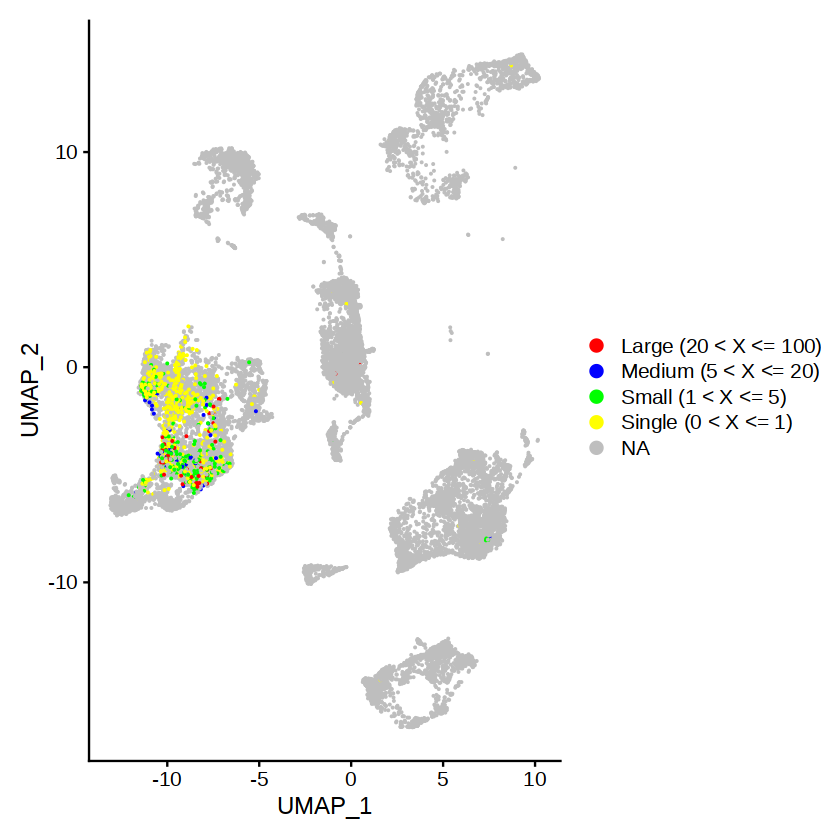

In [33]:
DimPlot(adenoma, group.by = "cloneType") +
    scale_color_manual(values = c("red","blue","green","yellow","orange"), na.value="grey") + 
  theme(plot.title = element_blank())

In [45]:
large <- subset(adenoma@meta.data, subset = cloneType == "Large (20 < X <= 100)")
nrow(large)
unique(large$orig.ident)
unique(large$seurat_clusters)
Medium <- subset(adenoma@meta.data, subset = cloneType == "Medium (5 < X <= 20)")
nrow(Medium)
unique(Medium$orig.ident)
unique(Medium$seurat_clusters)
Small <- subset(adenoma@meta.data, subset = cloneType == "Small (1 < X <= 5)")
nrow(Small)
unique(Small$orig.ident)
unique(Small$seurat_clusters)
Single <- subset(adenoma@meta.data, subset = cloneType == "Single (0 < X <= 1)")
nrow(Single)
unique(Single$orig.ident)
unique(Single$seurat_clusters)

[1] 70

[1] "FT2" "FT3"

[1] 16 0  6  9  30 3 
58 Levels: 0 1 2 3 4 5 6 7 8 9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 ... 57

[1] 88

[1] "FT2" "FT3"

[1] 3  7  6  13 27 0  9  18 21
58 Levels: 0 1 2 3 4 5 6 7 8 9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 ... 57

[1] 291

[1] "FT2" "FT3"

[1] 0  2  3  25 7  27 6  9  18 14 23 21
58 Levels: 0 1 2 3 4 5 6 7 8 9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 ... 57

[1] 560

[1] "FT2" "FT3"

[1] 0  20 18 13 9  7  8  22 16 6  5  26 23 21 15 27 25 3  30 14
58 Levels: 0 1 2 3 4 5 6 7 8 9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 ... 57

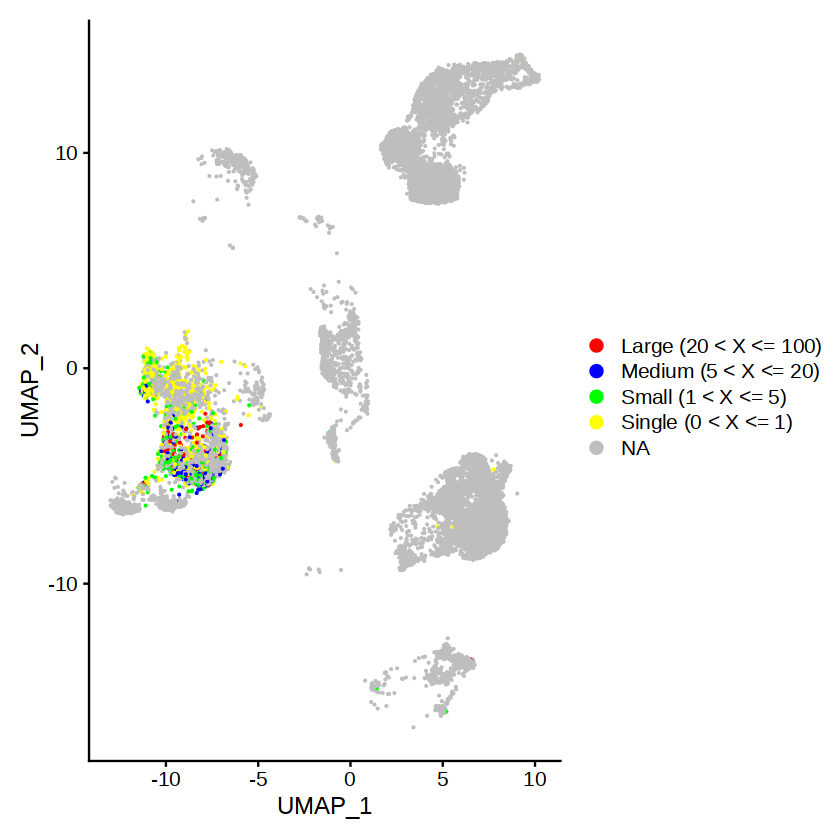

In [38]:
DimPlot(carcinoma, group.by = "cloneType") +
    scale_color_manual(values = c("red","blue","green","yellow","orange"), na.value="grey") + 
  theme(plot.title = element_blank())

In [43]:
large <- subset(carcinoma@meta.data, subset = cloneType == "Large (20 < X <= 100)")
nrow(large)
unique(large$orig.ident)
unique(large$seurat_clusters)
Medium <- subset(carcinoma@meta.data, subset = cloneType == "Medium (5 < X <= 20)")
nrow(Medium)
unique(Medium$orig.ident)
unique(Medium$seurat_clusters)
Small <- subset(carcinoma@meta.data, subset = cloneType == "Small (1 < X <= 5)")
nrow(Small)
unique(Small$orig.ident)
unique(Small$seurat_clusters)
Single <- subset(carcinoma@meta.data, subset = cloneType == "Single (0 < X <= 1)")
nrow(Single)
unique(Single$orig.ident)
unique(Single$seurat_clusters)

[1] 142

[1] "FT5"

[1] 16 0  18 6  9  21
58 Levels: 0 1 2 3 4 5 6 7 8 9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 ... 57

[1] 277

[1] "FT4" "FT5"

[1] 2  18 0  6  7  9  23
58 Levels: 0 1 2 3 4 5 6 7 8 9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 ... 57

[1] 402

[1] "FT4" "FT5"

[1] 27 13 18 0  7  9  6  23 25 11 42 14 8  21
58 Levels: 0 1 2 3 4 5 6 7 8 9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 ... 57

[1] 901

[1] "FT4" "FT5"

[1] 20 8  16 9  6  7  0  18 15 21 3  2  40 25 30 5 
58 Levels: 0 1 2 3 4 5 6 7 8 9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 ... 57

group.by를 없애기

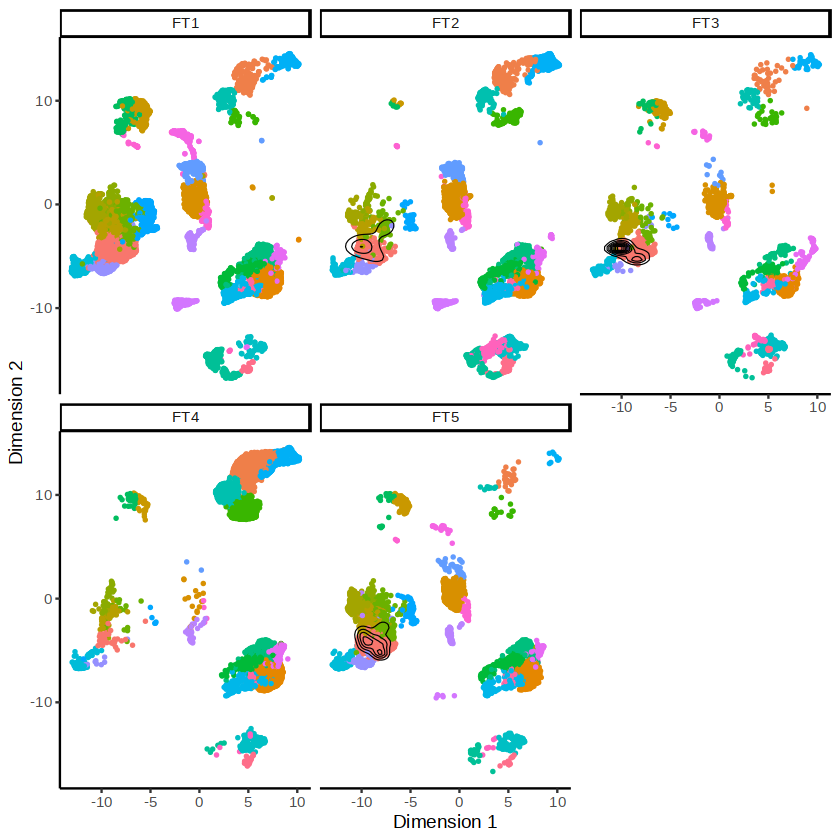

In [63]:
clonalOverlay(FT_data, 
              reduction = "umap", 
              freq.cutpoint = 20, 
              bins = 10,
             facet = "orig.ident") + guides(color = "none")

In [7]:
clonalOverlay(FT_data, 
              reduction = "umap", 
              freq.cutpoint = 20,
              bins = 10,
             facet = "ID") + guides(color = "none")

ERROR: Error in `[.data.frame`(tmp, , facet): undefined columns selected


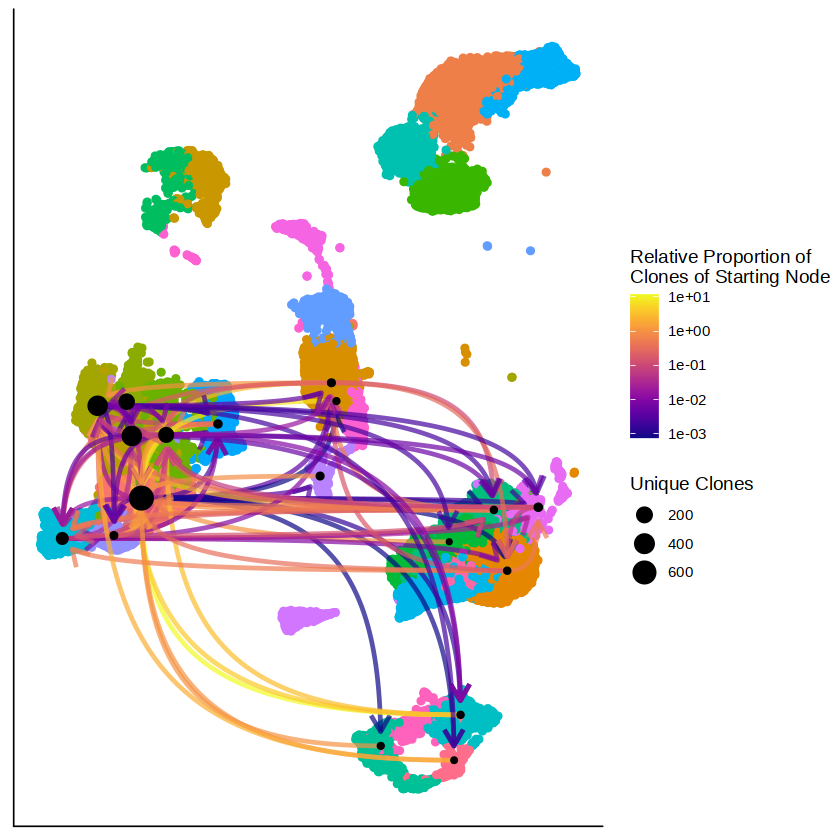

In [69]:
#ggraph needs to be loaded due to issues with ggplot
library(ggraph)

#No Identity filter
clonalNetwork(FT_data, 
              reduction = "umap", 
              identity = "ident",
              filter.clones = NULL,
              filter.identity = NULL,
              cloneCall = "aa")

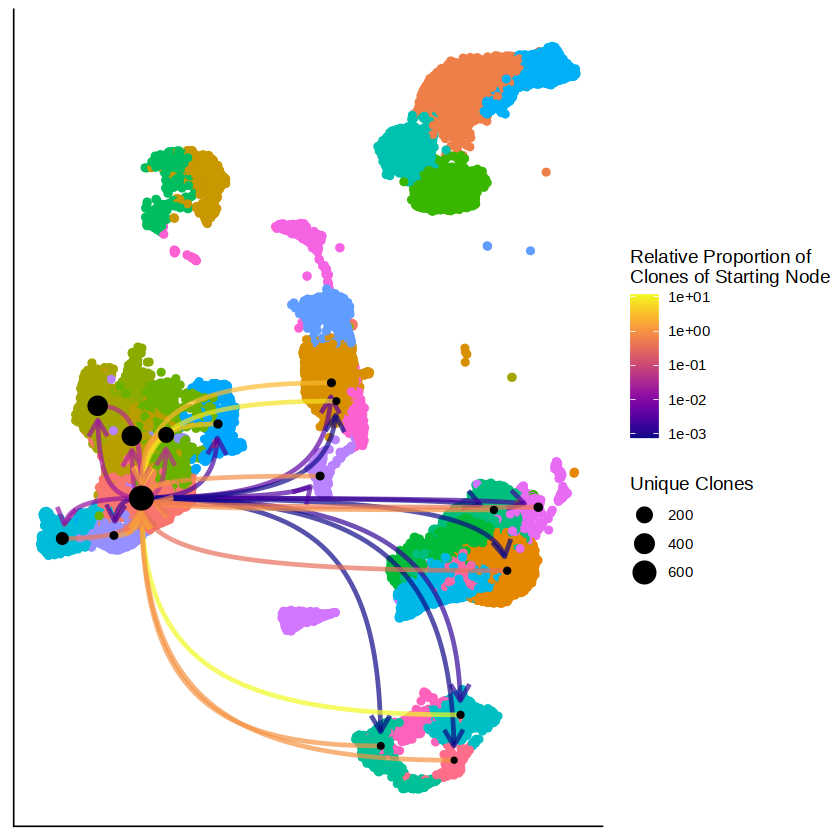

In [68]:
#ggraph needs to be loaded due to issues with ggplot
library(ggraph)

#No Identity filter
clonalNetwork(FT_data, 
              reduction = "umap", 
              identity = "ident",
              filter.clones = NULL,
              filter.identity = "0",
              cloneCall = "aa")

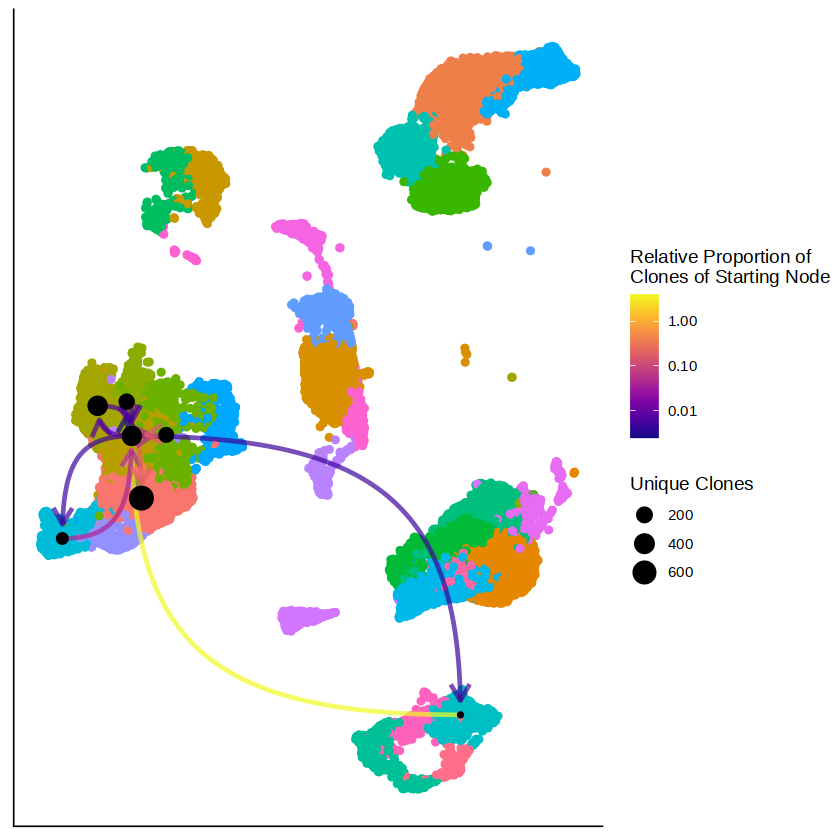

In [71]:
#ggraph needs to be loaded due to issues with ggplot
library(ggraph)

#No Identity filter
clonalNetwork(FT_data, 
              reduction = "umap", 
              identity = "ident",
              filter.clones = NULL,
              filter.identity = "6",
              cloneCall = "aa")

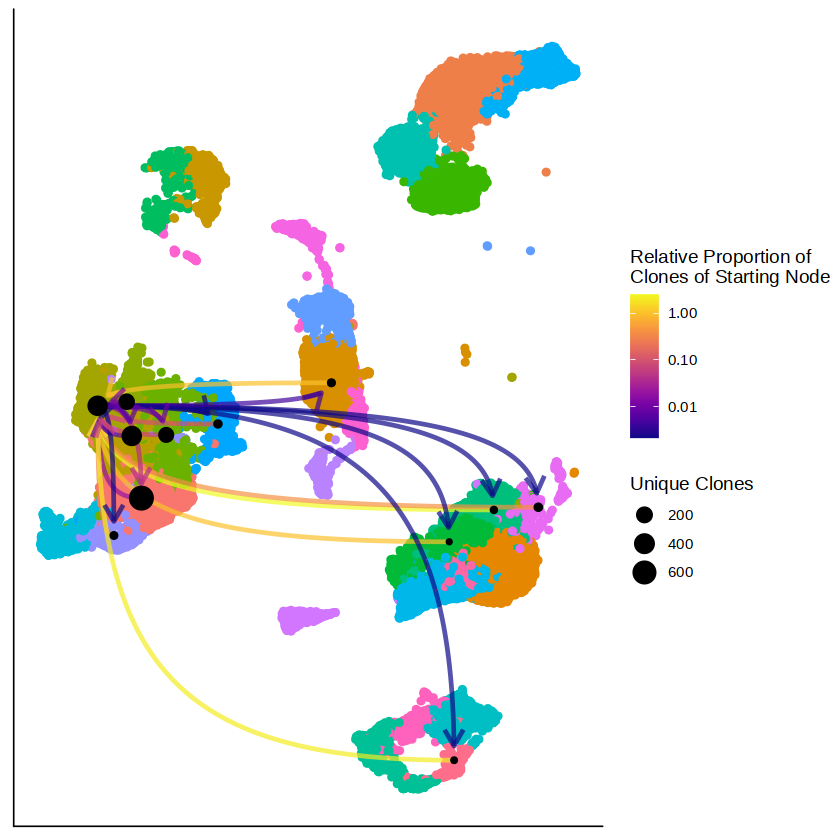

In [72]:
#ggraph needs to be loaded due to issues with ggplot
library(ggraph)

#No Identity filter
clonalNetwork(FT_data, 
              reduction = "umap", 
              identity = "ident",
              filter.clones = NULL,
              filter.identity = "7",
              cloneCall = "aa")

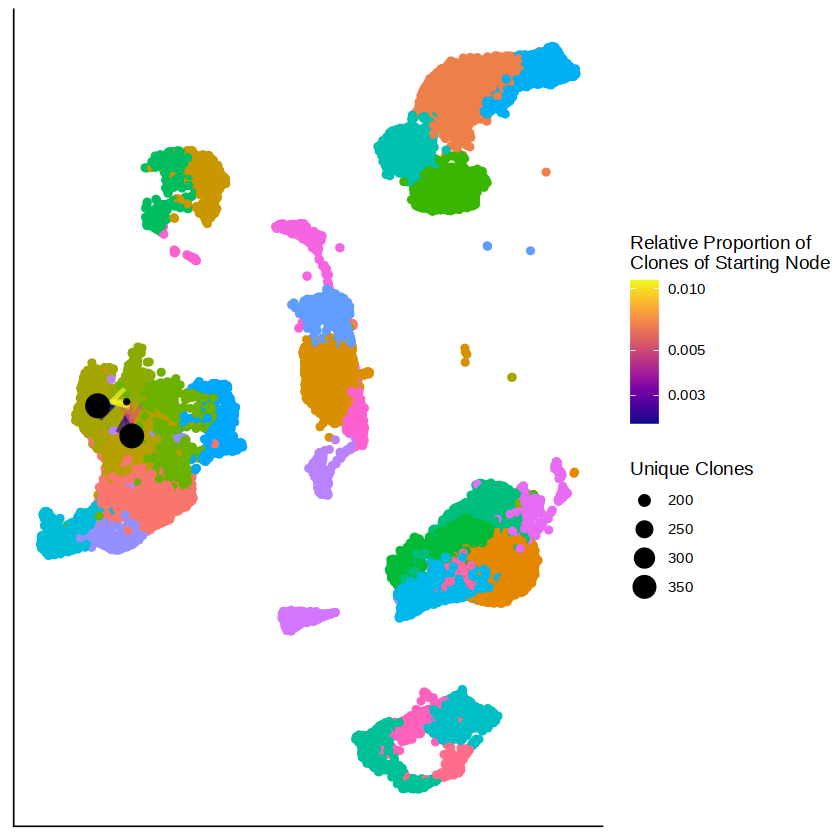

In [73]:
#ggraph needs to be loaded due to issues with ggplot
library(ggraph)

#No Identity filter
clonalNetwork(FT_data, 
              reduction = "umap", 
              identity = "ident",
              filter.clones = NULL,
              filter.identity = "8",
              cloneCall = "aa")

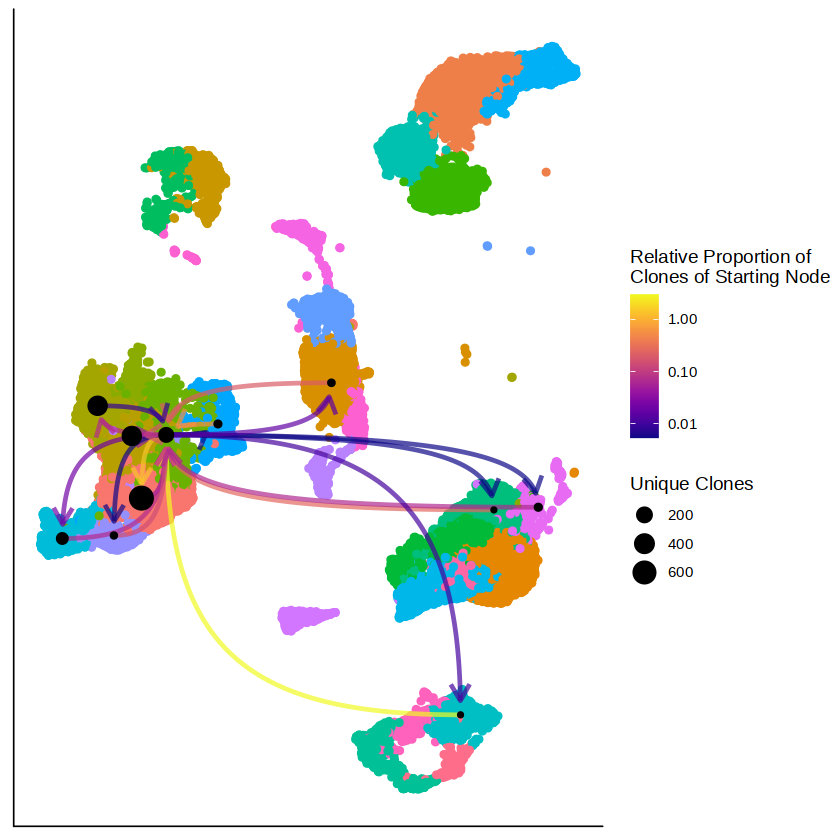

In [74]:
#ggraph needs to be loaded due to issues with ggplot
library(ggraph)

#No Identity filter
clonalNetwork(FT_data, 
              reduction = "umap", 
              identity = "ident",
              filter.clones = NULL,
              filter.identity = "9",
              cloneCall = "aa")

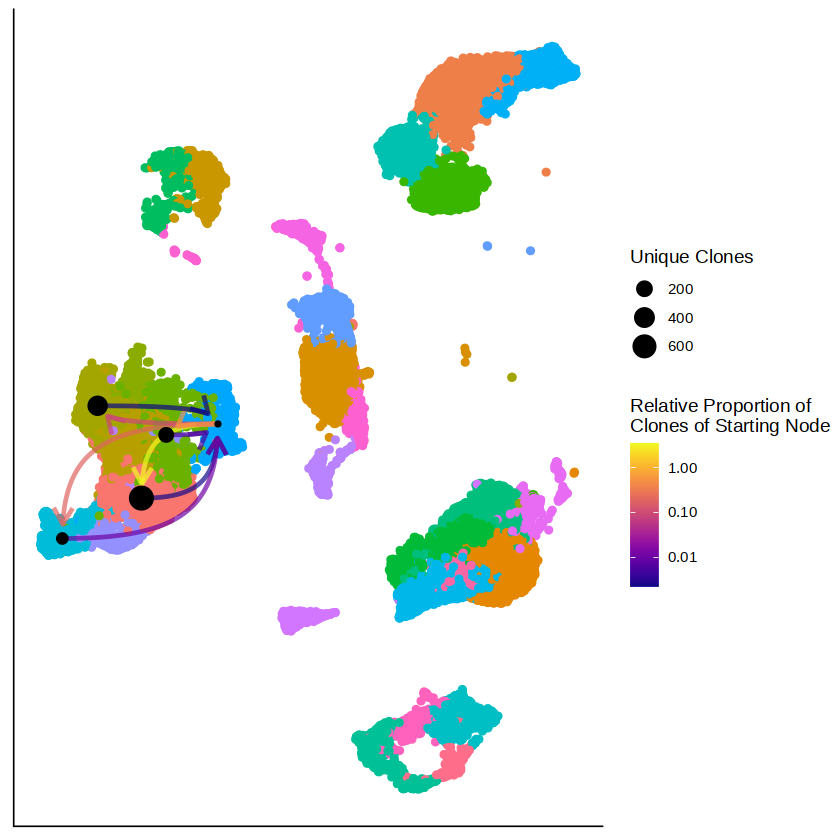

In [75]:
#ggraph needs to be loaded due to issues with ggplot
library(ggraph)

#No Identity filter
clonalNetwork(FT_data, 
              reduction = "umap", 
              identity = "ident",
              filter.clones = NULL,
              filter.identity = "21",
              cloneCall = "aa")

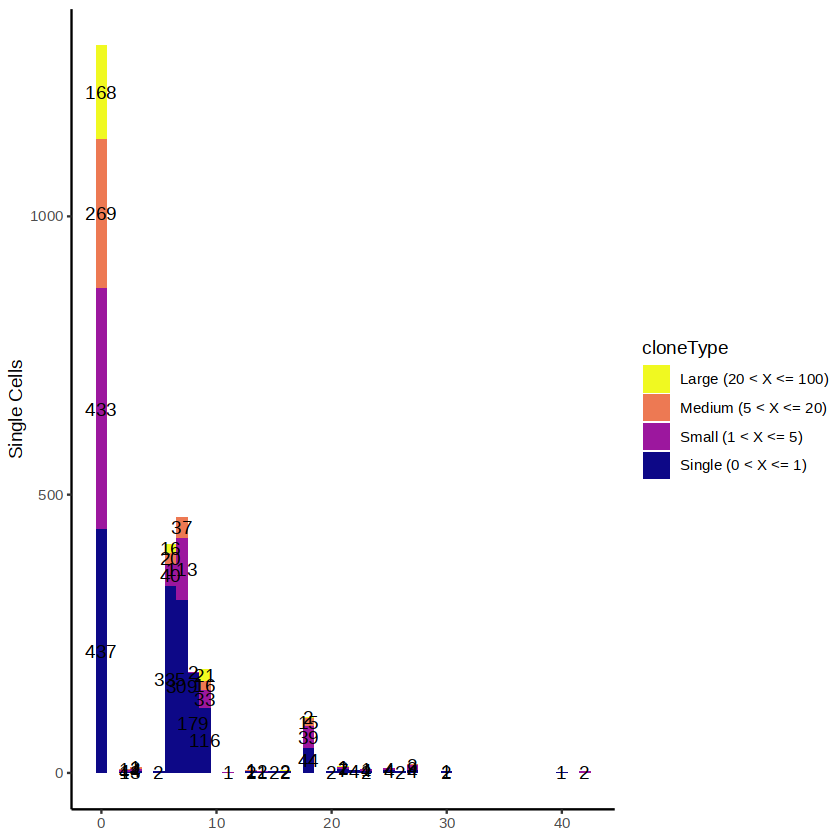

In [74]:
occupiedscRepertoire(FT_data, x.axis = "ident")

In [304]:
View(FT_data@meta.data)

,orig.ident,nCount_RNA,nFeature_RNA,percent.mt,SampleID,tissue_type,nCount_SCT,nFeature_SCT,SCT_snn_res.1,seurat_clusters,barcode,contig_id,CTgene,CTnt,CTaa,CTstrict,Frequency,cloneType
,<chr>,<dbl>,<int>,<dbl>,<chr>,<chr>,<dbl>,<int>,<fct>,<fct>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<int>,<chr>
FT1_GATCGATTCAACCAAC.1_1,FT1,9946,3358,1.4176553,FT1,tumor,4332,2089,22,22,NA,GATCGATTCAACCAAC-1_contig_2,NA,NA,NA,NA,NA,NA
FT1_CCATGTCCAGTCCTTC.1_1,FT1,9993,3343,1.1908336,FT1,tumor,4368,2087,25,25,NA,CCATGTCCAGTCCTTC-1_contig_2,NA,NA,NA,NA,NA,NA
FT1_GGCTGGTTCGGAAACG.1_1,FT1,9984,3487,3.0849359,FT1,tumor,4536,2311,15,15,NA,GGCTGGTTCGGAAACG-1_contig_2,NA,NA,NA,NA,NA,NA
FT1_CCCAGTTAGTGGTCCC.1_1,FT1,9996,3881,0.8403361,FT1,tumor,4538,2548,1,1,NA,CCCAGTTAGTGGTCCC-1_contig_2,NA,NA,NA,NA,NA,NA
FT1_ACGCCGATCACTTATC.1_1,FT1,10000,4089,2.1600000,FT1,tumor,4517,2656,1,1,NA,ACGCCGATCACTTATC-1_contig_2,NA,NA,NA,NA,NA,NA
FT1_GGGCACTGTGTTAAGA.1_1,FT1,9935,3444,1.4494212,FT1,tumor,4327,2206,5,5,NA,GGGCACTGTGTTAAGA-1_contig_2,NA,NA,NA,NA,NA,NA
FT1_CACAAACGTGTGTGCC.1_1,FT1,9961,3892,1.6062644,FT1,tumor,4546,2601,1,1,NA,CACAAACGTGTGTGCC-1_contig_2,NA,NA,NA,NA,NA,NA
FT1_GTAGTCAGTCCAGTAT.1_1,FT1,9958,3207,1.2954409,FT1,tumor,4345,1990,3,3,NA,GTAGTCAGTCCAGTAT-1_contig_2,NA,NA,NA,NA,NA,NA
FT1_CTTAACTCACTGTTAG.1_1,FT1,9957,3839,2.7217033,FT1,tumor,4642,2495,14,14,NA,CTTAACTCACTGTTAG-1_contig_2,NA,NA,NA,NA,NA,NA


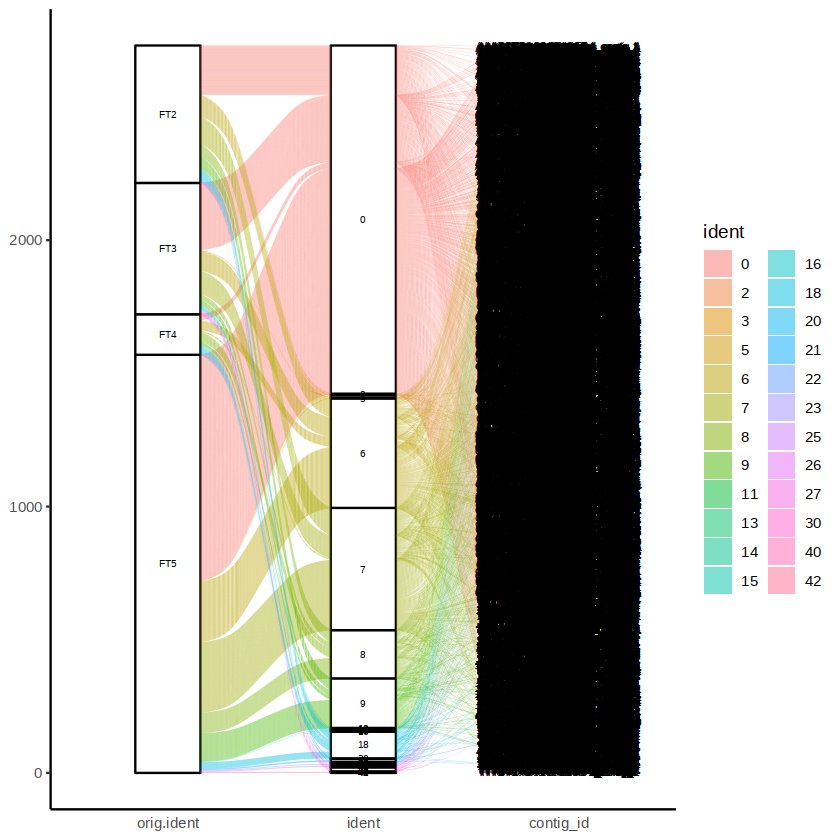

In [336]:
alluvialClonotypes(FT_data, cloneCall = "gene", 
                   y.axes = c("orig.ident", "ident", "contig_id"), 
                   color = "ident")

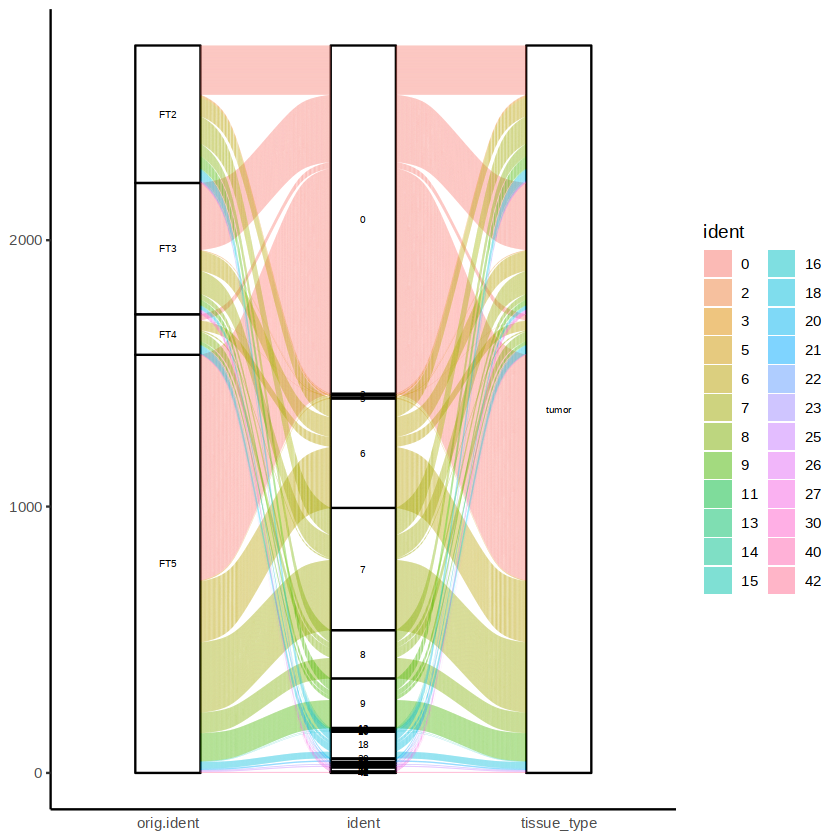

In [337]:
alluvialClonotypes(FT_data, cloneCall = "gene", 
                   y.axes = c("orig.ident", "ident", "tissue_type"), 
                   color = "ident")

In [300]:
suppressPackageStartupMessages(library(circlize))
library(scales)

In [301]:
circles <- getCirclize(FT_data, 
                       group.by = "orig.ident")

In [302]:
grid.cols <- scales::hue_pal()(length(unique(FT_data@active.ident)))
names(grid.cols) <- levels(FT_data@active.ident)

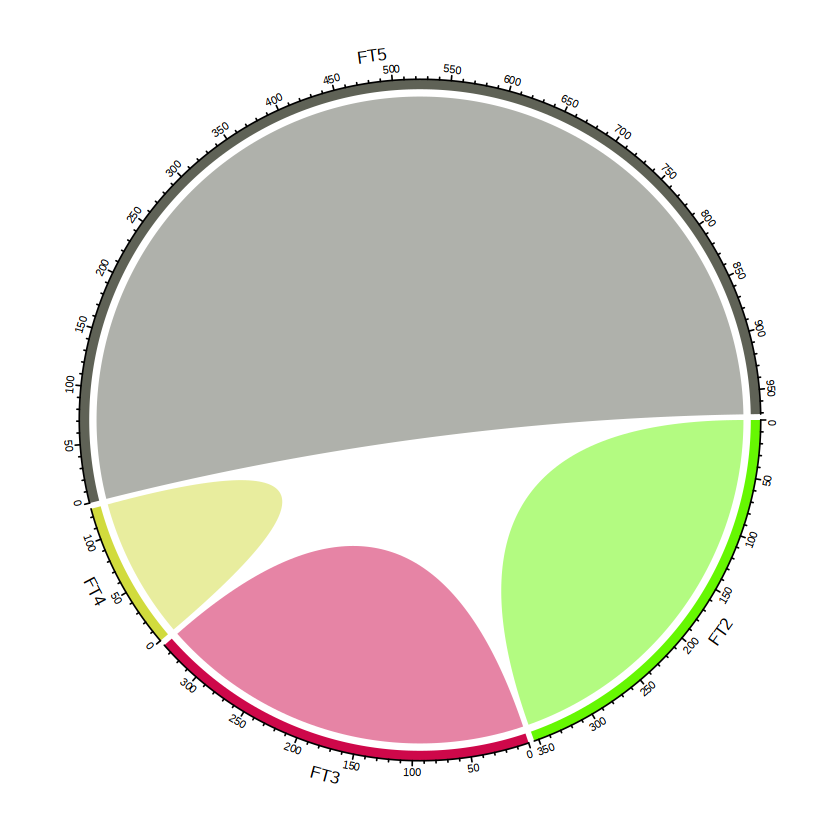

In [303]:
circlize::chordDiagram(circles,
                       self.link = 1, 
                       grid.col = grid.cols)

Warning message in orig.ident == c("FT1", "FT2", "FT3"):
“longer object length is not a multiple of shorter object length”


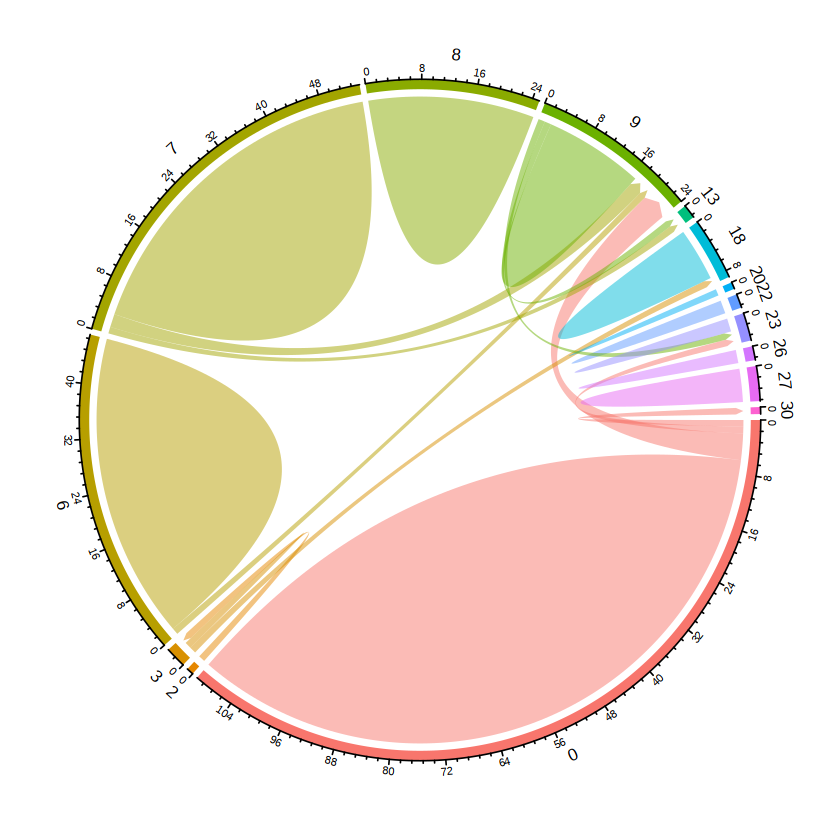

In [415]:
#adenoma
subset <- subset(FT_data, orig.ident == c("FT1","FT2","FT3"))

circles <- getCirclize(subset, group.by = "ident")

grid.cols <- scales::hue_pal()(length(unique(FT_data@active.ident)))
names(grid.cols) <- levels(subset@active.ident)

chordDiagram(circles, self.link = 1, 
             grid.col = grid.cols, directional = 1, 
             direction.type =  "arrows",
            link.arr.type = "big.arrow")

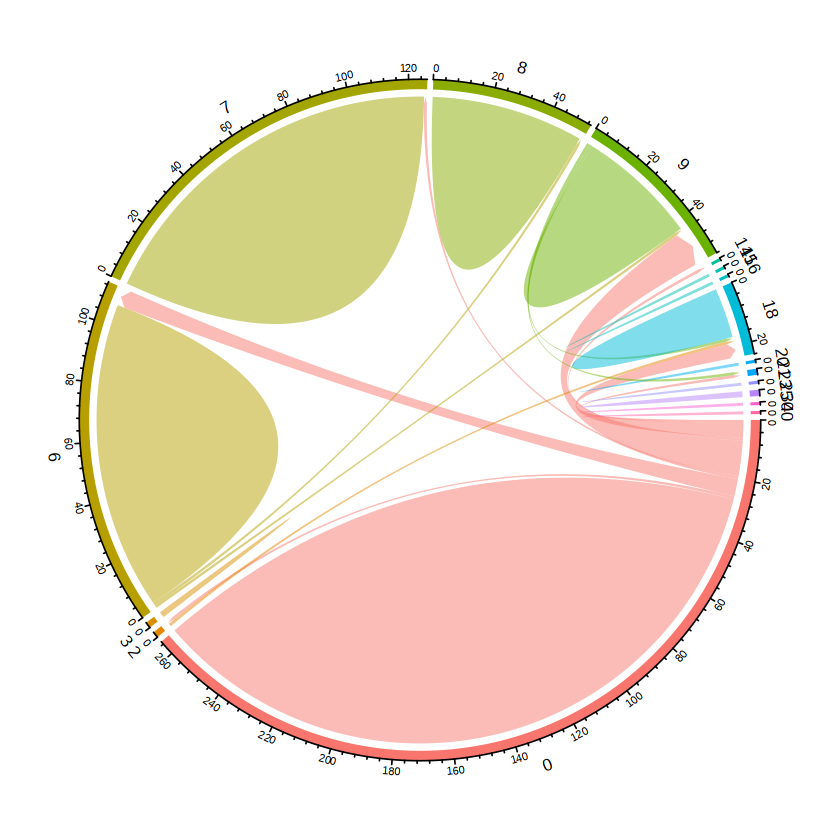

In [416]:
#carcinoma
subset <- subset(FT_data, orig.ident == c("FT4","FT5"))

circles <- getCirclize(subset, group.by = "ident")

grid.cols <- scales::hue_pal()(length(unique(FT_data@active.ident)))
names(grid.cols) <- levels(subset@active.ident)

chordDiagram(circles, self.link = 1, 
             grid.col = grid.cols, directional = 1, 
             direction.type =  "arrows",
            link.arr.type = "big.arrow")

In [135]:
for (i in 1:37228) {
    sample <- FT_data@meta.data[i,"orig.ident"]
    if(sample == "FT1") {
        FT_data@meta.data[i,"ID"] <- c("a")
    }
    if (sample == "FT2") {
        FT_data@meta.data[i,"ID"] <- c("a")
    }
    if (sample == "FT3") {
        FT_data@meta.data[i,"ID"] <- c("a")
    }
    if (sample == "FT4") {
        FT_data@meta.data[i,"ID"] <- c("c")
    }
    if (sample == "FT5") {
        FT_data@meta.data[i,"ID"] <- c("c")
    }
}

In [418]:
FT_data@meta.data

,orig.ident,nCount_RNA,nFeature_RNA,percent.mt,SampleID,tissue_type,nCount_SCT,nFeature_SCT,SCT_snn_res.1,seurat_clusters,barcode,contig_id,CTgene,CTnt,CTaa,CTstrict,Frequency,cloneType,ID
,<chr>,<dbl>,<int>,<dbl>,<chr>,<chr>,<dbl>,<int>,<fct>,<fct>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<int>,<chr>,<chr>
FT1_GATCGATTCAACCAAC.1_1,FT1,9946,3358,1.4176553,FT1,tumor,4332,2089,22,22,NA,GATCGATTCAACCAAC-1_contig_2,NA,NA,NA,NA,NA,NA,a
FT1_CCATGTCCAGTCCTTC.1_1,FT1,9993,3343,1.1908336,FT1,tumor,4368,2087,25,25,NA,CCATGTCCAGTCCTTC-1_contig_2,NA,NA,NA,NA,NA,NA,a
FT1_GGCTGGTTCGGAAACG.1_1,FT1,9984,3487,3.0849359,FT1,tumor,4536,2311,15,15,NA,GGCTGGTTCGGAAACG-1_contig_2,NA,NA,NA,NA,NA,NA,a
FT1_CCCAGTTAGTGGTCCC.1_1,FT1,9996,3881,0.8403361,FT1,tumor,4538,2548,1,1,NA,CCCAGTTAGTGGTCCC-1_contig_2,NA,NA,NA,NA,NA,NA,a
FT1_ACGCCGATCACTTATC.1_1,FT1,10000,4089,2.1600000,FT1,tumor,4517,2656,1,1,NA,ACGCCGATCACTTATC-1_contig_2,NA,NA,NA,NA,NA,NA,a
FT1_GGGCACTGTGTTAAGA.1_1,FT1,9935,3444,1.4494212,FT1,tumor,4327,2206,5,5,NA,GGGCACTGTGTTAAGA-1_contig_2,NA,NA,NA,NA,NA,NA,a
FT1_CACAAACGTGTGTGCC.1_1,FT1,9961,3892,1.6062644,FT1,tumor,4546,2601,1,1,NA,CACAAACGTGTGTGCC-1_contig_2,NA,NA,NA,NA,NA,NA,a
FT1_GTAGTCAGTCCAGTAT.1_1,FT1,9958,3207,1.2954409,FT1,tumor,4345,1990,3,3,NA,GTAGTCAGTCCAGTAT-1_contig_2,NA,NA,NA,NA,NA,NA,a
FT1_CTTAACTCACTGTTAG.1_1,FT1,9957,3839,2.7217033,FT1,tumor,4642,2495,14,14,NA,CTTAACTCACTGTTAG-1_contig_2,NA,NA,NA,NA,NA,NA,a


In [76]:
StartracDiversity(FT_data, 
                  type = "ID", 
                  sample = "orig.ident", 
                  by = "overall")

ERROR: Error in `[.data.frame`(meta, , type): undefined columns selected


Warning message:
“Computation failed in `stat_quantile()`
Caused by error in `compute_group()`:
! The package "quantreg" is required for `stat_quantile()`”


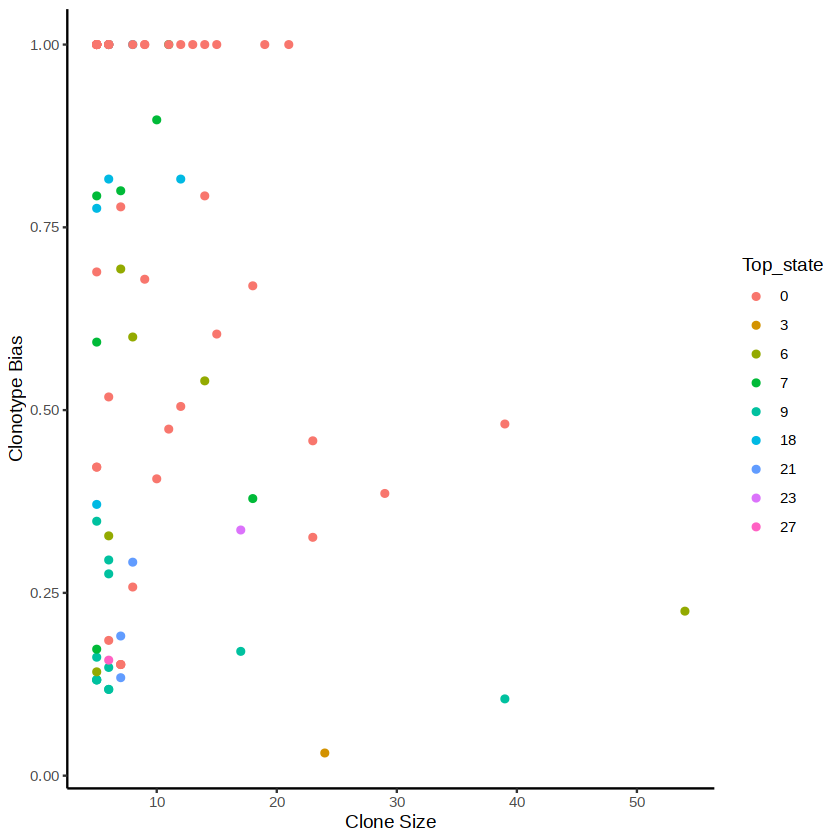

In [144]:
clonotypeBias(FT_data, 
              cloneCall = "aa", 
              split.by = "SampleID", 
              group.by = "ident",
              n.boots = 20, 
              min.expand = 5)

In [10]:
combined2 <- expression2List(FT_data, split.by = "orig.ident")
length(combined2)

ERROR: Error in eval(e, x, parent.frame()): object 'cloneType' not found


In [108]:
combined2 <- expression2List(FT_data, split.by = "seurat_clusters")

In [98]:
View(FT_data@meta.data)

,orig.ident,nCount_RNA,nFeature_RNA,percent.mt,SampleID,tissue_type,nCount_SCT,nFeature_SCT,SCT_snn_res.1,seurat_clusters,barcode,contig_id
,<chr>,<dbl>,<int>,<dbl>,<chr>,<chr>,<dbl>,<int>,<fct>,<fct>,<chr>,<chr>
FT1_GATCGATTCAACCAAC.1,FT1,9946,3358,1.4176553,FT1,tumor,4332,2089,22,22,GATCGATTCAACCAAC-1,GATCGATTCAACCAAC-1_contig_2
FT1_CCATGTCCAGTCCTTC.1,FT1,9993,3343,1.1908336,FT1,tumor,4368,2087,25,25,CCATGTCCAGTCCTTC-1,CCATGTCCAGTCCTTC-1_contig_2
FT1_GGCTGGTTCGGAAACG.1,FT1,9984,3487,3.0849359,FT1,tumor,4536,2311,15,15,GGCTGGTTCGGAAACG-1,GGCTGGTTCGGAAACG-1_contig_2
FT1_CCCAGTTAGTGGTCCC.1,FT1,9996,3881,0.8403361,FT1,tumor,4538,2548,1,1,CCCAGTTAGTGGTCCC-1,CCCAGTTAGTGGTCCC-1_contig_2
FT1_ACGCCGATCACTTATC.1,FT1,10000,4089,2.1600000,FT1,tumor,4517,2656,1,1,ACGCCGATCACTTATC-1,ACGCCGATCACTTATC-1_contig_2
FT1_GGGCACTGTGTTAAGA.1,FT1,9935,3444,1.4494212,FT1,tumor,4327,2206,5,5,GGGCACTGTGTTAAGA-1,GGGCACTGTGTTAAGA-1_contig_2
FT1_CACAAACGTGTGTGCC.1,FT1,9961,3892,1.6062644,FT1,tumor,4546,2601,1,1,CACAAACGTGTGTGCC-1,CACAAACGTGTGTGCC-1_contig_2
FT1_GTAGTCAGTCCAGTAT.1,FT1,9958,3207,1.2954409,FT1,tumor,4345,1990,3,3,GTAGTCAGTCCAGTAT-1,GTAGTCAGTCCAGTAT-1_contig_2
FT1_CTTAACTCACTGTTAG.1,FT1,9957,3839,2.7217033,FT1,tumor,4642,2495,14,14,CTTAACTCACTGTTAG-1,CTTAACTCACTGTTAG-1_contig_2


In [168]:
combined2

,orig.ident,nCount_RNA,nFeature_RNA,percent.mt,SampleID,tissue_type,nCount_SCT,nFeature_SCT,SCT_snn_res.1,seurat_clusters,barcode,contig_id,CTgene,CTnt,CTaa,CTstrict,Frequency,cloneType,ID,ident
,<chr>,<dbl>,<int>,<dbl>,<chr>,<chr>,<dbl>,<int>,<fct>,<fct>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<int>,<chr>,<chr>,<fct>
FT1_CAGCATAGTGTAAGTA.1,FT1,9908,3799,1.1909568,FT1,tumor,4486,2572,7,7,FT1_CAGCATAGTGTAAGTA.1,CAGCATAGTGTAAGTA-1_contig_2,TRAV12-1.TRAJ22.TRAC_TRBV10-3.NA.TRBJ2-7.TRBC2,TGTGTGGTGACCCGACGCCCTGGTTCTGCAAGGCAACTGACCTTT_TGTGCCATCAGTCAGGGTGGCGACGAGCAGTACTTC,CVVTRRPGSARQLTF_CAISQGGDEQYF,TRAV12-1.TRAJ22.TRAC_TGTGTGGTGACCCGACGCCCTGGTTCTGCAAGGCAACTGACCTTT_TRBV10-3.NA.TRBJ2-7.TRBC2_TGTGCCATCAGTCAGGGTGGCGACGAGCAGTACTTC,1,Single (0 < X <= 1),a,7
FT1_TTTGTCAAGCGCTTAT.1,FT1,9830,3439,1.1902340,FT1,tumor,4553,2338,19,19,FT1_TTTGTCAAGCGCTTAT.1,TTTGTCAAGCGCTTAT-1_contig_2,TRAV20.TRAJ29.TRAC_TRBV4-1.TRBD1.TRBJ2-3.TRBC2,TGTGCCCTTCAGGGAAACACACCTCTTGTCTTT_TGCGCCAGCAGCCAAGCGGATAGGGGTCATACGCAGTATTTT,CALQGNTPLVF_CASSQADRGHTQYF,TRAV20.TRAJ29.TRAC_TGTGCCCTTCAGGGAAACACACCTCTTGTCTTT_TRBV4-1.TRBD1.TRBJ2-3.TRBC2_TGCGCCAGCAGCCAAGCGGATAGGGGTCATACGCAGTATTTT,1,Single (0 < X <= 1),a,19
FT1_ACGGCCACAGTAACGG.1,FT1,9553,3374,1.1305349,FT1,tumor,4499,2282,16,16,FT1_ACGGCCACAGTAACGG.1,ACGGCCACAGTAACGG-1_contig_2,TRAV17.TRAJ12.TRAC_TRBV27.NA.TRBJ2-1.TRBC2,TGTGCTACGGCCTCGATGGATAGCAGCTATAAATTGATCTTC_TGTGCCAGCAGTCCTCGGGTCGACCACGGCGTCGTGTACCATGAGCAGTTCTTC,CATASMDSSYKLIF_CASSPRVDHGVVYHEQFF,TRAV17.TRAJ12.TRAC_TGTGCTACGGCCTCGATGGATAGCAGCTATAAATTGATCTTC_TRBV27.NA.TRBJ2-1.TRBC2_TGTGCCAGCAGTCCTCGGGTCGACCACGGCGTCGTGTACCATGAGCAGTTCTTC,1,Single (0 < X <= 1),a,16
FT1_CATTATCGTAGCTTGT.1,FT1,9407,3298,0.8185394,FT1,tumor,4570,2376,7,7,FT1_CATTATCGTAGCTTGT.1,CATTATCGTAGCTTGT-1_contig_2,TRAV2.TRAJ15.TRAC_TRBV11-2.NA.TRBJ2-2.TRBC2,TGTGCTGTGGTGACCAACCAGGCAGGAACTGCTCTGATCTTT_TGTGCCAGCAGACAAGCGGGATCGGCGAACACCGGGGAGCTGTTTTTT,CAVVTNQAGTALIF_CASRQAGSANTGELFF,TRAV2.TRAJ15.TRAC_TGTGCTGTGGTGACCAACCAGGCAGGAACTGCTCTGATCTTT_TRBV11-2.NA.TRBJ2-2.TRBC2_TGTGCCAGCAGACAAGCGGGATCGGCGAACACCGGGGAGCTGTTTTTT,1,Single (0 < X <= 1),a,7
FT1_CAAGTTGTCACAATGC.1,FT1,9302,3467,0.7310256,FT1,tumor,4712,2602,19,19,FT1_CAAGTTGTCACAATGC.1,CAAGTTGTCACAATGC-1_contig_2,TRAV17.TRAJ52.TRAC_TRBV7-2.NA.TRBJ1-2.TRBC1,TGTGCTACGGACGCCTTAGGGGCTGGTGGTACTAGCTATGGAAAGCTGACATTT_TGTGCCAGCAGCTTAGATGGCGGCGGGGATCGCTATGGCTACACCTTC,CATDALGAGGTSYGKLTF_CASSLDGGGDRYGYTF,TRAV17.TRAJ52.TRAC_TGTGCTACGGACGCCTTAGGGGCTGGTGGTACTAGCTATGGAAAGCTGACATTT_TRBV7-2.NA.TRBJ1-2.TRBC1_TGTGCCAGCAGCTTAGATGGCGGCGGGGATCGCTATGGCTACACCTTC,1,Single (0 < X <= 1),a,19
FT1_ATGAGGGAGTTTCCTT.1,FT1,9168,2883,1.3743455,FT1,tumor,4535,2121,6,6,FT1_ATGAGGGAGTTTCCTT.1,ATGAGGGAGTTTCCTT-1_contig_2,TRAV8-3.TRAJ16.TRAC_TRBV15.TRBD1.TRBJ2-5.TRBC2,TGTGCTGTGGGTCTAGAGGGCCAGAAGCTGCTCTTT_TGTGCCACCAGCGAGGGACAGGGTGGGCAAGAGACCCAGTACTTC,CAVGLEGQKLLF_CATSEGQGGQETQYF,TRAV8-3.TRAJ16.TRAC_TGTGCTGTGGGTCTAGAGGGCCAGAAGCTGCTCTTT_TRBV15.TRBD1.TRBJ2-5.TRBC2_TGTGCCACCAGCGAGGGACAGGGTGGGCAAGAGACCCAGTACTTC,1,Single (0 < X <= 1),a,6
FT1_TTGTAGGGTGCGGTAA.1,FT1,9013,3204,1.1649839,FT1,tumor,4744,2578,7,7,FT1_TTGTAGGGTGCGGTAA.1,TTGTAGGGTGCGGTAA-1_contig_2,TRAV6.TRAJ28.TRAC_TRBV11-2.NA.TRBJ1-4.TRBC1,TGTGCCTACTCTGGGGCTGGGAGTTACCAACTCACTTTC_TGTGCCAGCAGCTTTACAGGGATTCCAAATGAAAAACTGTTTTTT,CAYSGAGSYQLTF_CASSFTGIPNEKLFF,TRAV6.TRAJ28.TRAC_TGTGCCTACTCTGGGGCTGGGAGTTACCAACTCACTTTC_TRBV11-2.NA.TRBJ1-4.TRBC1_TGTGCCAGCAGCTTTACAGGGATTCCAAATGAAAAACTGTTTTTT,1,Single (0 < X <= 1),a,7
FT1_TAAGCGTAGGAGCGAG.1,FT1,8999,3304,1.3779309,FT1,tumor,4800,2513,14,14,FT1_TAAGCGTAGGAGCGAG.1,TAAGCGTAGGAGCGAG-1_contig_2,TRAV26-1.TRAJ7.TRAC_TRBV7-9.NA.TRBJ1-6.TRBC1,TGCATCGTCAGAGTCGCCAACAGACTCGCTTTT_TGTGCCAGCAGCTTAGCGGGGAACTCCGCGGGCTCACCCCTCCACTTT,CIVRVANRLAF_CASSLAGNSAGSPLHF,TRAV26-1.TRAJ7.TRAC_TGCATCGTCAGAGTCGCCAACAGACTCGCTTTT_TRBV7-9.NA.TRBJ1-6.TRBC1_TGTGCCAGCAGCTTAGCGGGGAACTCCGCGGGCTCACCCCTCCACTTT,1,Single (0 < X <= 1),a,14
FT1_GTCGTAATCCTCTAGC.1,FT1,8881,3437,1.1259993,FT1,tumor,4812,2806,0,0,FT1_GTCGTAATCCTCTAGC.1,GTCGTAATCCTCTA

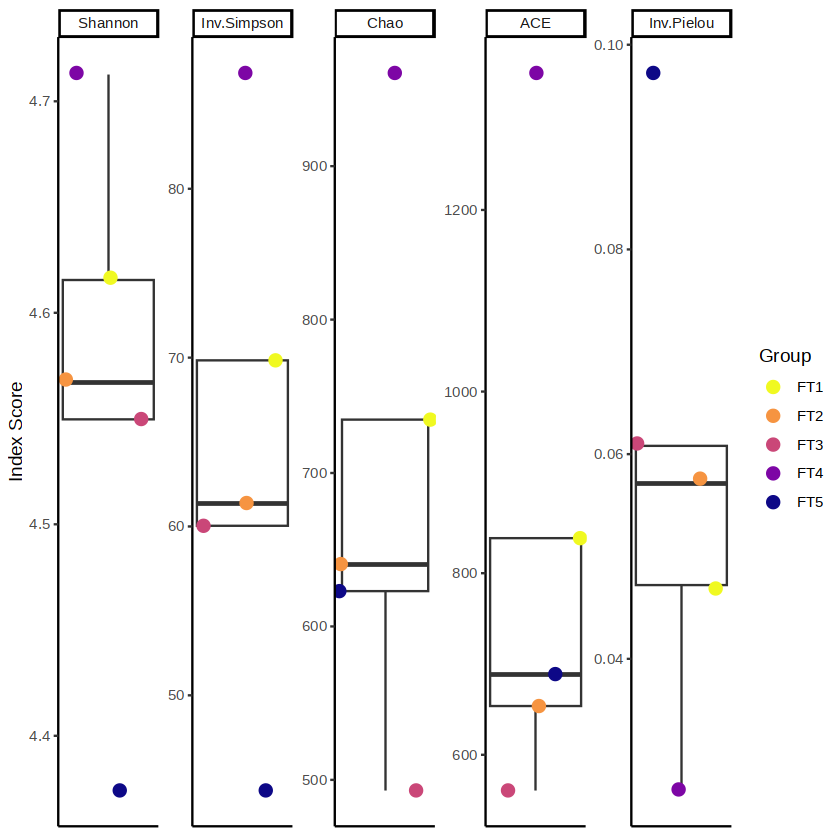

In [125]:
clonalDiversity(combined2, 
                cloneCall = "nt",
               group.by = "SampleID")

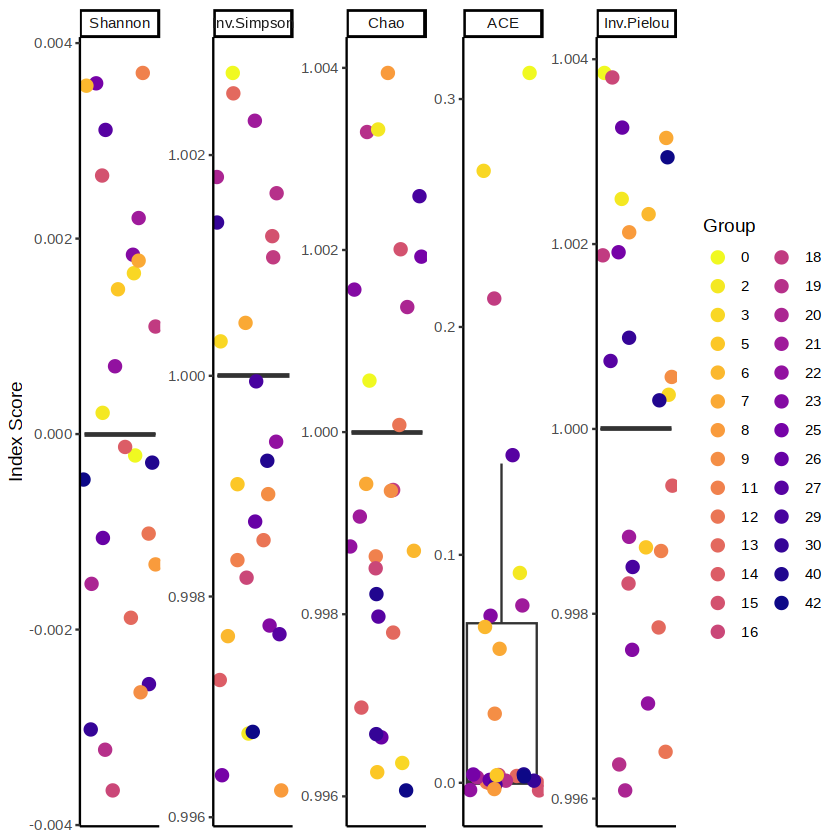

In [184]:
clonalDiversity(combined2, 
                cloneCall = "nt",
               group.by = "seurat_clusters")

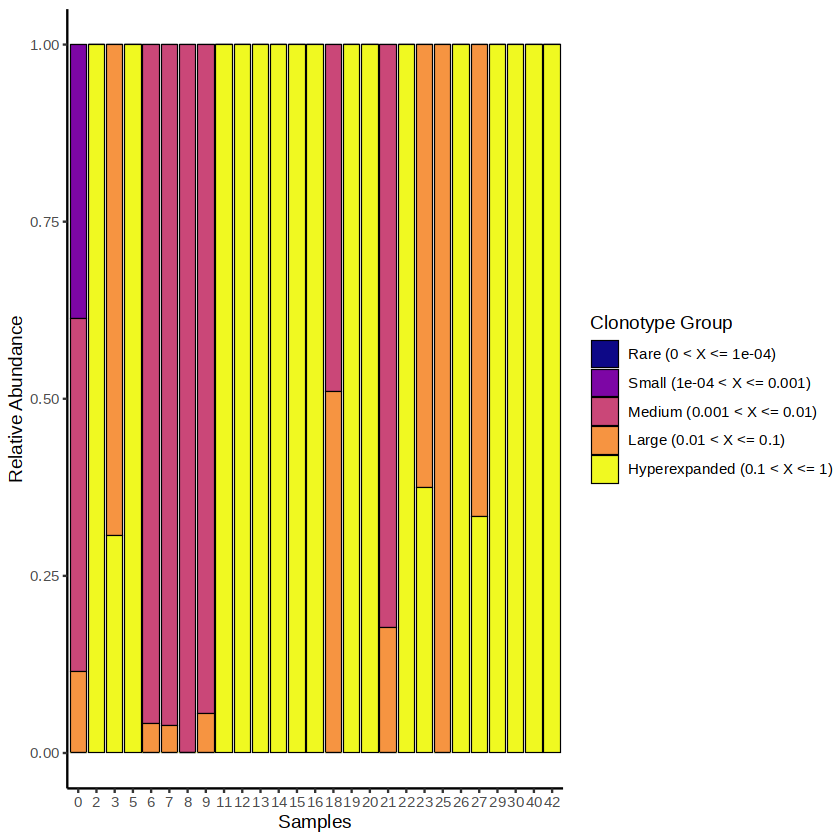

In [109]:
clonalHomeostasis(combined2, cloneCall = "nt")

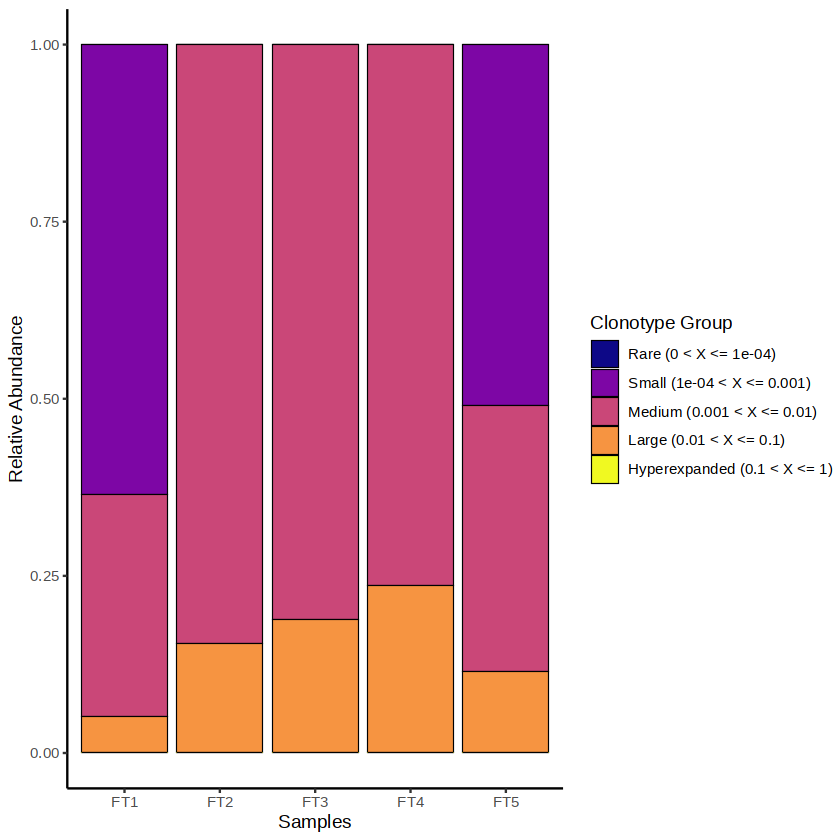

In [111]:
clonalHomeostasis(combined2, cloneCall = "nt", group.by = "SampleID")

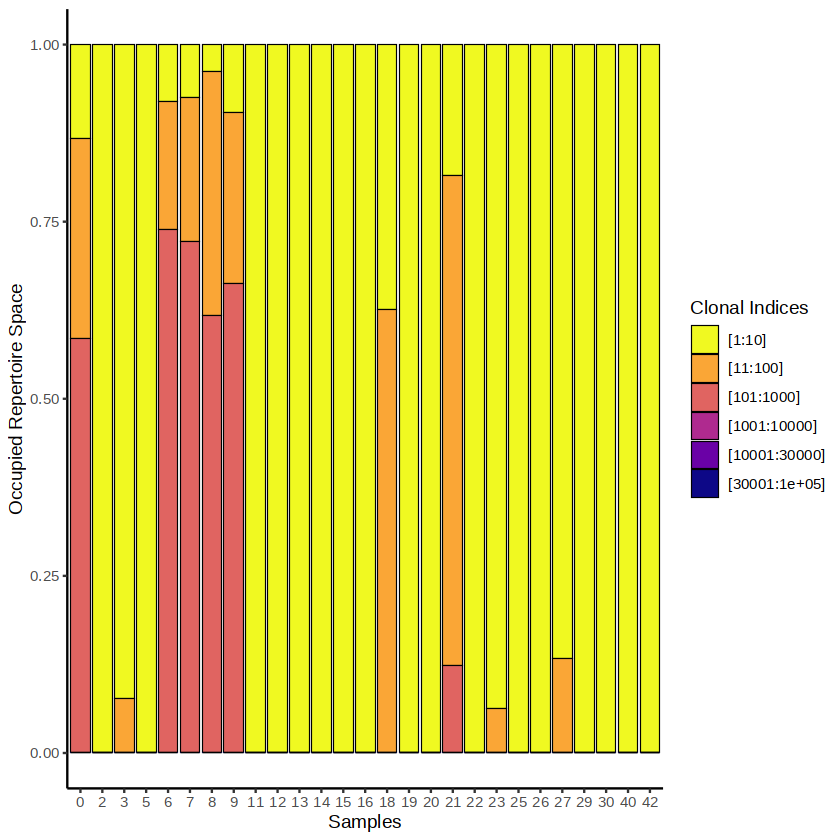

In [112]:
clonalProportion(combined2, cloneCall = "nt")

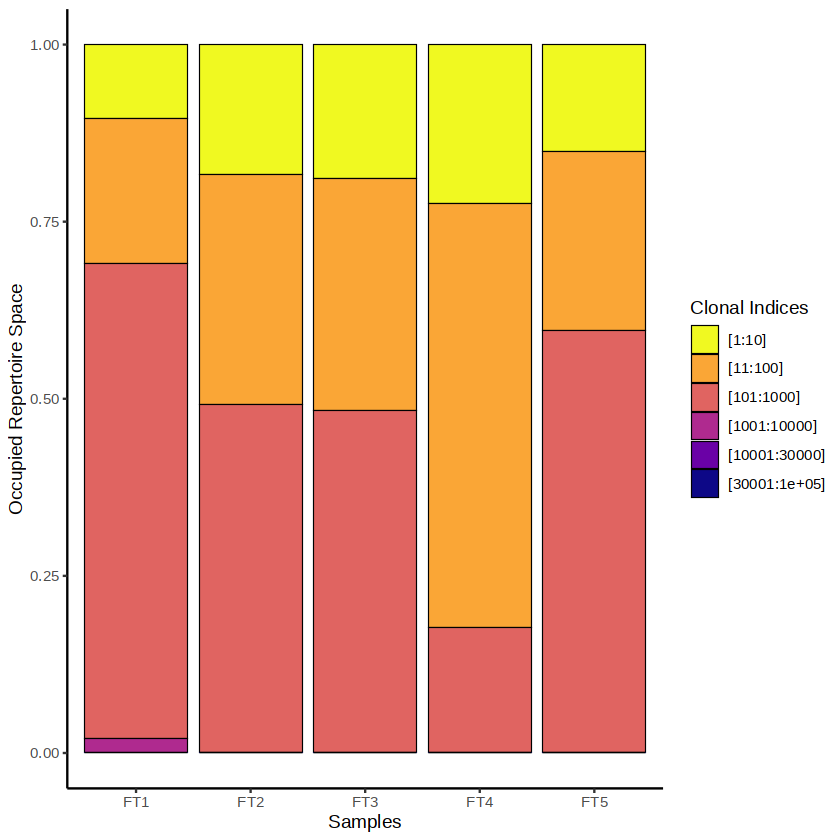

In [113]:
clonalProportion(combined2, cloneCall = "nt", group.by = "SampleID")

Warning message:
“Removed 351 rows containing missing values (`geom_text()`).”


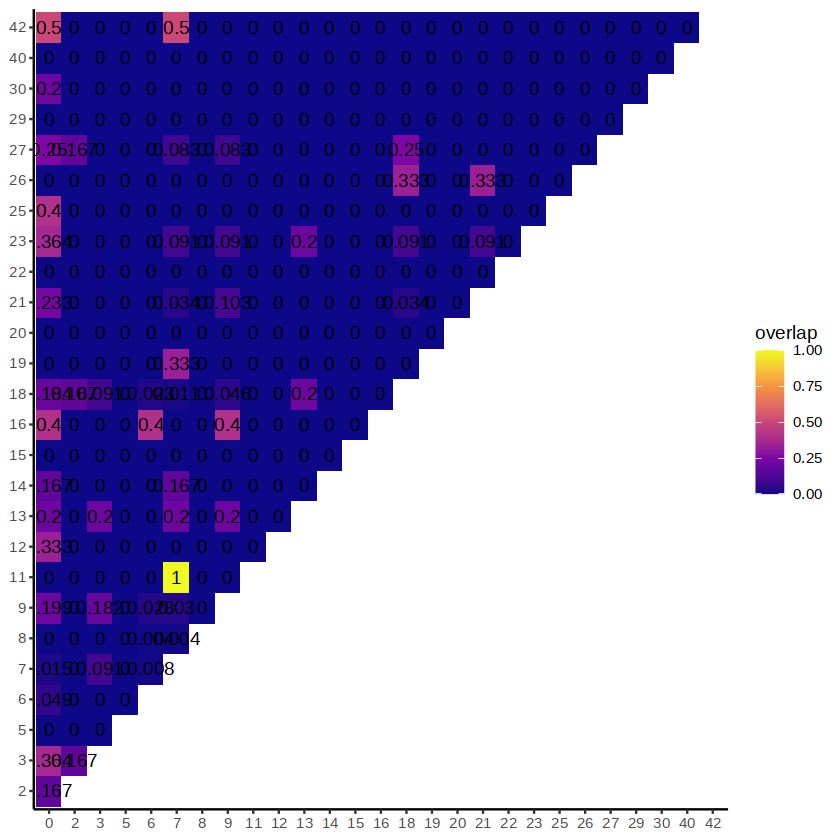

In [114]:
clonalOverlap(combined2, cloneCall = "aa", method = "overlap")

Warning message:
“Removed 351 rows containing missing values (`geom_text()`).”


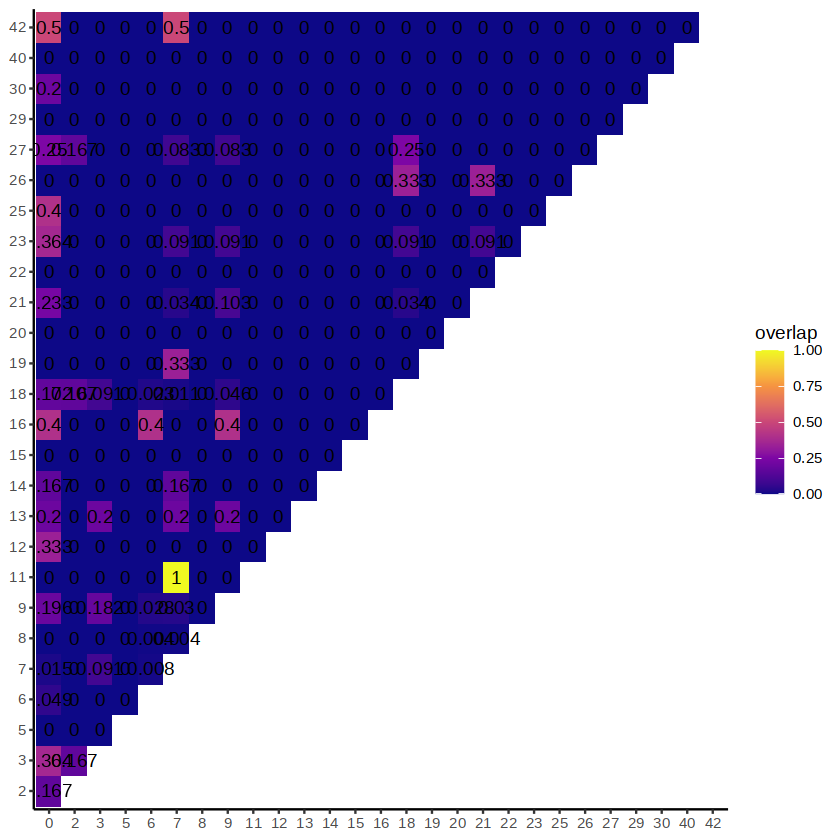

In [145]:
clonalOverlap(combined2, cloneCall = "strict", method = "overlap")

Warning message:
“Removed 351 rows containing missing values (`geom_text()`).”


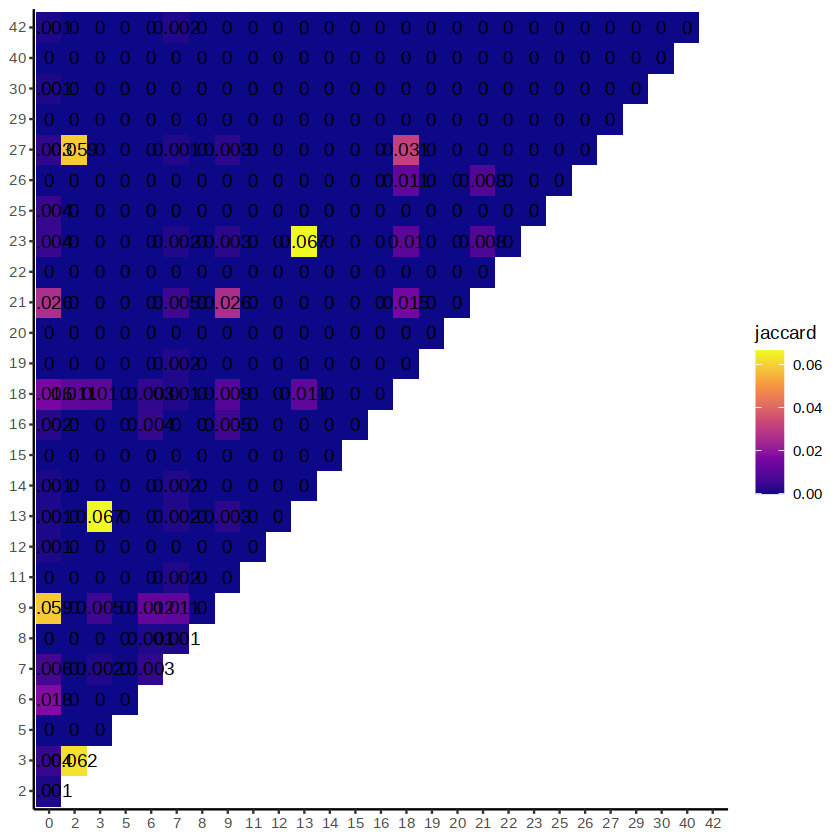

In [115]:
clonalOverlap(combined2, cloneCall = "aa", method = "jaccard")

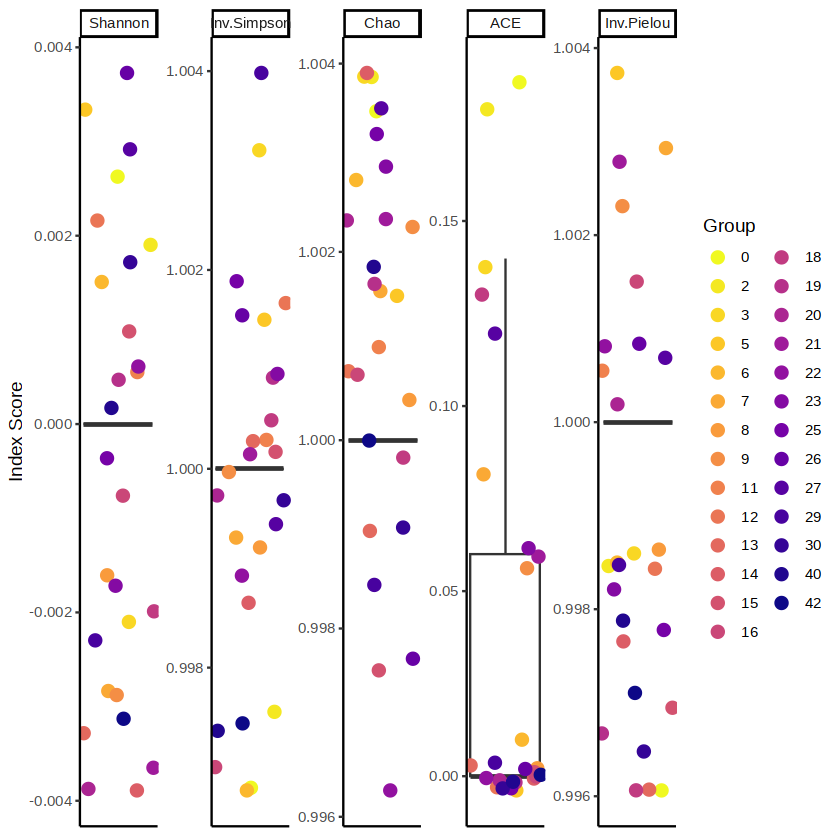

In [116]:
clonalDiversity(FT_data, 
                split.by = "ident", 
                cloneCall = "nt")

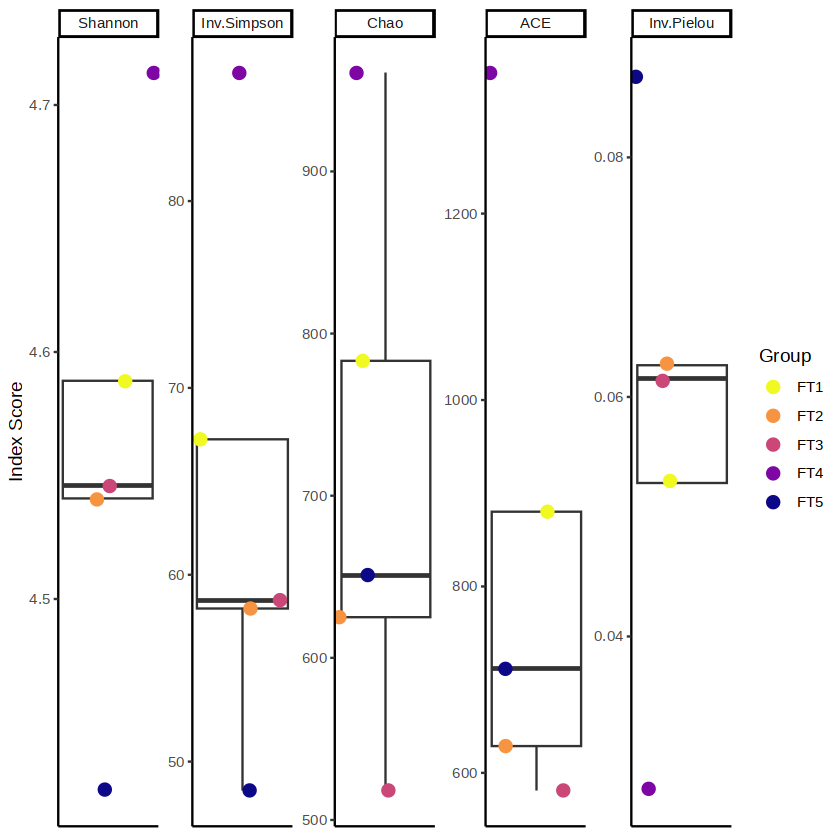

In [121]:
clonalDiversity(FT_data, 
                split.by = "SampleID",
                cloneCall = "nt")

FT cluster

In [33]:
FT_cluster <- readRDS('/home/jurny0402/TCR_explore/code/230530_Tcell_cluster.rds')

In [34]:
FT_cluster <- combineExpression(combined, 
                                   FT_cluster,
                                   cloneCall="gene",
                                   proportion = FALSE, 
                                   cloneTypes=c(Single=1, Small=5, Medium=20, Large=100, Hyperexpanded=500))

In [35]:
slot(FT_cluster, "meta.data")$cloneType <- factor(slot(FT_cluster, "meta.data")$cloneType, 
                levels = c("Hyperexpanded (100 < X <= 500)", 
                           "Large (20 < X <= 100)", 
                            "Medium (5 < X <= 20)", 
                            "Small (1 < X <= 5)", 
                            "Single (0 < X <= 1)", NA))

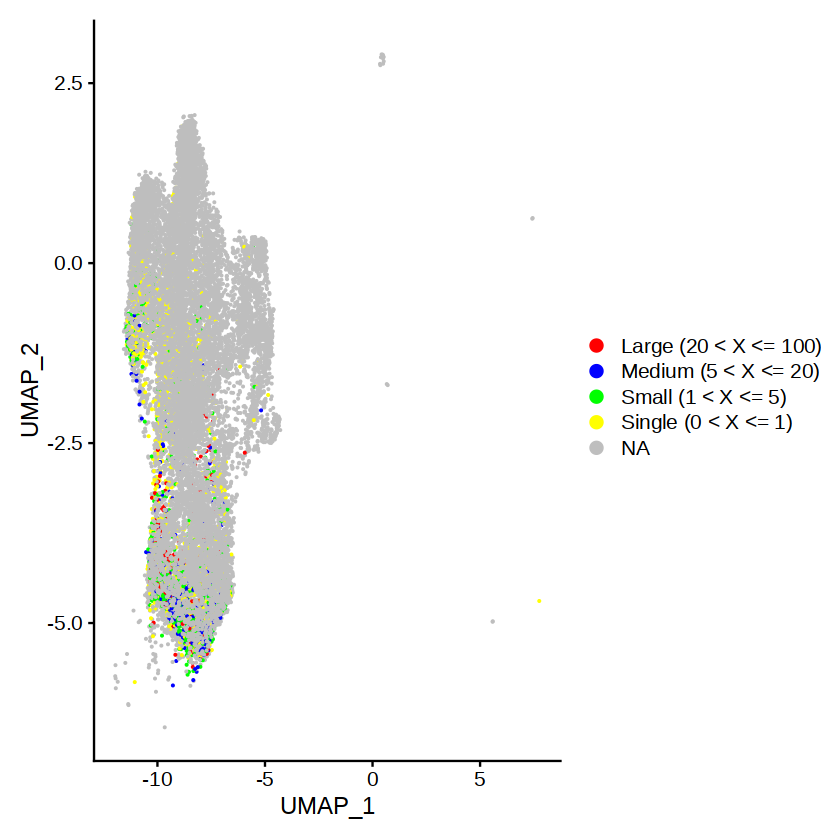

In [36]:
DimPlot(FT_cluster, group.by = "cloneType") +
    scale_color_manual(values = c("red","blue","green","yellow","orange"), na.value="grey") + 
  theme(plot.title = element_blank())

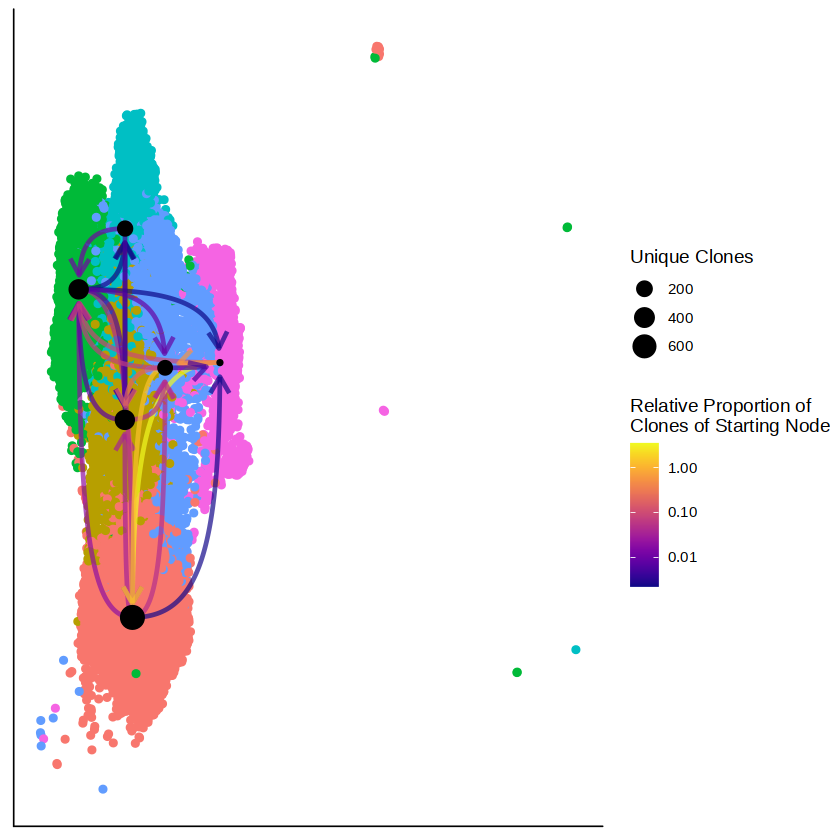

In [37]:
#ggraph needs to be loaded due to issues with ggplot
library(ggraph)

#No Identity filter
clonalNetwork(FT_cluster, 
              reduction = "umap", 
              identity = "ident",
              filter.clones = NULL,
              filter.identity = NULL,
              cloneCall = "aa")

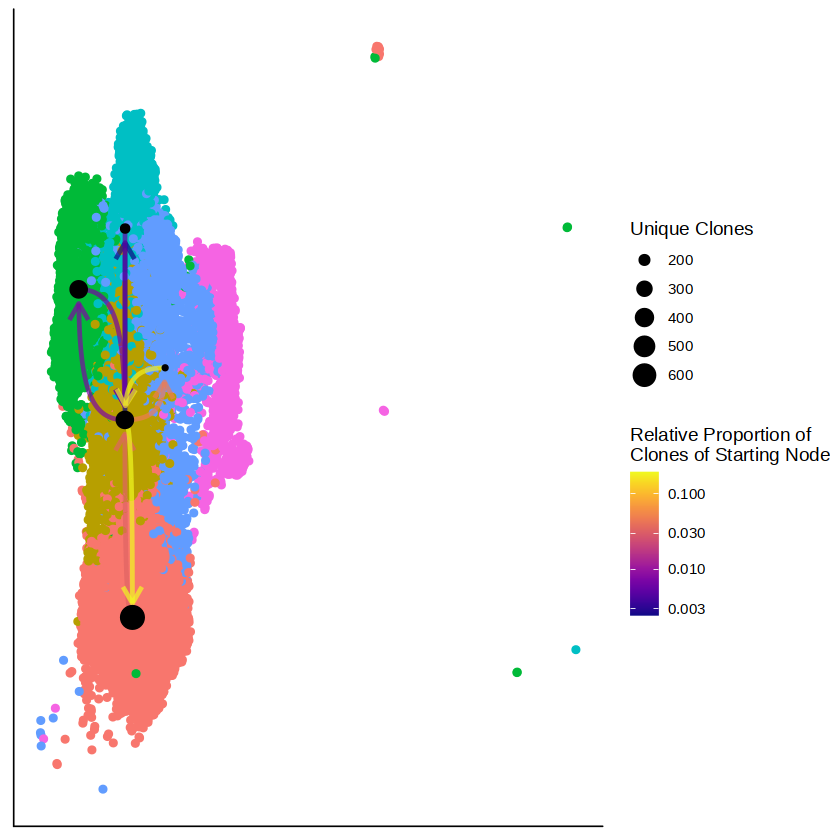

In [38]:
#ggraph needs to be loaded due to issues with ggplot
library(ggraph)

#No Identity filter
clonalNetwork(FT_cluster, 
              reduction = "umap", 
              identity = "ident",
              filter.clones = NULL,
              filter.identity = "6",
              cloneCall = "aa")

In [41]:
combined

barcode,sample,ID,TCR1,cdr3_aa1,cdr3_nt1,TCR2,cdr3_aa2,cdr3_nt2,CTgene,CTnt,CTaa,CTstrict,cellType
<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>
FT1_AAACCTGCACCGGAAA.1,FT1,a,TRAV29/DV5.TRAJ44.TRAC,CAAIRYTGTASKLTF,TGTGCAGCAATCCGCTATACCGGCACTGCCAGTAAACTCACCTTT,TRBV24-1.NA.TRBJ1-5.TRBC1,CATSDKYLNQPQHF,TGTGCCACCAGTGATAAATACCTCAATCAGCCCCAGCATTTT,TRAV29/DV5.TRAJ44.TRAC_TRBV24-1.NA.TRBJ1-5.TRBC1,TGTGCAGCAATCCGCTATACCGGCACTGCCAGTAAACTCACCTTT_TGTGCCACCAGTGATAAATACCTCAATCAGCCCCAGCATTTT,CAAIRYTGTASKLTF_CATSDKYLNQPQHF,TRAV29/DV5.TRAJ44.TRAC_TGTGCAGCAATCCGCTATACCGGCACTGCCAGTAAACTCACCTTT_TRBV24-1.NA.TRBJ1-5.TRBC1_TGTGCCACCAGTGATAAATACCTCAATCAGCCCCAGCATTTT,T-AB
FT1_AAACCTGGTCTTGTCC.1,FT1,a,TRAV30.TRAJ23.TRAC,CGTEIYNQGGKLIF,TGCGGCACAGAGATCTATAACCAGGGAGGAAAGCTTATCTTC,TRBV12-3.NA.TRBJ1-2.TRBC1,CASSVGPQVGNYGYTF,TGTGCCAGCAGCGTGGGACCCCAGGTCGGGAACTATGGCTACACCTTC,TRAV30.TRAJ23.TRAC_TRBV12-3.NA.TRBJ1-2.TRBC1,TGCGGCACAGAGATCTATAACCAGGGAGGAAAGCTTATCTTC_TGTGCCAGCAGCGTGGGACCCCAGGTCGGGAACTATGGCTACACCTTC,CGTEIYNQGGKLIF_CASSVGPQVGNYGYTF,TRAV30.TRAJ23.TRAC_TGCGGCACAGAGATCTATAACCAGGGAGGAAAGCTTATCTTC_TRBV12-3.NA.TRBJ1-2.TRBC1_TGTGCCAGCAGCGTGGGACCCCAGGTCGGGAACTATGGCTACACCTTC,T-AB
FT1_AAACCTGTCTACGAGT.1,FT1,a,TRAV19.TRAJ53.TRAC,CALRRSGGSNYKLTF,TGTGCTCTGAGAAGAAGTGGAGGTAGCAACTATAAACTGACATTT,TRBV29-1.NA.TRBJ2-5.TRBC2,CSVEGGLSSGTQYF,TGCAGCGTTGAAGGGGGCCTGAGTTCCGGGACCCAGTACTTC,TRAV19.TRAJ53.TRAC_TRBV29-1.NA.TRBJ2-5.TRBC2,TGTGCTCTGAGAAGAAGTGGAGGTAGCAACTATAAACTGACATTT_TGCAGCGTTGAAGGGGGCCTGAGTTCCGGGACCCAGTACTTC,CALRRSGGSNYKLTF_CSVEGGLSSGTQYF,TRAV19.TRAJ53.TRAC_TGTGCTCTGAGAAGAAGTGGAGGTAGCAACTATAAACTGACATTT_TRBV29-1.NA.TRBJ2-5.TRBC2_TGCAGCGTTGAAGGGGGCCTGAGTTCCGGGACCCAGTACTTC,T-AB
FT1_AAACGGGCAATAAGCA.1,FT1,a,TRAV13-2.TRAJ30.TRAC,CAVSMNRDDKIIF,TGTGCAGTGTCCATGAACAGAGATGACAAGATCATCTTT,TRBV5-1.NA.TRBJ1-4.TRBC1,CASSLAGSTNEKLFF,TGCGCCAGCAGCTTGGCGGGCTCAACTAATGAAAAACTGTTTTTT,TRAV13-2.TRAJ30.TRAC_TRBV5-1.NA.TRBJ1-4.TRBC1,TGTGCAGTGTCCATGAACAGAGATGACAAGATCATCTTT_TGCGCCAGCAGCTTGGCGGGCTCAACTAATGAAAAACTGTTTTTT,CAVSMNRDDKIIF_CASSLAGSTNEKLFF,TRAV13-2.TRAJ30.TRAC_TGTGCAGTGTCCATGAACAGAGATGACAAGATCATCTTT_TRBV5-1.NA.TRBJ1-4.TRBC1_TGCGCCAGCAGCTTGGCGGGCTCAACTAATGAAAAACTGTTTTTT,T-AB
FT1_AAACGGGTCGTTGCCT.1,FT1,a,TRAV10.TRAJ26.TRAC,CVVRRDNYGQNFVF,TGTGTGGTGAGGCGGGATAACTATGGTCAGAATTTTGTCTTT,TRBV6-5.NA.TRBJ1-1.TRBC1,CASSYLPSGLAPMNTEAFF,TGTGCCAGCAGTTACCTGCCCAGCGGGCTAGCCCCTATGAACACTGAAGCTTTCTTT,TRAV10.TRAJ26.TRAC_TRBV6-5.NA.TRBJ1-1.TRBC1,TGTGTGGTGAGGCGGGATAACTATGGTCAGAATTTTGTCTTT_TGTGCCAGCAGTTACCTGCCCAGCGGGCTAGCCCCTATGAACACTGAAGCTTTCTTT,CVVRRDNYGQNFVF_CASSYLPSGLAPMNTEAFF,TRAV10.TRAJ26.TRAC_TGTGTGGTGAGGCGGGATAACTATGGTCAGAATTTTGTCTTT_TRBV6-5.NA.TRBJ1-1.TRBC1_TGTGCCAGCAGTTACCTGCCCAGCGGGCTAGCCCCTATGAACACTGAAGCTTTCTTT,T-AB
FT1_AAAGATGAGTACACCT.1,FT1,a,TRAV35.TRAJ56.TRAC,CAGQAGANSKLTF,TGTGCTGGGCAGGCTGGAGCCAATAGTAAGCTGACATTT,TRBV20-1.NA.TRBJ2-5.TRBC2,CSARPGNRGKETQYF,TGCAGTGCTAGGCCCGGCAACAGGGGGAAAGAGACCCAGTACTTC,TRAV35.TRAJ56.TRAC_TRBV20-1.NA.TRBJ2-5.TRBC2,TGTGCTGGGCAGGCTGGAGCCAATAGTAAGCTGACATTT_TGCAGTGCTAGGCCCGGCAACAGGGGGAAAGAGACCCAGTACTTC,CAGQAGANSKLTF_CSARPGNRGKETQYF,TRAV35.TRAJ56.TRAC_TGTGCTGGGCAGGCTGGAGCCAATAGTAAGCTGACATTT_TRBV20-1.NA.TRBJ2-5.TRBC2_TGCAGTGCTAGGCCCGGCAACAGGGGGAAAGAGACCCAGTACTTC,T-AB
FT1_AAAGATGTCGCCAAAT.1,FT1,a,TRAV21.TRAJ20.TRAC,CAVEPNDYKLSF,TGTGCTGTGGAGCCTAACGACTACAAGCTCAGCTTT,TRBV19.NA.TRBJ2-2.TRBC2,CASSLSGGAYTGELFF,TGTGCCAGTAGTCTTTCAGGGGGCGCATACACCGGGGAGCTGTTTTTT,TRAV21.TRAJ20.TRAC_TRBV19.NA.TRBJ2-2.TRBC2,TGTGCTGTGGAGCCTAACGACTACAAGCTCAGCTTT_TGTGCCAGTAGTCTTTCAGGGGGCGCATACACCGGGGAGCTGTTTTTT,CAVEPNDYKLSF_CASSLSGGAYTGELFF,TRAV21.TRAJ20.TRAC_TGTGCTGTGGAGCCTAACGACTACAAGCTCAGCTTT_TRBV19.NA.TRBJ2-2.TRBC2_TGTGCCAGTAGTCTTTCAGGGGGCGCATACACCGGGGAGCTGTTTTTT,T-AB
FT1_AAAGATGTCTCCTATA.1,FT1,a,TRAV8-3.TRAJ41.TRAC,CAVGANSGYALNF,TGTGCTGTGGGTGCGAATTCCGGGTATGCACTCAACTTC,TRBV12-4.NA.TRBJ1-1.TRBC1,CASSFDLVGLVNTEAFF,TGTGCCAGCAGTTTTGATCTCGTGGGGTTGGTTAACACTGAAGCTTTCTTT,TRAV8-3.TRAJ41.TRAC_TRBV12-4.NA.TRBJ1-1.TRBC1,TGTGCTGTGGGTGCGAATTCCGGGTATGCACTCAACTTC_TGTGCCAGCAGTTTTGAT

In [42]:
for (i in 1:73619) {
    rowname <- FT_cluster@meta.data[i,"barcode"]
    rowname <- sub("\\.1$", "-1", rowname)
    rowname <- sub("\\.1_1$", "-1", rowname)
    rowname <- sub("\\.1_2$", "-1", rowname)
    rowname <- sub("\\.1_3$", "-1", rowname)
    rowname <- sub("\\.1_4$", "-1", rowname)
    rowname <- sub("\\.1_5$", "-1", rowname)
    rowname <- sub(paste0("^", "FT1_"), "", rowname)
    rowname <- sub(paste0("^", "FT2_"), "", rowname)
    rowname <- sub(paste0("^", "FT3_"), "", rowname)
    rowname <- sub(paste0("^", "FT4_"), "", rowname)
    rowname <- sub(paste0("^", "FT5_"), "", rowname)
    
    FT_cluster@meta.data[i,"barcode"] <- rowname
}

In [43]:
FT_c <- merge(combined, FT_cluster, "barcode")

ERROR: Error in (function (..., row.names = NULL, check.rows = FALSE, check.names = TRUE, : arguments imply differing number of rows: 1687, 650, 617, 189, 1683


In [40]:
View(FT_cluster@meta.data)

,orig.ident,nCount_RNA,nFeature_RNA,percent.mt,SampleID,tissue_type,nCount_SCT,nFeature_SCT,SCT_snn_res.1,seurat_clusters,barcode,CTgene,CTnt,CTaa,CTstrict,Frequency,cloneType
,<chr>,<dbl>,<int>,<dbl>,<chr>,<chr>,<dbl>,<int>,<fct>,<fct>,<chr>,<chr>,<chr>,<chr>,<chr>,<int>,<fct>
FT1_CAGCATAGTGTAAGTA.1_1,FT1,9908,3799,1.1909568,FT1,tumor,4486,2572,7,7,NA,NA,NA,NA,NA,NA,NA
FT1_CTCACACGTAAGTAGT.1_1,FT1,9600,3326,1.1979167,FT1,tumor,4485,2316,0,0,NA,NA,NA,NA,NA,NA,NA
FT1_CATTATCGTAGCTTGT.1_1,FT1,9407,3298,0.8185394,FT1,tumor,4570,2376,7,7,NA,NA,NA,NA,NA,NA,NA
FT1_CAGTAACCAAAGGAAG.1_1,FT1,9365,3361,1.6123865,FT1,tumor,4584,2510,7,7,NA,NA,NA,NA,NA,NA,NA
FT1_TTAGGCAAGCGTCAAG.1_1,FT1,9348,3518,1.3585794,FT1,tumor,4630,2652,0,0,NA,NA,NA,NA,NA,NA,NA
FT1_ATGAGGGAGTTTCCTT.1_1,FT1,9168,2883,1.3743455,FT1,tumor,4535,2121,6,6,NA,NA,NA,NA,NA,NA,NA
FT1_AGTGTCACAGCTGTGC.1_1,FT1,9101,3109,1.0658169,FT1,tumor,4640,2388,7,7,NA,NA,NA,NA,NA,NA,NA
FT1_TTGTAGGGTGCGGTAA.1_1,FT1,9013,3204,1.1649839,FT1,tumor,4744,2578,7,7,NA,NA,NA,NA,NA,NA,NA
FT1_CACAGGCTCTTGGGTA.1_1,FT1,8982,3071,0.7793365,FT1,tumor,4648,2397,8,8,NA,NA,NA,NA,NA,NA,NA


In [39]:
FT_clustered <- clusterTCR(FT_c,
                     chain = "TRB",
                     group.by = "SampleID", 
                     sequence = "aa", 
                     threshold = 0.85)

ERROR: Error in str_split(dat[[y]]$CTaa, "_", simplify = TRUE)[, 1]: subscript out of bounds


In [ ]:
DimPlot(FT_clustered, group.by = "TRB_cluster") + 
  scale_color_manual(values = colorblind_vector(length(unique(FT_clustered@meta.data[,"TRB_cluster"])))) + 
  NoLegend()